<a href="https://colab.research.google.com/github/nano2547/PS-Research/blob/main/AL015PASAL_Sum_Diff_MN05.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from AL_methods import *
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
adj_list = {112: [72, 61, 90],
 113: [73, 62, 91],
 114: [74, 63, 92],
 115: [75, 64, 93],
 119: [76, 57, 97],
 120: [77, 58, 98],
 121: [78, 59, 99],
 122: [79, 60, 100],
 105: [65, 50],
 106: [66, 51],
 107: [67, 52],
 108: [68, 53],
 76: [119, 57, 50, 97],
 77: [120, 58, 51, 98],
 78: [121, 59, 52, 99],
 79: [122, 60, 53, 100],
 72: [112, 65, 61, 90],
 73: [113, 66, 62, 91],
 74: [114, 67, 63, 92],
 75: [115, 68, 64, 93],
 65: [105, 72, 50],
 66: [106, 73, 51],
 67: [107, 74, 52],
 68: [108, 75, 53],
 57: [119, 76, 61, 97],
 58: [120, 77, 62, 98],
 59: [121, 78, 63, 99],
 60: [122, 79, 64, 100],
 50: [105, 76, 65],
 51: [106, 77, 66],
 52: [107, 78, 67],
 53: [108, 79, 68],
 61: [112, 72, 57, 90],
 62: [113, 73, 58, 91],
 63: [114, 74, 59, 92],
 64: [115, 75, 60, 93],
 97: [119, 76, 57, 101],
 98: [120, 77, 58, 102],
 99: [121, 78, 59, 103],
 100: [122, 79, 60, 104],
 90: [112, 72, 61, 83],
 91: [113, 73, 62, 84],
 92: [114, 74, 63, 85],
 93: [115, 75, 64, 86],
 101: [97, 1, 8, 15, 22],
 102: [98, 2, 9, 16, 23],
 103: [99, 3, 10, 17, 24],
 104: [100, 4, 11, 18, 25],
 83: [90],
 84: [91],
 85: [92],
 86: [93],
 1: [101],
 2: [102],
 3: [103],
 4: [104],
 8: [101, 29, 36],
 9: [102, 30, 37],
 10: [103, 31, 38],
 11: [104, 32, 39],
 29: [8, 36],
 30: [9, 37],
 31: [10, 38],
 32: [11, 39],
 36: [8, 29],
 37: [9, 30],
 38: [10, 31],
 39: [11, 32],
 15: [101, 43],
 16: [102, 44],
 17: [103, 45],
 18: [104, 46],
 43: [15],
 44: [16],
 45: [17],
 46: [18],
 22: [101],
 23: [102],
 24: [103],
 25: [104],
 116: [],
 117: [],
 118: [],
 123: [],
 124: [],
 125: [],
 109: [],
 110: [],
 111: [],
 80: [76, 79, 74, 66],
 81: [77, 72, 75, 67],
 82: [78, 73, 65, 68],
 69: [106, 79, 74, 66],
 70: [107, 72, 75, 67],
 71: [108, 73, 65, 68],
 54: [106, 76, 74, 66],
 55: [107, 77, 75, 67],
 56: [108, 78, 65, 68],
 94: [106, 76, 79, 57, 60, 97, 92],
 95: [107, 77, 72, 58, 50, 98, 93],
 96: [108, 78, 73, 59, 51, 99, 101],
 87: [106, 76, 79],
 88: [107, 77, 72],
 89: [108, 78, 73],
 5: [74],
 6: [75],
 7: [65],
 12: [74, 52],
 13: [75, 53],
 14: [65, 61],
 33: [60, 62],
 34: [50, 63],
 35: [51, 64],
 40: [52],
 41: [53],
 42: [61],
 19: [74, 100],
 20: [75, 90],
 21: [65, 91],
 47: [97],
 48: [98],
 49: [99],
 26: [74],
 27: [75],
 28: [65]}

In [4]:
attack_dict = {61: (2.20, 3.50, 'CT', 'C_CTW10_A'),
               62: (2.20, 3.50, 'CT', 'C_CTW10_B'),
               63: (2.20, 3.50, 'CT', 'C_CTW10_C'),
               64: (2.20, 3.50, 'CT', 'C_CTW10_N'),
               52: (3.8, 4.5, 'Cphase', 'C_CTW9_C'),
               94: (4.5, 5.9, 'PT', 'V_PTW4_A'),
               95: (4.5, 5.9, 'PT', 'V_PTW4_B'),
               96: (4.5, 5.9, 'PT', 'V_PTW4_C'),
               88: (6.2, 7.1, 'Vphase', 'V_PTW4_BN'),
               76: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               77: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               78: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               79: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               80: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               81: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               82: (8.5, 9.4, 'GPS', 'C_CTWE1&V_PTWE1'),
               123: (10.5, 11.5, 'PT', 'V_PT_SB_A'),
               124: (10.5, 11.5, 'PT', 'V_PT_SB_B'),
               125: (10.5, 11.5, 'PT', 'V_PT_SB_C'),
               29: (11.7, 12.7, 'CT', 'C_CTFDR2R1'),
               30: (11.7, 12.7, 'CT', 'C_CTFDR2R1'),
               31: (11.7, 12.7, 'CT', 'C_CTFDR2R1'),
               32: (11.7, 12.7, 'CT', 'C_CTFDR2R1'),
               38: (14.6, 15.8, 'Cphase', 'C_CTFDR2R2_C'),
               15: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               16: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               17: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               18: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               19: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               20: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3'),
               21: (16.5, 17.5, 'GPS', 'C_CTFDR3&V_PTFDR3')
               }

In [5]:
data_dir = "../Data/Data_Power/"
df = pd.read_csv("/content/drive/MyDrive/Event 4 without attacks.CSV", skiprows=[0,1,2,4])

df

,Time,C_W738_W737_2_W737_A,C_W738_W737_2_W737_B,C_W738_W737_2_W737_C,C_W738_W737_2_W737_N,V_W738_AN,V_W738_BN,V_W738_CN,C_W747_W748_2_W747_A,C_W747_W748_2_W747_B,...,V_SOURCE-A_AN,V_SOURCE-A_BN,V_SOURCE-A_CN,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,V_SOURCE-BL_AN,V_SOURCE-BL_BN,V_SOURCE-BL_CN
0,0,0.001789,0.002054,0.004035,-0.000020,0.148158,0.127625,0.075987,0.003721,-0.001659,...,0.927593,-0.703249,-0.719288,0.002209,-0.000666,0.001731,0.000053,-0.849463,-0.288562,1.002713
1,208,0.001789,0.002054,0.004035,-0.000020,0.148158,0.127625,0.075987,0.003721,-0.001659,...,76764.710000,-33655.210000,-41529.950000,230.466800,-108.023300,-128.021700,3.067799,76763.670000,-33655.700000,-41528.730000
2,417,0.735900,-0.033837,-0.727117,0.013513,195.290700,8.624437,-201.431300,0.767495,-0.031163,...,90973.690000,-35219.500000,-55234.260000,264.724700,-111.345300,-162.266000,5.679017,90973.330000,-35221.140000,-55233.990000
3,625,20.512150,-0.392749,-20.760670,0.259912,4755.236000,236.268200,-4979.199000,22.060590,-0.038539,...,91933.620000,-29716.290000,-62277.850000,263.986100,-95.315260,-177.941700,6.235758,91937.130000,-29717.050000,-62277.330000
4,833,68.175680,3.106635,-72.555460,0.436005,10822.790000,1045.943000,-11863.060000,76.573980,4.364873,...,90468.290000,-22871.400000,-67844.650000,255.996100,-75.519380,-189.109500,5.962640,90703.850000,-22983.610000,-67966.420000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96000,19999872,248.883500,-86.692930,-162.175200,-0.004861,10469.200000,-1303.779000,-9165.100000,184.898700,-48.918630,...,94555.620000,-51622.290000,-43015.850000,38.997370,21.948360,-61.343400,0.312038,94476.610000,-51692.120000,-42865.250000
96001,20000080,244.532500,-67.715510,-176.700700,-0.023235,10081.940000,-414.446000,-9667.895000,180.346900,-34.218460,...,94657.370000,-45246.390000,-49497.290000,34.394340,26.834710,-61.383330,0.143125,94587.570000,-45324.250000,-49343.830000
96002,20000289,238.686500,-48.343280,-190.124700,-0.041279,9632.072000,476.657100,-10110.340000,174.684200,-19.326520,...,94175.710000,-38588.510000,-55671.820000,29.567510,31.567270,-61.050560,-0.026838,94115.180000,-38679.250000,-55520.800000
96003,20000497,231.372200,-28.683920,-202.369000,-0.058938,9122.629000,1364.928000,-10489.990000,167.956800,-4.331313,...,93110.630000,-31696.140000,-61502.990000,24.561630,36.124050,-60.353960,-0.197012,93062.610000,-31792.510000,-61354.780000


In [6]:
# remove first 0.25 seconds to allow system to stabilise before using data
data = preprocess(df, time=0.25e6)
data

,C_W738_W737_2_W737_A,C_W738_W737_2_W737_B,C_W738_W737_2_W737_C,C_W738_W737_2_W737_N,V_W738_AN,V_W738_BN,V_W738_CN,C_W747_W748_2_W747_A,C_W747_W748_2_W747_B,C_W747_W748_2_W747_C,...,V_SOURCE-A_AN,V_SOURCE-A_BN,V_SOURCE-A_CN,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,V_SOURCE-BL_AN,V_SOURCE-BL_BN,V_SOURCE-BL_CN
1201,241.3096,-55.413830,-185.7377,-0.031542,9811.672,161.2130,-9973.563,177.0295,-24.578160,-152.3945,...,94436.90,-41221.39,-53301.67,29.686870,31.72985,-61.42770,0.040601,94378.32,-41303.05,-53155.28
1202,234.4698,-35.763440,-198.4305,-0.051236,9321.225,1055.1480,-10377.550,170.6262,-9.546074,-161.0067,...,93599.08,-34412.12,-59272.62,24.733210,36.21194,-60.71335,-0.129573,93550.85,-34501.80,-59131.19
1203,226.1797,-15.906680,-209.9047,-0.070546,8773.790,1942.0030,-10716.800,163.1736,5.537642,-168.6231,...,92184.62,-27392.11,-64878.93,19.630350,40.47431,-59.63074,-0.299116,92146.37,-27488.29,-64740.44
1204,216.5110,4.039804,-220.0629,-0.089470,8172.820,2816.1130,-10989.860,154.7181,20.577100,-175.1878,...,90203.71,-20202.91,-70084.14,14.408110,44.49500,-58.18873,-0.466768,90174.39,-20306.74,-69947.55
1205,205.4993,23.959370,-228.8757,-0.107734,7521.338,3672.8740,-11194.780,145.3136,35.483800,-180.6770,...,87663.12,-12889.03,-74857.86,9.088895,48.25644,-56.40065,-0.631690,87644.43,-13001.37,-74725.90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96000,248.8835,-86.692930,-162.1752,-0.004861,10469.200,-1303.7790,-9165.100,184.8987,-48.918630,-135.9190,...,94555.62,-51622.29,-43015.85,38.997370,21.94836,-61.34340,0.312038,94476.61,-51692.12,-42865.25
96001,244.5325,-67.715510,-176.7007,-0.023235,10081.940,-414.4460,-9667.895,180.3469,-34.218460,-146.0529,...,94657.37,-45246.39,-49497.29,34.394340,26.83471,-61.38333,0.143125,94587.57,-45324.25,-49343.83
96002,238.6865,-48.343280,-190.1247,-0.041279,9632.072,476.6571,-10110.340,174.6842,-19.326520,-155.2865,...,94175.71,-38588.51,-55671.82,29.567510,31.56727,-61.05056,-0.026838,94115.18,-38679.25,-55520.80
96003,231.3722,-28.683920,-202.3690,-0.058938,9122.629,1364.9280,-10489.990,167.9568,-4.331313,-163.5402,...,93110.63,-31696.14,-61502.99,24.561630,36.12405,-60.35396,-0.197012,93062.61,-31792.51,-61354.78


In [7]:
corr_training = data.corr()
corr_training

,C_W738_W737_2_W737_A,C_W738_W737_2_W737_B,C_W738_W737_2_W737_C,C_W738_W737_2_W737_N,V_W738_AN,V_W738_BN,V_W738_CN,C_W747_W748_2_W747_A,C_W747_W748_2_W747_B,C_W747_W748_2_W747_C,...,V_SOURCE-A_AN,V_SOURCE-A_BN,V_SOURCE-A_CN,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,V_SOURCE-BL_AN,V_SOURCE-BL_BN,V_SOURCE-BL_CN
C_W738_W737_2_W737_A,1.000000,-0.506921,-0.498557,0.185806,0.972690,-0.292681,-0.682981,0.989862,-0.424424,-0.569261,...,0.971656,-0.684868,-0.288258,0.744265,0.091501,-0.949114,0.314970,0.971309,-0.685975,-0.286773
C_W738_W737_2_W737_B,-0.506921,1.000000,-0.494494,-0.912912,-0.686959,0.971128,-0.281498,-0.576161,0.989520,-0.413498,...,-0.294999,0.973259,-0.677758,-0.947706,0.808186,0.222641,-0.976285,-0.293551,0.972923,-0.678898
C_W738_W737_2_W737_C,-0.498557,-0.494494,1.000000,0.730475,-0.289959,-0.681497,0.971766,-0.418698,-0.567156,0.989848,...,-0.683093,-0.288183,0.972252,0.202591,-0.905021,0.733133,0.664208,-0.684199,-0.286728,0.971901
C_W738_W737_2_W737_N,0.185806,-0.912912,0.730475,1.000000,0.394464,-0.961060,0.564745,0.266149,-0.932012,0.667343,...,-0.036943,-0.817369,0.854306,0.766756,-0.926690,0.110798,0.958421,-0.038416,-0.816580,0.855010
V_W738_AN,0.972690,-0.686959,-0.289959,0.394464,1.000000,-0.501044,-0.502162,0.986755,-0.617763,-0.372184,...,0.896561,-0.832286,-0.065646,0.876555,-0.135771,-0.858093,0.521100,0.895887,-0.833132,-0.064092
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,-0.949114,0.222641,0.733133,0.110798,-0.858093,-0.009872,0.870387,-0.917305,0.131398,0.790271,...,-0.994218,0.432148,0.563553,-0.512123,-0.388391,1.000000,-0.013324,-0.994344,0.433534,0.562269
C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,0.314970,-0.976285,0.664208,0.958421,0.521100,-0.999710,0.476387,0.395159,-0.989252,0.595171,...,0.089180,-0.906821,0.817444,0.863441,-0.914079,-0.013324,1.000000,0.087665,-0.906177,0.818339
V_SOURCE-BL_AN,0.971309,-0.293551,-0.684199,-0.038416,0.895887,-0.064403,-0.834068,0.945994,-0.206138,-0.744144,...,0.999999,-0.499375,-0.502121,0.573507,0.317237,-0.994344,0.087665,1.000000,-0.500698,-0.500773
V_SOURCE-BL_BN,-0.685975,0.972923,-0.286728,-0.816580,-0.833132,0.896063,-0.059901,-0.745019,0.947196,-0.201294,...,-0.502014,0.999999,-0.497178,-0.993844,0.659859,0.433534,-0.906177,-0.500698,1.000000,-0.498528


In [8]:
df_test = pd.read_csv("/content/drive/MyDrive/Event 4N.CSV", skiprows=[0,1,2,4])

df_test

,Time,C_W738_W737_2_W737_A,C_W738_W737_2_W737_B,C_W738_W737_2_W737_C,C_W738_W737_2_W737_N,V_W738_AN,V_W738_BN,V_W738_CN,C_W747_W748_2_W747_A,C_W747_W748_2_W747_B,...,V_SOURCE-A_AN,V_SOURCE-A_BN,V_SOURCE-A_CN,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,V_SOURCE-BL_AN,V_SOURCE-BL_BN,V_SOURCE-BL_CN
0,0,0.001789,0.002054,0.004035,-0.000020,0.148158,0.127625,0.075987,0.003721,-0.001659,...,0.927593,-0.703249,-0.719288,0.002209,-0.000666,0.001731,0.000053,1.686289,-1.712977,-1.708608
1,208,0.001789,0.002054,0.004035,-0.000020,0.148158,0.127625,0.075987,0.003721,-0.001659,...,76764.710000,-33655.210000,-41529.950000,230.466800,-108.023300,-128.021700,3.067799,76763.120000,-33655.290000,-41528.560000
2,417,0.735900,-0.033837,-0.727117,0.013513,195.290700,8.624437,-201.431300,0.767495,-0.031163,...,90973.690000,-35219.500000,-55234.260000,264.724700,-111.345300,-162.266000,5.679017,90974.350000,-35219.760000,-55232.390000
3,625,20.512150,-0.392749,-20.760670,0.259912,4755.236000,236.268200,-4979.199000,22.060590,-0.038539,...,91933.620000,-29716.290000,-62277.850000,263.986100,-95.315260,-177.941700,6.235758,91936.770000,-29716.400000,-62279.880000
4,833,68.175680,3.106635,-72.555460,0.436005,10822.790000,1045.943000,-11863.060000,76.573980,4.364873,...,90468.290000,-22871.400000,-67844.650000,255.996100,-75.519380,-189.109500,5.962640,90704.320000,-22984.300000,-67967.020000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96000,19999872,248.883500,-86.692930,-162.175200,-0.004861,10469.200000,-1303.779000,-9165.100000,184.898700,-48.918630,...,94555.620000,-51622.290000,-43015.850000,38.997370,21.948360,-61.343400,0.312038,94477.830000,-51691.770000,-42864.680000
96001,20000080,244.532500,-67.715510,-176.700700,-0.023235,10081.940000,-414.446000,-9667.895000,180.346900,-34.218460,...,94657.370000,-45246.390000,-49497.290000,34.394340,26.834710,-61.383330,0.143125,94588.610000,-45323.100000,-49344.490000
96002,20000289,238.686500,-48.343280,-190.124700,-0.041279,9632.072000,476.657100,-10110.340000,174.684200,-19.326520,...,94175.710000,-38588.510000,-55671.820000,29.567510,31.567270,-61.050560,-0.026838,94117.790000,-38677.540000,-55519.690000
96003,20000497,231.372200,-28.683920,-202.369000,-0.058938,9122.629000,1364.928000,-10489.990000,167.956800,-4.331313,...,93110.630000,-31696.140000,-61502.990000,24.561630,36.124050,-60.353960,-0.197012,93065.360000,-31793.140000,-61352.210000


In [9]:
data_test = preprocess(df_test, time=0.25e6)

data_test

,C_W738_W737_2_W737_A,C_W738_W737_2_W737_B,C_W738_W737_2_W737_C,C_W738_W737_2_W737_N,V_W738_AN,V_W738_BN,V_W738_CN,C_W747_W748_2_W747_A,C_W747_W748_2_W747_B,C_W747_W748_2_W747_C,...,V_SOURCE-A_AN,V_SOURCE-A_BN,V_SOURCE-A_CN,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C,C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N,V_SOURCE-BL_AN,V_SOURCE-BL_BN,V_SOURCE-BL_CN
1201,241.3096,-55.413830,-185.7377,-0.031542,9811.672,161.2130,-9973.563,177.0295,-24.578160,-152.3945,...,94436.90,-41221.39,-53301.67,29.686870,31.72985,-61.42770,0.040601,94377.43,-41301.15,-53155.53
1202,234.4698,-35.763440,-198.4305,-0.051236,9321.225,1055.1480,-10377.550,170.6262,-9.546074,-161.0067,...,93599.08,-34412.12,-59272.62,24.733210,36.21194,-60.71335,-0.129573,93550.03,-34499.83,-59129.97
1203,226.1797,-15.906680,-209.9047,-0.070546,8773.790,1942.0030,-10716.800,163.1736,5.537642,-168.6231,...,92184.62,-27392.11,-64878.93,19.630350,40.47431,-59.63074,-0.299116,92147.95,-27487.37,-64740.96
1204,216.5110,4.039804,-220.0629,-0.089470,8172.820,2816.1130,-10989.860,154.7181,20.577100,-175.1878,...,90203.71,-20202.91,-70084.14,14.408110,44.49500,-58.18873,-0.466768,90174.65,-20308.77,-69950.42
1205,205.4993,23.959370,-228.8757,-0.107734,7521.338,3672.8740,-11194.780,145.3136,35.483800,-180.6770,...,87663.12,-12889.03,-74857.86,9.088895,48.25644,-56.40065,-0.631690,87647.44,-13002.11,-74727.20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96000,248.8835,-86.692930,-162.1752,-0.004861,10469.200,-1303.7790,-9165.100,184.8987,-48.918630,-135.9190,...,94555.62,-51622.29,-43015.85,38.997370,21.94836,-61.34340,0.312038,94477.83,-51691.77,-42864.68
96001,244.5325,-67.715510,-176.7007,-0.023235,10081.940,-414.4460,-9667.895,180.3469,-34.218460,-146.0529,...,94657.37,-45246.39,-49497.29,34.394340,26.83471,-61.38333,0.143125,94588.61,-45323.10,-49344.49
96002,238.6865,-48.343280,-190.1247,-0.041279,9632.072,476.6571,-10110.340,174.6842,-19.326520,-155.2865,...,94175.71,-38588.51,-55671.82,29.567510,31.56727,-61.05056,-0.026838,94117.79,-38677.54,-55519.69
96003,231.3722,-28.683920,-202.3690,-0.058938,9122.629,1364.9280,-10489.990,167.9568,-4.331313,-163.5402,...,93110.63,-31696.14,-61502.99,24.561630,36.12405,-60.35396,-0.197012,93065.36,-31793.14,-61352.21


In [10]:
cols = data.columns

print(all_attack_times)

all_attack_indices = set()

for start, end in all_attack_times:
    attack_indices = df_test.index[(df_test['Time'] >= start * 1e6) & (df_test['Time'] <= end * 1e6)] - 1201
    all_attack_indices.add((attack_indices[0], attack_indices[-1]))

all_attack_indice = sorted(list(all_attack_indices))

attacks_in = {}
co = 0
for key, value in attacks.items():
    attacks_in[sorted(all_attack_indice)[co][0]] = value
    co+=1

all_attack_indices

{(6.2, 7.1), (3.8, 4.5), (14.6, 15.8), (2.2, 3.5), (8.5, 9.4), (16.5, 17.5), (11.7, 12.7)}


{(9360, 15599),
 (17040, 20399),
 (28560, 32879),
 (39600, 43919),
 (54960, 59759),
 (68880, 74639),
 (78000, 82799)}

In [11]:
adj_list_keys = list(adj_list.keys())
adj_list_nil = dict()

for k in adj_list_keys:
    l = adj_list_keys.copy()
    l.remove(k)
    adj_list_nil[k] = l

adj_list_nil

{112: [113,
  114,
  115,
  119,
  120,
  121,
  122,
  105,
  106,
  107,
  108,
  76,
  77,
  78,
  79,
  72,
  73,
  74,
  75,
  65,
  66,
  67,
  68,
  57,
  58,
  59,
  60,
  50,
  51,
  52,
  53,
  61,
  62,
  63,
  64,
  97,
  98,
  99,
  100,
  90,
  91,
  92,
  93,
  101,
  102,
  103,
  104,
  83,
  84,
  85,
  86,
  1,
  2,
  3,
  4,
  8,
  9,
  10,
  11,
  29,
  30,
  31,
  32,
  36,
  37,
  38,
  39,
  15,
  16,
  17,
  18,
  43,
  44,
  45,
  46,
  22,
  23,
  24,
  25,
  116,
  117,
  118,
  123,
  124,
  125,
  109,
  110,
  111,
  80,
  81,
  82,
  69,
  70,
  71,
  54,
  55,
  56,
  94,
  95,
  96,
  87,
  88,
  89,
  5,
  6,
  7,
  12,
  13,
  14,
  33,
  34,
  35,
  40,
  41,
  42,
  19,
  20,
  21,
  47,
  48,
  49,
  26,
  27,
  28],
 113: [112,
  114,
  115,
  119,
  120,
  121,
  122,
  105,
  106,
  107,
  108,
  76,
  77,
  78,
  79,
  72,
  73,
  74,
  75,
  65,
  66,
  67,
  68,
  57,
  58,
  59,
  60,
  50,
  51,
  52,
  53,
  61,
  62,
  63,
  64,
  97,
  

In [12]:
adj_list = adj_list_nil

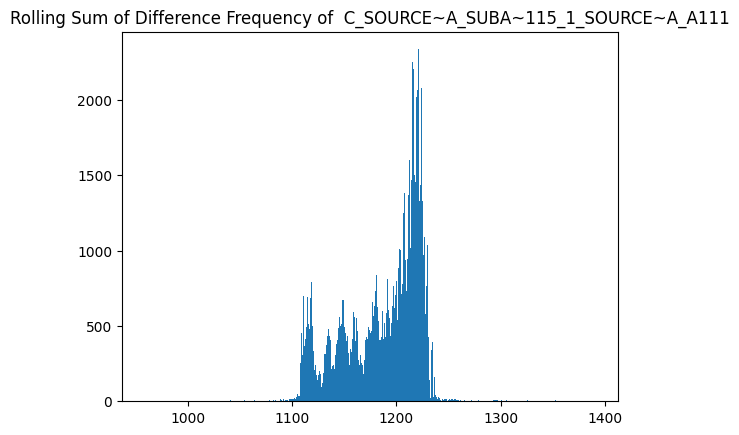

******************************************************************************


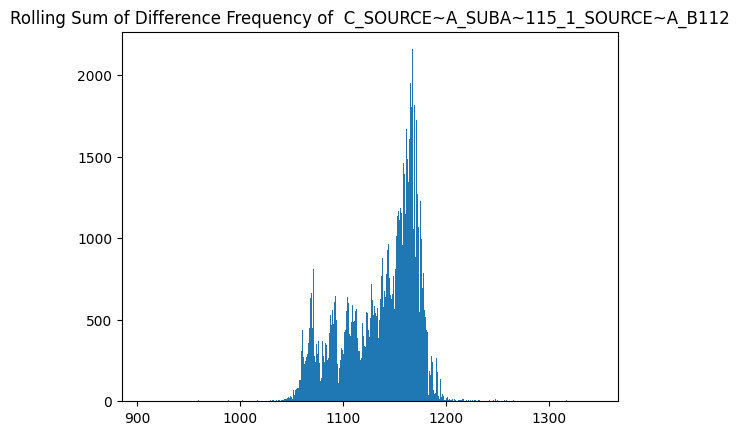

******************************************************************************


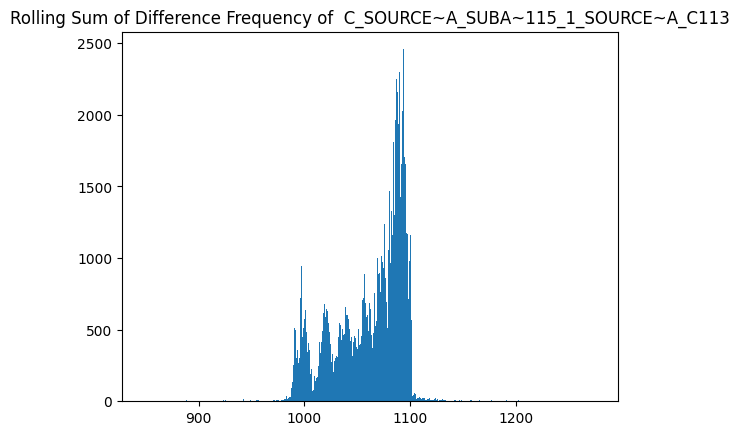

******************************************************************************


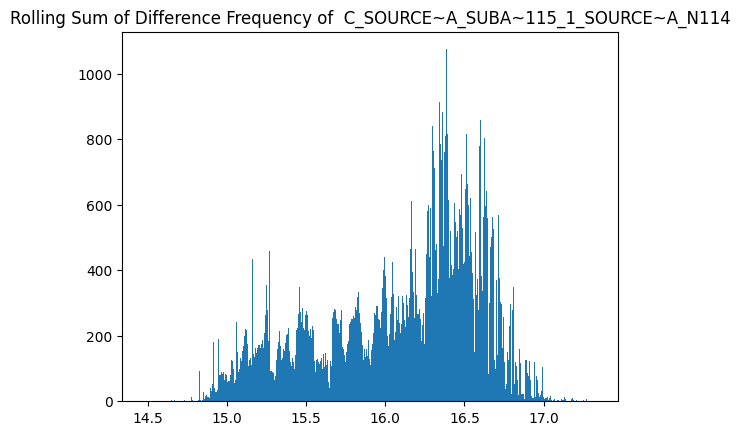

******************************************************************************


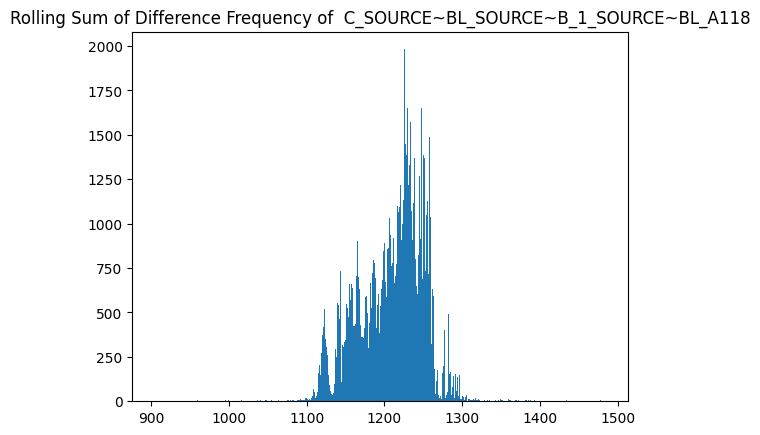

******************************************************************************


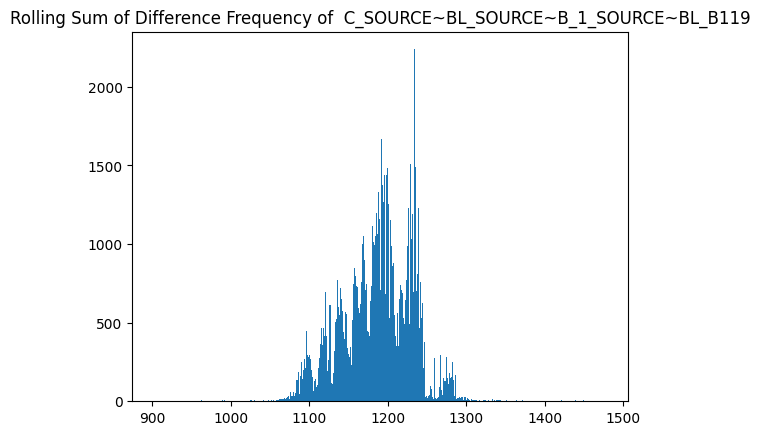

******************************************************************************


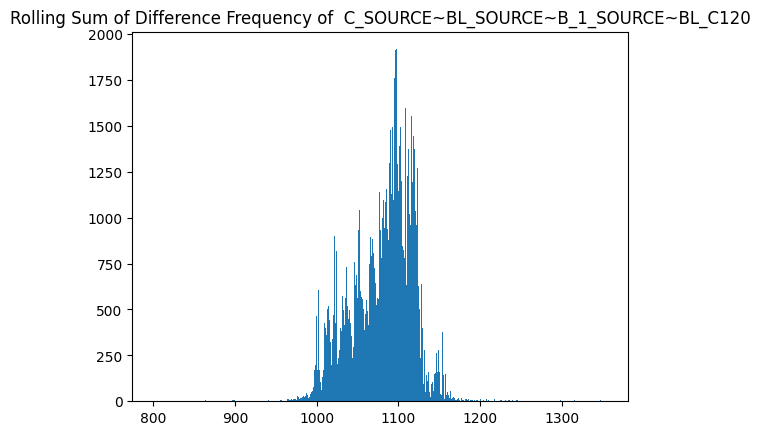

******************************************************************************


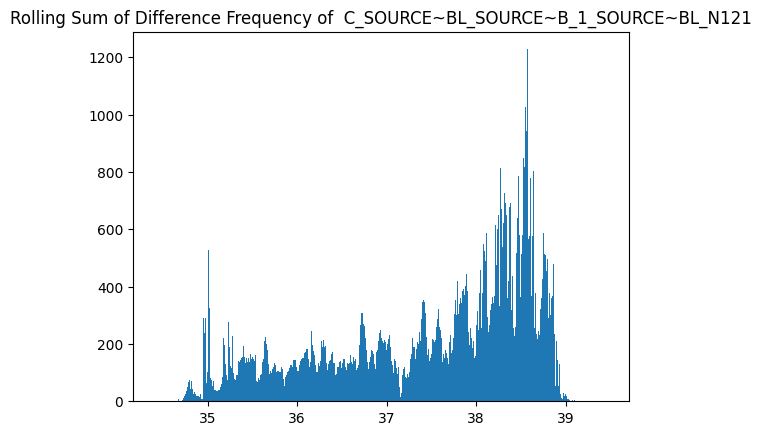

******************************************************************************


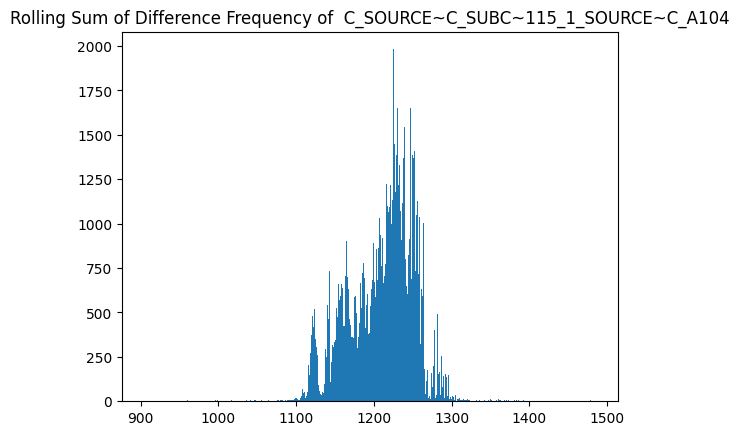

******************************************************************************


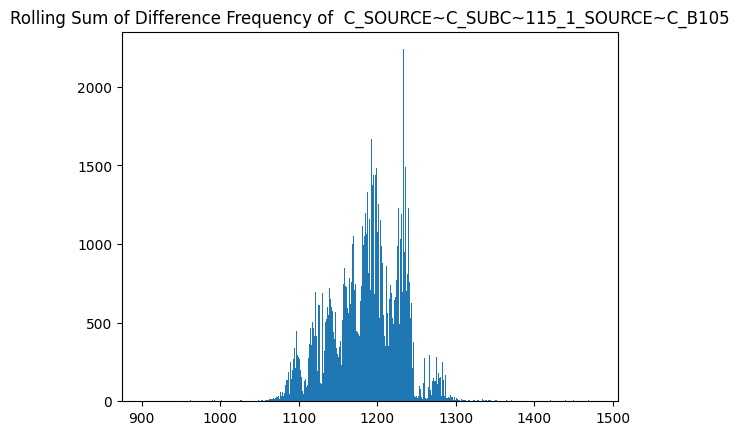

******************************************************************************


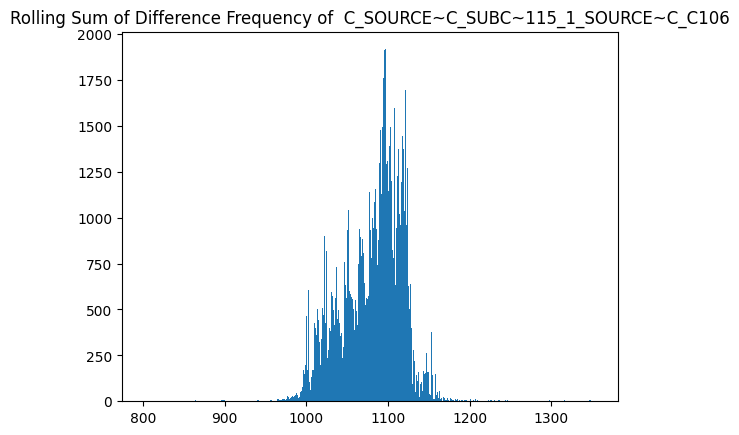

******************************************************************************


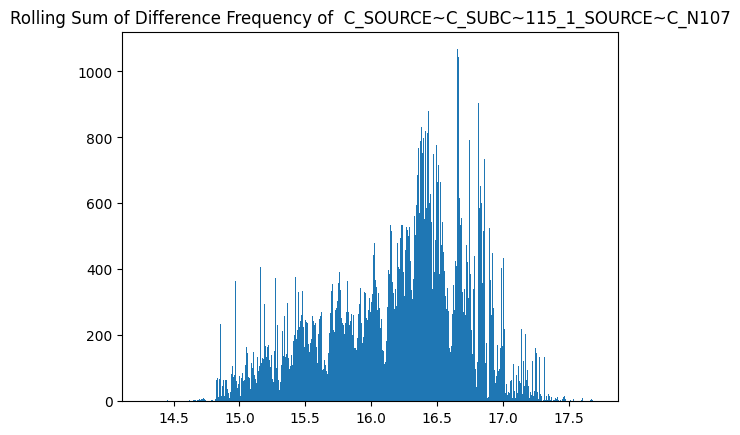

******************************************************************************


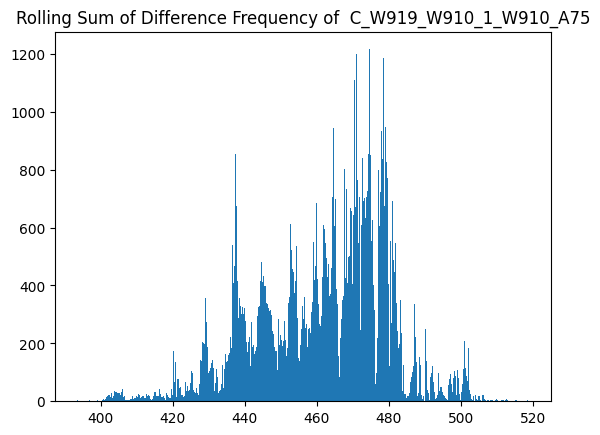

******************************************************************************


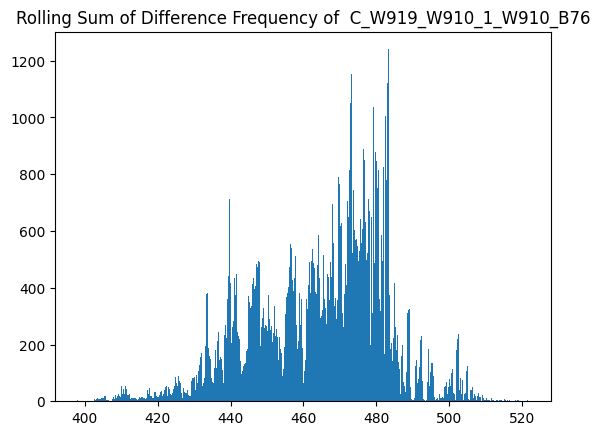

******************************************************************************


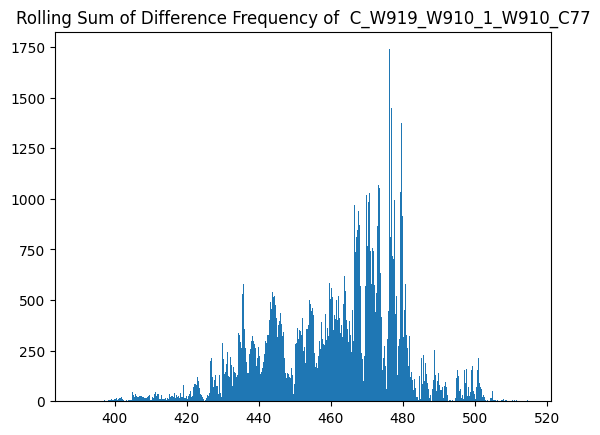

******************************************************************************


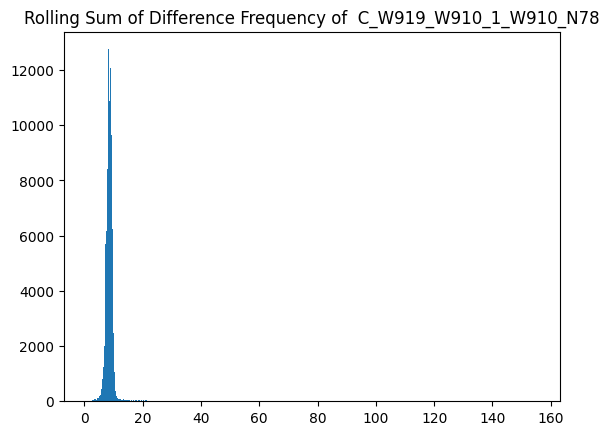

******************************************************************************


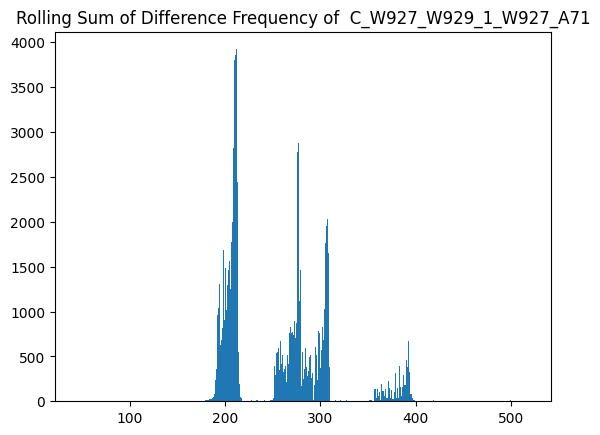

******************************************************************************


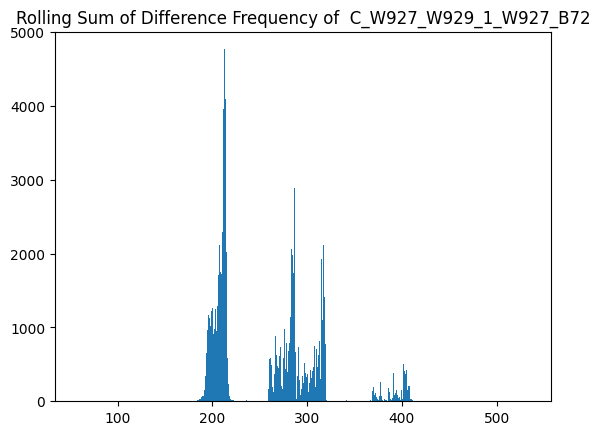

******************************************************************************


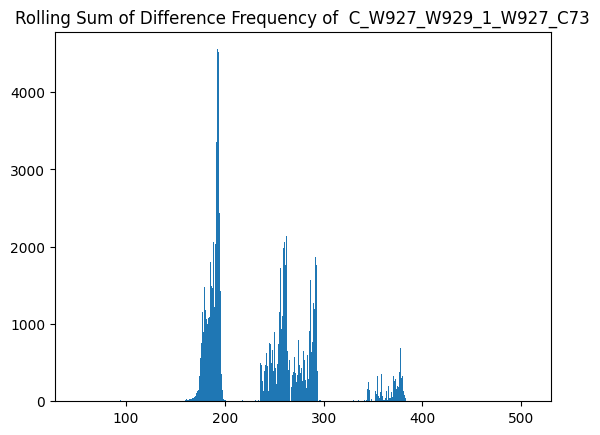

******************************************************************************


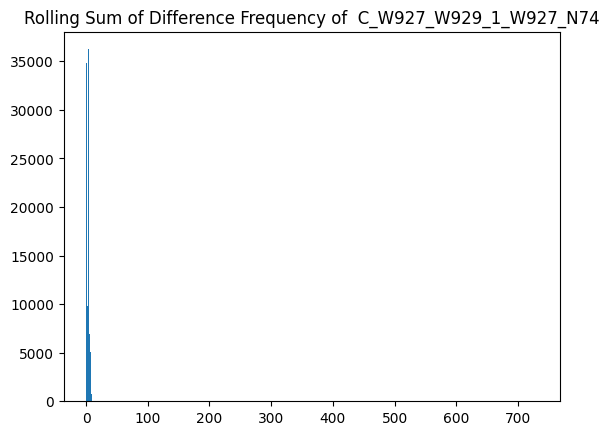

******************************************************************************


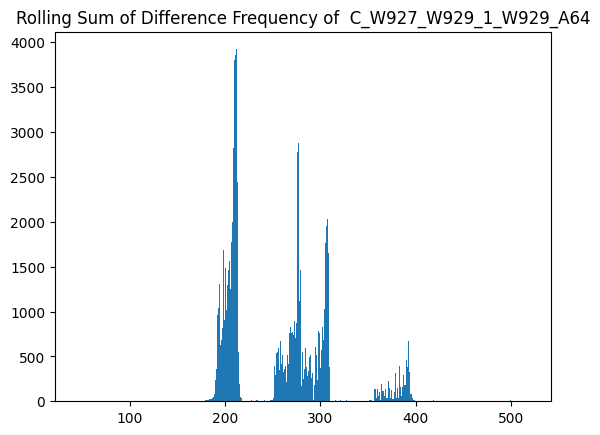

******************************************************************************


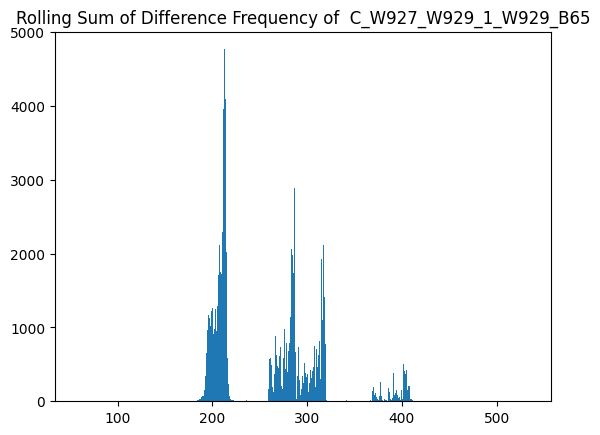

******************************************************************************


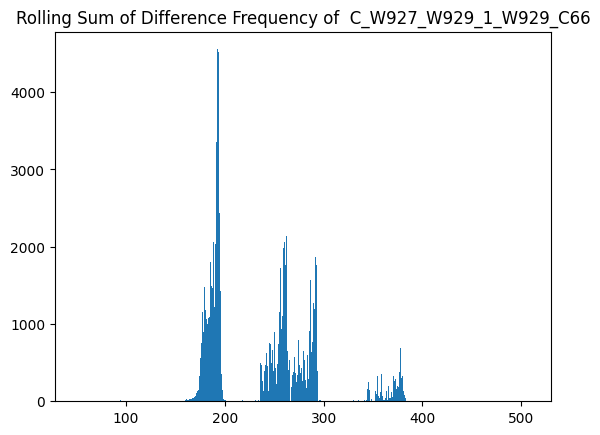

******************************************************************************


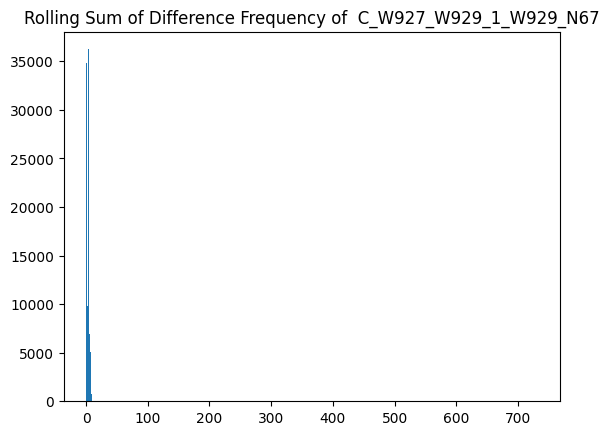

******************************************************************************


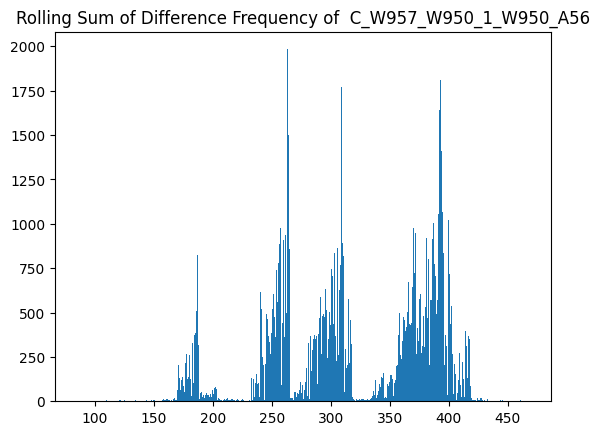

******************************************************************************


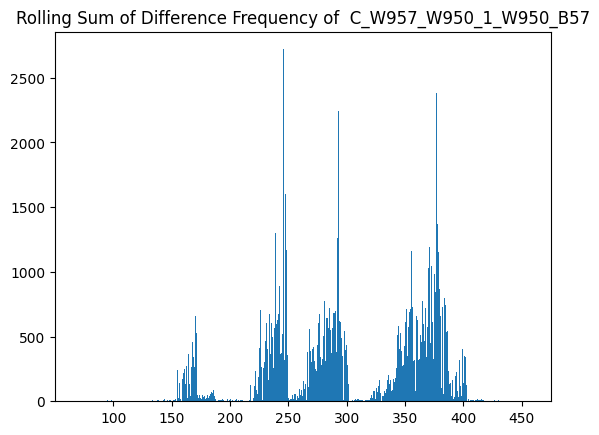

******************************************************************************


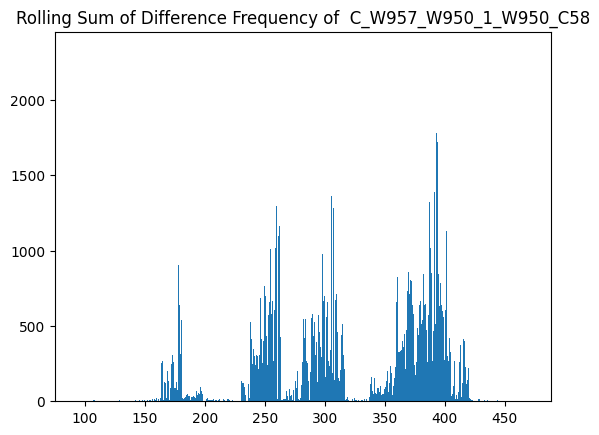

******************************************************************************


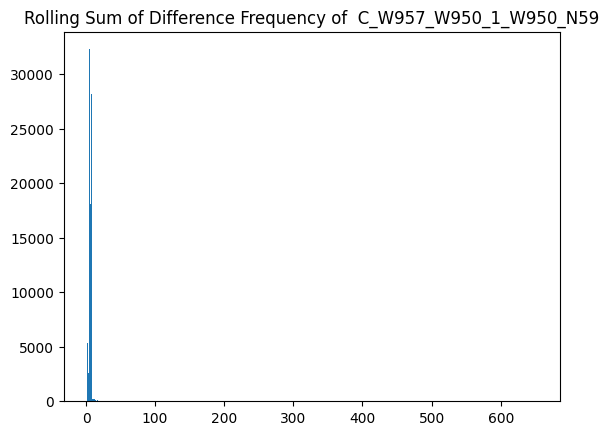

******************************************************************************


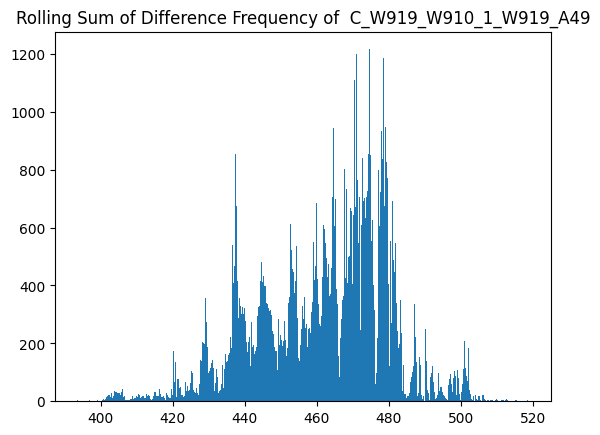

******************************************************************************


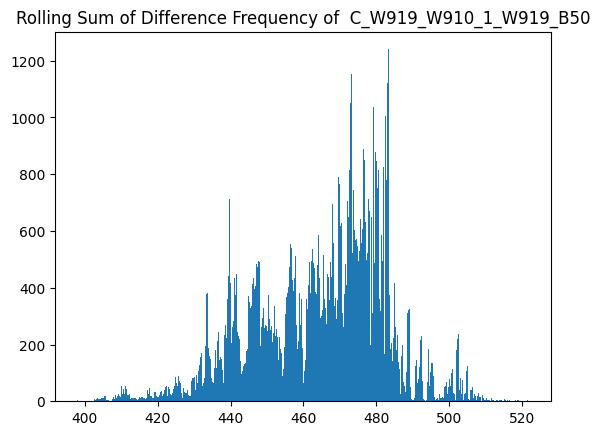

******************************************************************************


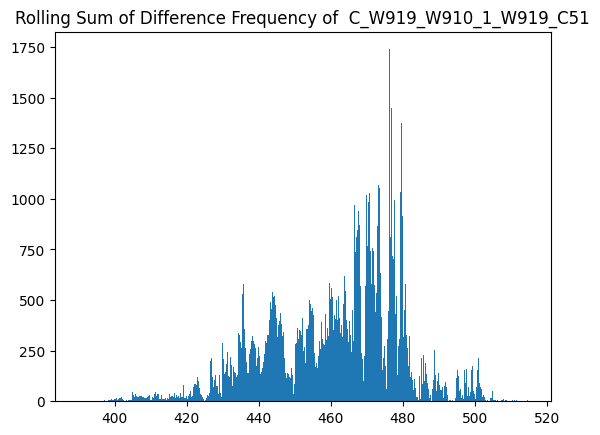

******************************************************************************


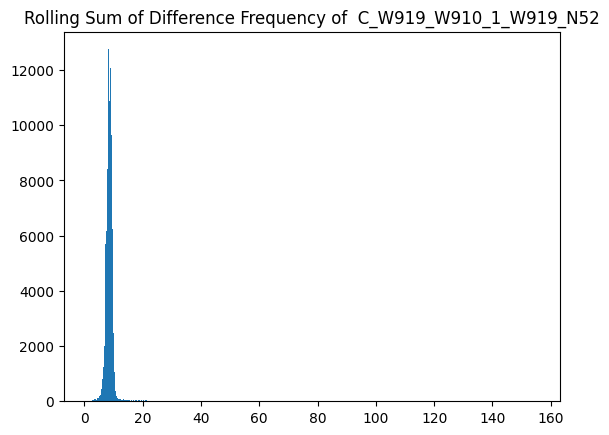

******************************************************************************


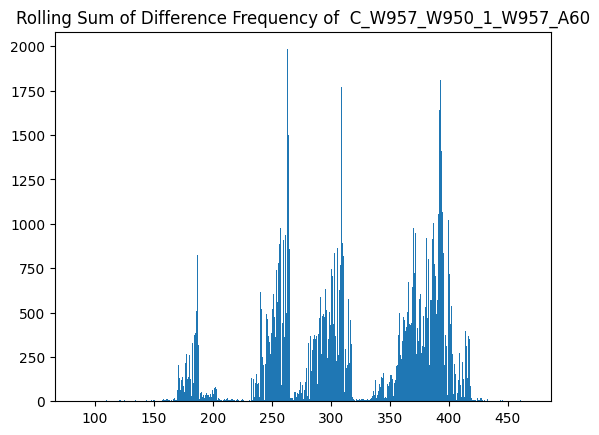

******************************************************************************


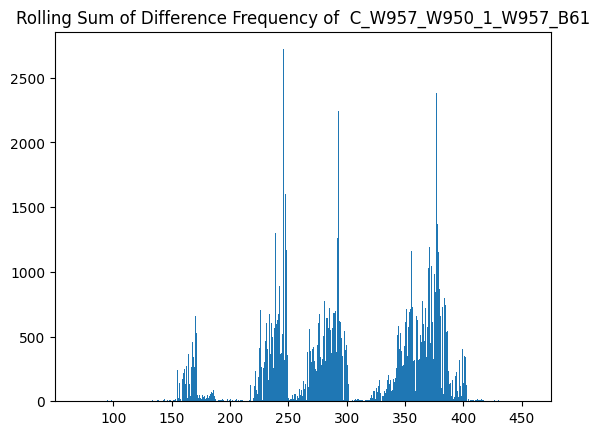

******************************************************************************


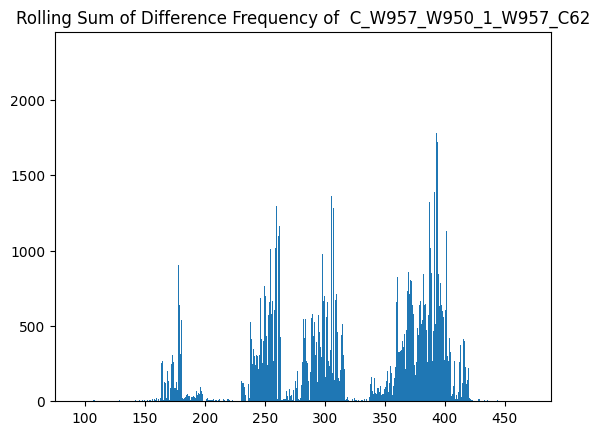

******************************************************************************


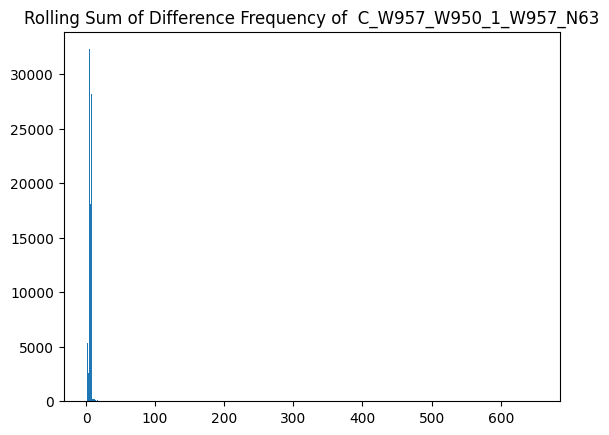

******************************************************************************


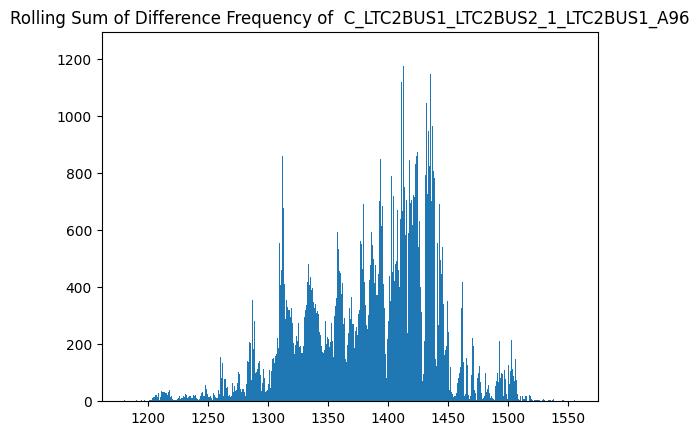

******************************************************************************


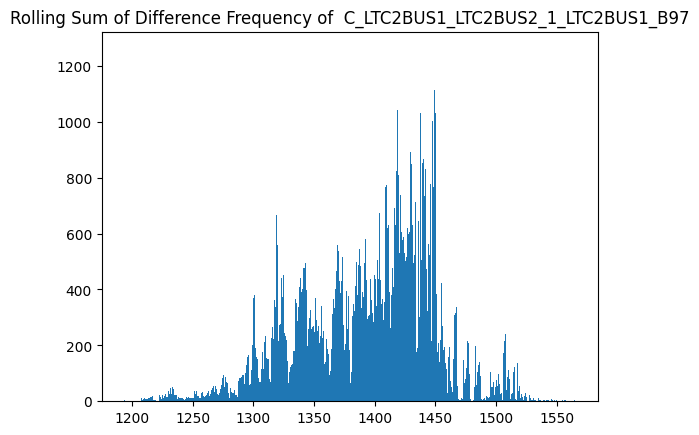

******************************************************************************


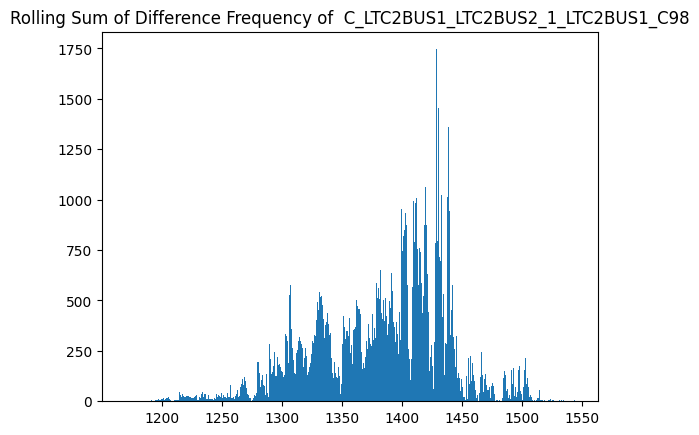

******************************************************************************


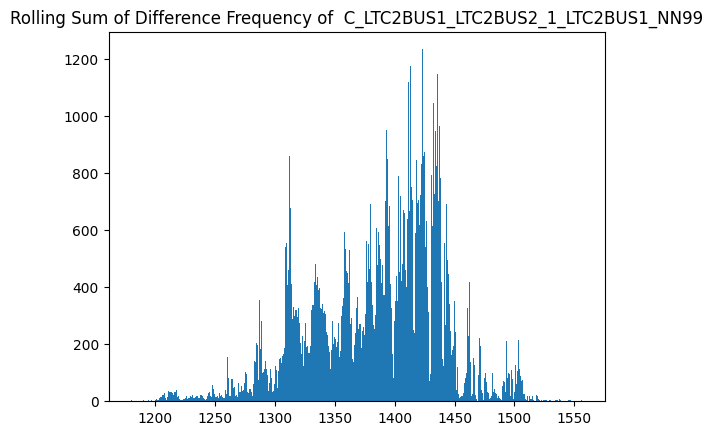

******************************************************************************


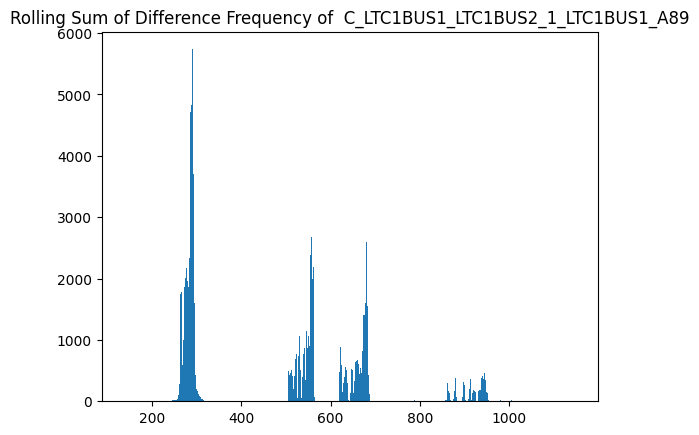

******************************************************************************


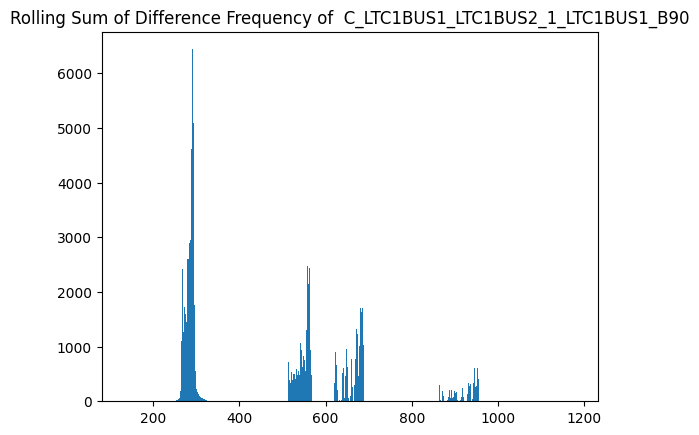

******************************************************************************


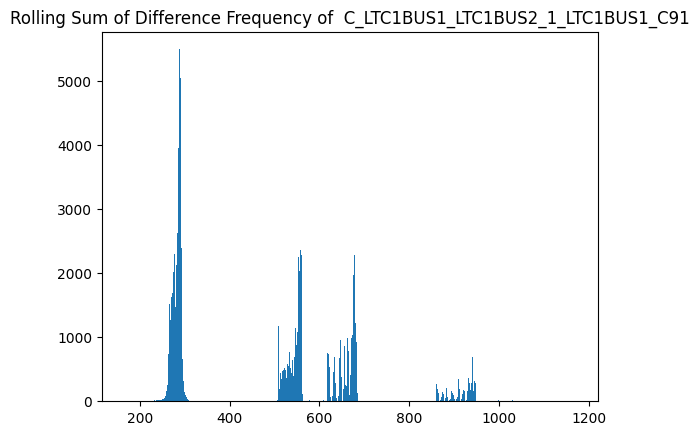

******************************************************************************


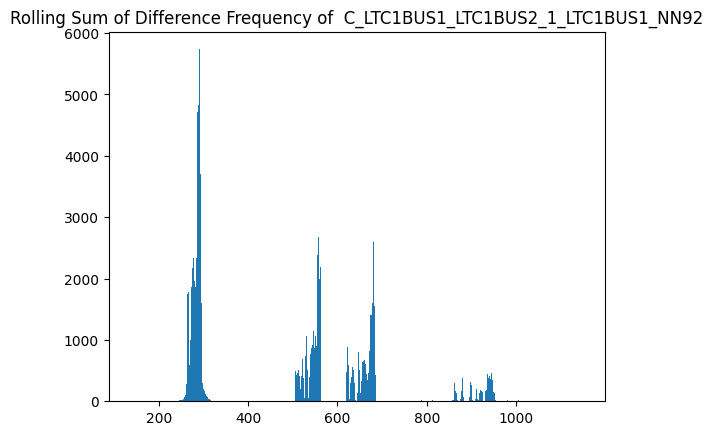

******************************************************************************


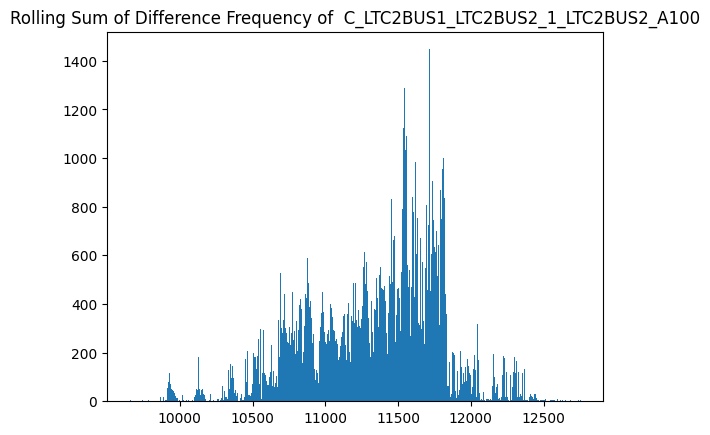

******************************************************************************


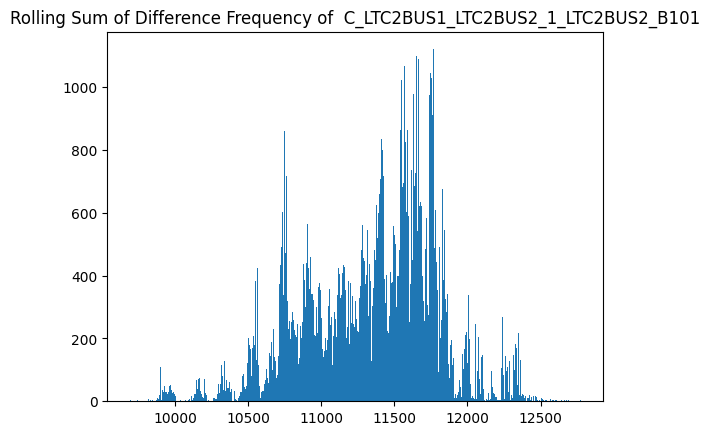

******************************************************************************


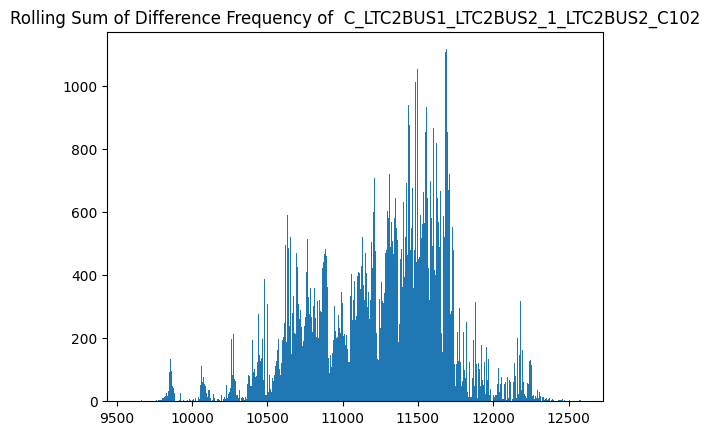

******************************************************************************


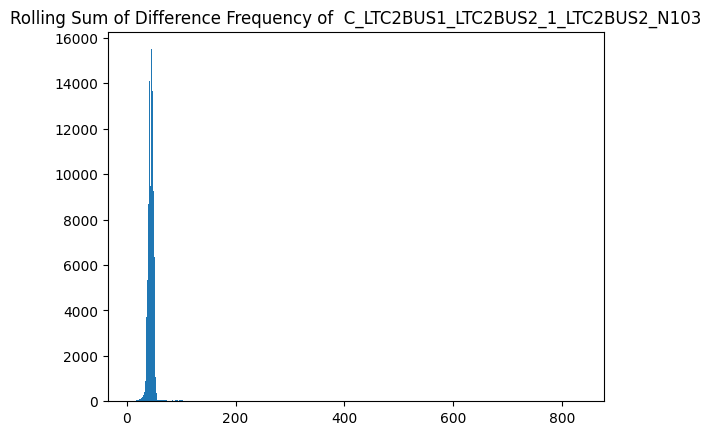

******************************************************************************


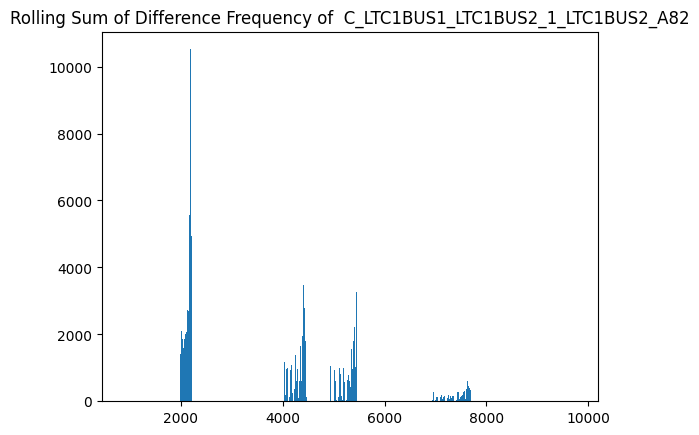

******************************************************************************


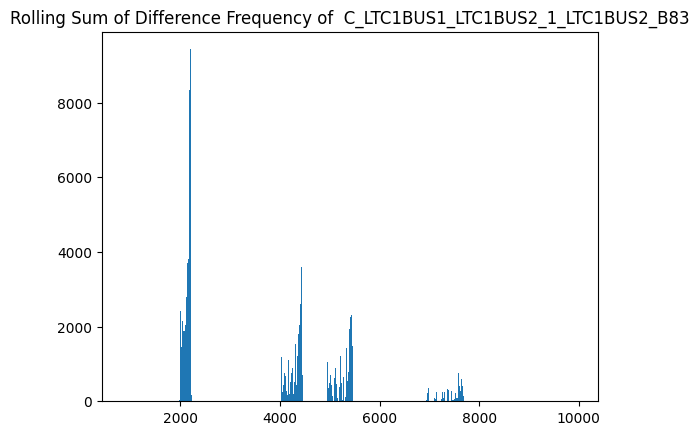

******************************************************************************


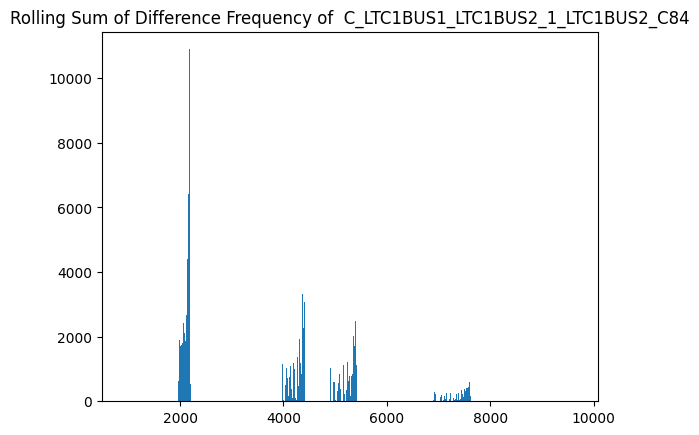

******************************************************************************


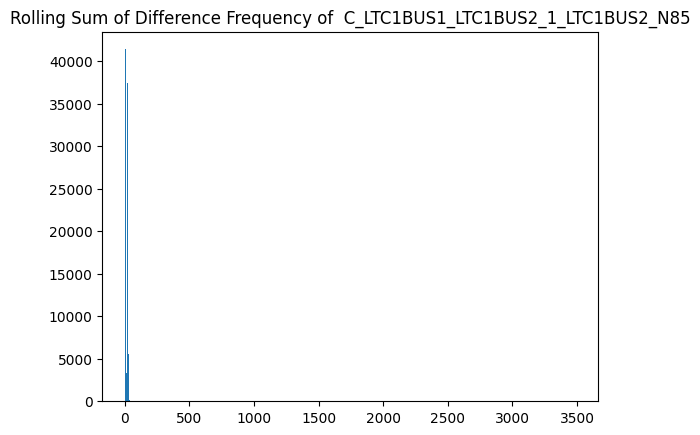

******************************************************************************


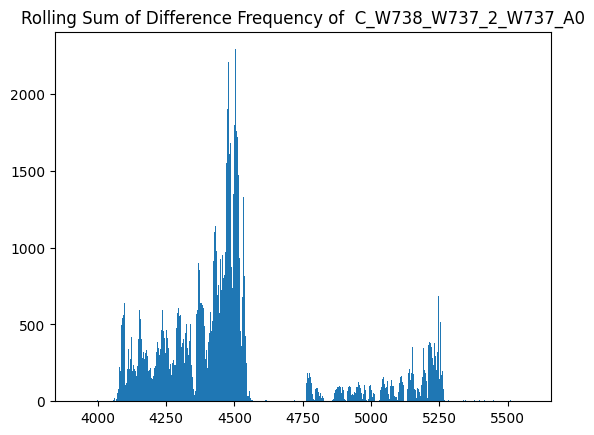

******************************************************************************


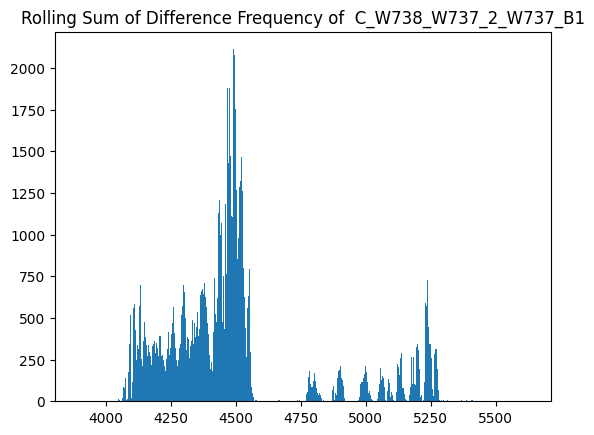

******************************************************************************


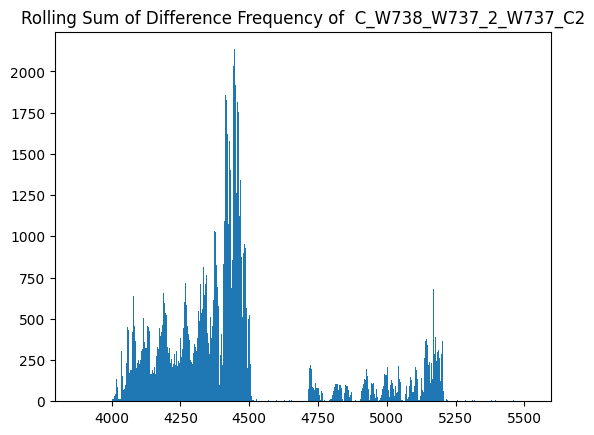

******************************************************************************


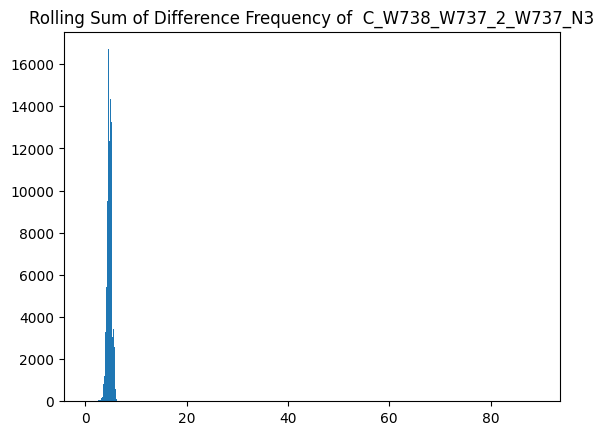

******************************************************************************


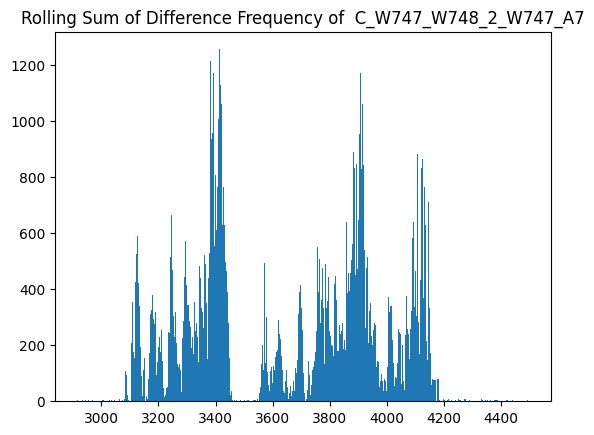

******************************************************************************


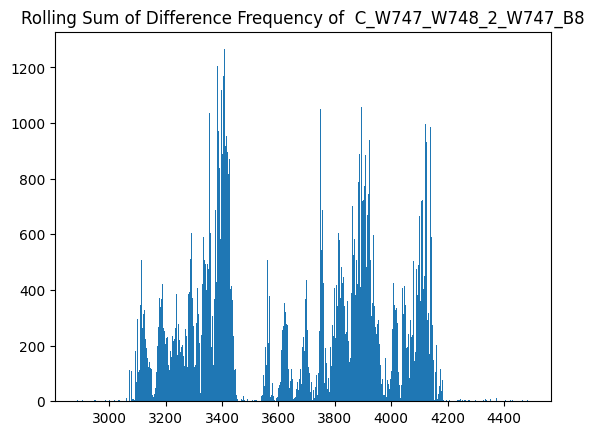

******************************************************************************


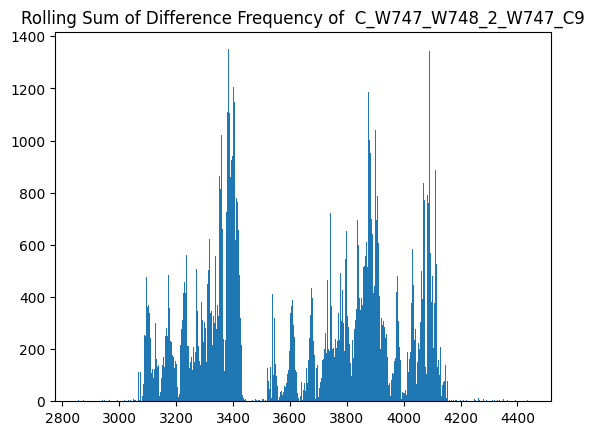

******************************************************************************


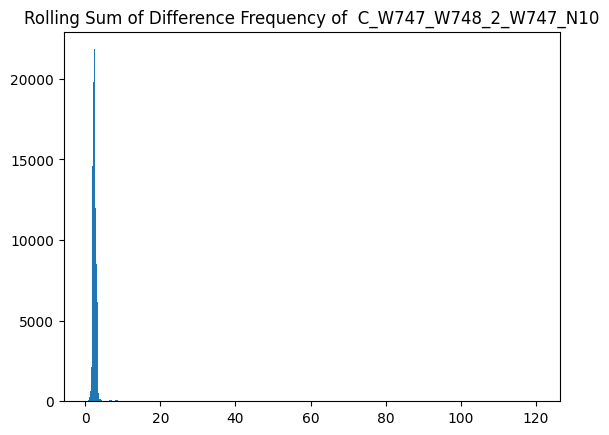

******************************************************************************


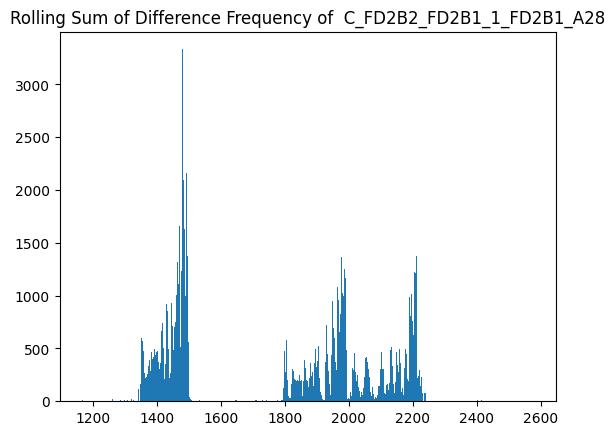

******************************************************************************


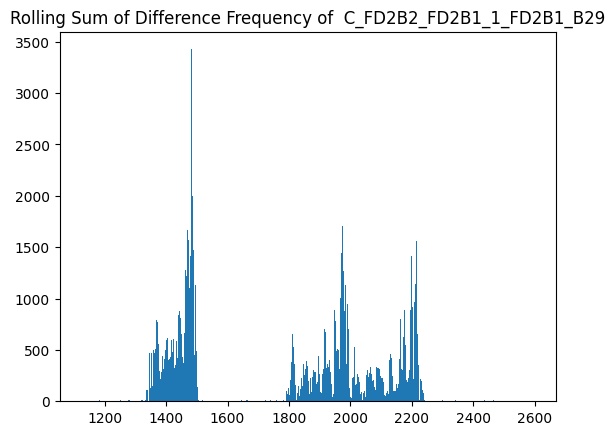

******************************************************************************


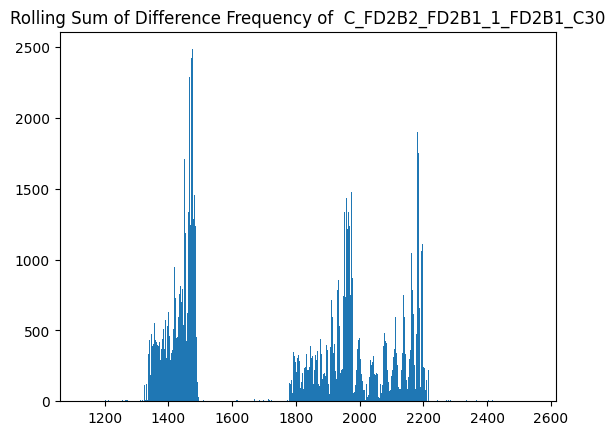

******************************************************************************


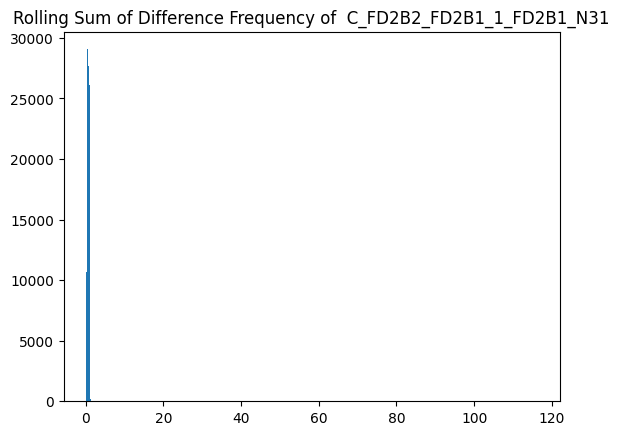

******************************************************************************


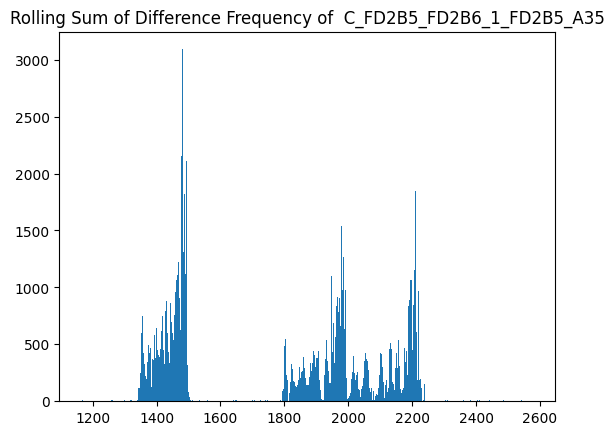

******************************************************************************


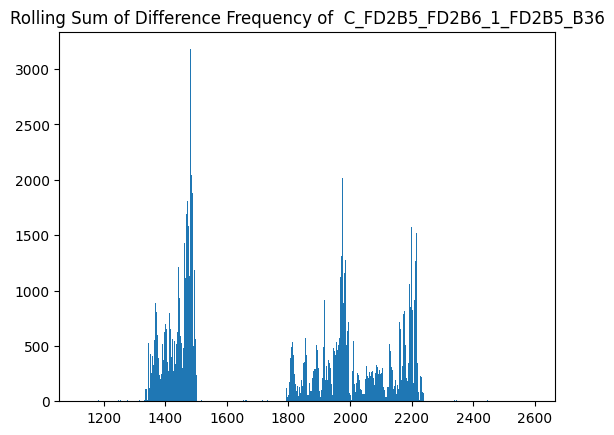

******************************************************************************


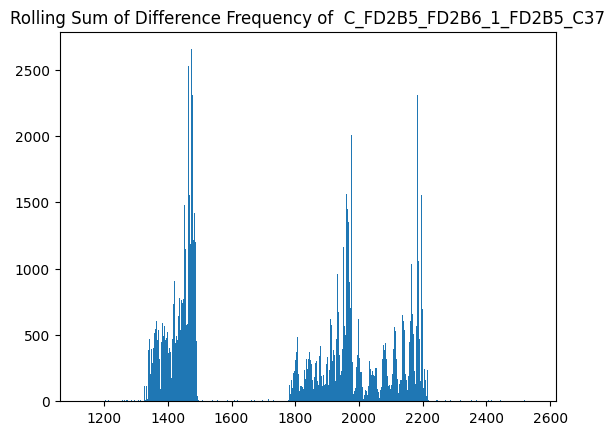

******************************************************************************


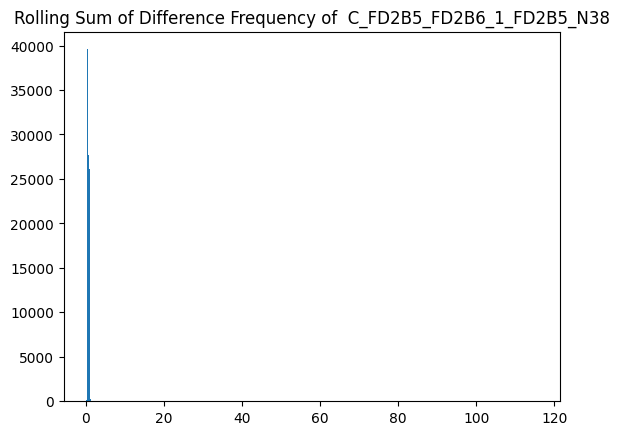

******************************************************************************


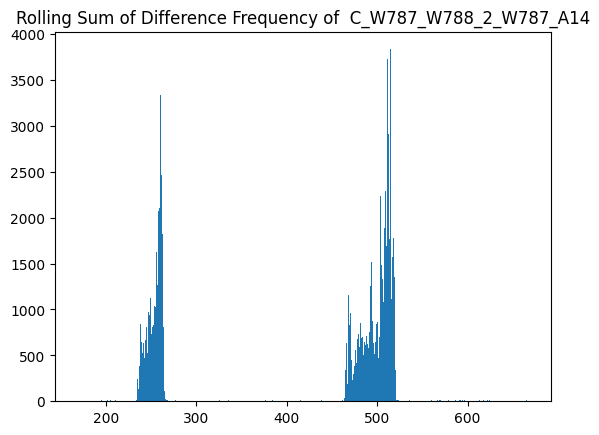

******************************************************************************


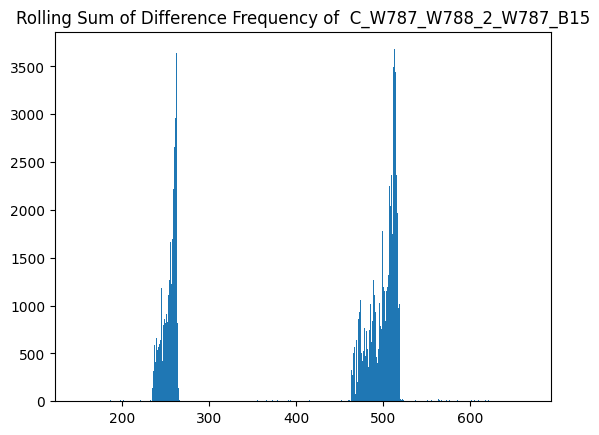

******************************************************************************


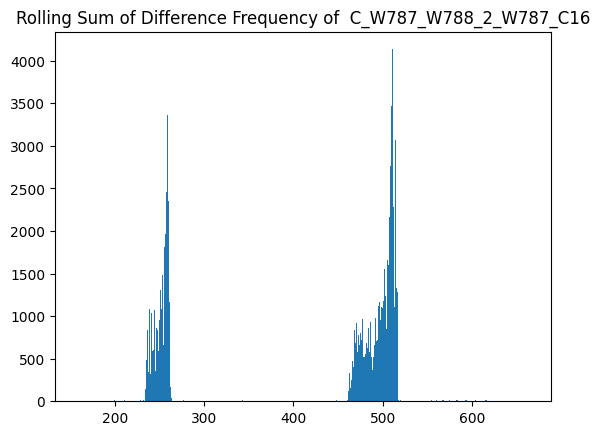

******************************************************************************


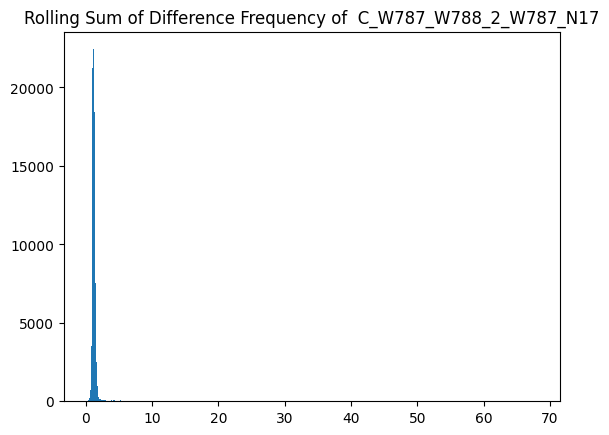

******************************************************************************


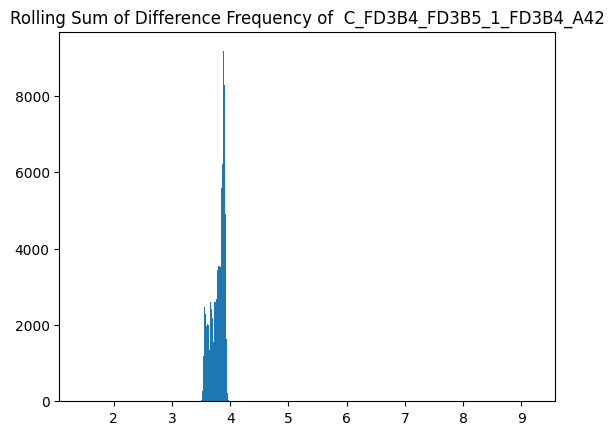

******************************************************************************


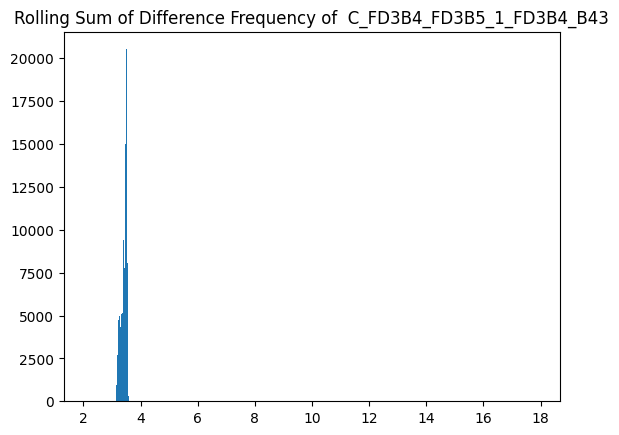

******************************************************************************


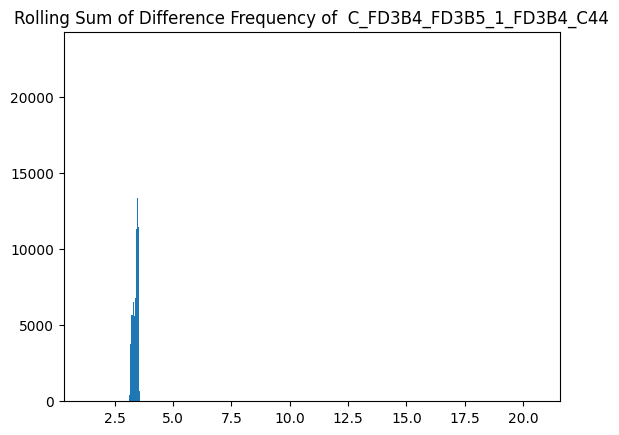

******************************************************************************


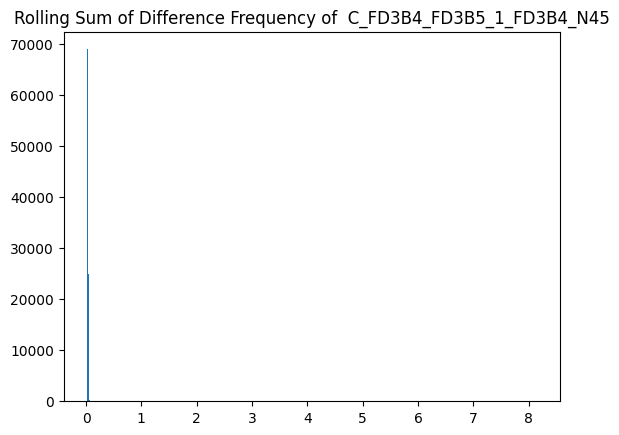

******************************************************************************


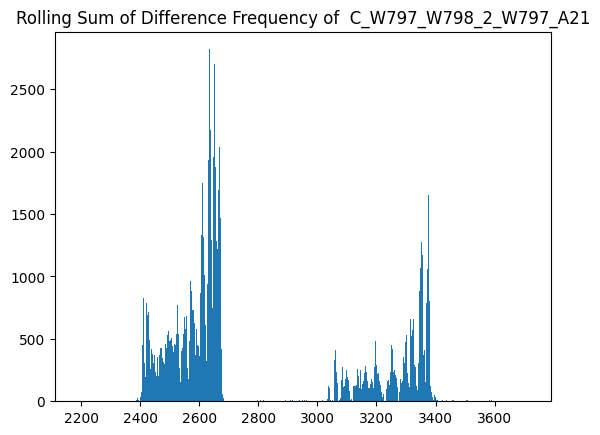

******************************************************************************


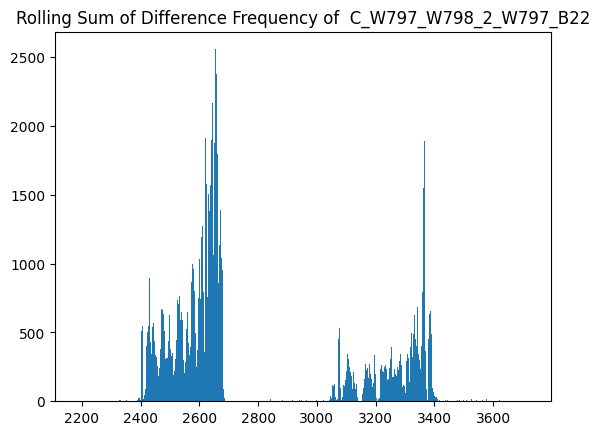

******************************************************************************


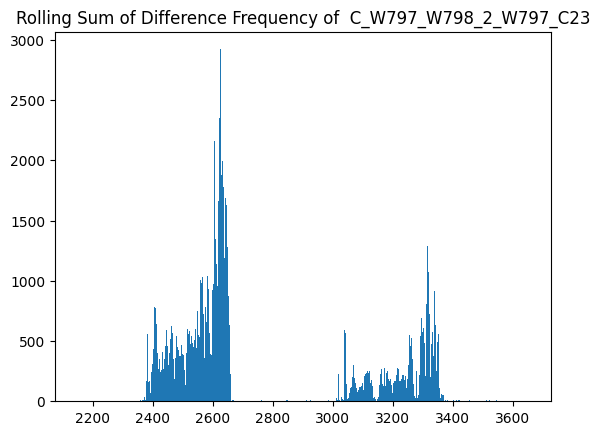

******************************************************************************


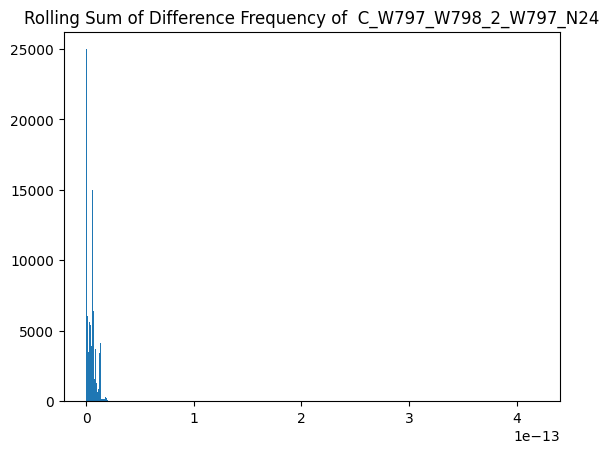

******************************************************************************


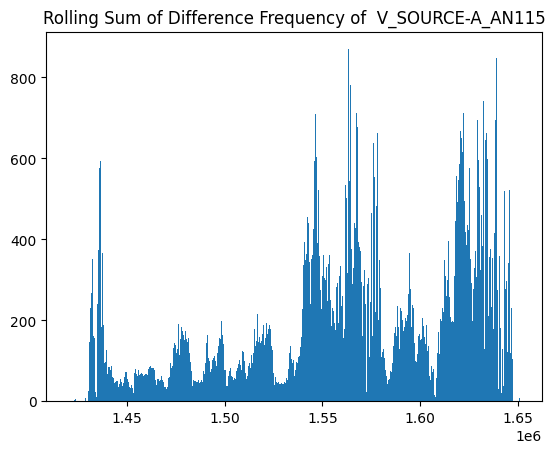

******************************************************************************


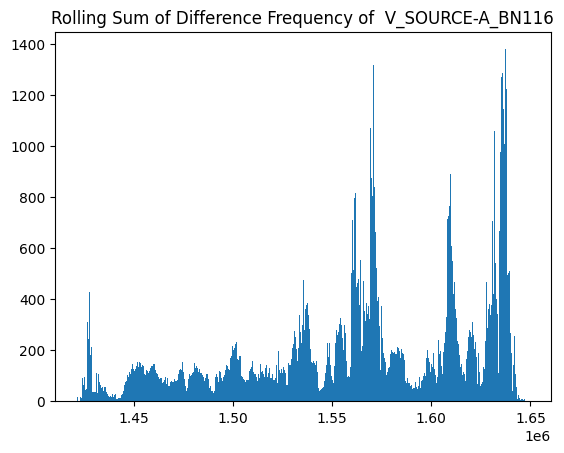

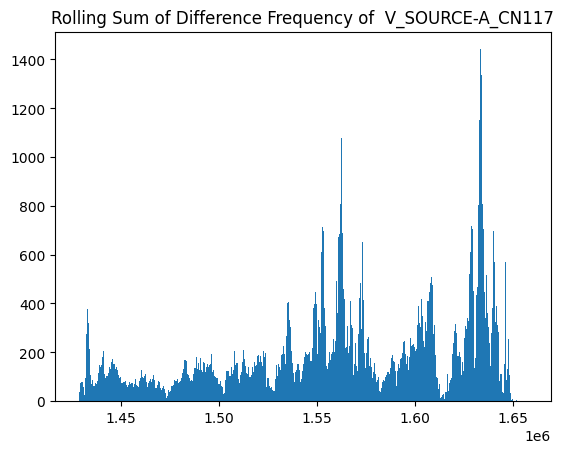

******************************************************************************


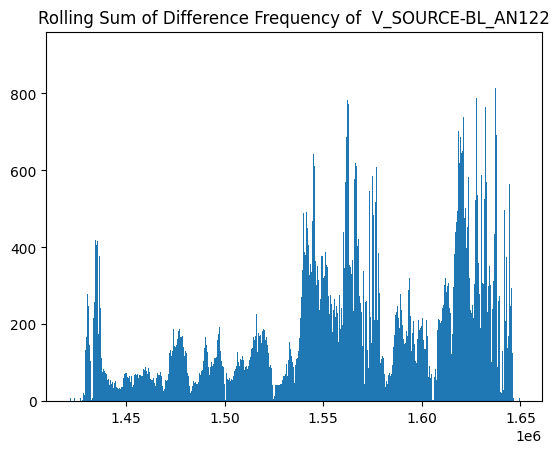

******************************************************************************


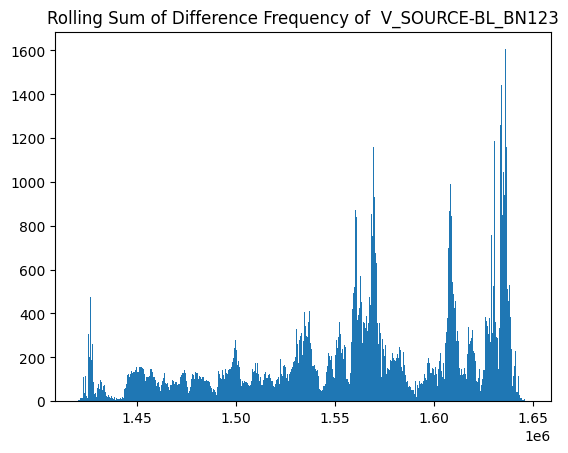

******************************************************************************


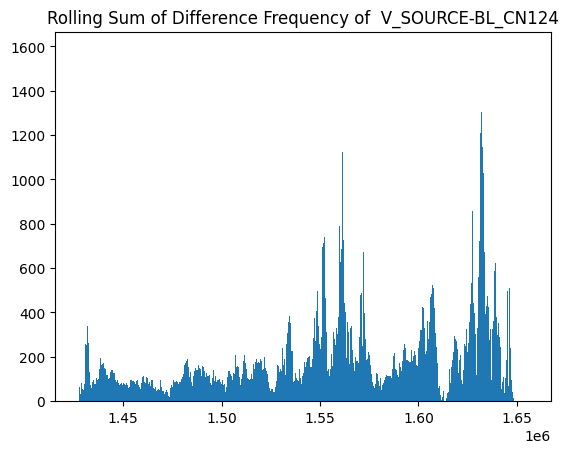

******************************************************************************


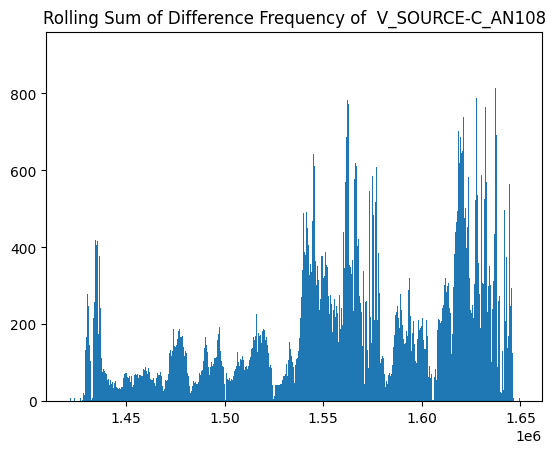

******************************************************************************


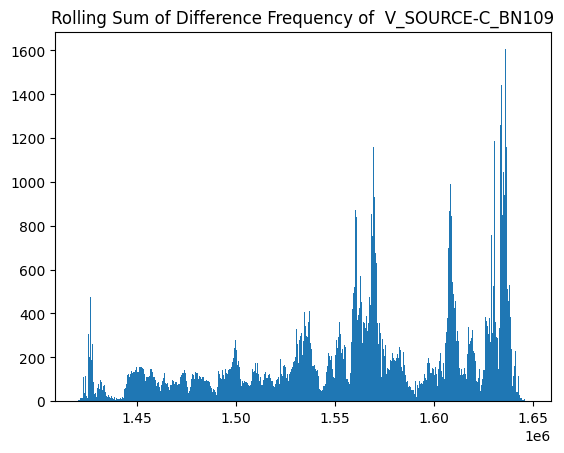

******************************************************************************


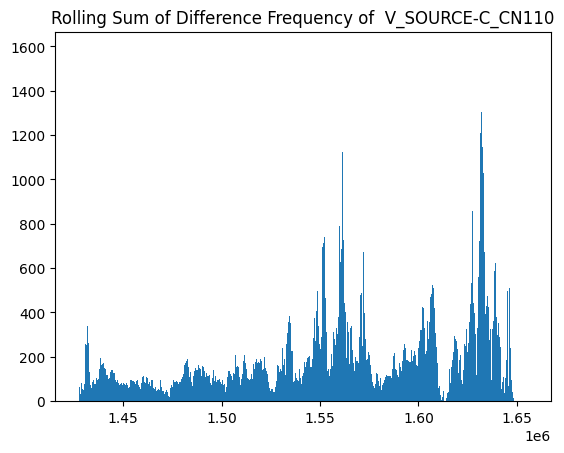

******************************************************************************


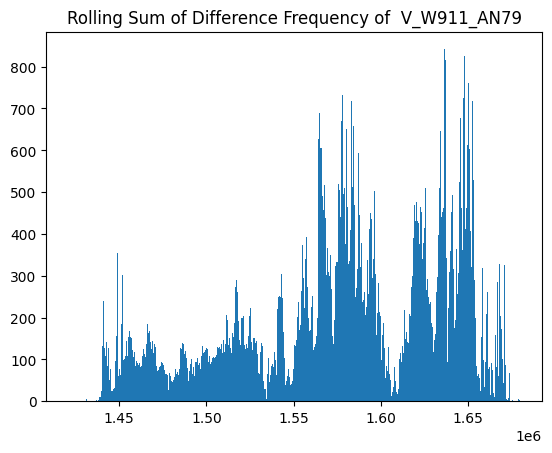

******************************************************************************


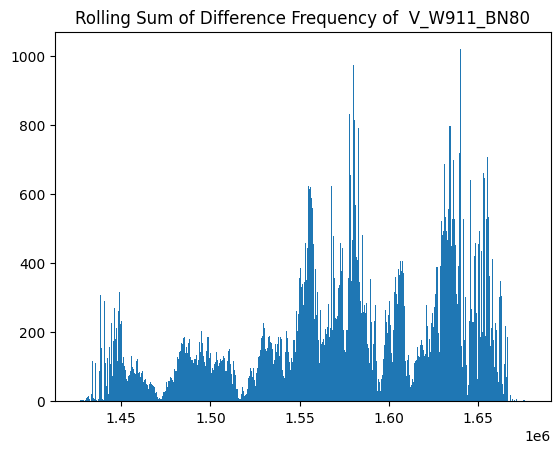

******************************************************************************


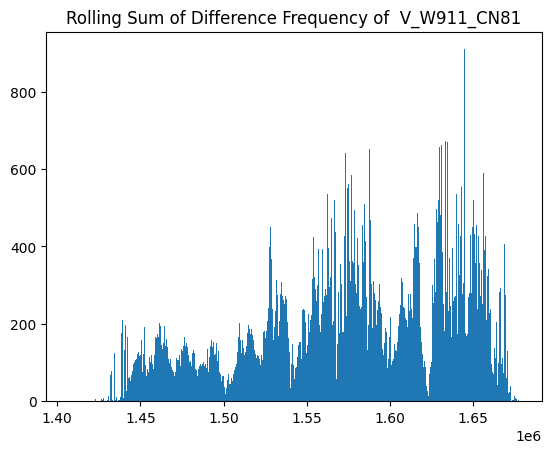

******************************************************************************


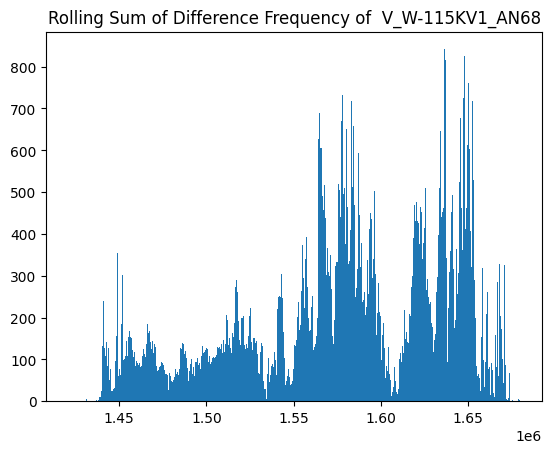

******************************************************************************


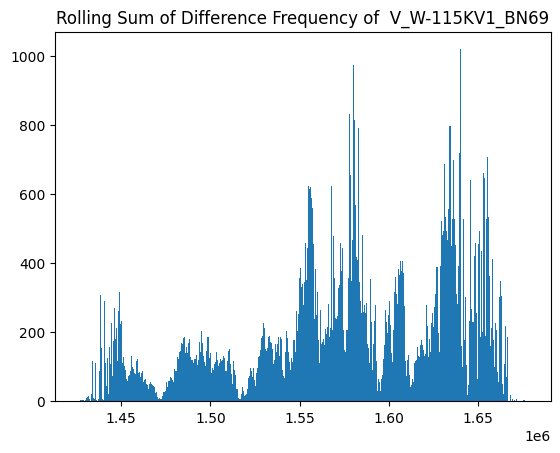

******************************************************************************


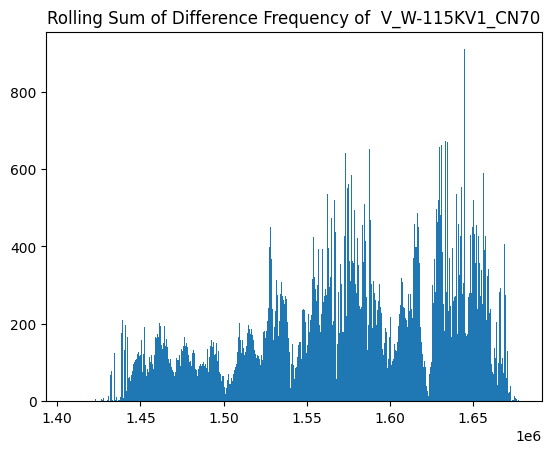

******************************************************************************


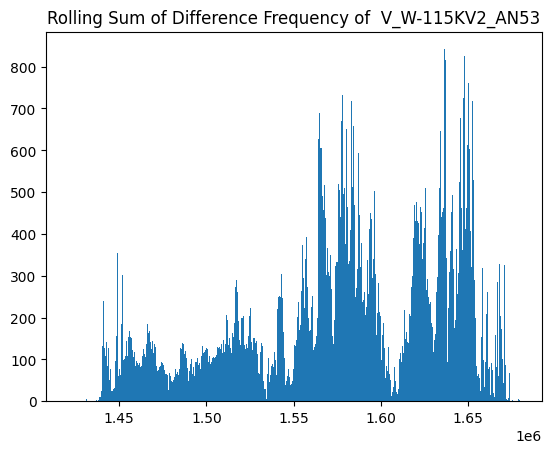

******************************************************************************


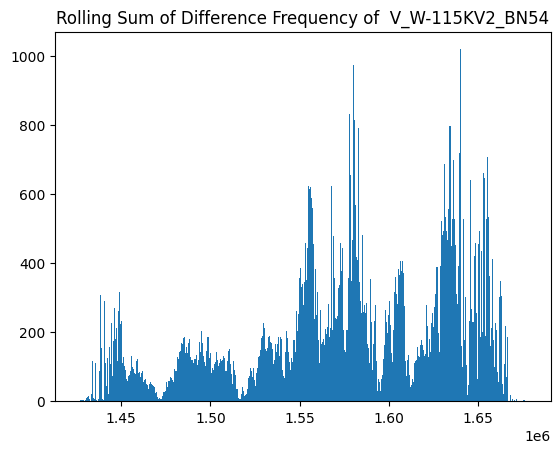

******************************************************************************


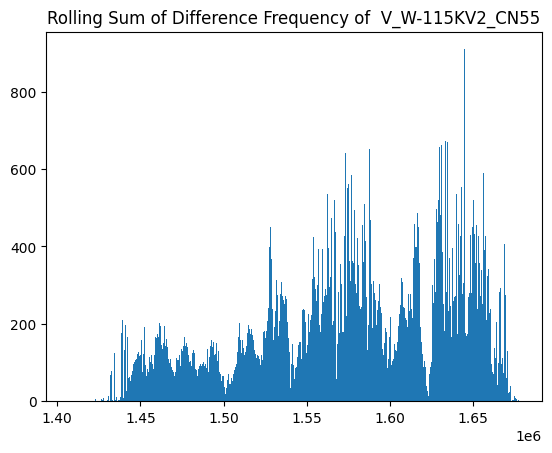

******************************************************************************


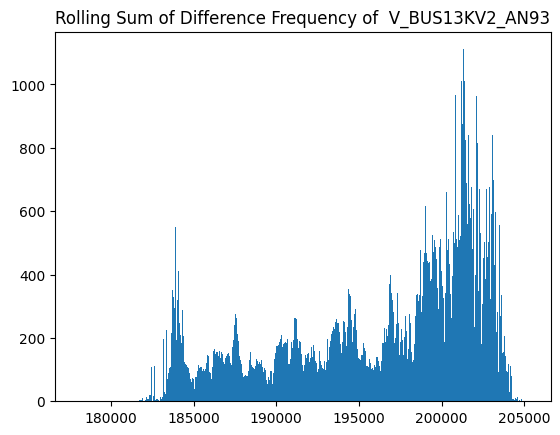

******************************************************************************


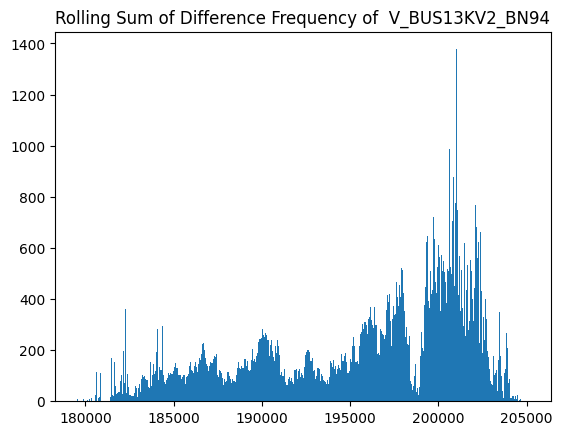

******************************************************************************


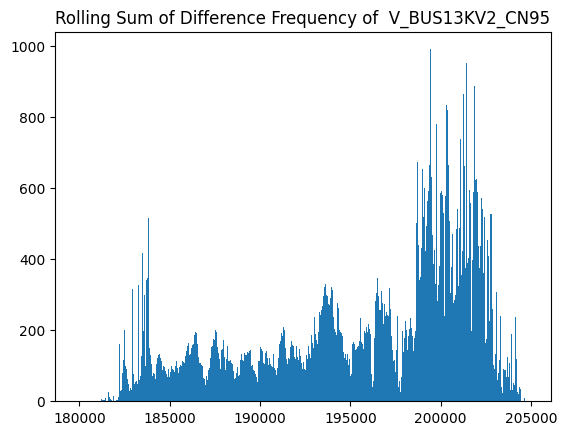

******************************************************************************


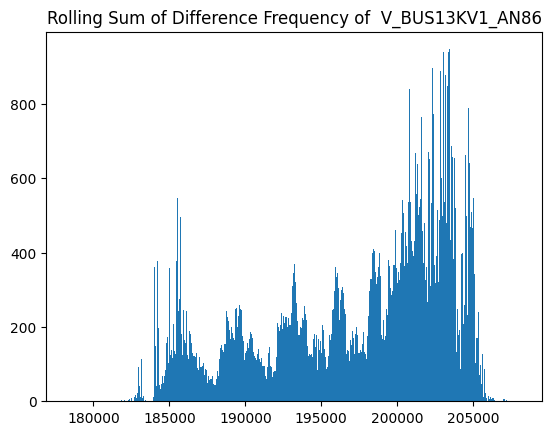

******************************************************************************


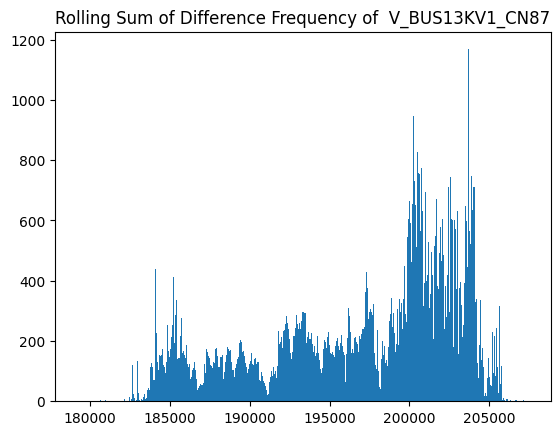

******************************************************************************


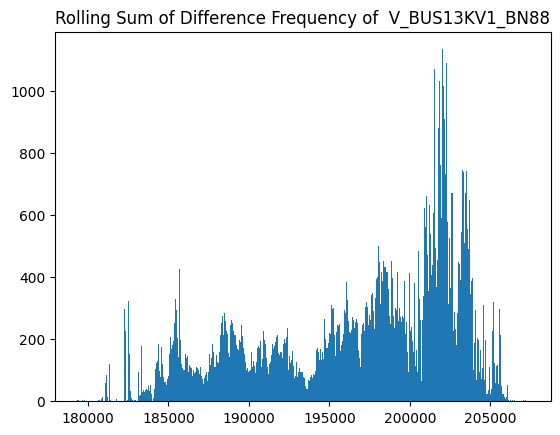

******************************************************************************


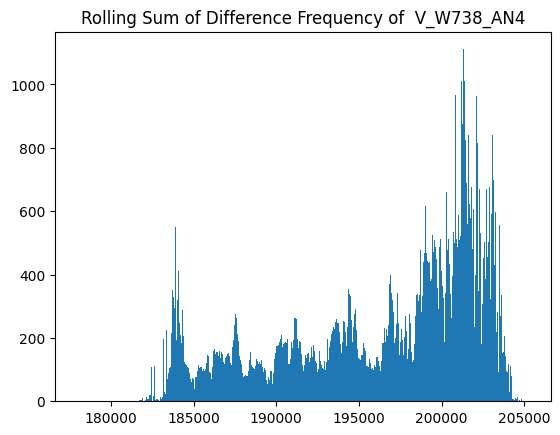

******************************************************************************


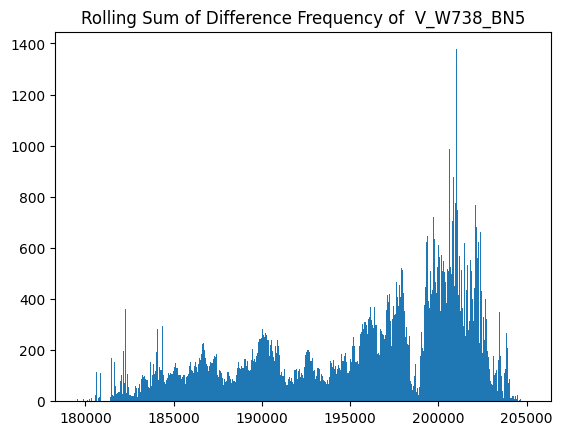

******************************************************************************


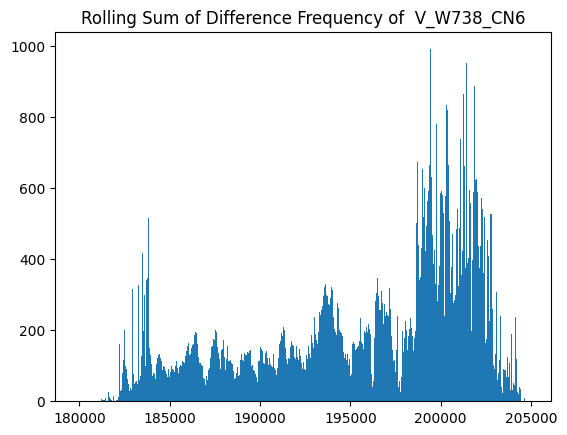

******************************************************************************


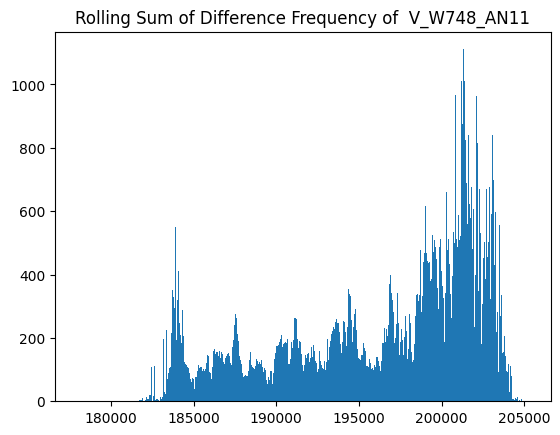

******************************************************************************


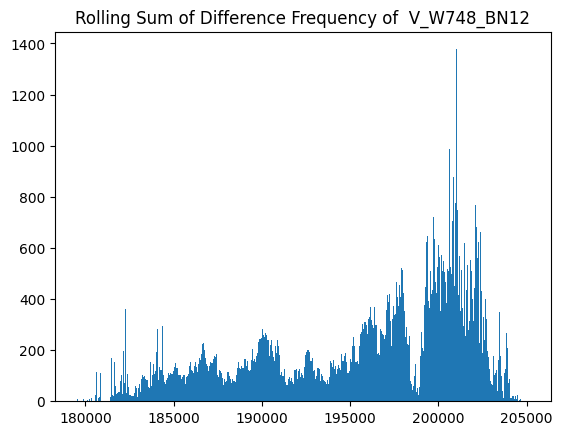

******************************************************************************


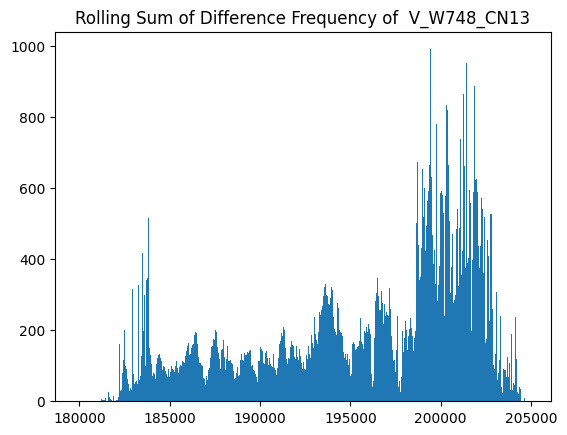

******************************************************************************


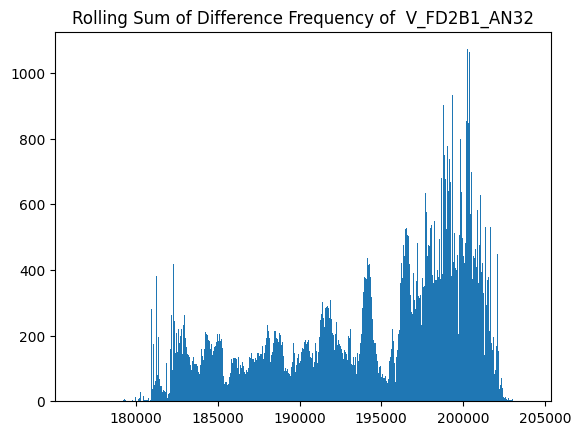

******************************************************************************


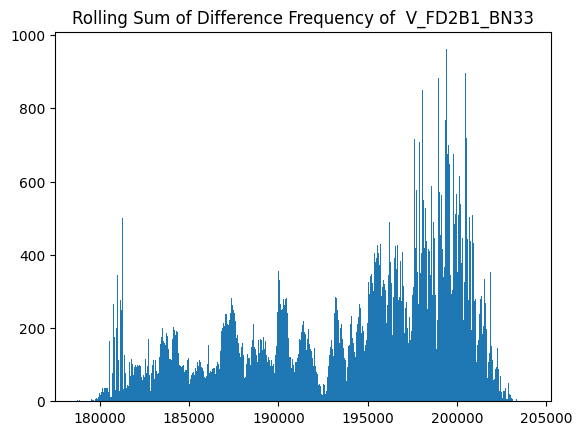

******************************************************************************


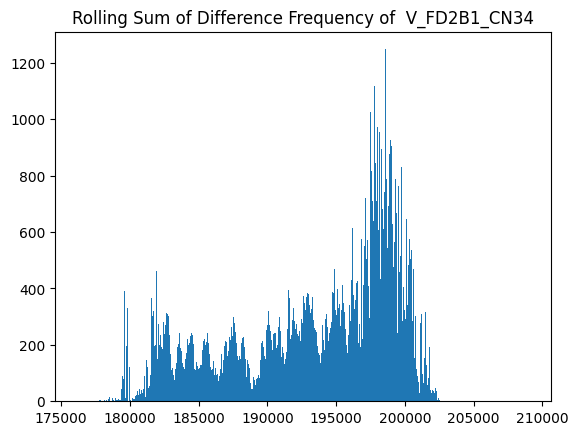

******************************************************************************


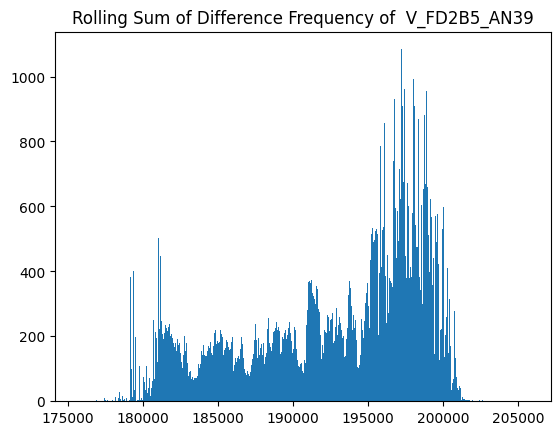

******************************************************************************


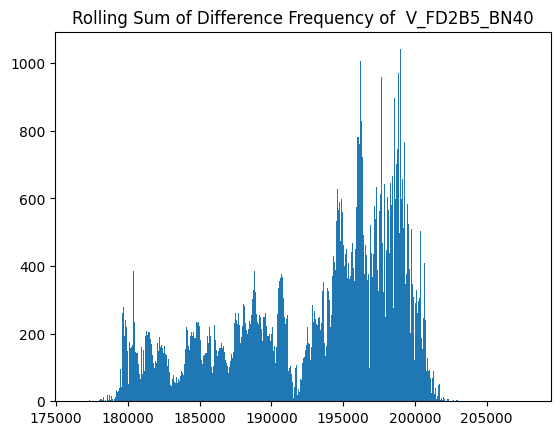

******************************************************************************


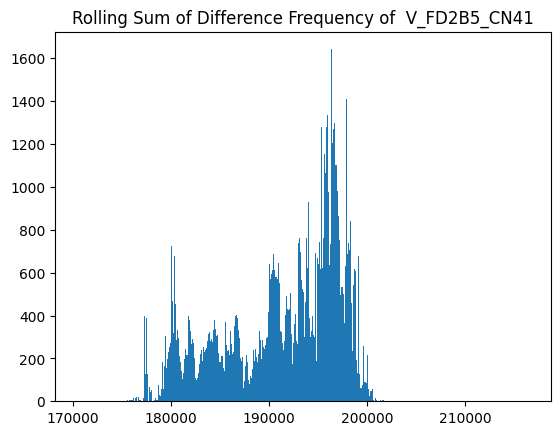

******************************************************************************


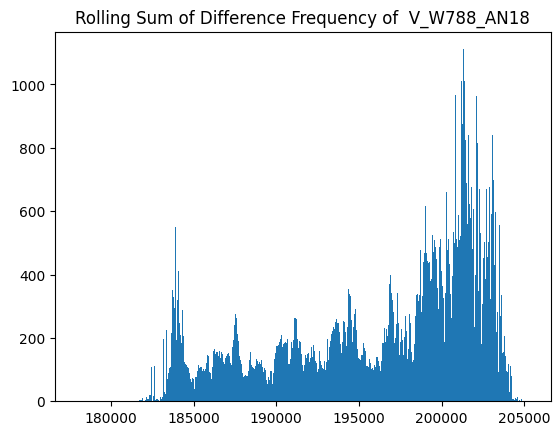

******************************************************************************


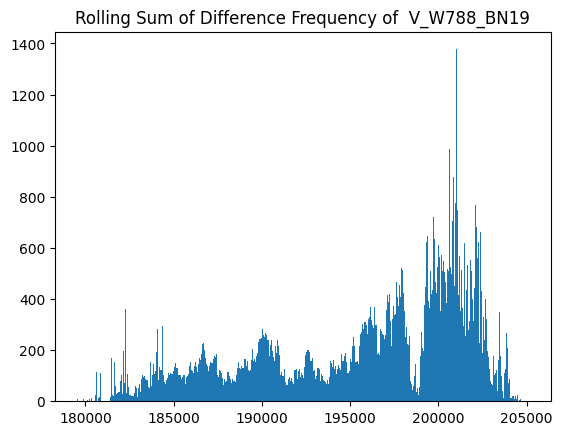

******************************************************************************


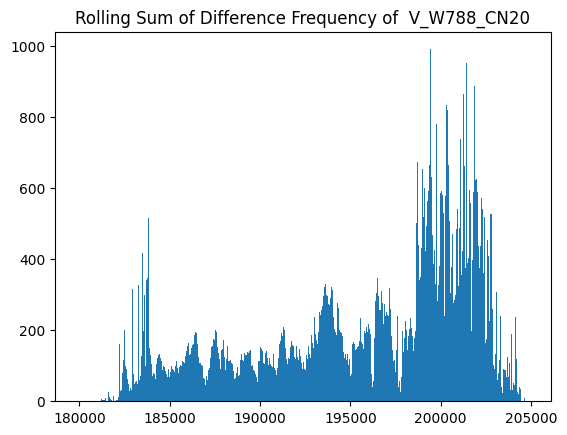

******************************************************************************


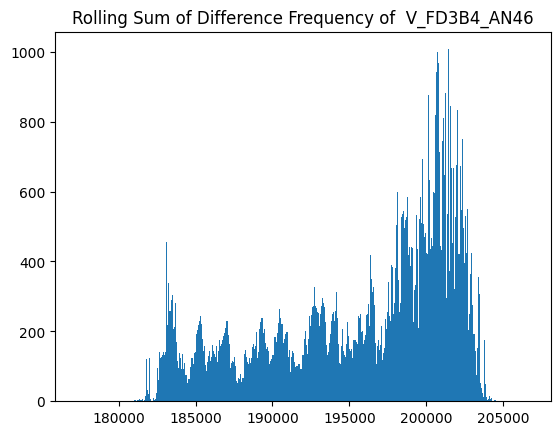

******************************************************************************


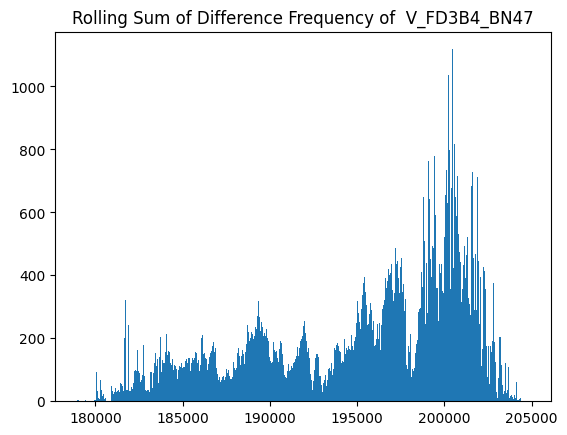

******************************************************************************


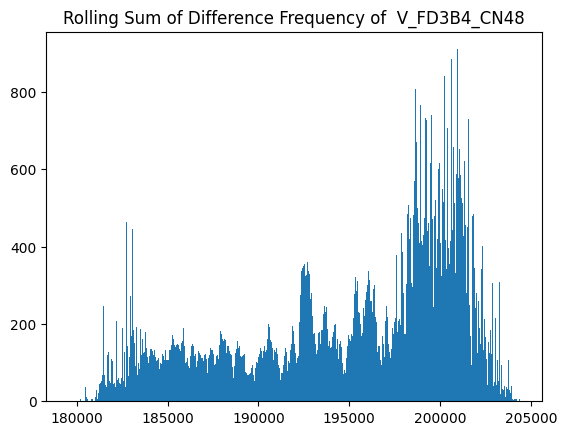

******************************************************************************


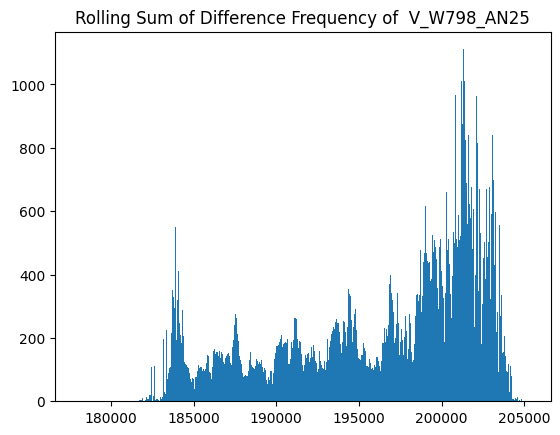

******************************************************************************


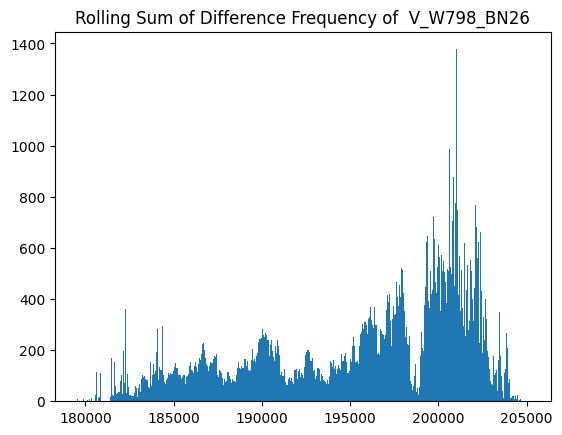

******************************************************************************


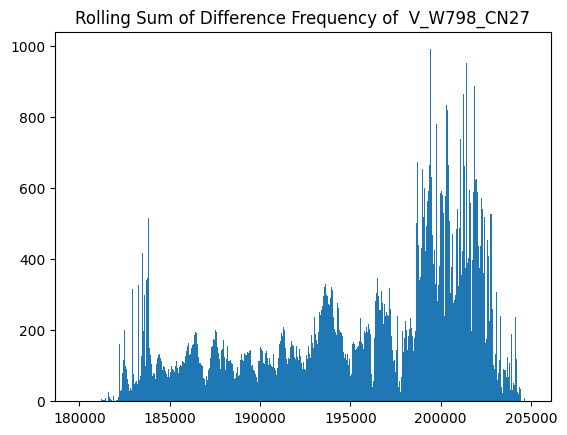

******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
****************************************************

In [13]:
window = 350
w = 1

cov_fn = covariance_pair
thresholds_cov, cov_multi_list = get_threshold_stat_only(data, cov_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=1, axis=1, stat_list=None, plot=True, collate_fn="sum")
thresholds_cov_99, cov_multi_list = get_threshold_stat_only(data, cov_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.99, axis=1, stat_list=cov_multi_list, collate_fn="sum")
thresholds_cov_95, cov_multi_list = get_threshold_stat_only(data, cov_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.95, axis=1, stat_list=cov_multi_list, collate_fn="sum")

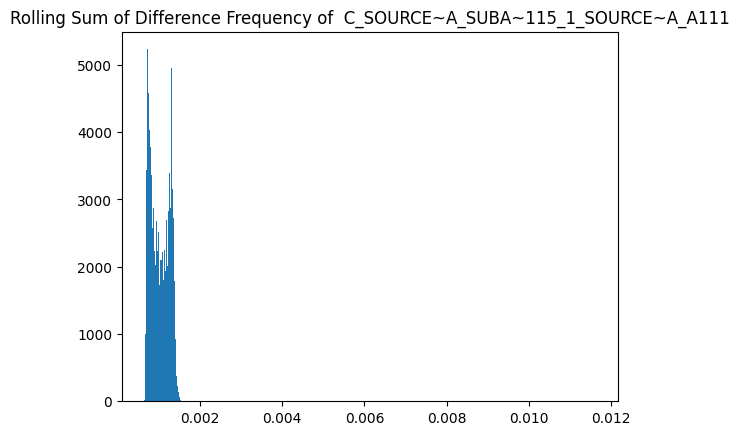

******************************************************************************


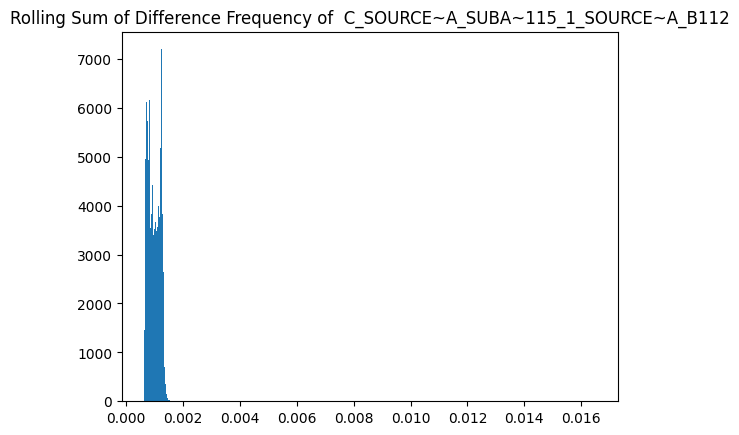

******************************************************************************


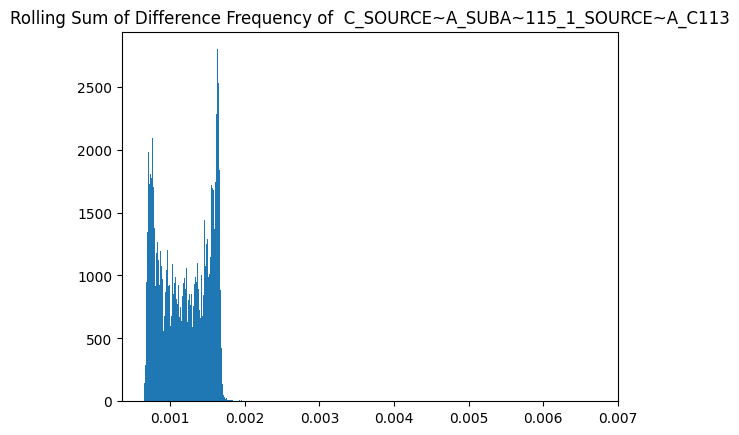

******************************************************************************


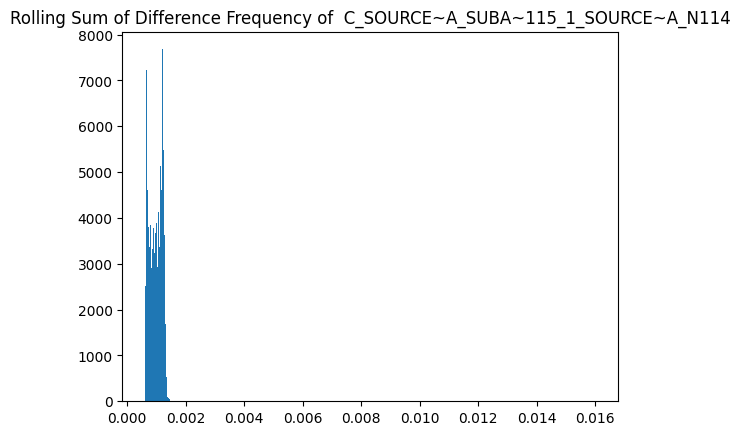

******************************************************************************


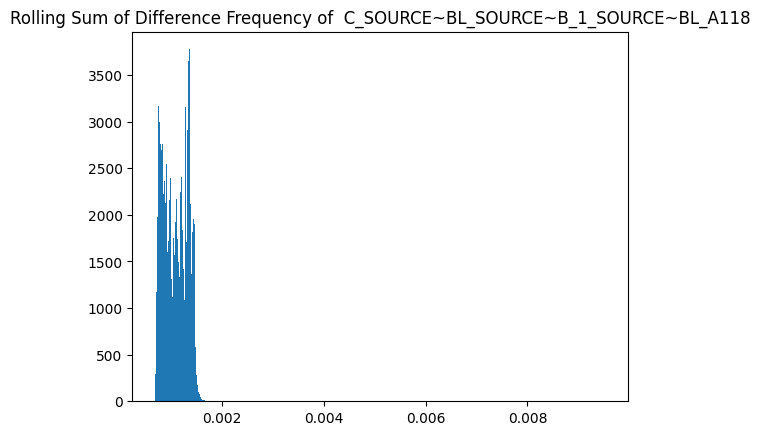

******************************************************************************


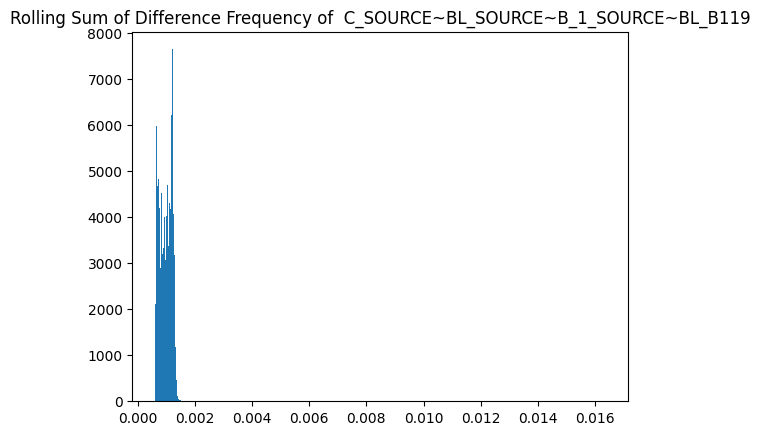

******************************************************************************


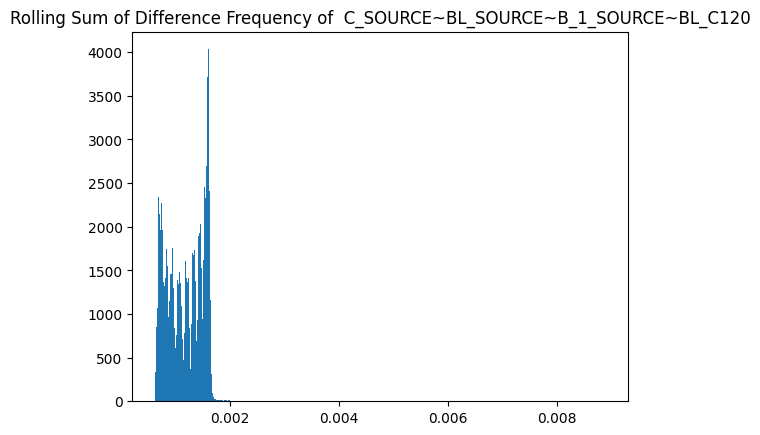

******************************************************************************


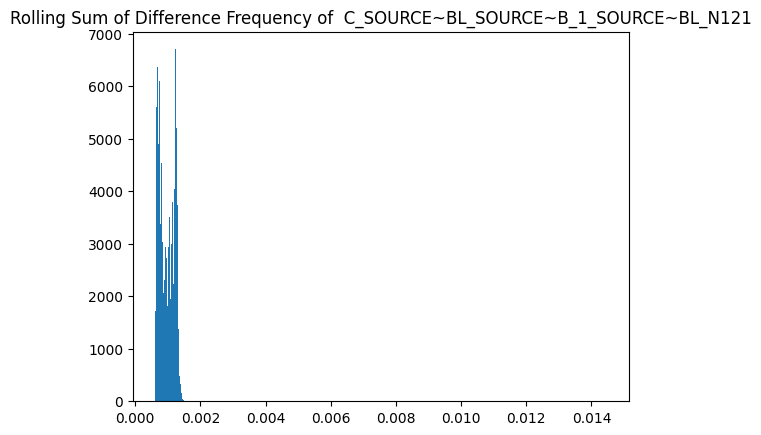

******************************************************************************


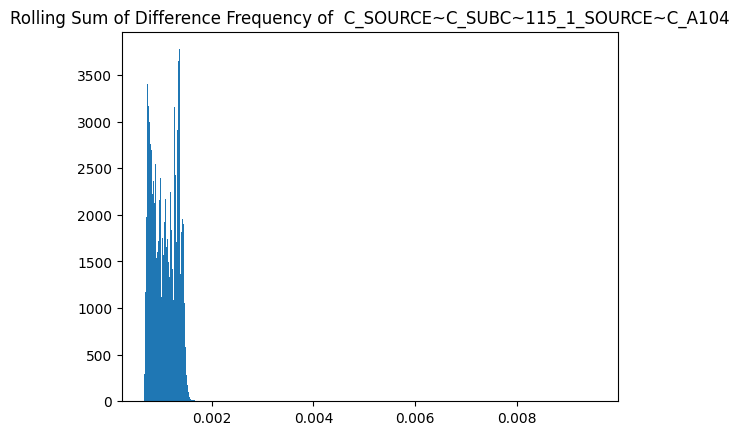

******************************************************************************


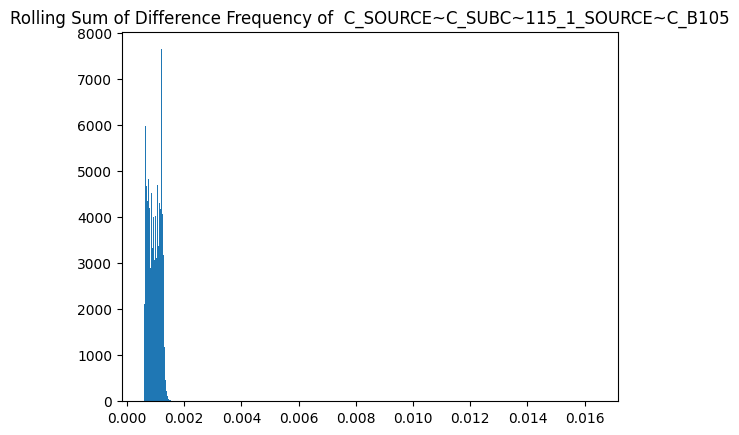

******************************************************************************


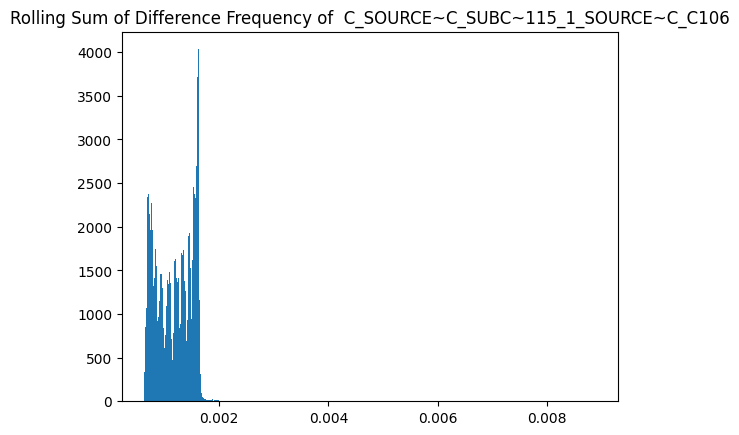

******************************************************************************


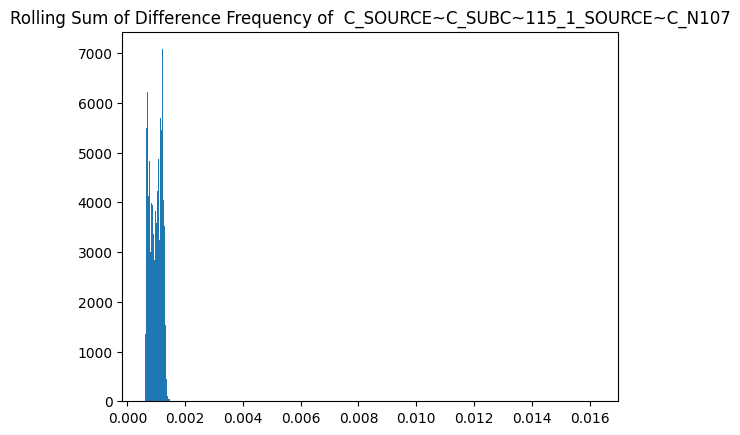

******************************************************************************


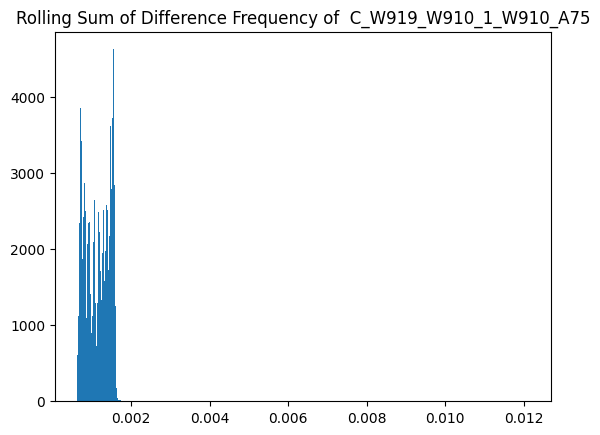

******************************************************************************


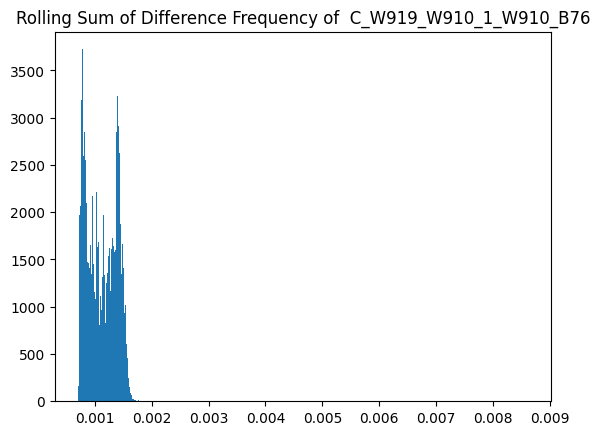

******************************************************************************


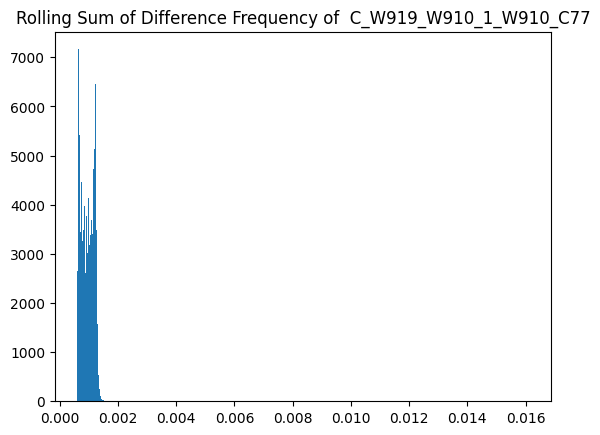

******************************************************************************


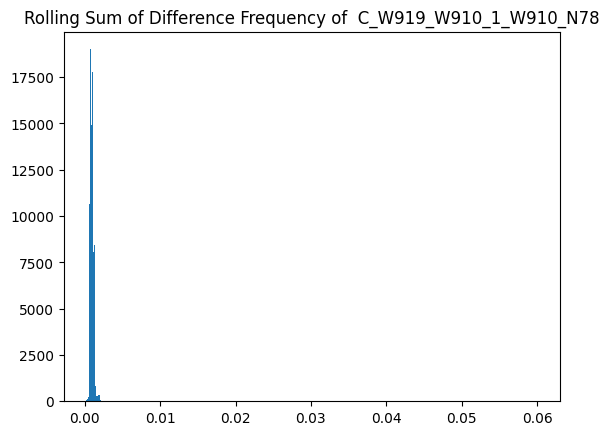

******************************************************************************


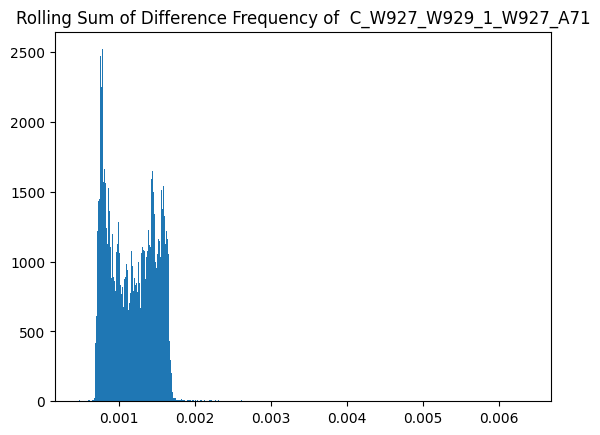

******************************************************************************


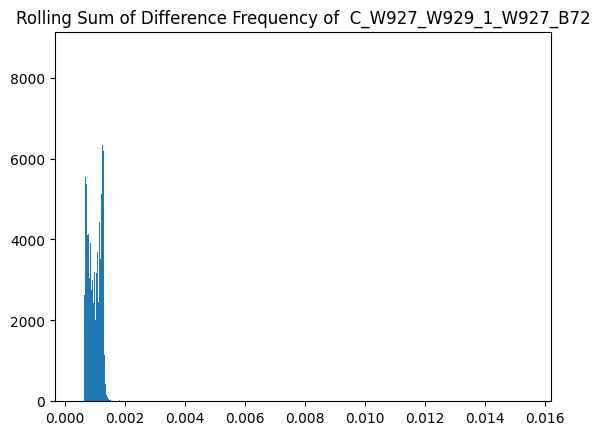

******************************************************************************


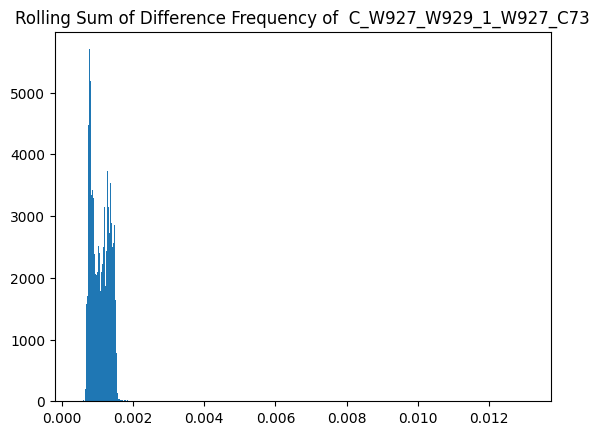

******************************************************************************


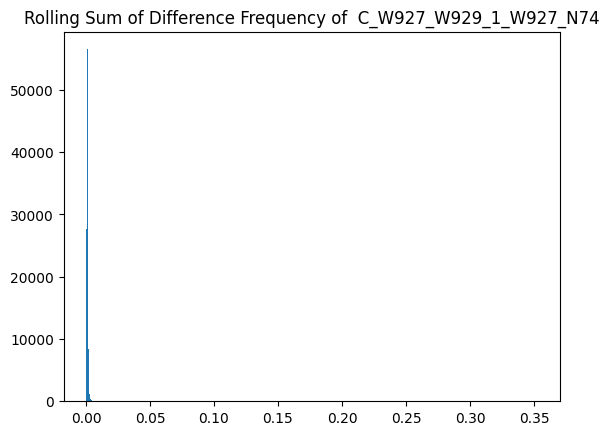

******************************************************************************


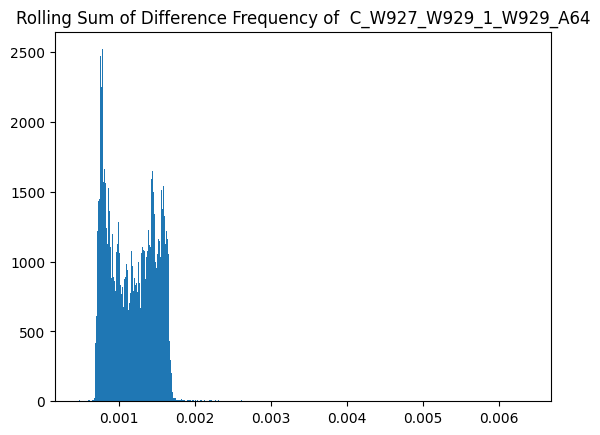

******************************************************************************


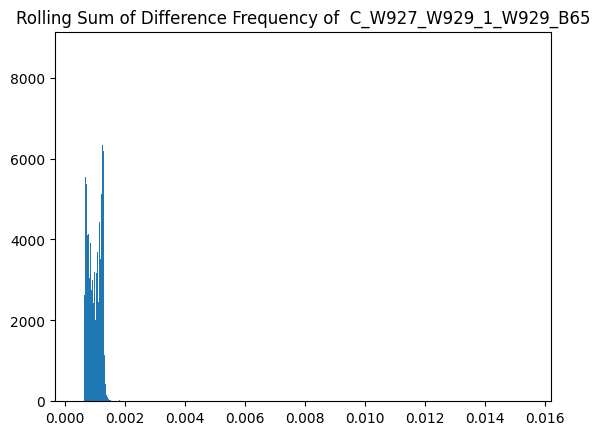

******************************************************************************


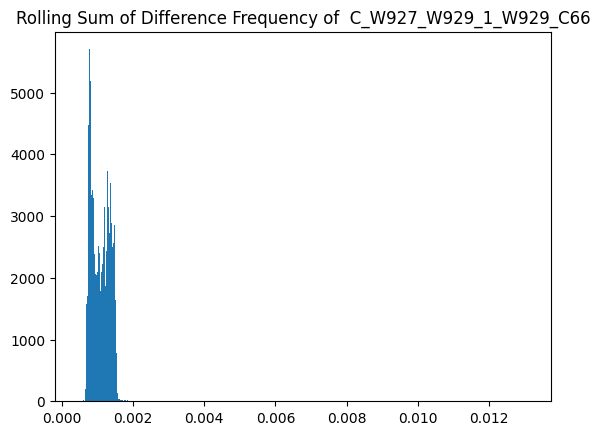

******************************************************************************


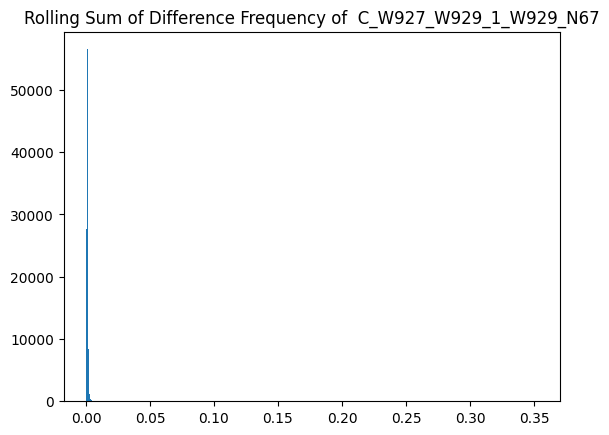

******************************************************************************


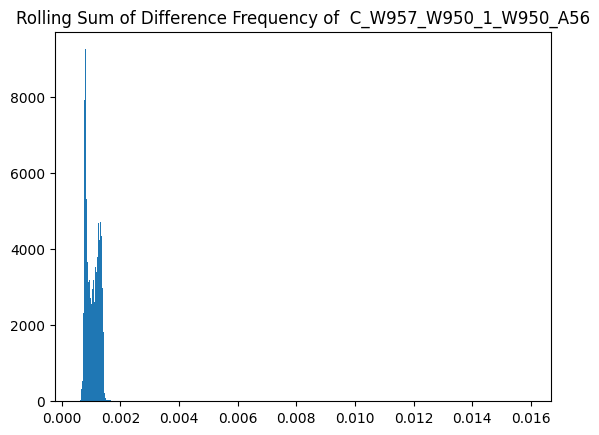

******************************************************************************


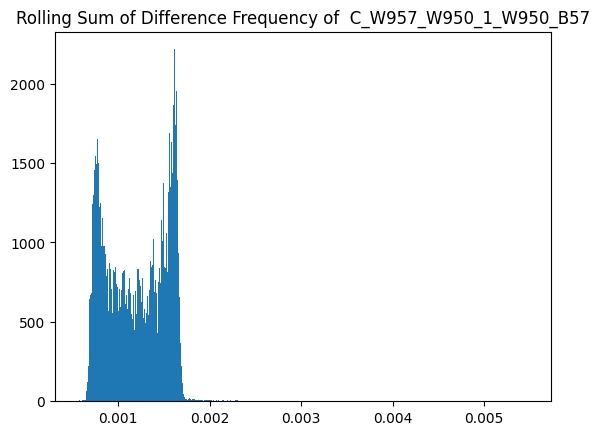

******************************************************************************


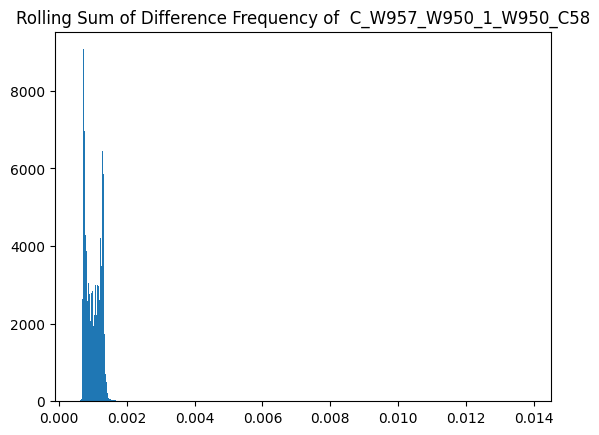

******************************************************************************


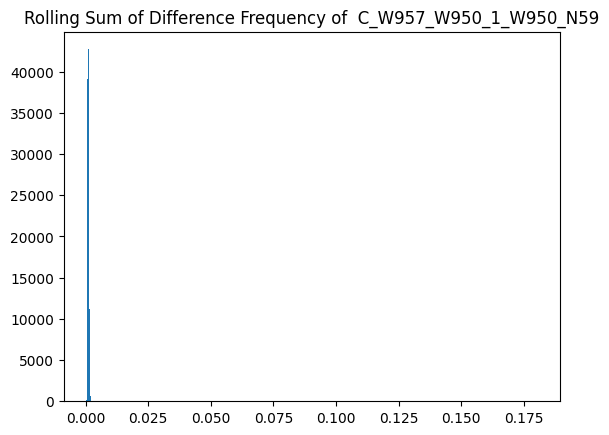

******************************************************************************


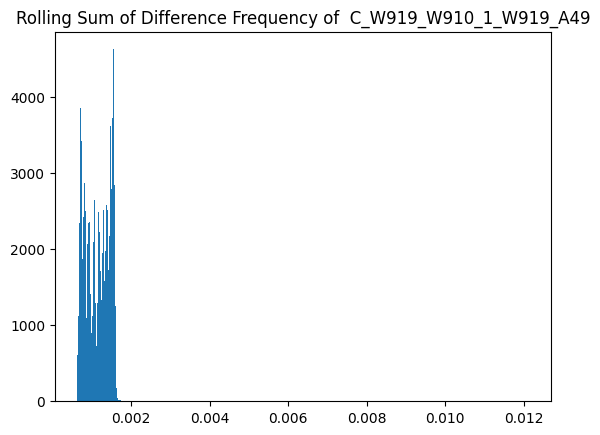

******************************************************************************


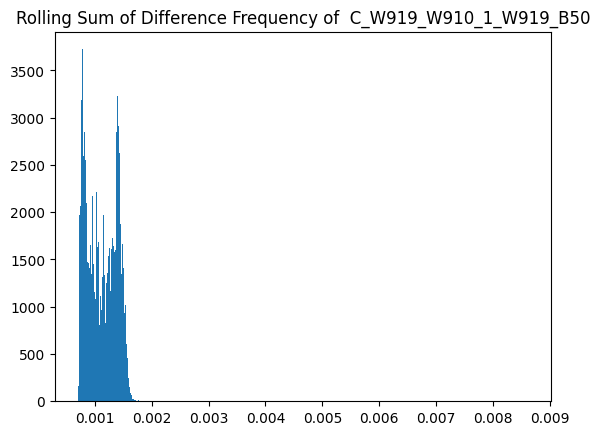

******************************************************************************


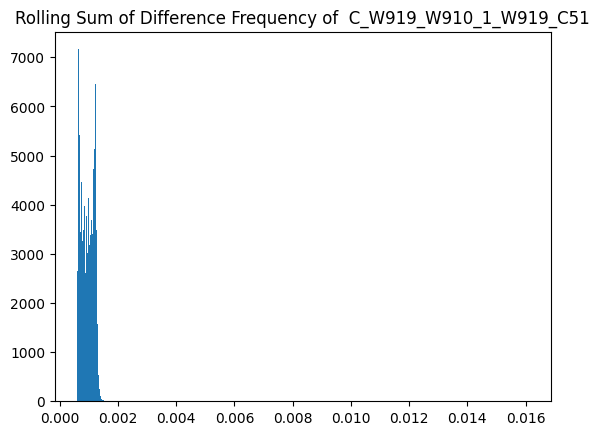

******************************************************************************


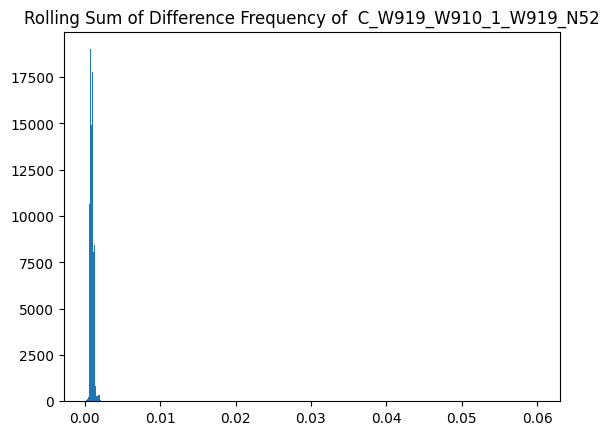

******************************************************************************


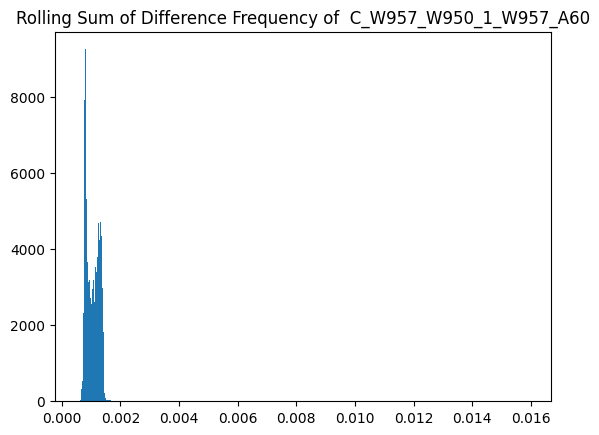

******************************************************************************


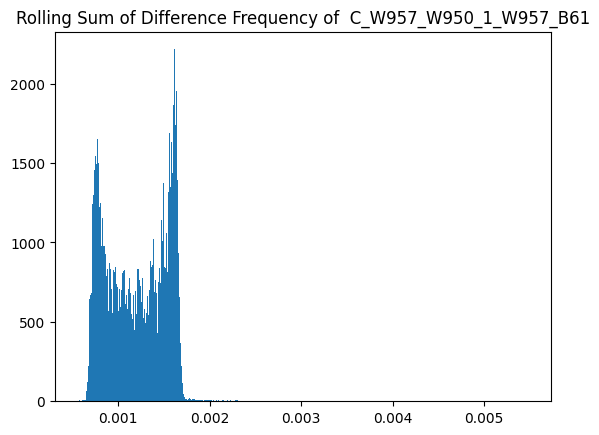

******************************************************************************


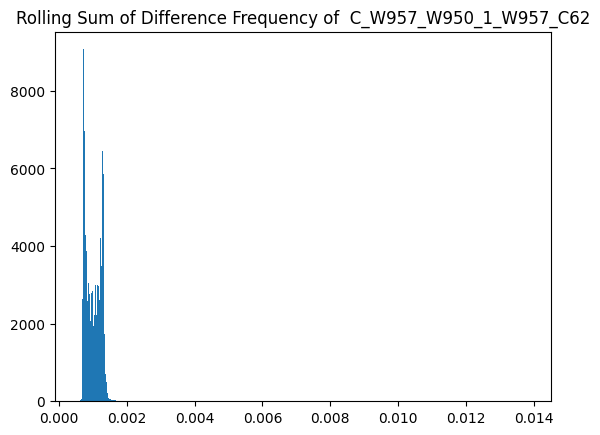

******************************************************************************


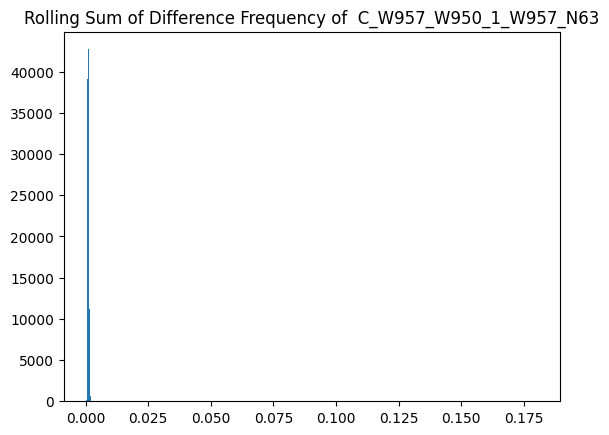

******************************************************************************


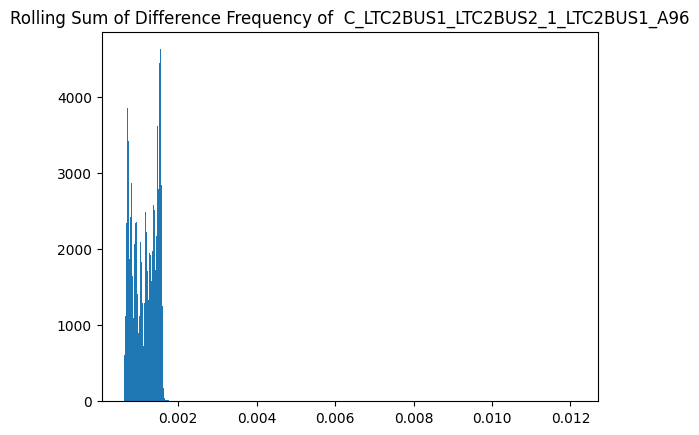

******************************************************************************


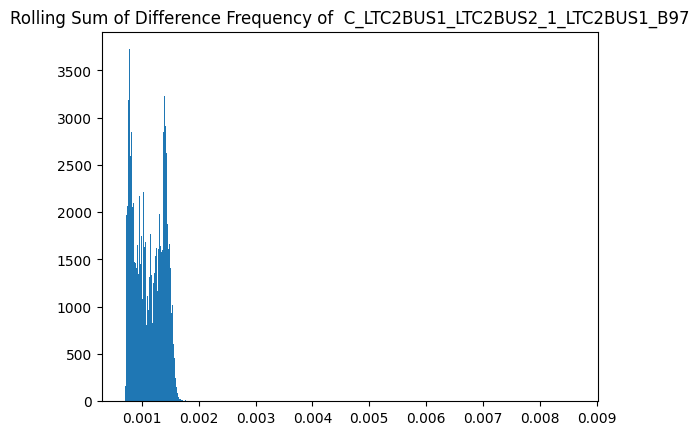

******************************************************************************


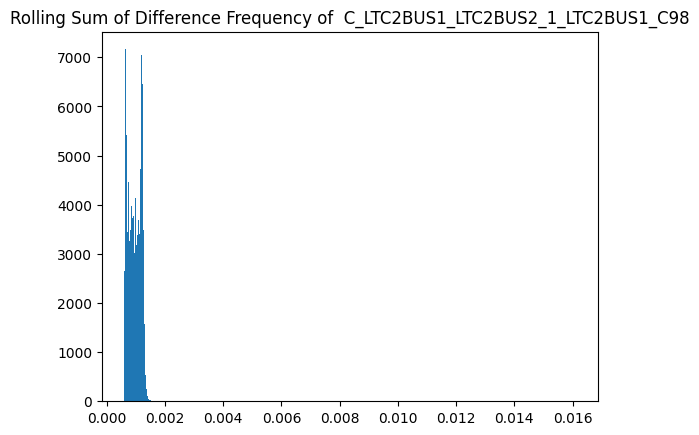

******************************************************************************


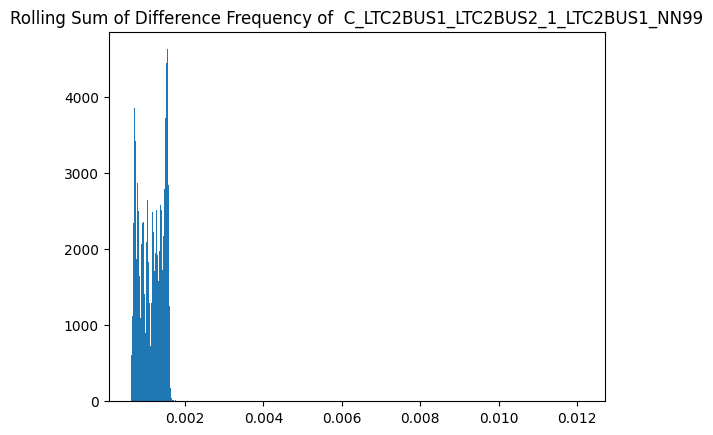

******************************************************************************


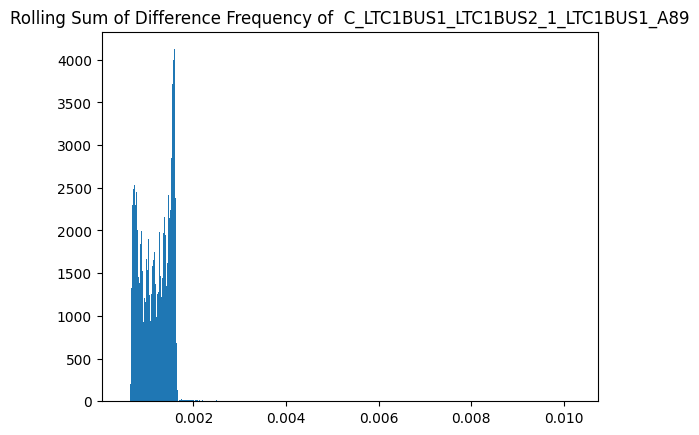

******************************************************************************


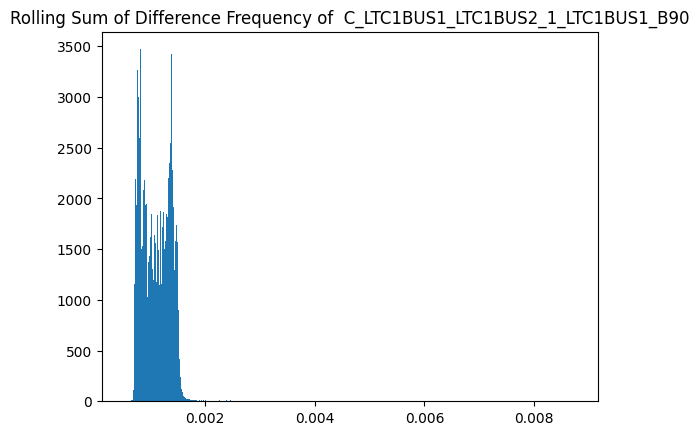

******************************************************************************


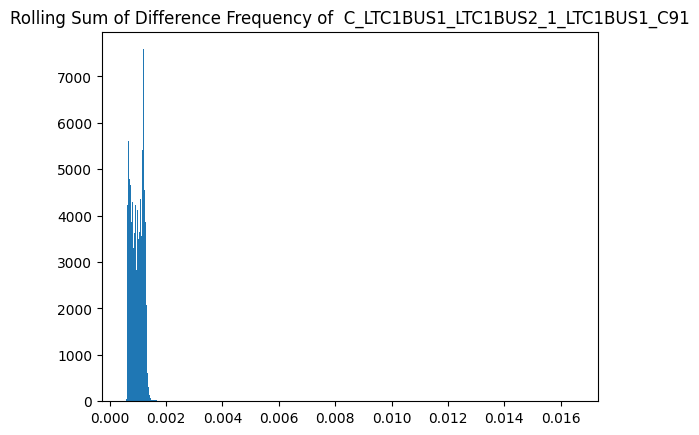

******************************************************************************


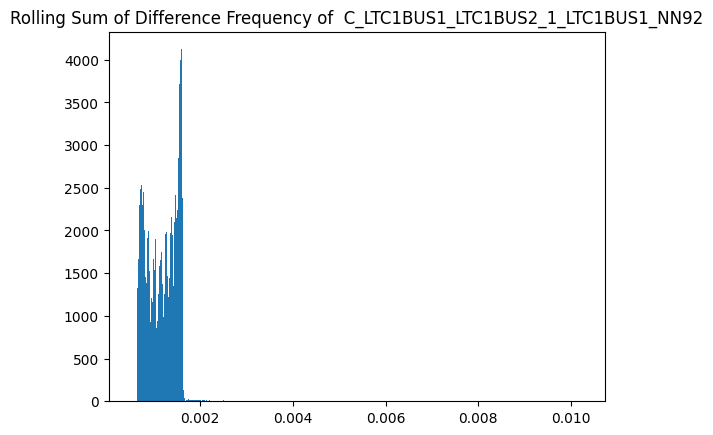

******************************************************************************


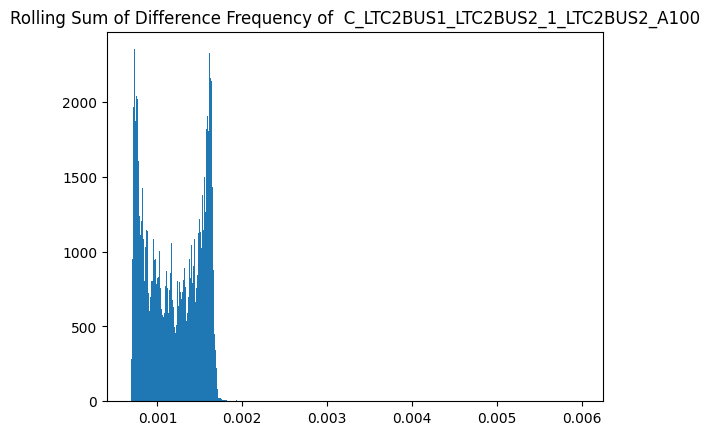

******************************************************************************


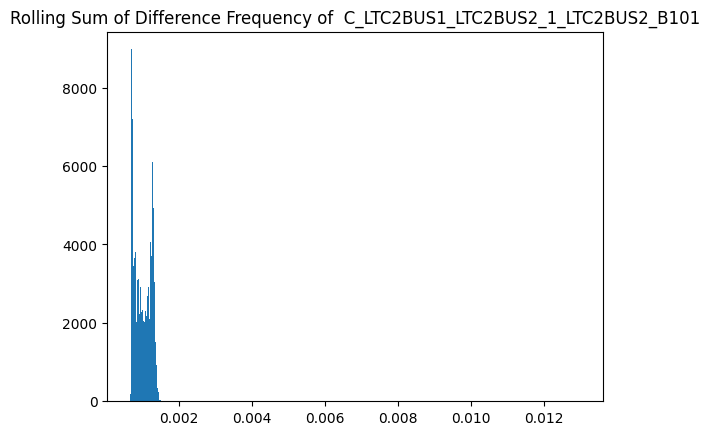

******************************************************************************


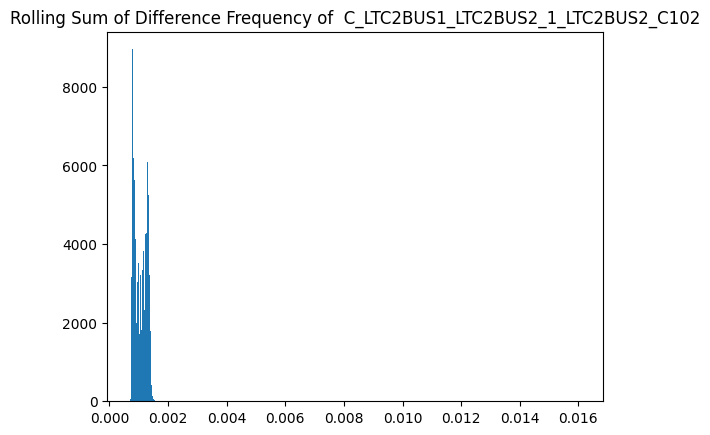

******************************************************************************


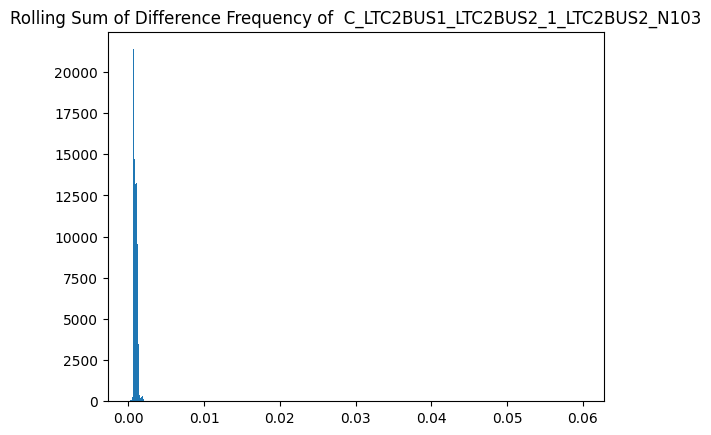

******************************************************************************


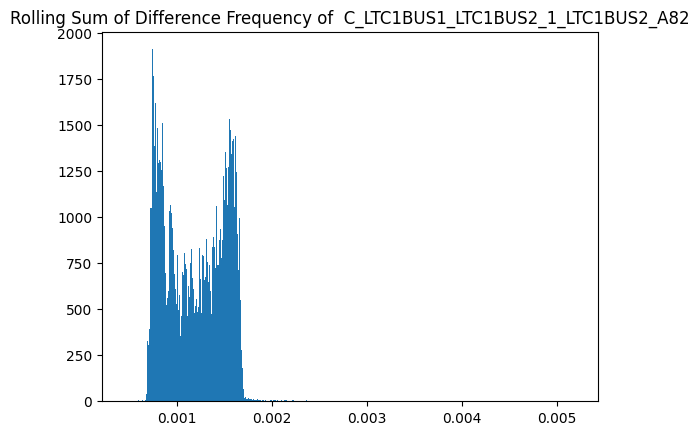

******************************************************************************


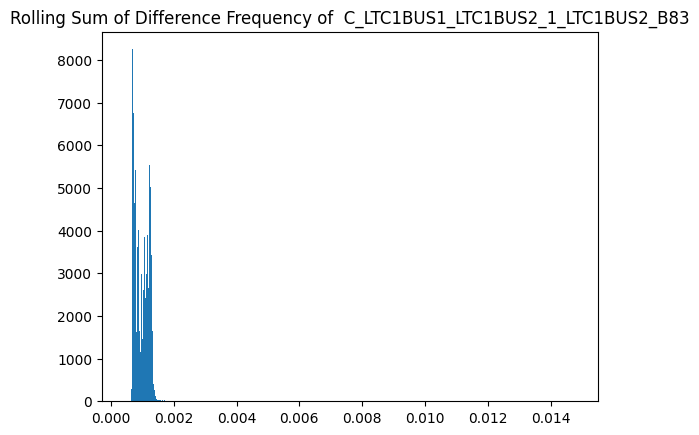

******************************************************************************


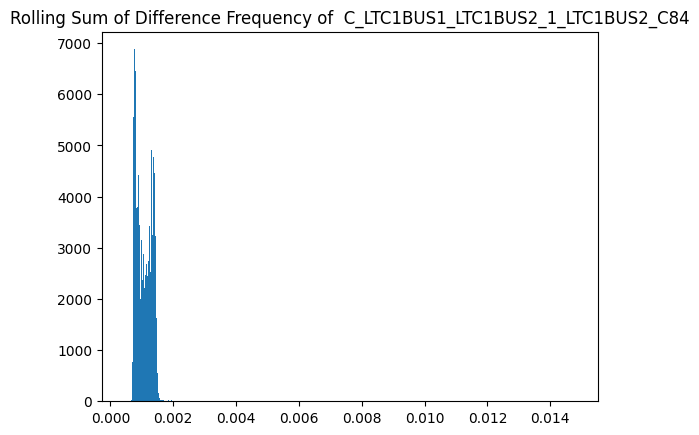

******************************************************************************


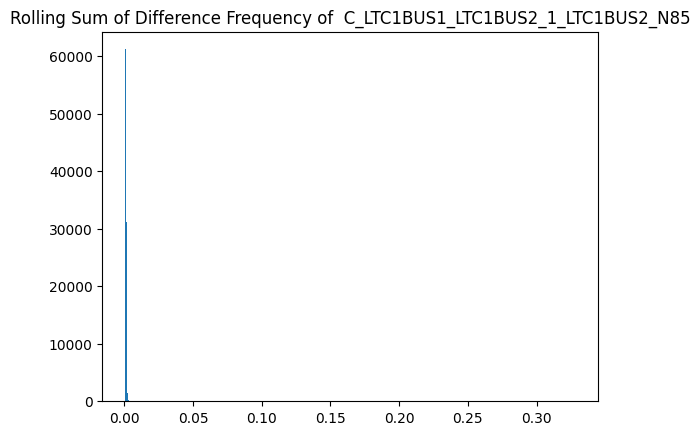

******************************************************************************


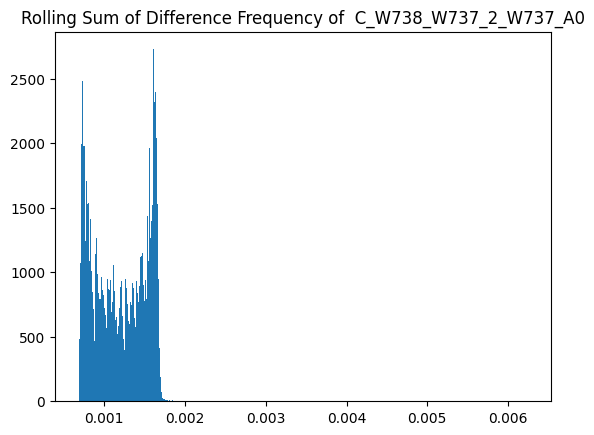

******************************************************************************


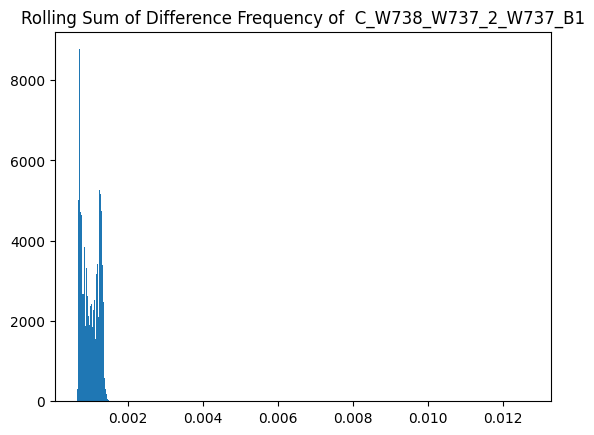

******************************************************************************


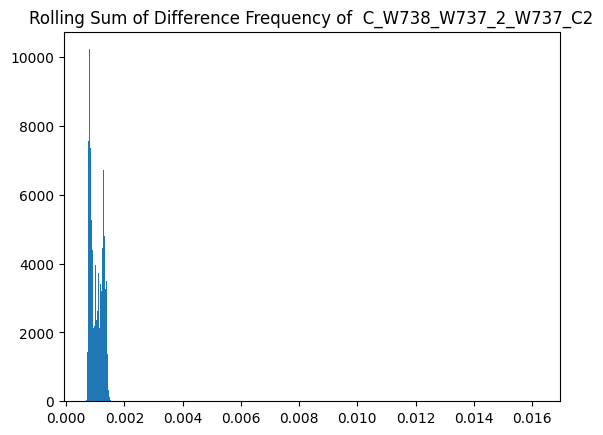

******************************************************************************


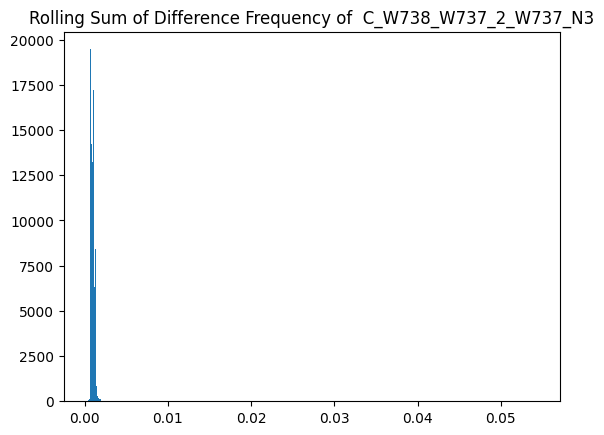

******************************************************************************


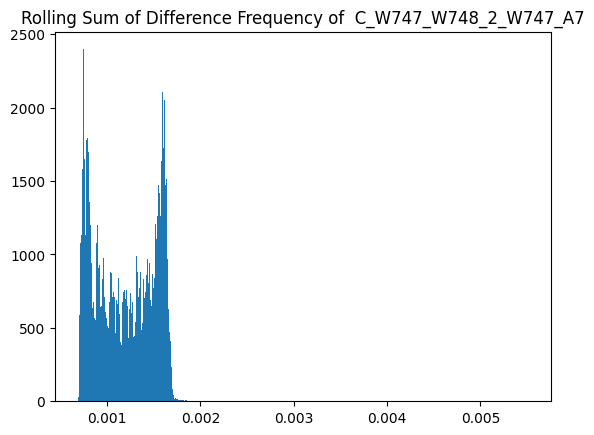

******************************************************************************


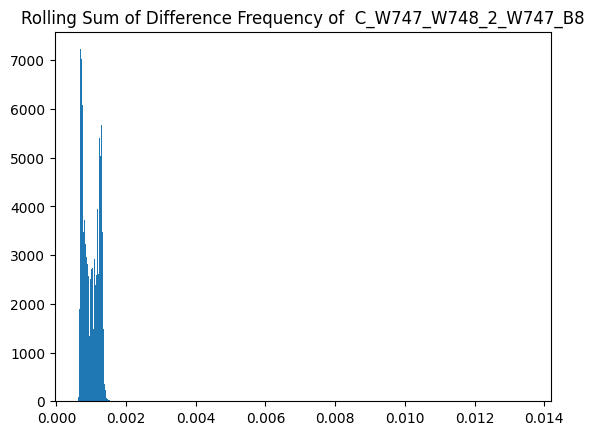

******************************************************************************


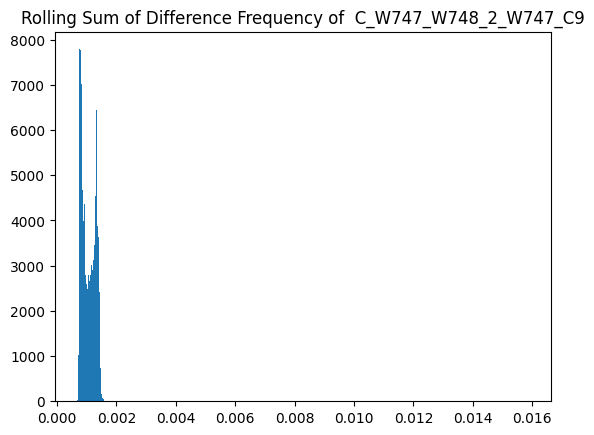

******************************************************************************


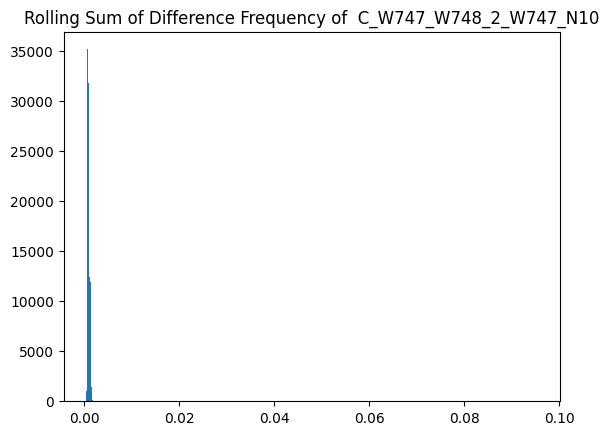

******************************************************************************


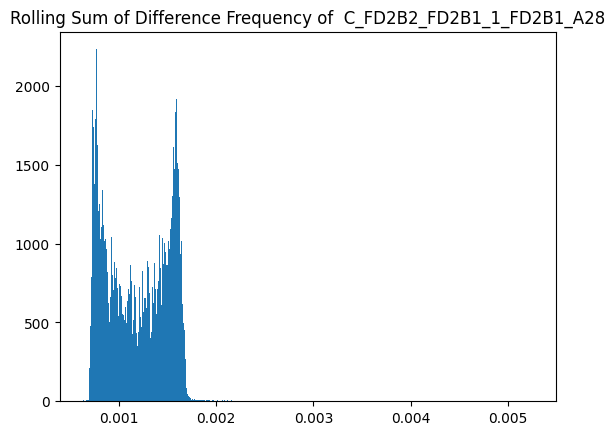

******************************************************************************


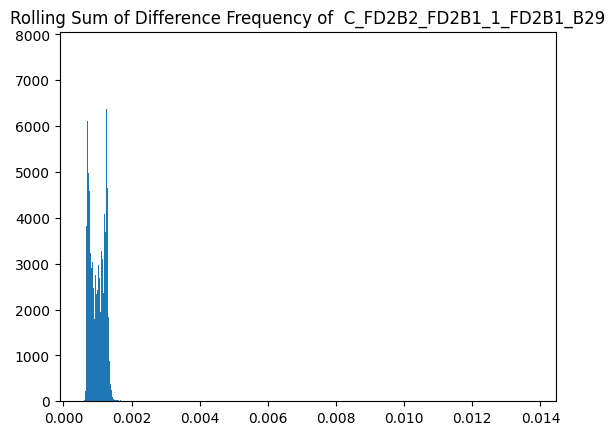

******************************************************************************


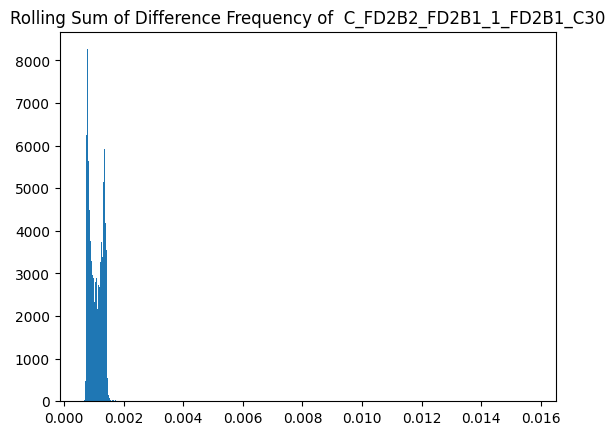

******************************************************************************


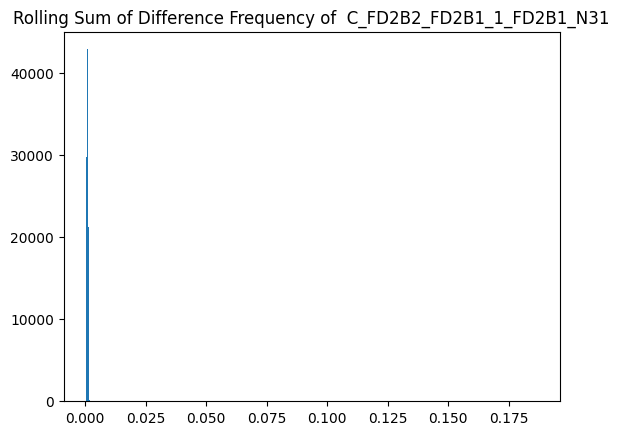

******************************************************************************


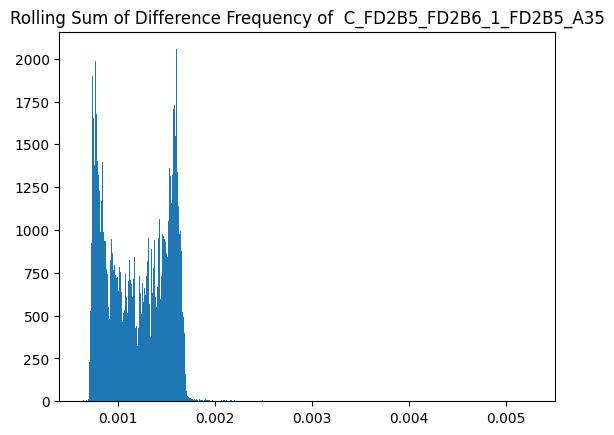

******************************************************************************


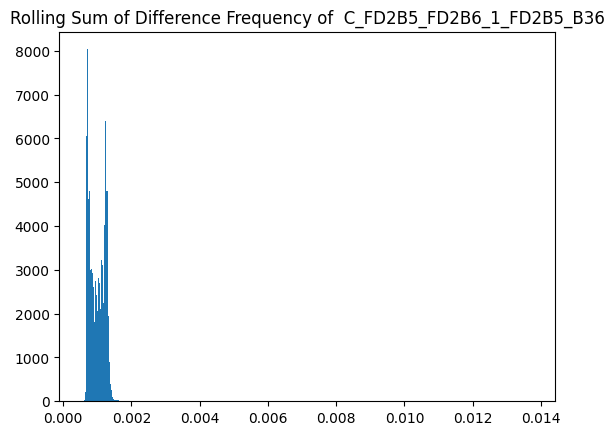

******************************************************************************


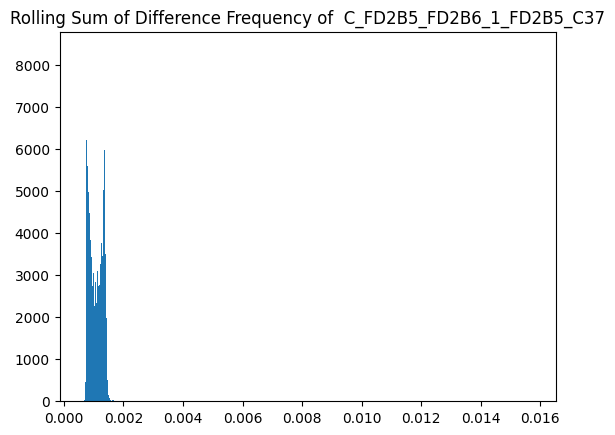

******************************************************************************


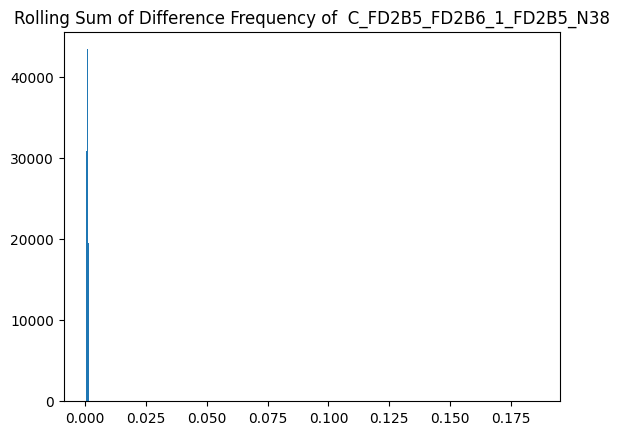

******************************************************************************


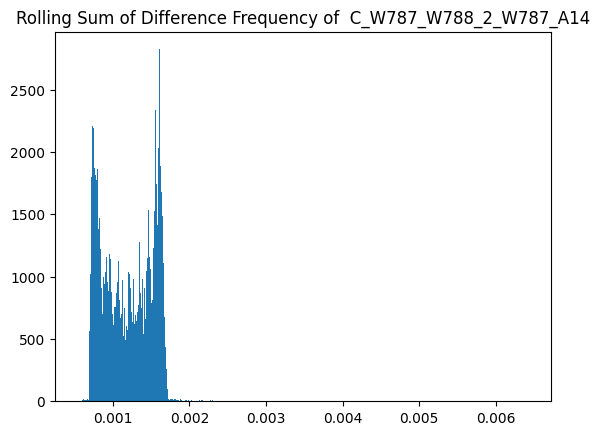

******************************************************************************


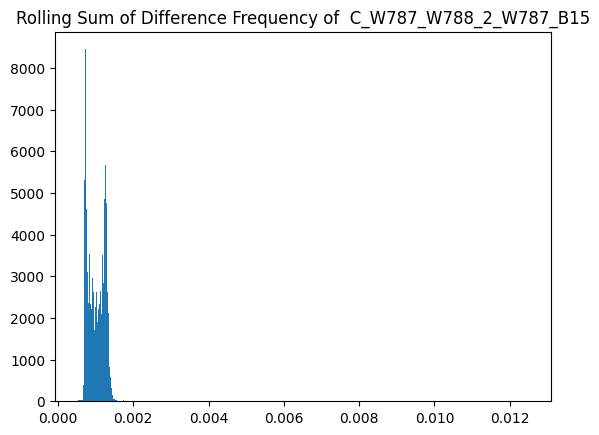

******************************************************************************


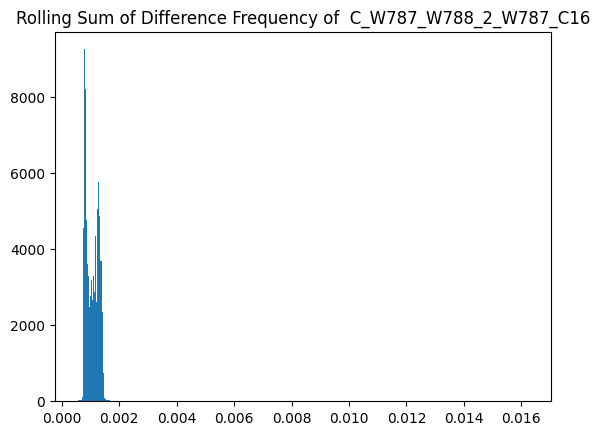

******************************************************************************


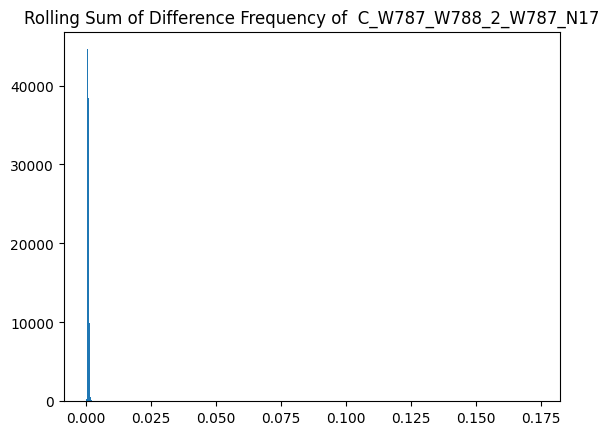

******************************************************************************


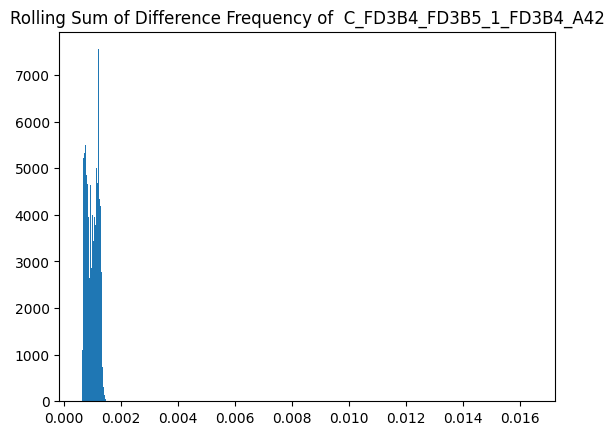

******************************************************************************


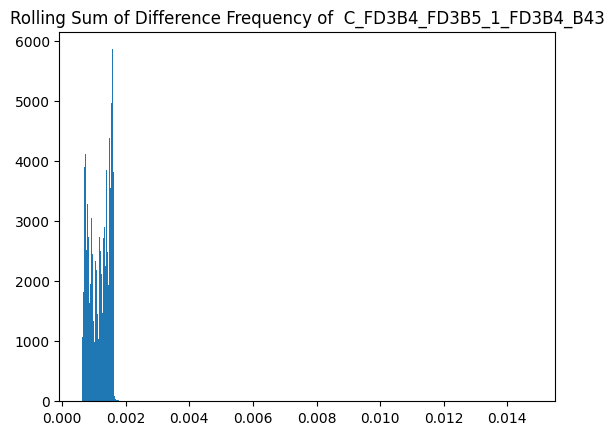

******************************************************************************


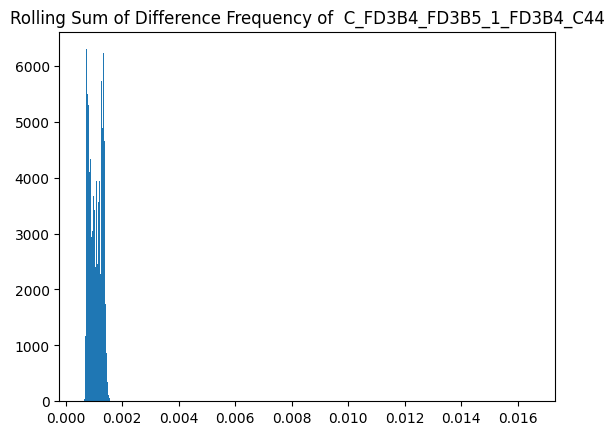

******************************************************************************


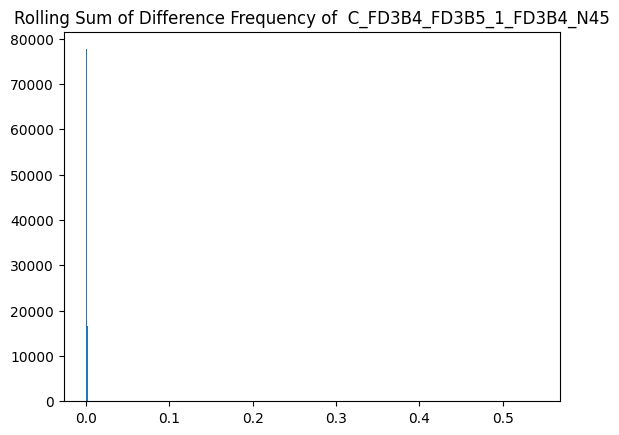

******************************************************************************


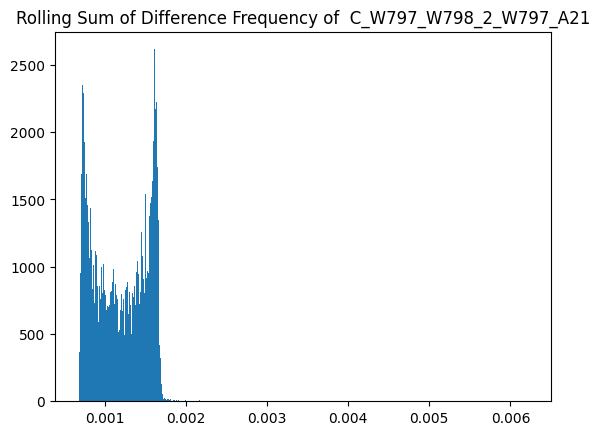

******************************************************************************


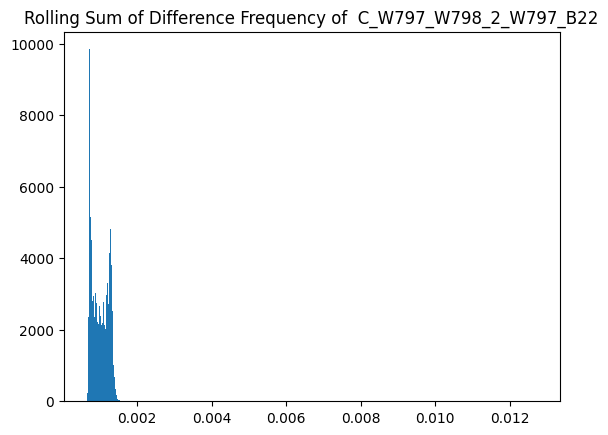

******************************************************************************


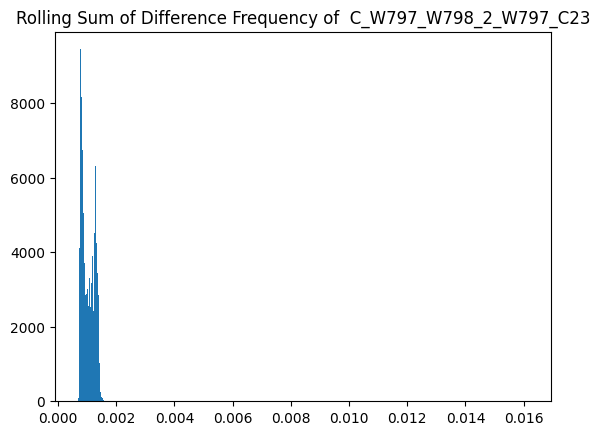

******************************************************************************


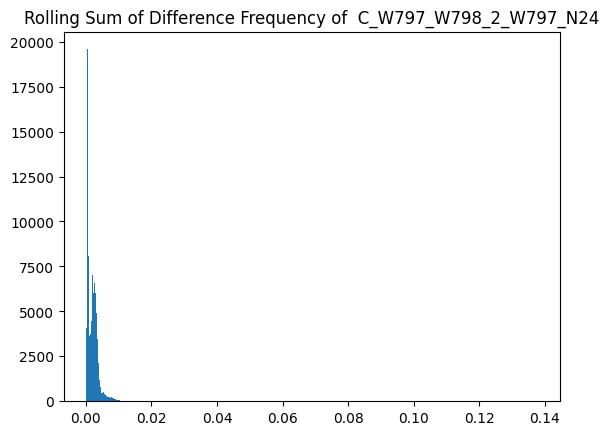

******************************************************************************


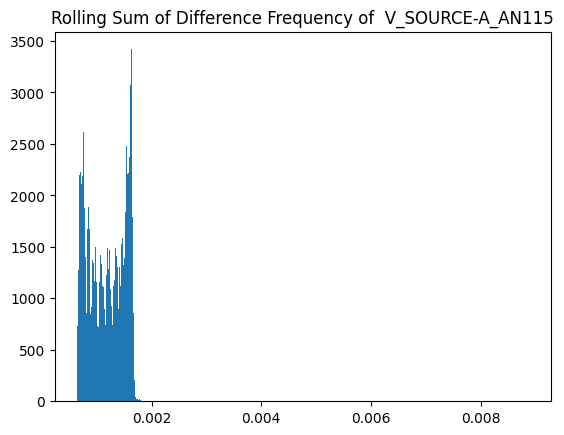

******************************************************************************


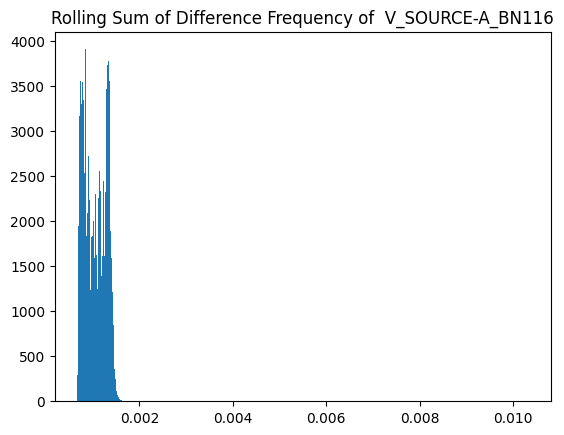

******************************************************************************


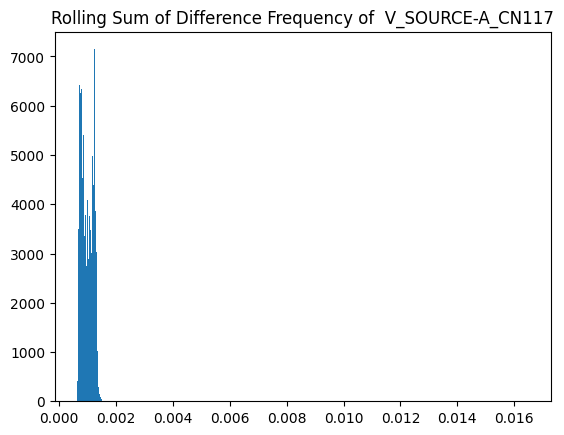

******************************************************************************


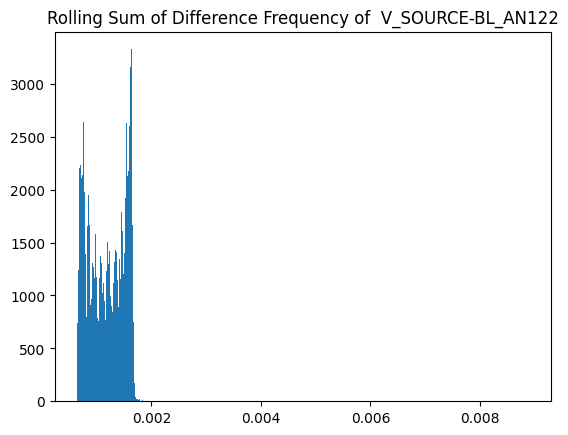

******************************************************************************


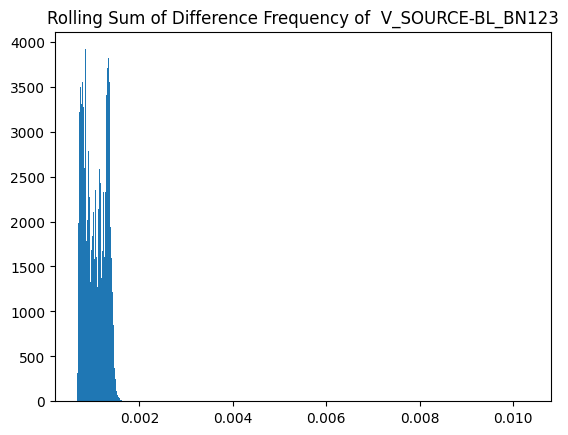

******************************************************************************


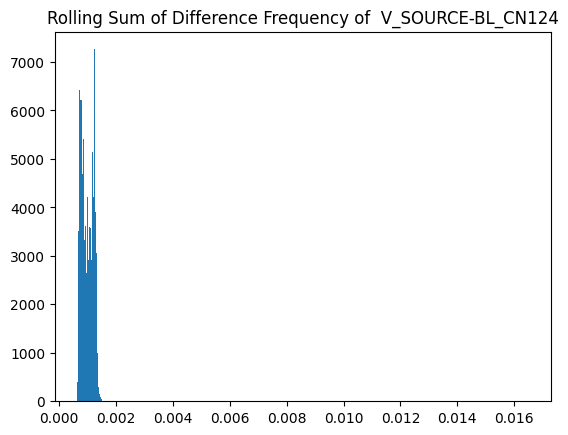

******************************************************************************


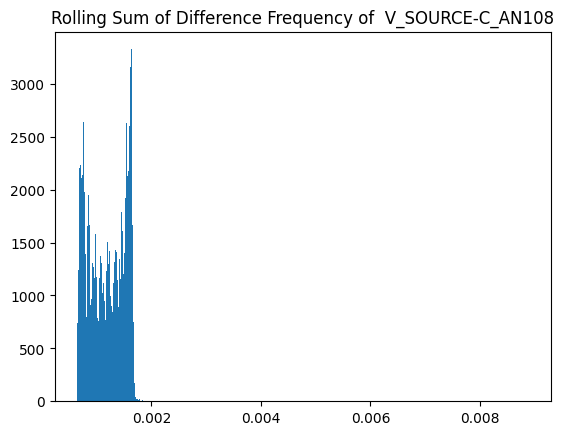

******************************************************************************


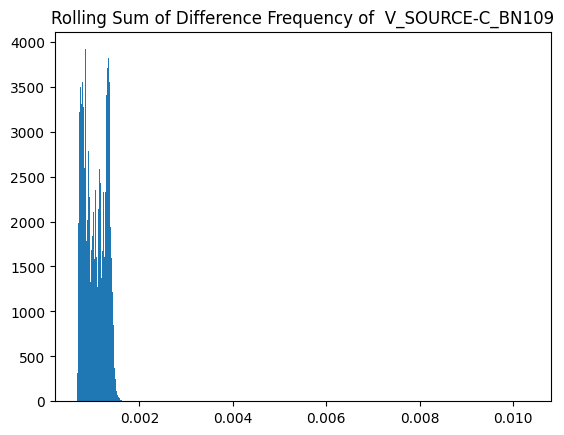

******************************************************************************


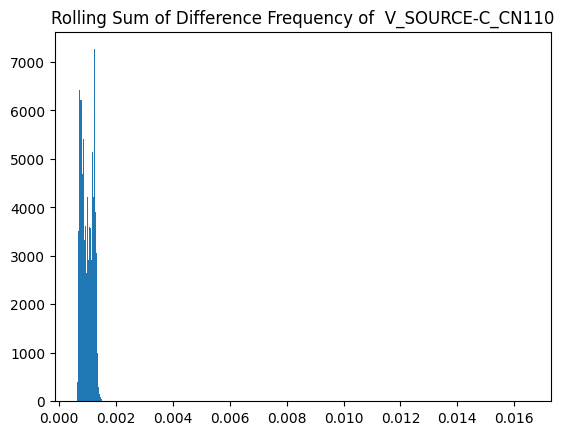

******************************************************************************


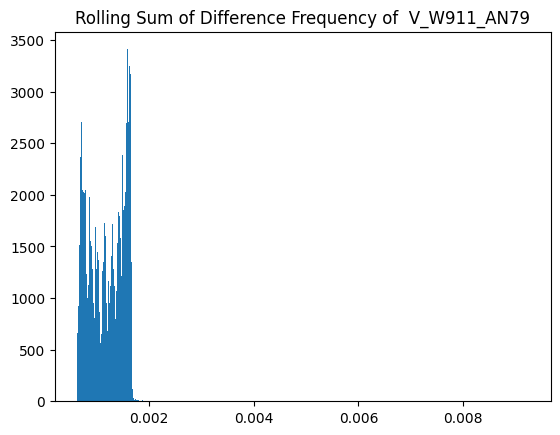

******************************************************************************


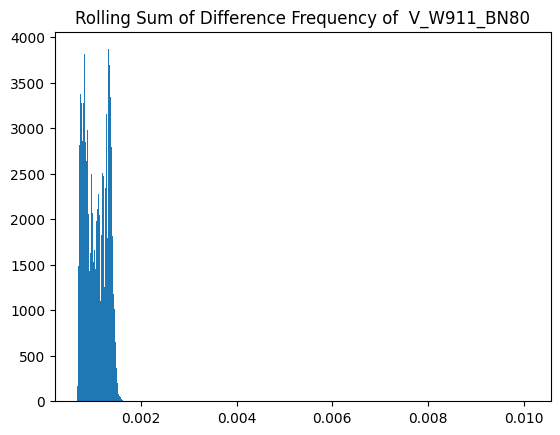

******************************************************************************


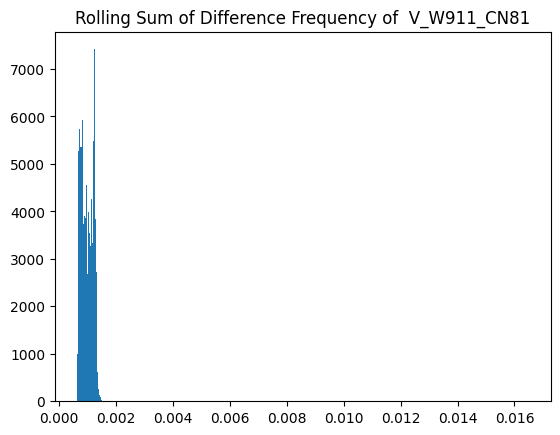

******************************************************************************


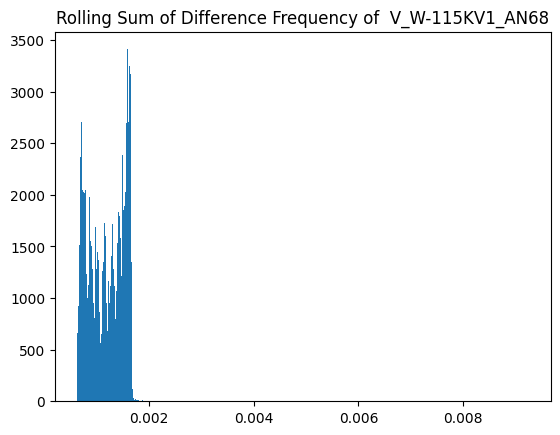

******************************************************************************


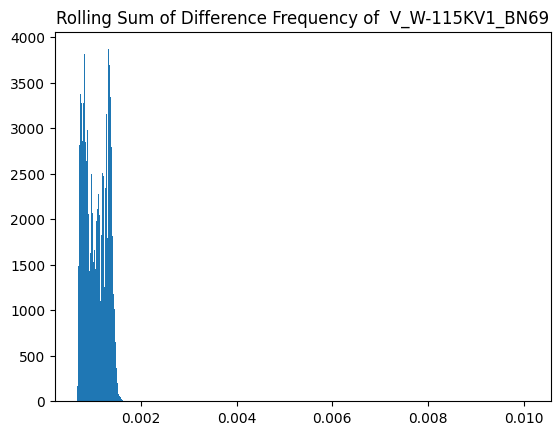

******************************************************************************


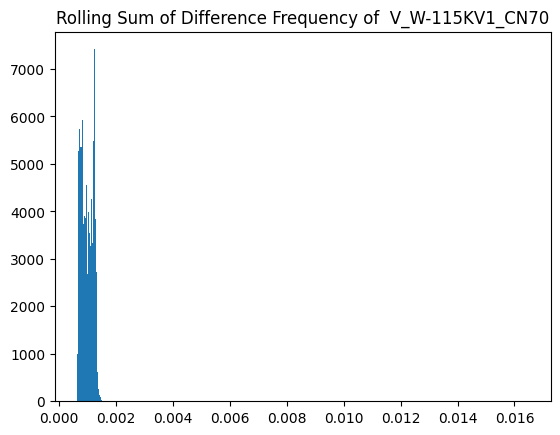

******************************************************************************


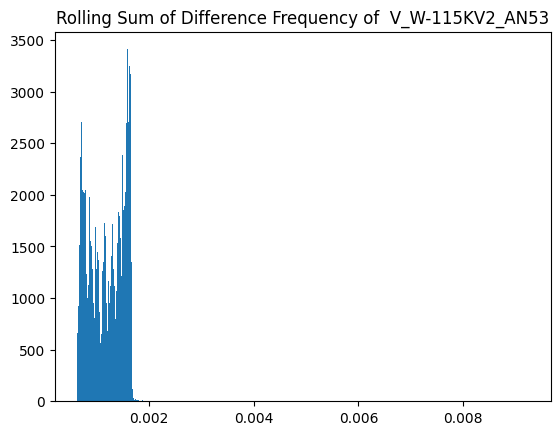

******************************************************************************


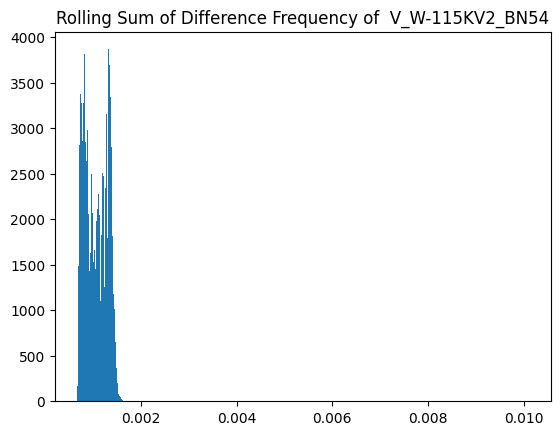

******************************************************************************


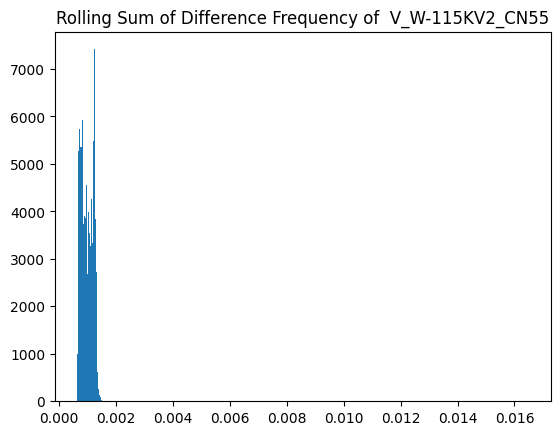

******************************************************************************


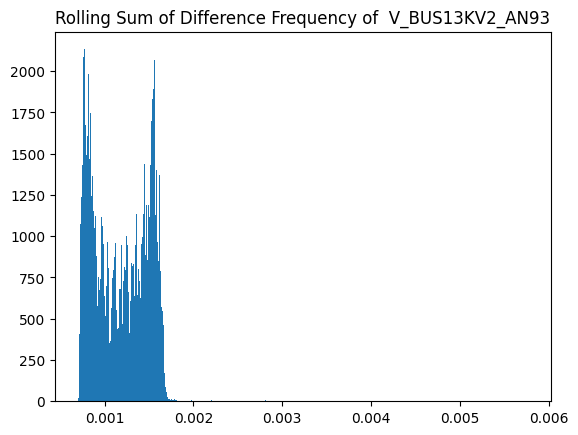

******************************************************************************


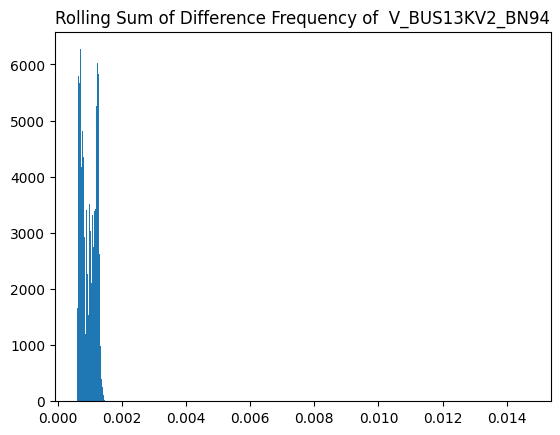

******************************************************************************


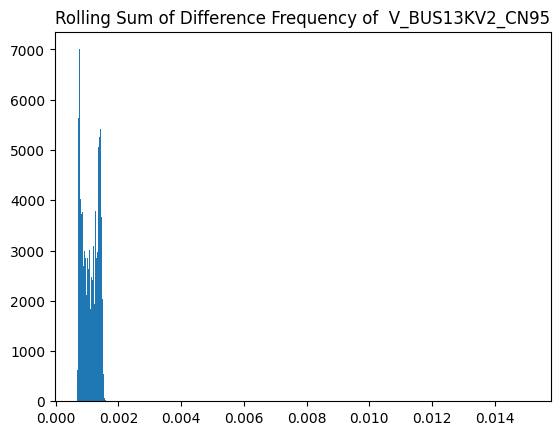

******************************************************************************


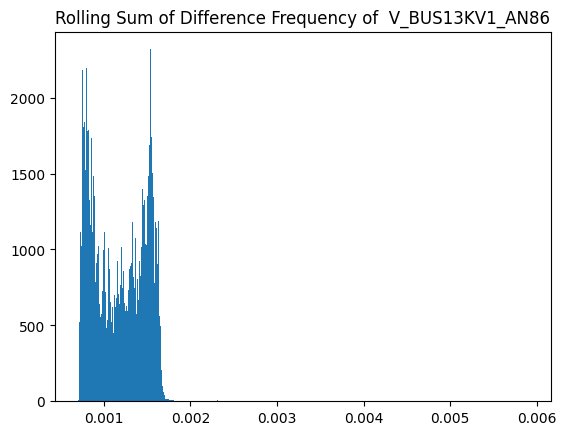

******************************************************************************


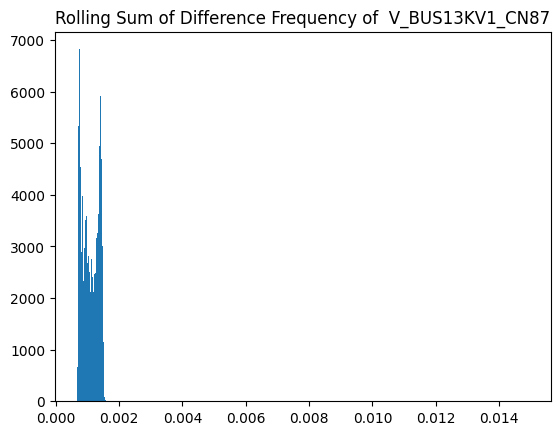

******************************************************************************


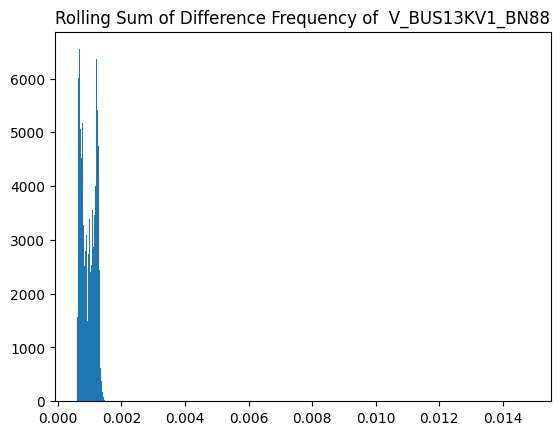

******************************************************************************


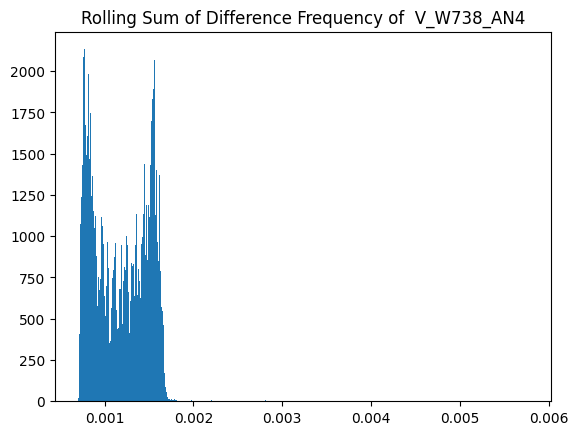

******************************************************************************


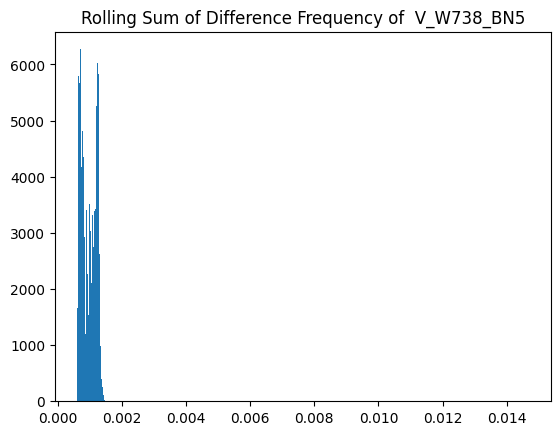

******************************************************************************


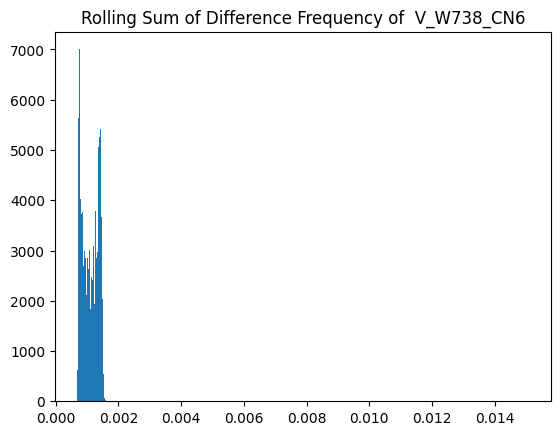

******************************************************************************


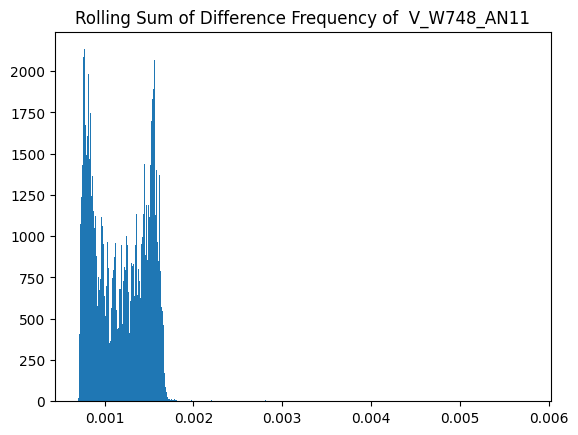

******************************************************************************


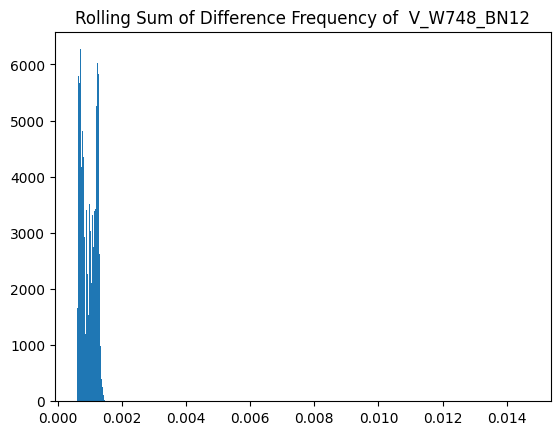

******************************************************************************


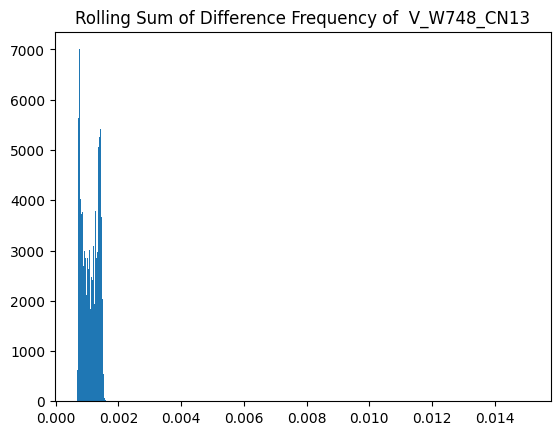

******************************************************************************


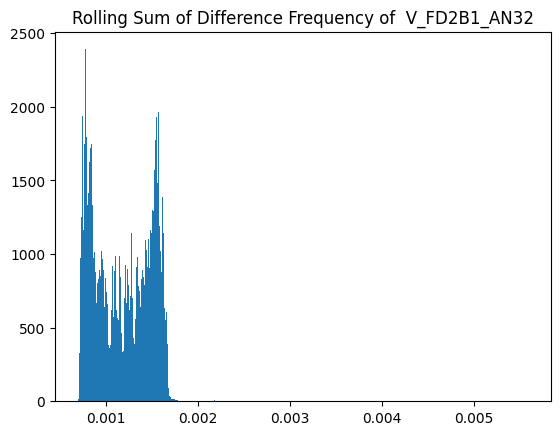

******************************************************************************


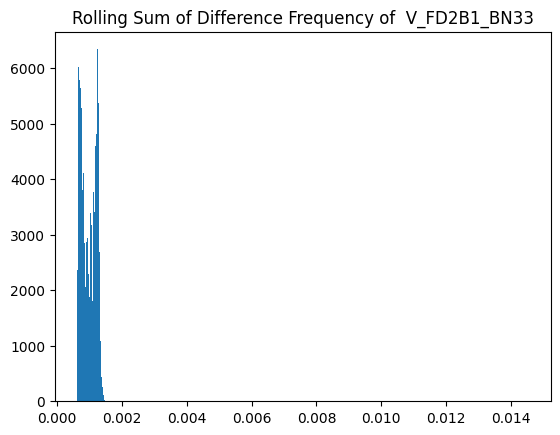

******************************************************************************


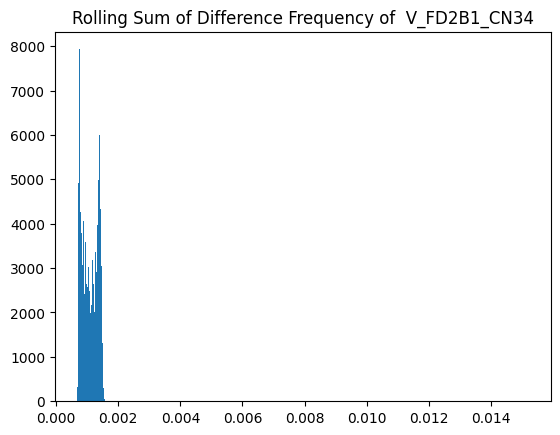

******************************************************************************


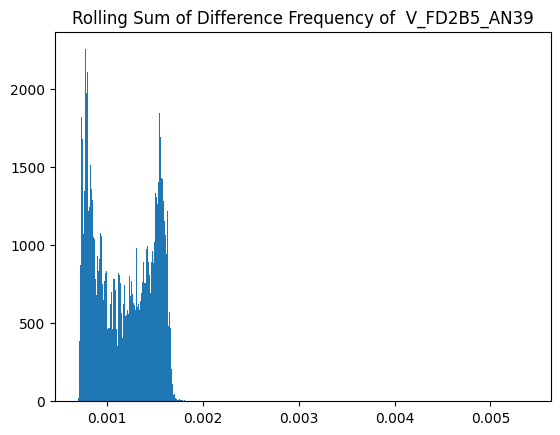

******************************************************************************


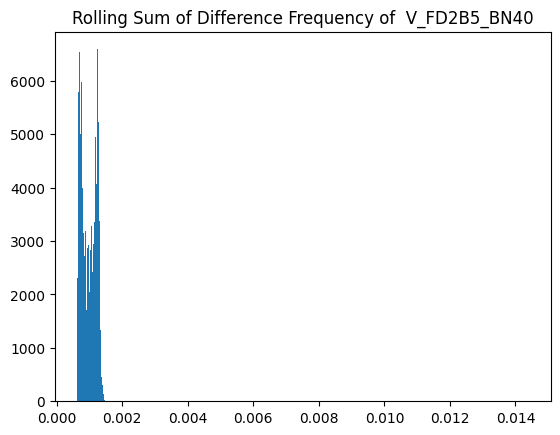

******************************************************************************


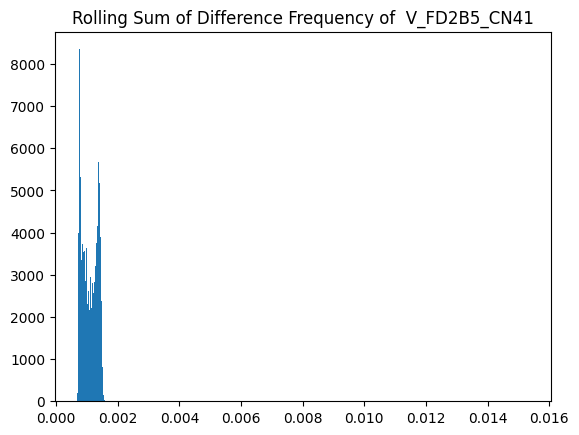

******************************************************************************


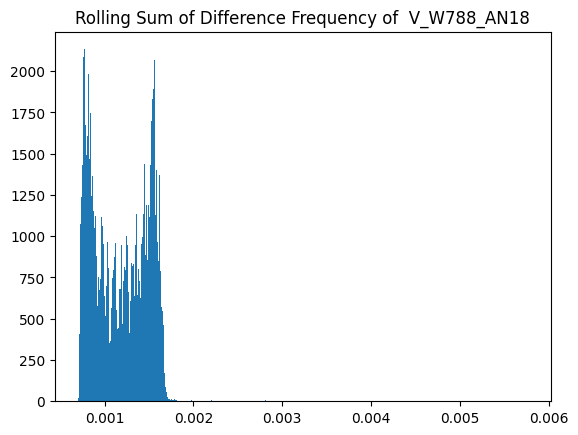

******************************************************************************


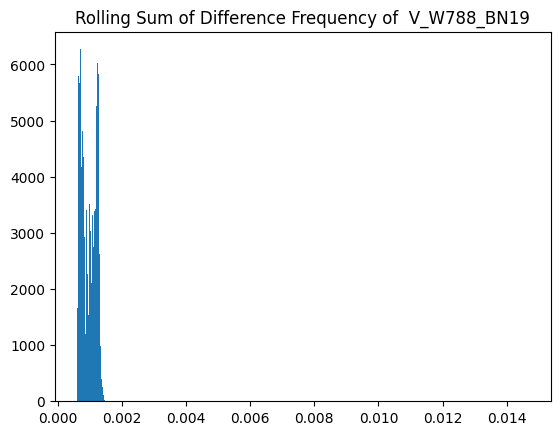

******************************************************************************


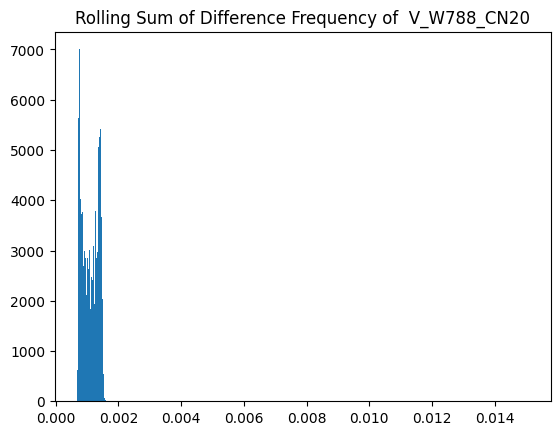

******************************************************************************


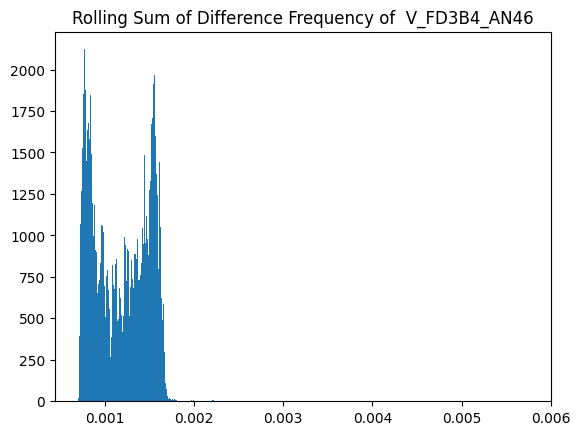

******************************************************************************


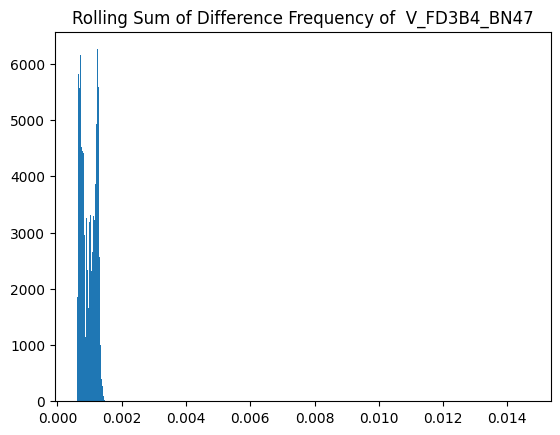

******************************************************************************


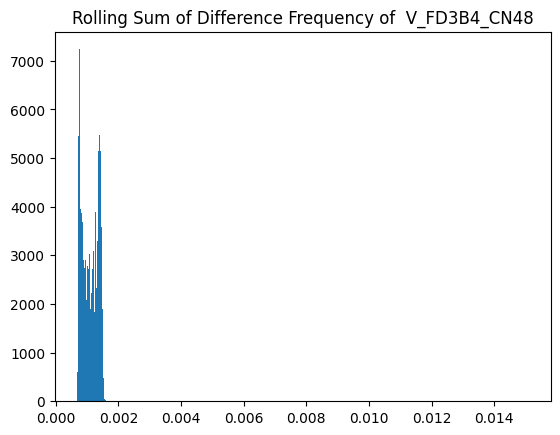

******************************************************************************


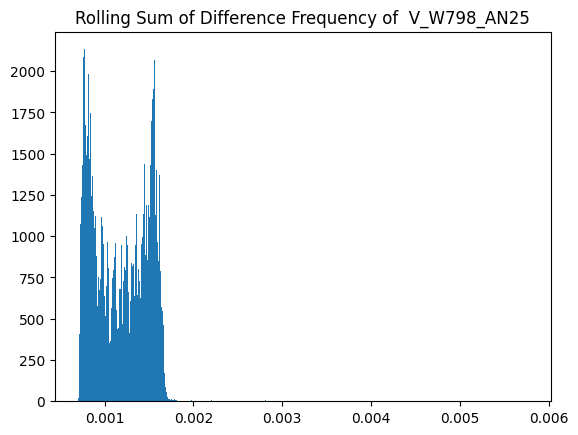

******************************************************************************


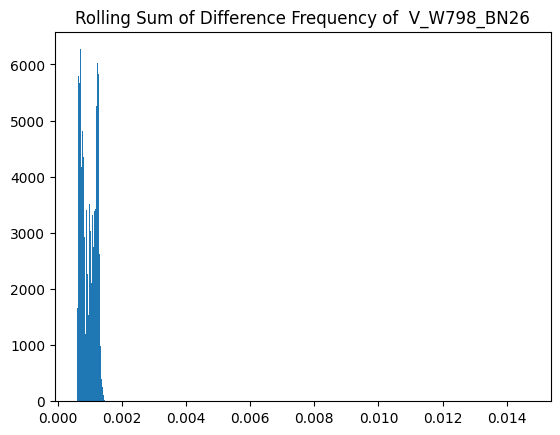

******************************************************************************


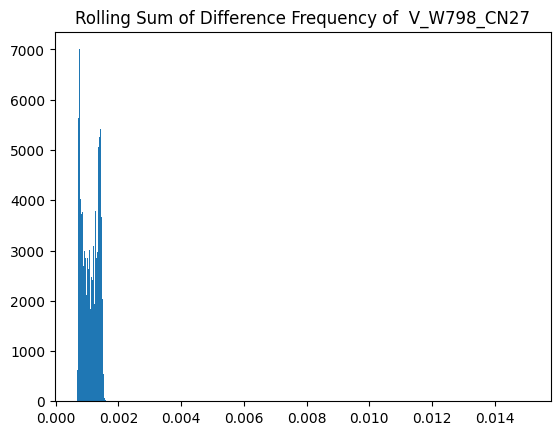

******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
****************************************************

In [14]:
corr_fn = correlation_pair
thresholds_corr, corr_multi_list = get_threshold_stat_only(data, corr_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=1, axis=1, stat_list=None, plot=True, collate_fn="sum")
thresholds_corr_99, corr_multi_list = get_threshold_stat_only(data, corr_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.99, axis=1, stat_list=corr_multi_list, collate_fn="sum")
thresholds_corr_95, corr_multi_list = get_threshold_stat_only(data, corr_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.95, axis=1, stat_list=corr_multi_list, collate_fn="sum")

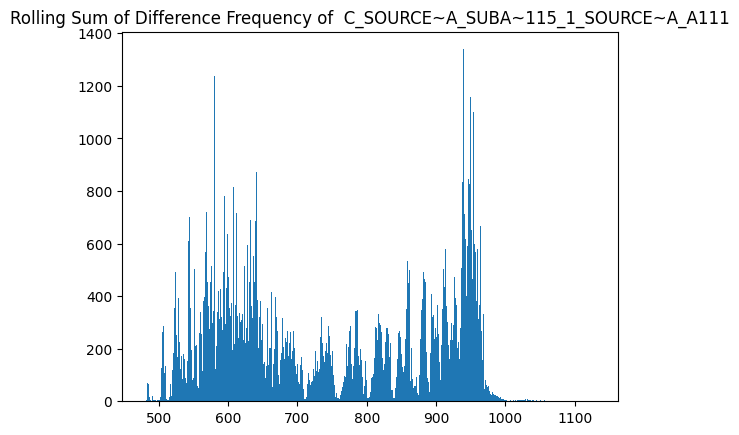

******************************************************************************


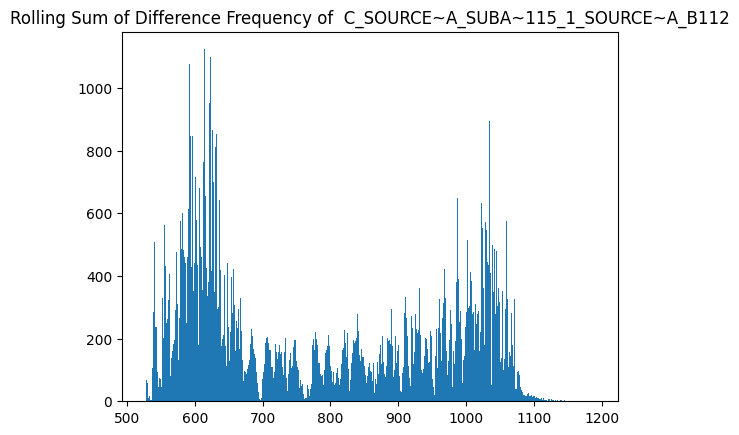

******************************************************************************


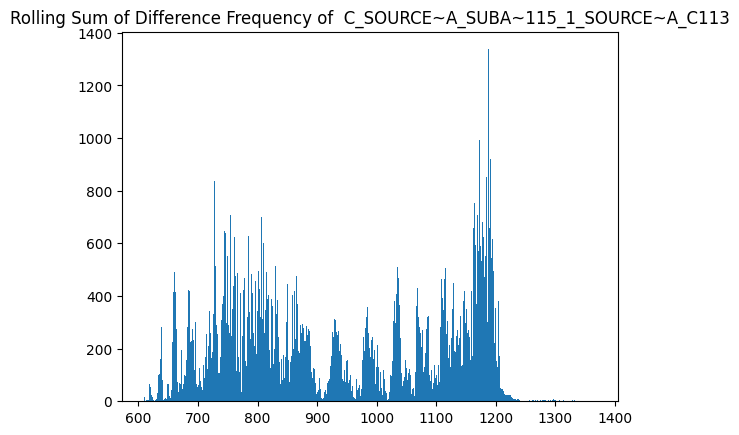

******************************************************************************


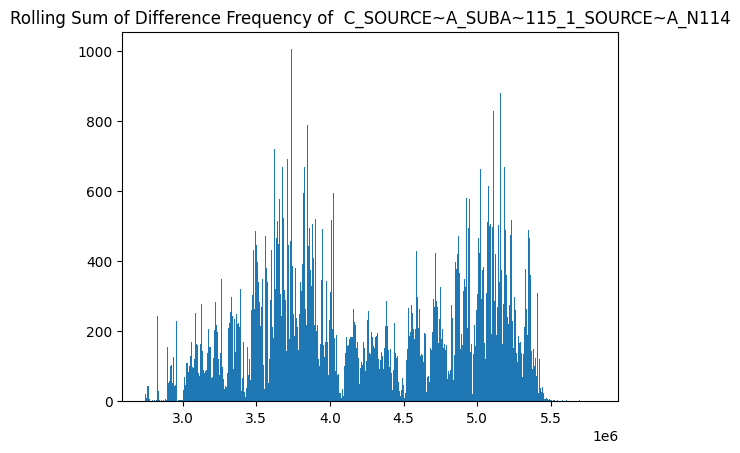

******************************************************************************


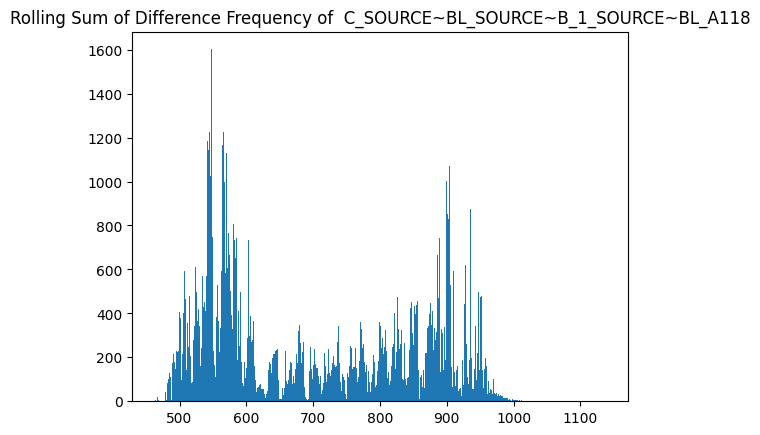

******************************************************************************


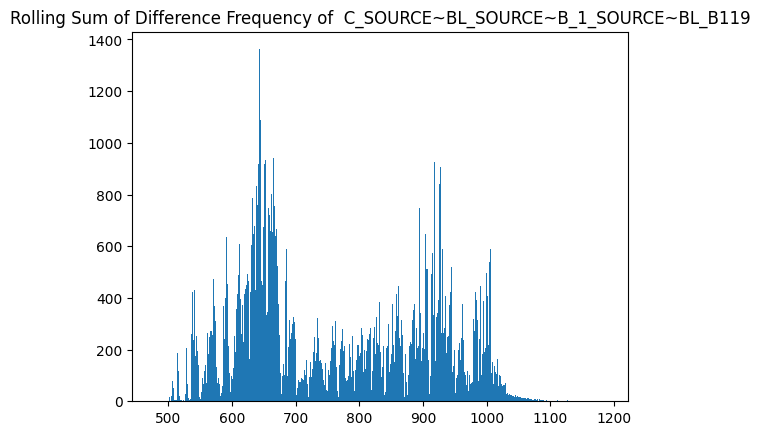

******************************************************************************


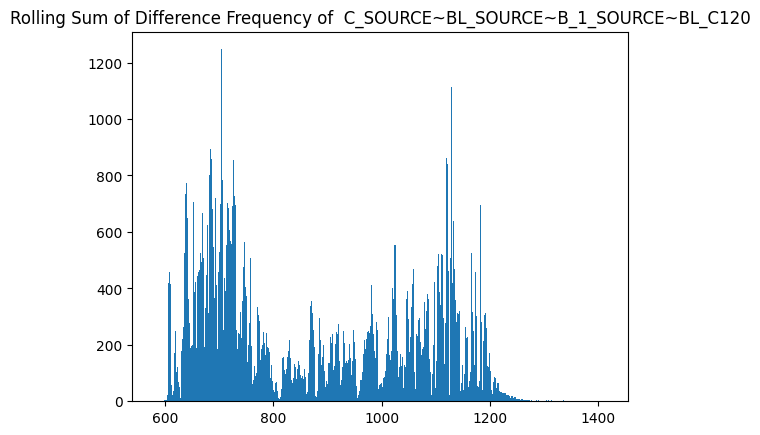

******************************************************************************


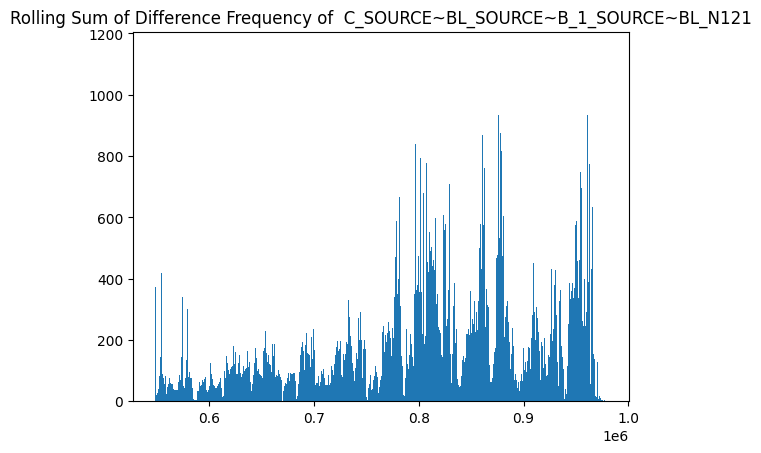

******************************************************************************


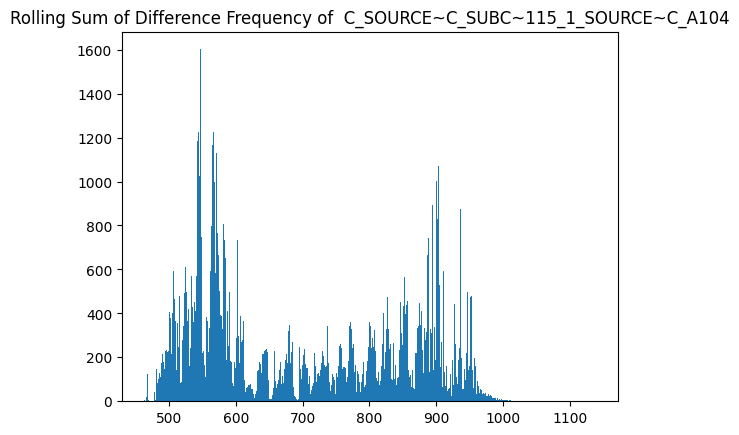

******************************************************************************


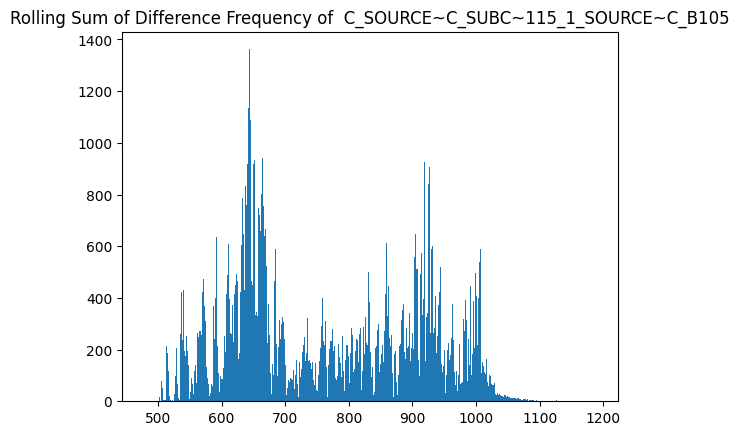

******************************************************************************


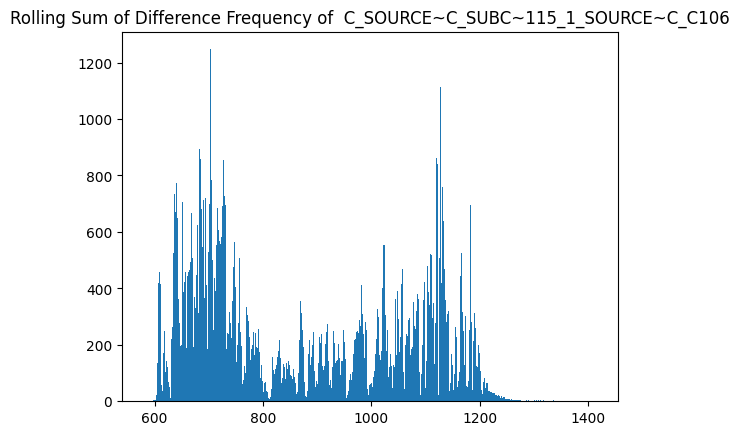

******************************************************************************


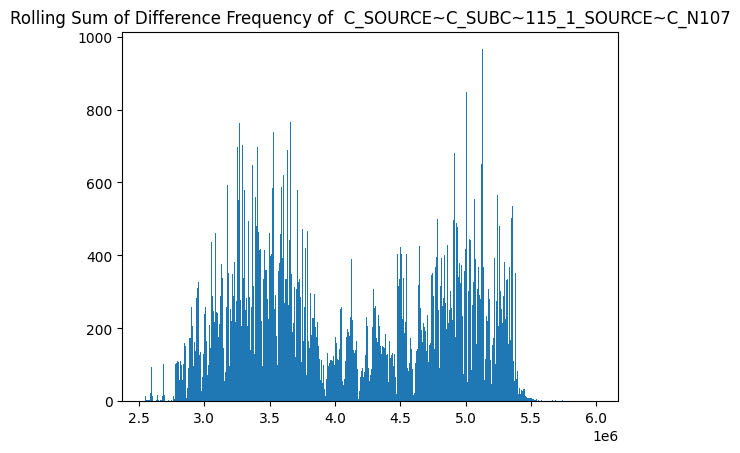

******************************************************************************


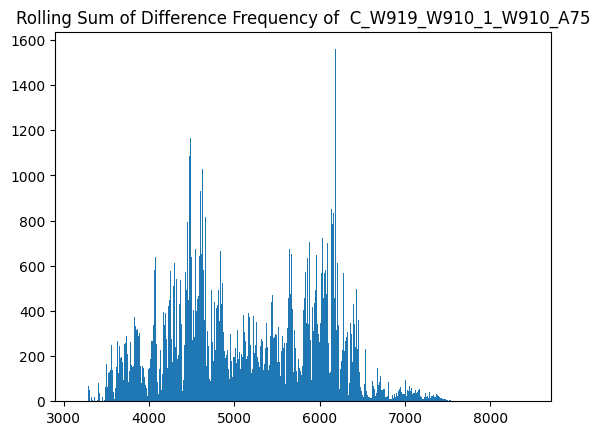

******************************************************************************


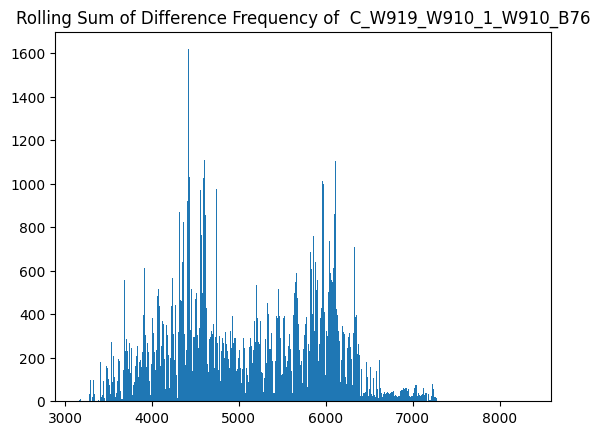

******************************************************************************


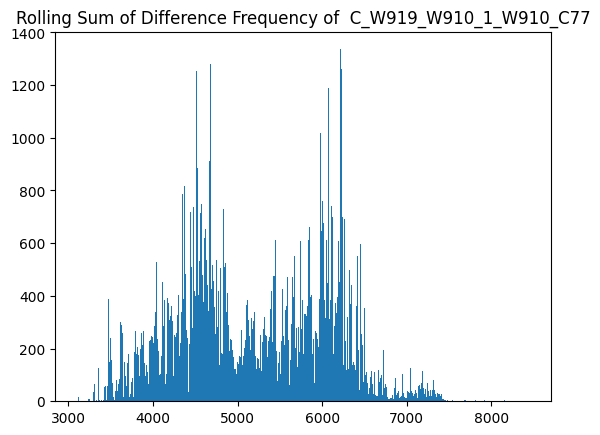

******************************************************************************


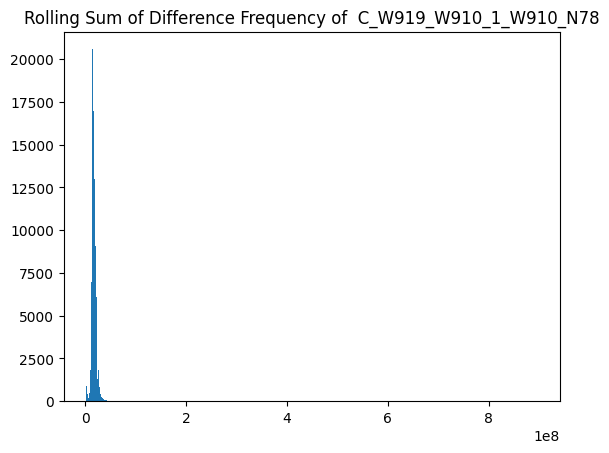

******************************************************************************


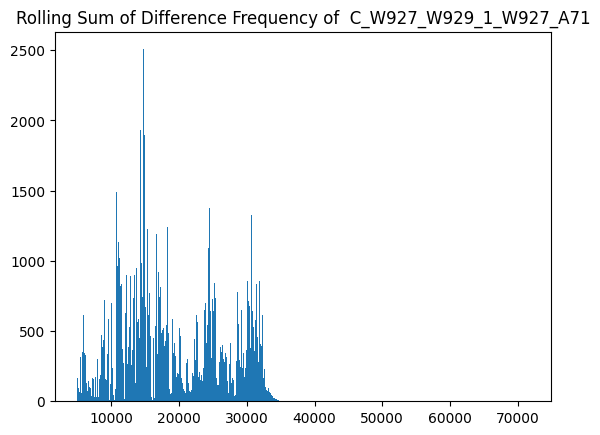

******************************************************************************


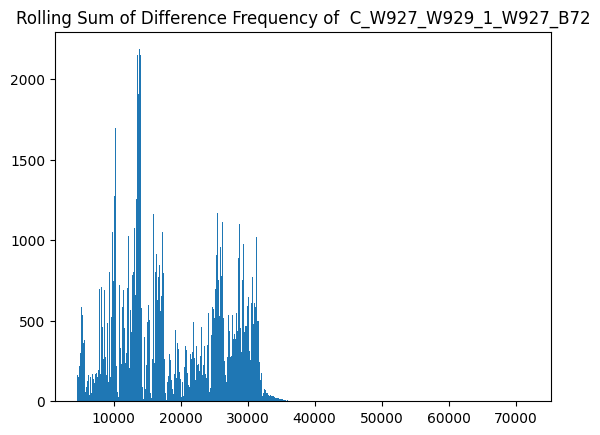

******************************************************************************


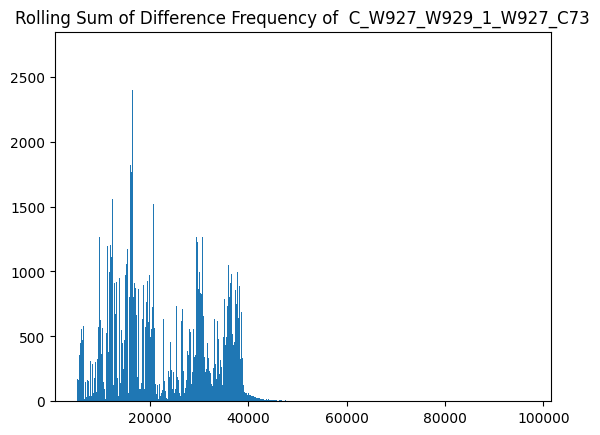

******************************************************************************


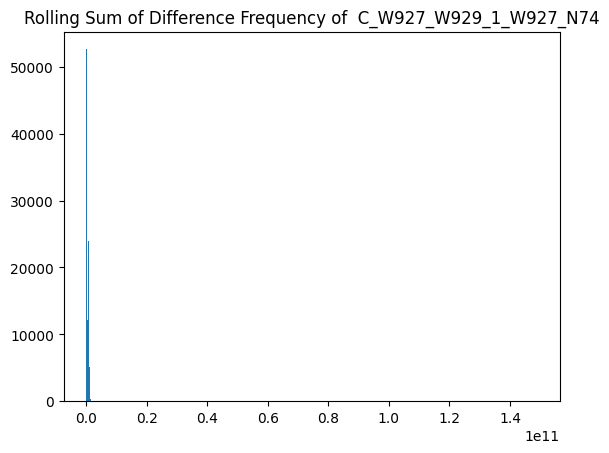

******************************************************************************


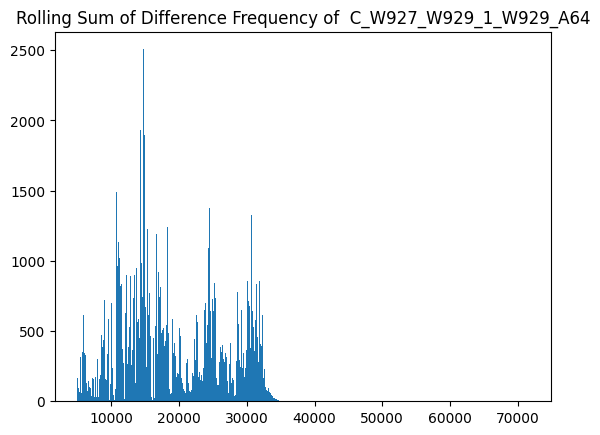

******************************************************************************


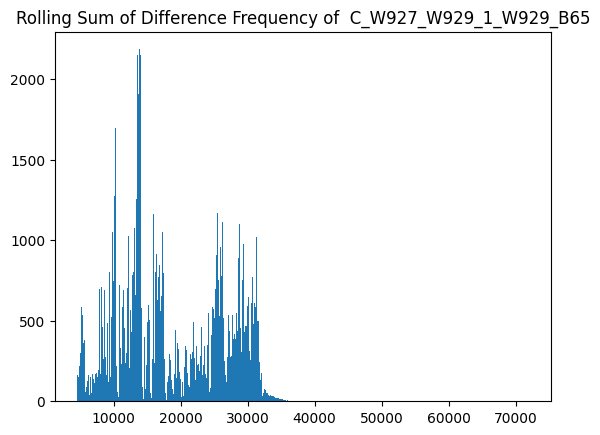

******************************************************************************


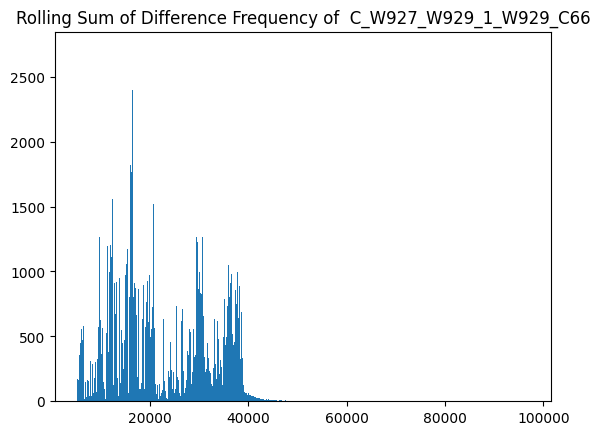

******************************************************************************


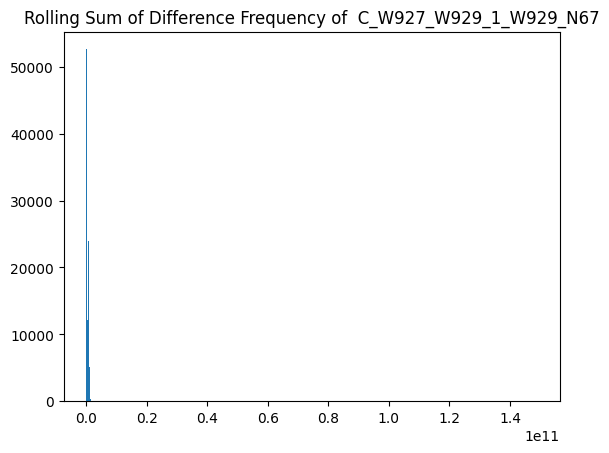

******************************************************************************


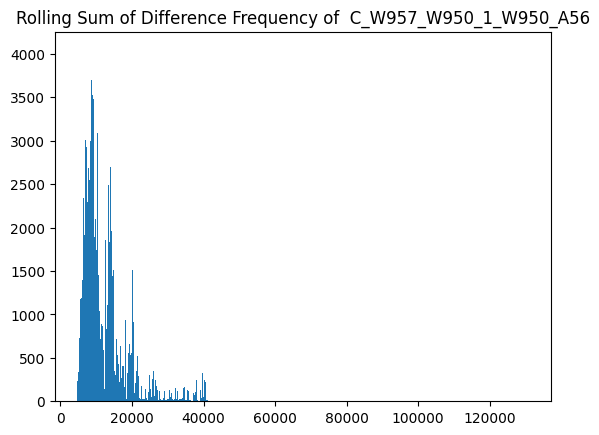

******************************************************************************


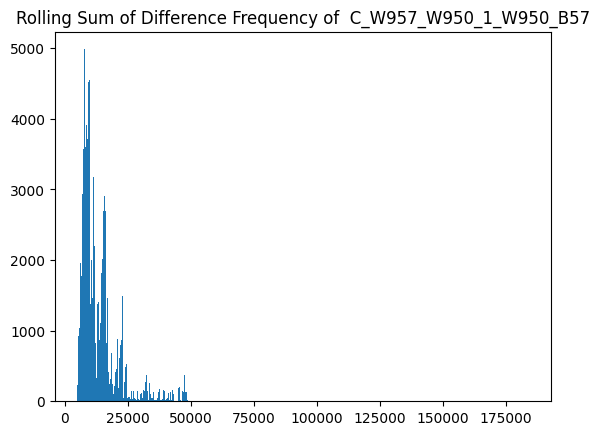

******************************************************************************


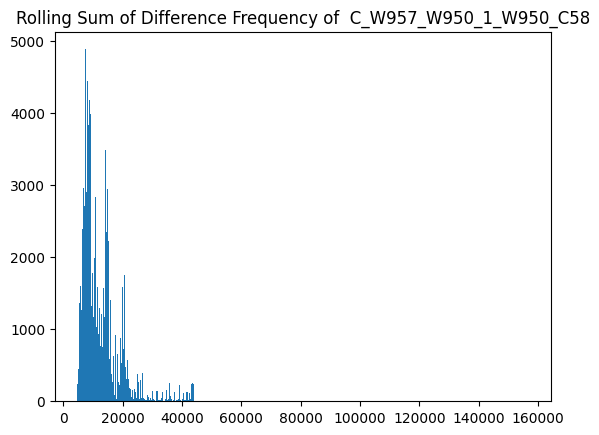

******************************************************************************


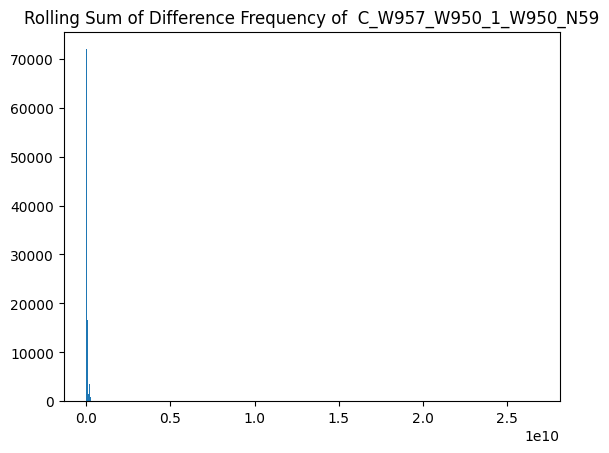

******************************************************************************


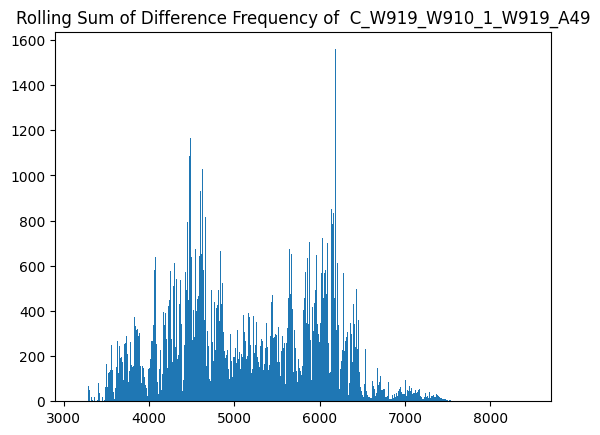

******************************************************************************


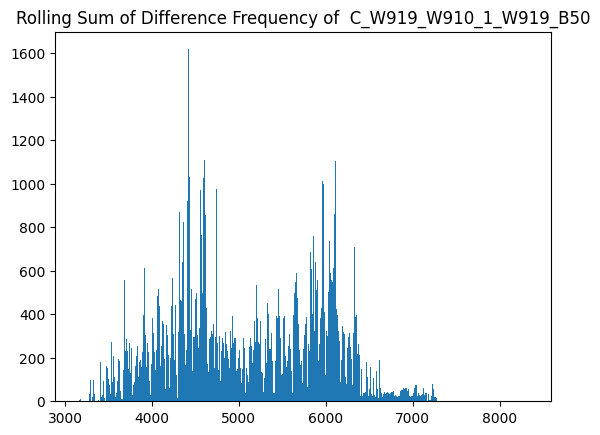

******************************************************************************


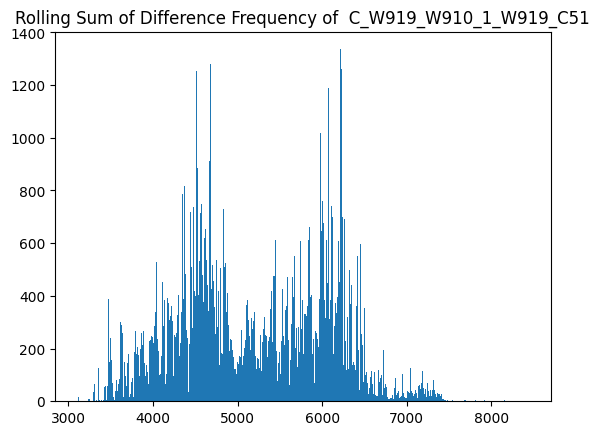

******************************************************************************


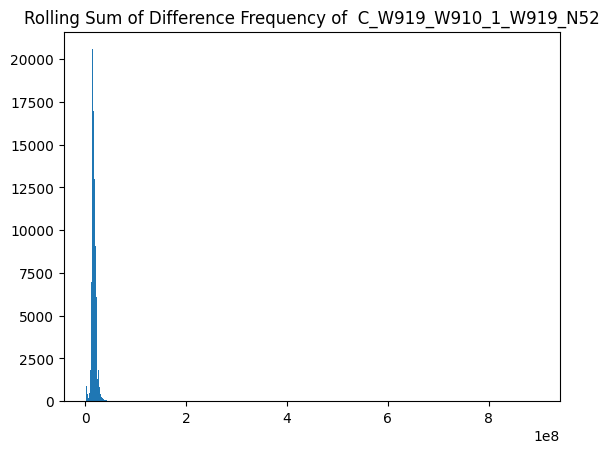

******************************************************************************


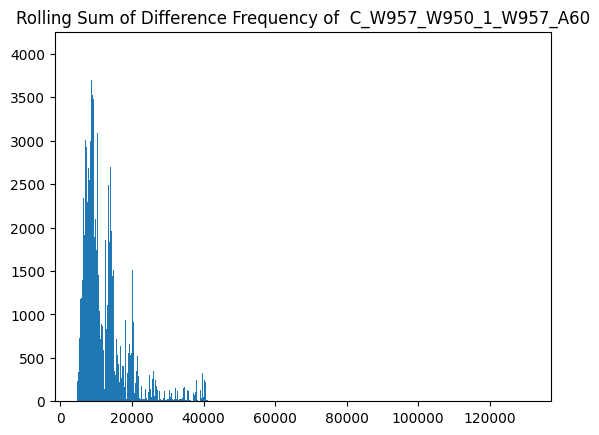

******************************************************************************


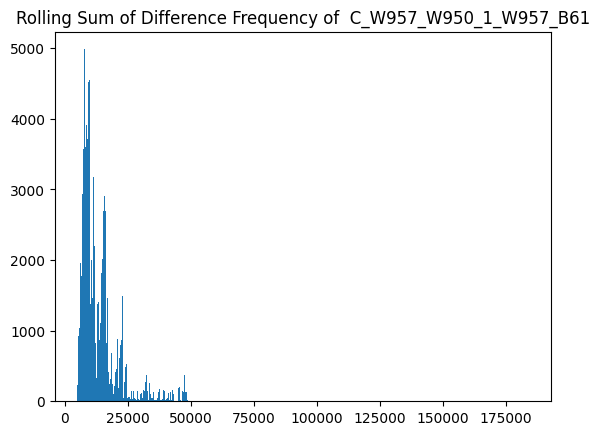

******************************************************************************


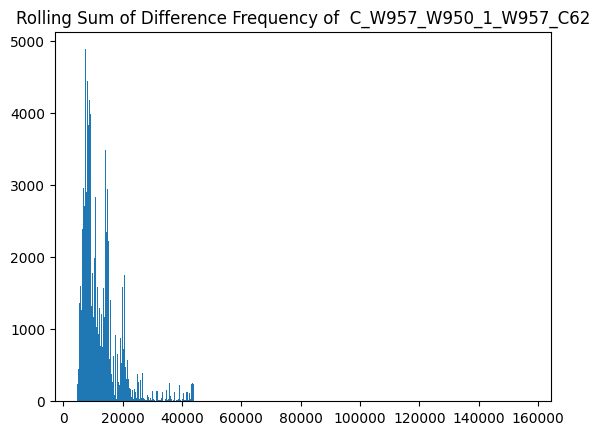

******************************************************************************


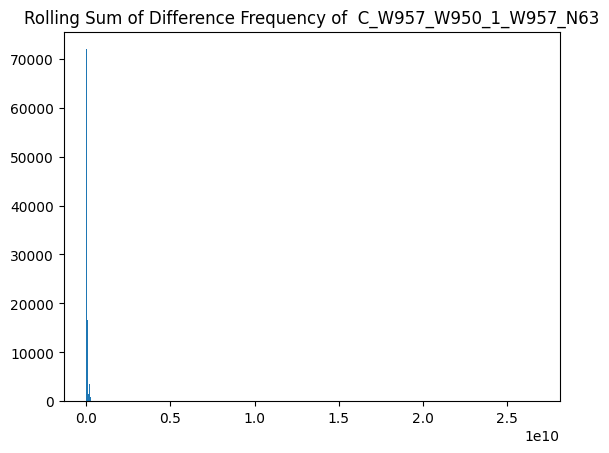

******************************************************************************


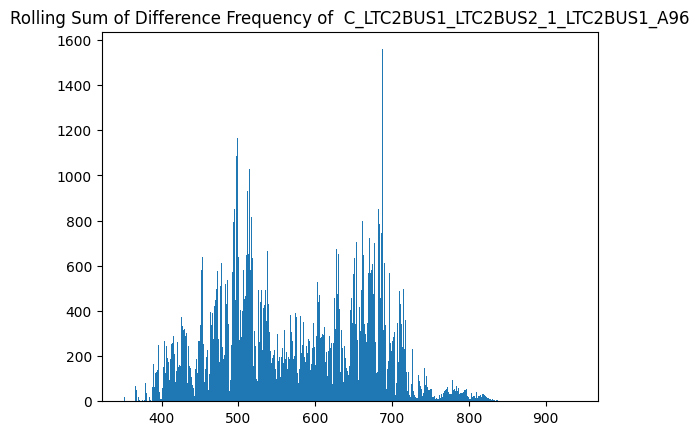

******************************************************************************


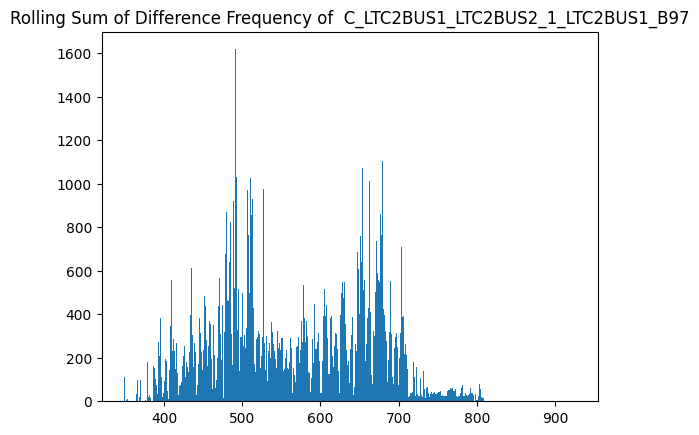

******************************************************************************


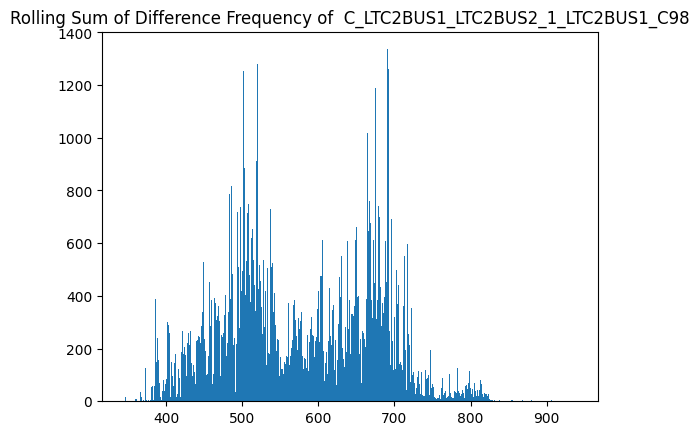

******************************************************************************


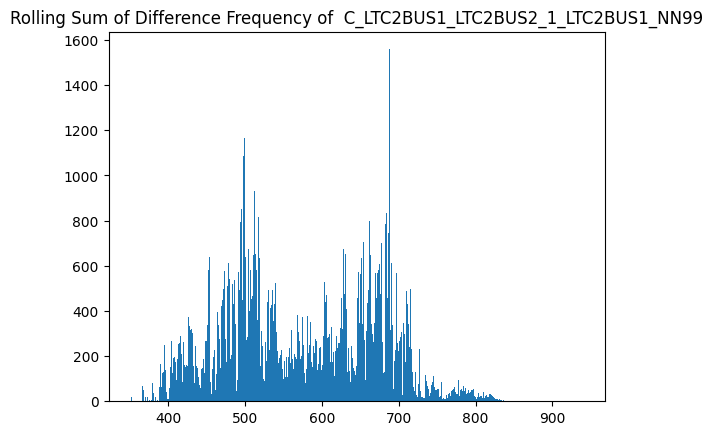

******************************************************************************


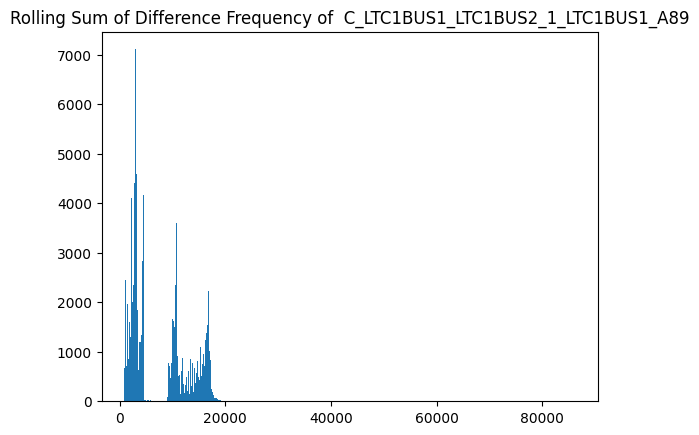

******************************************************************************


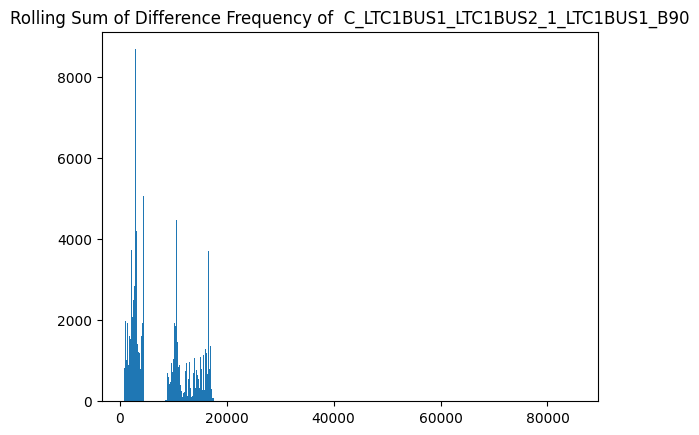

******************************************************************************


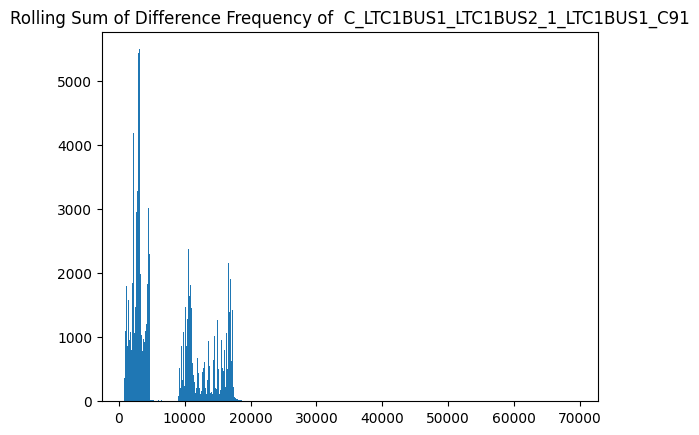

******************************************************************************


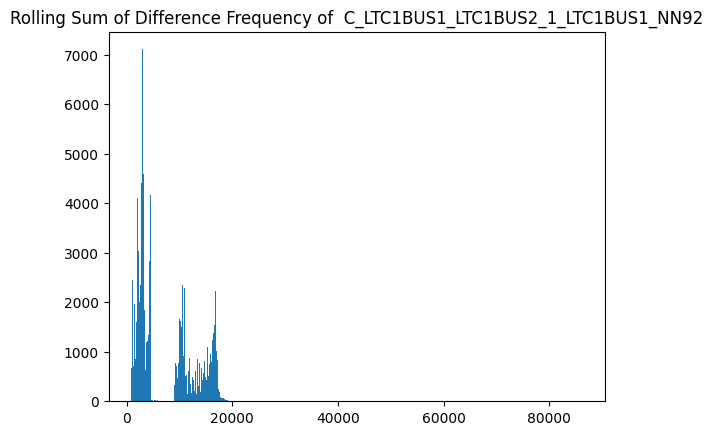

******************************************************************************


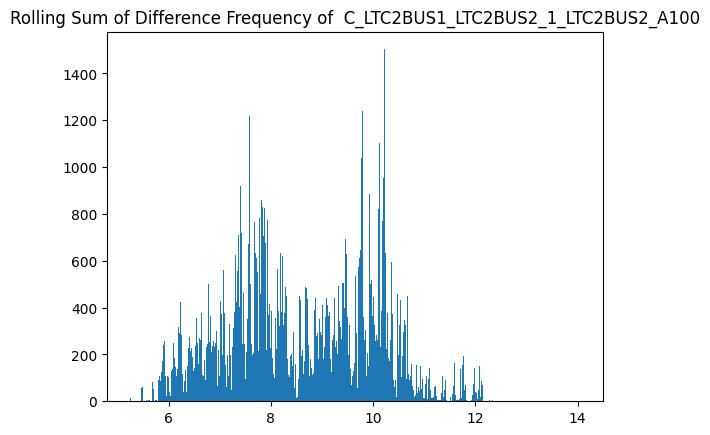

******************************************************************************


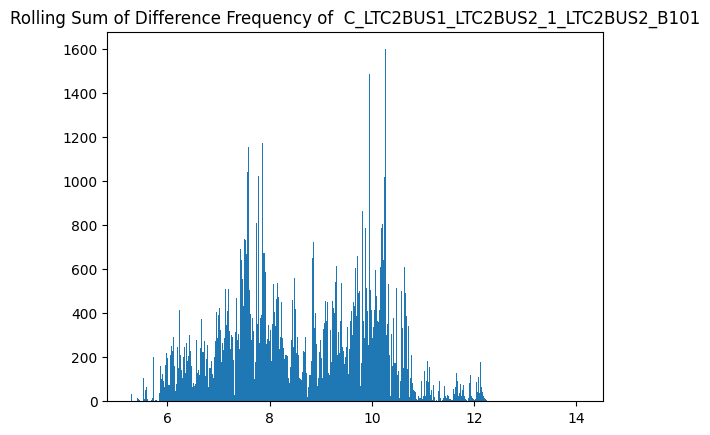

******************************************************************************


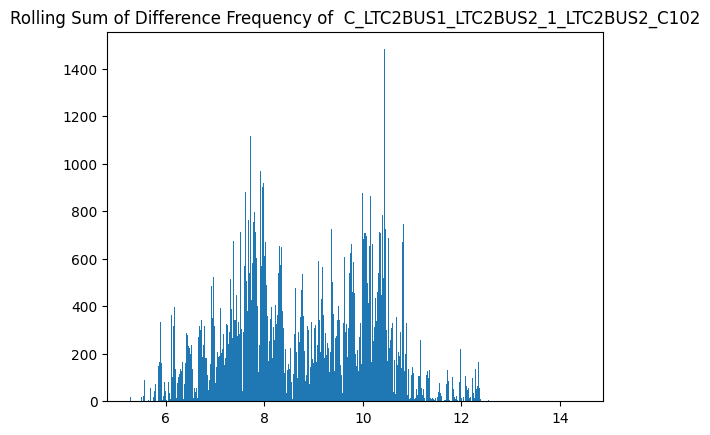

******************************************************************************


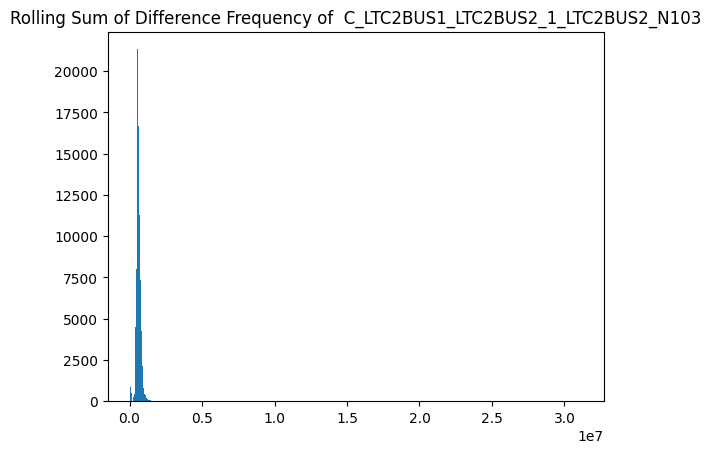

******************************************************************************


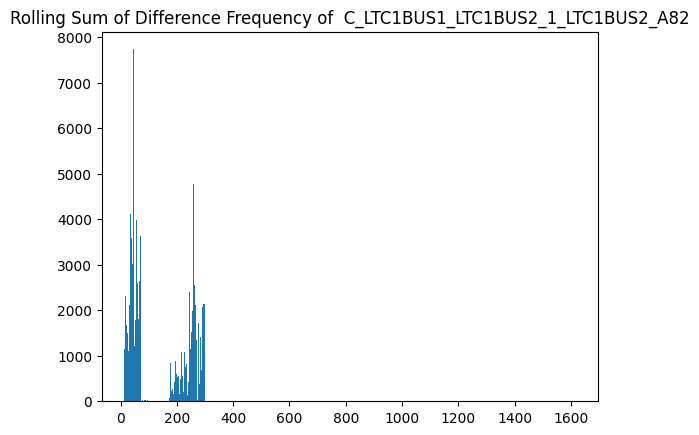

******************************************************************************


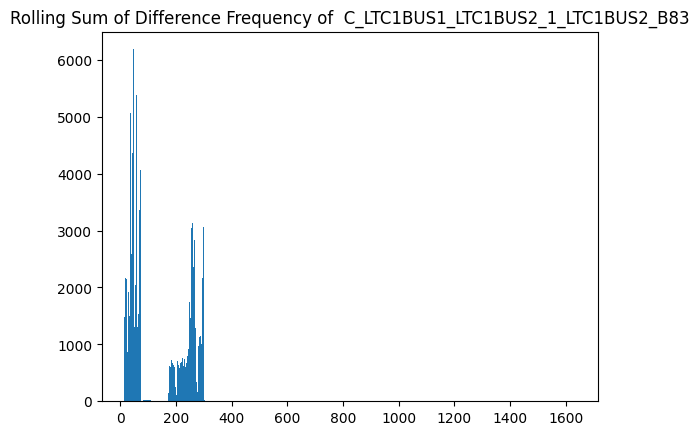

******************************************************************************


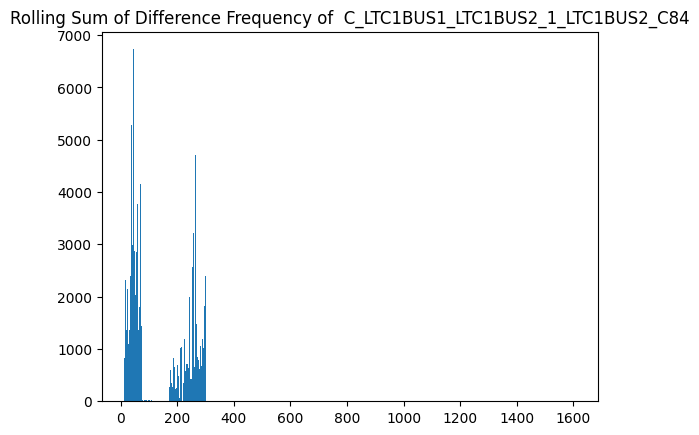

******************************************************************************


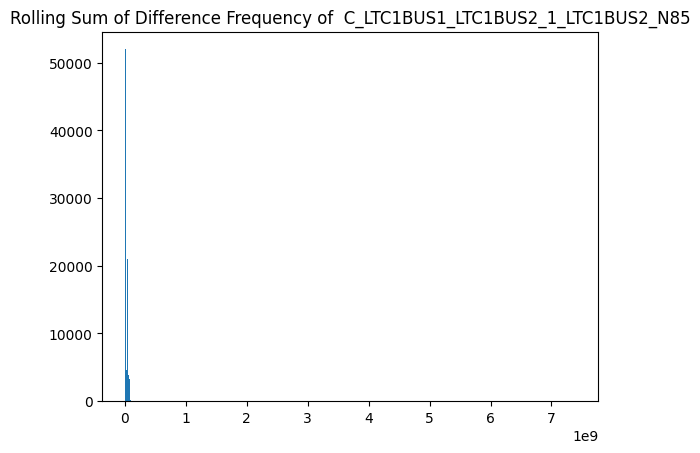

******************************************************************************


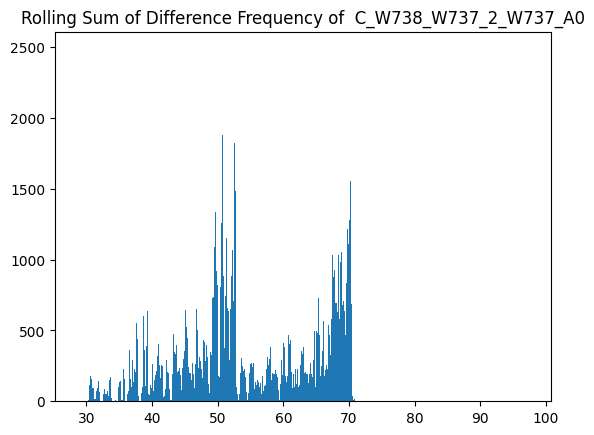

******************************************************************************


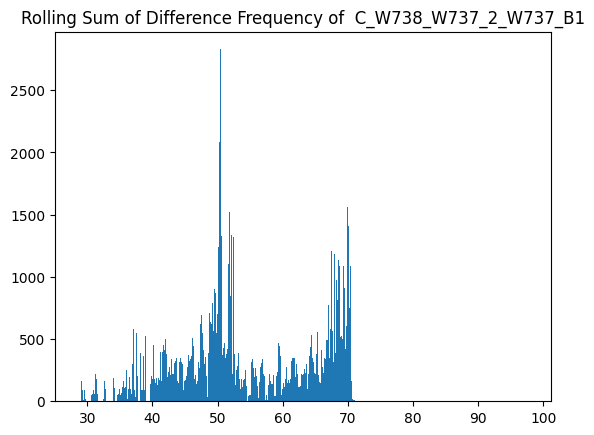

******************************************************************************


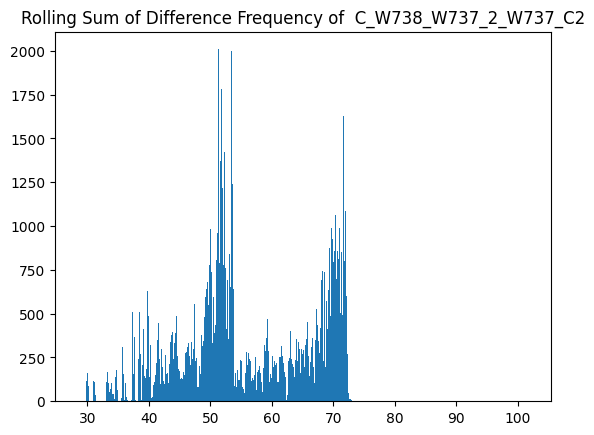

******************************************************************************


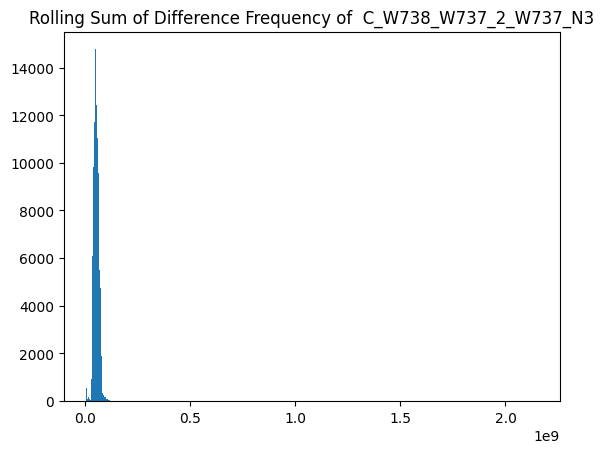

******************************************************************************


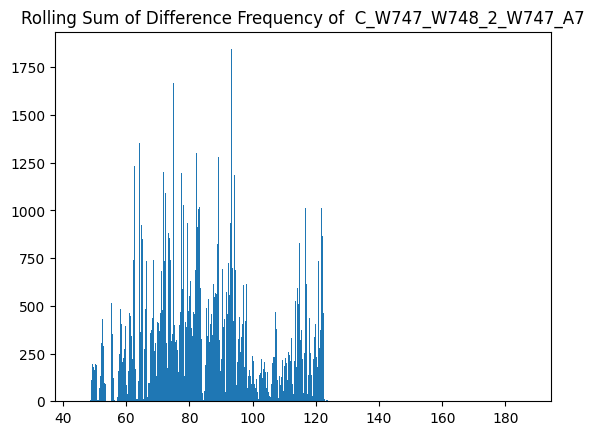

******************************************************************************


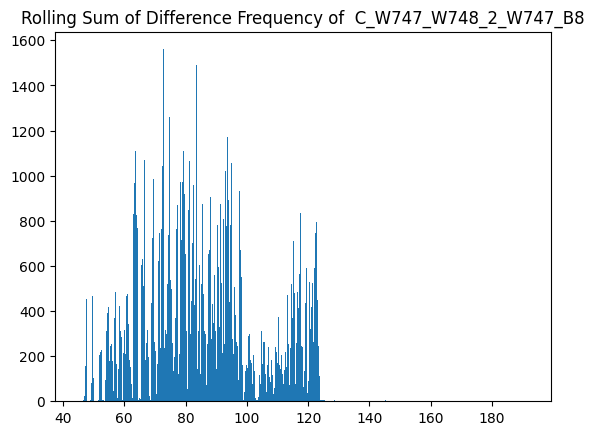

******************************************************************************


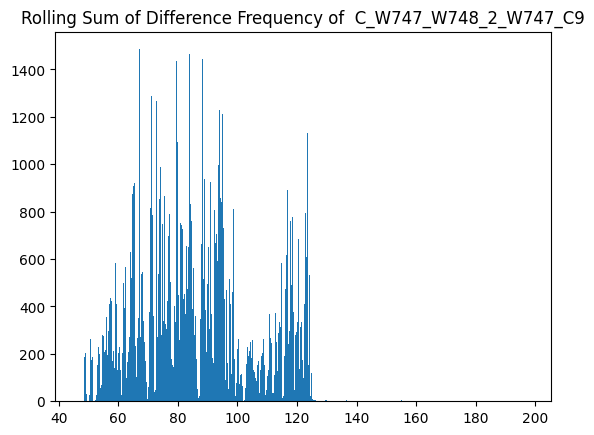

******************************************************************************


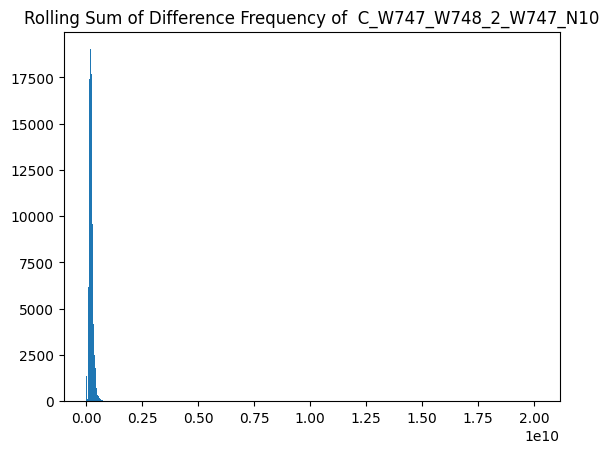

******************************************************************************


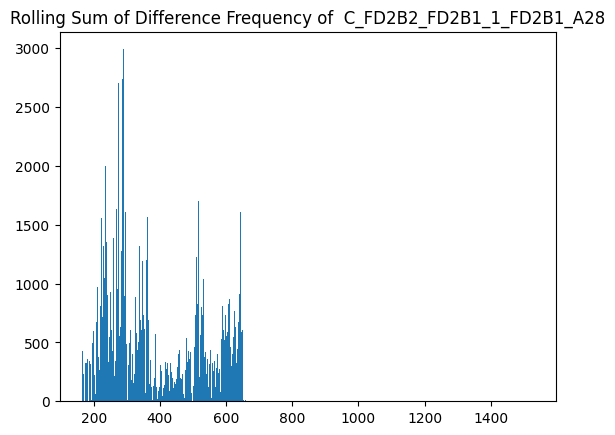

******************************************************************************


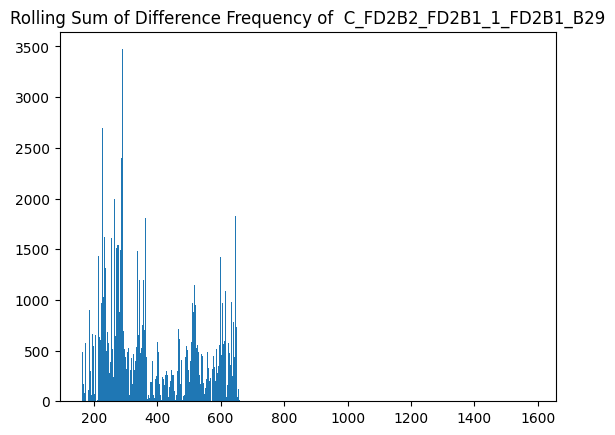

******************************************************************************


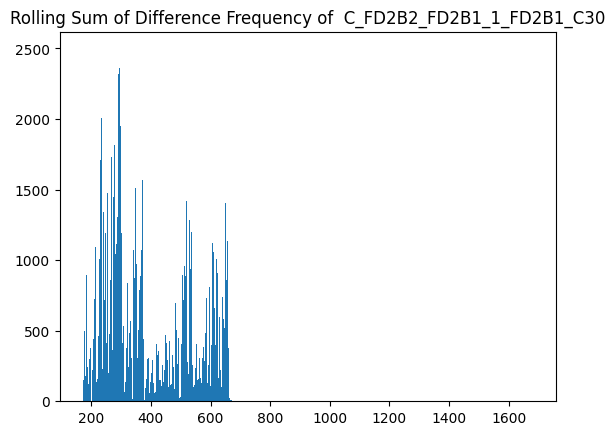

******************************************************************************


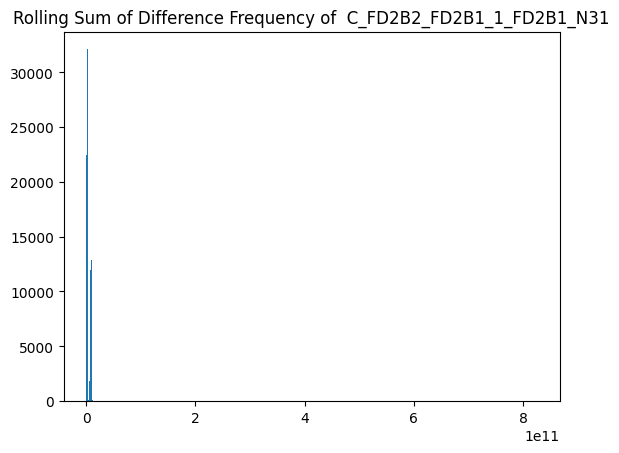

******************************************************************************


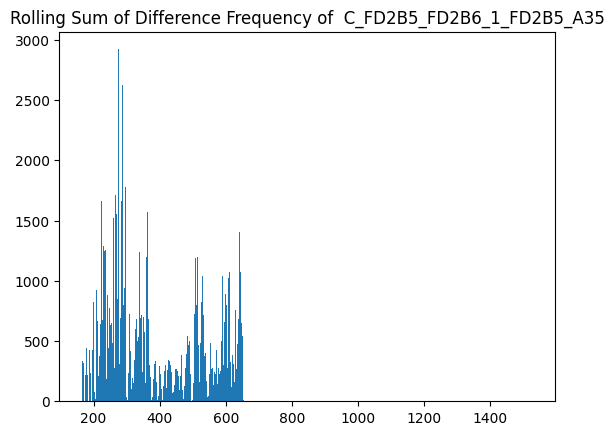

******************************************************************************


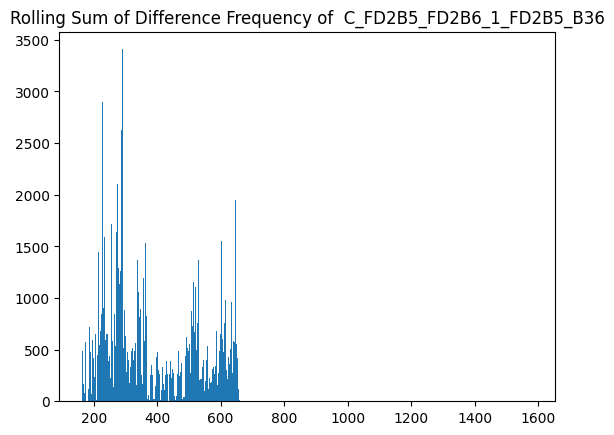

******************************************************************************


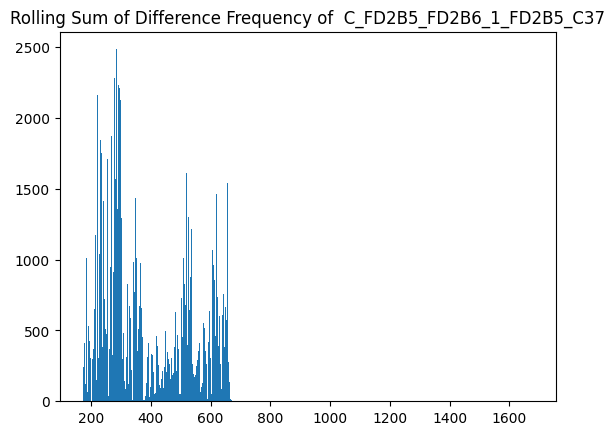

******************************************************************************


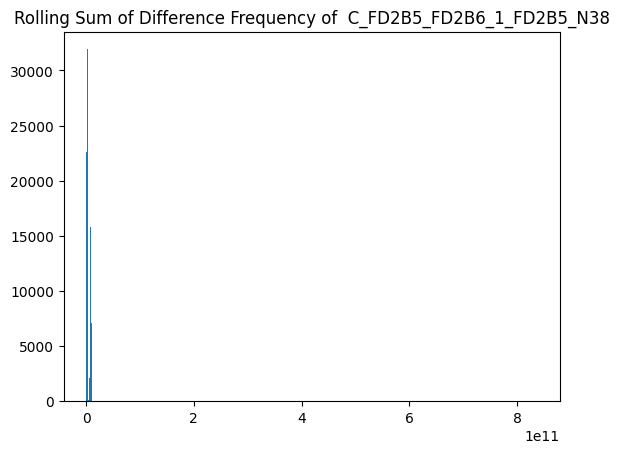

******************************************************************************


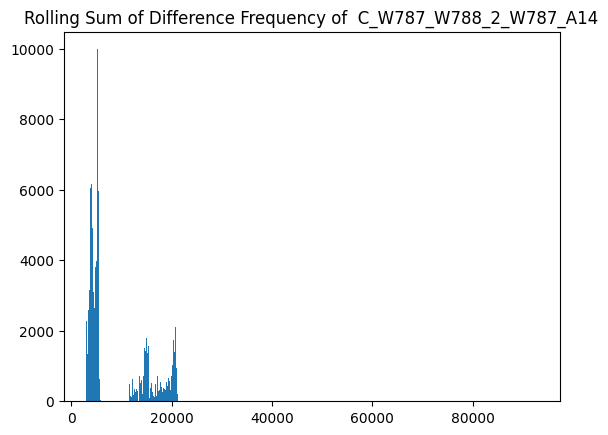

******************************************************************************


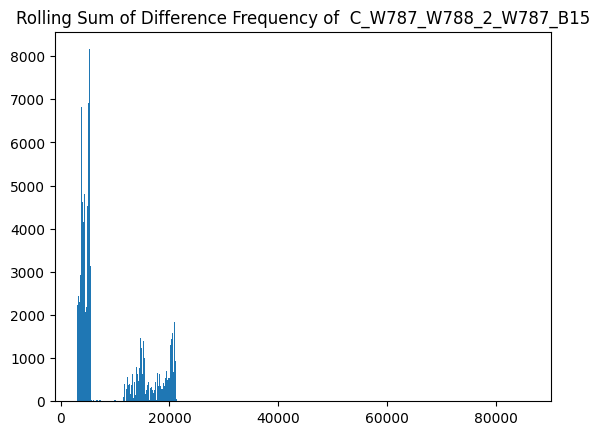

******************************************************************************


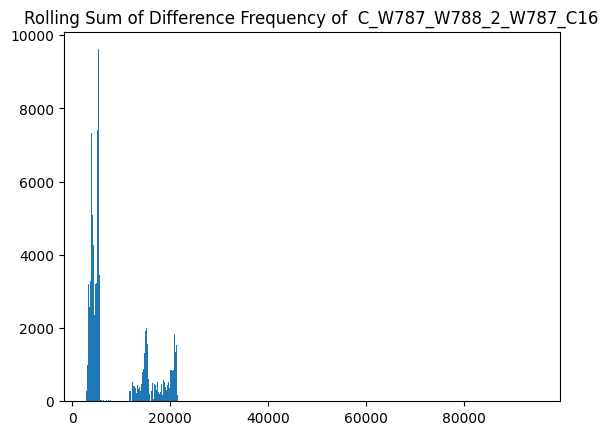

******************************************************************************


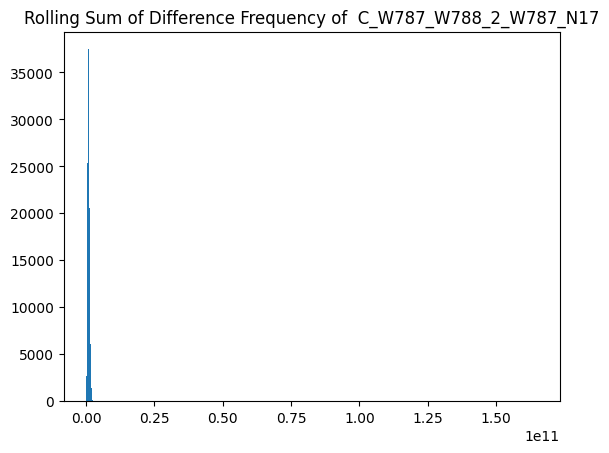

******************************************************************************


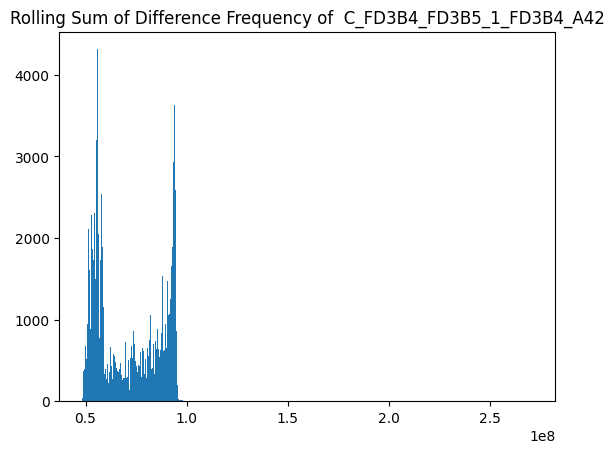

******************************************************************************


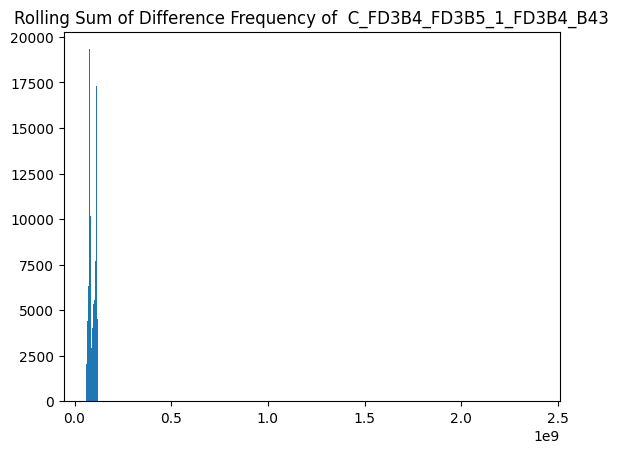

******************************************************************************


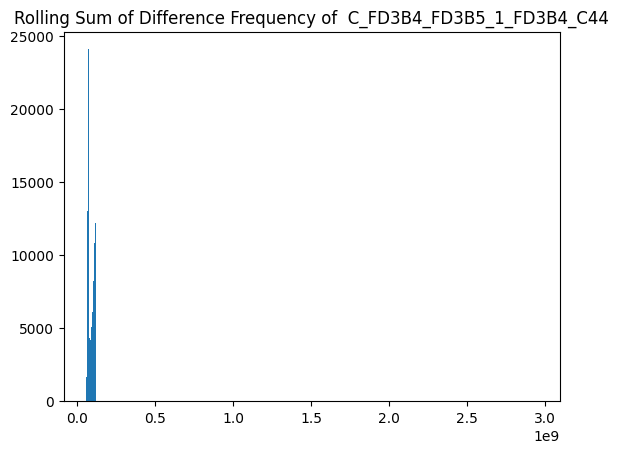

******************************************************************************


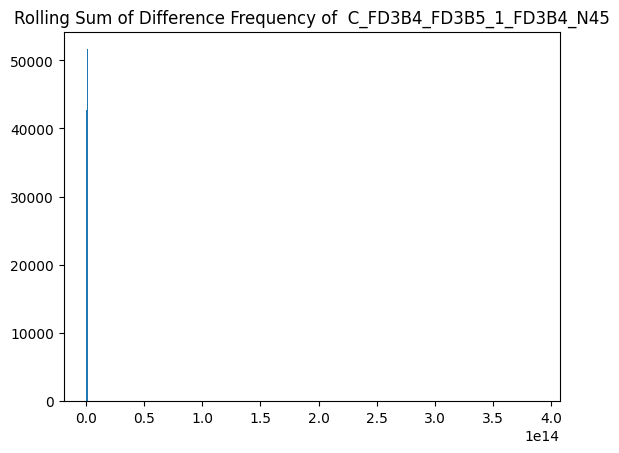

******************************************************************************


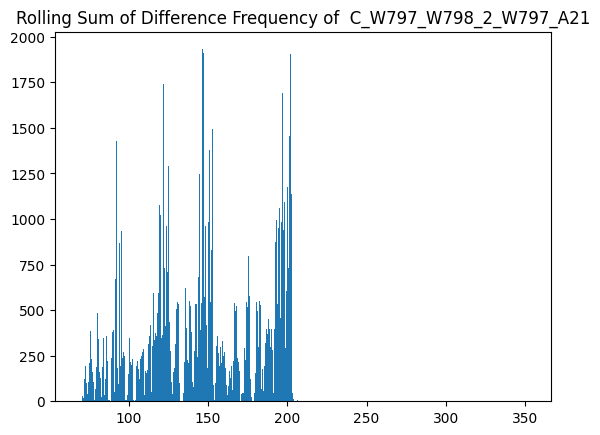

******************************************************************************


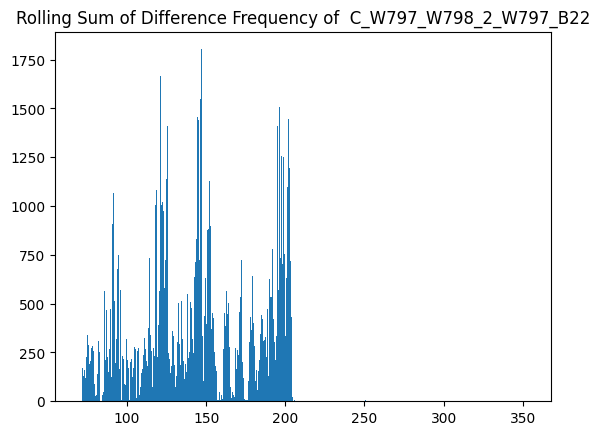

******************************************************************************


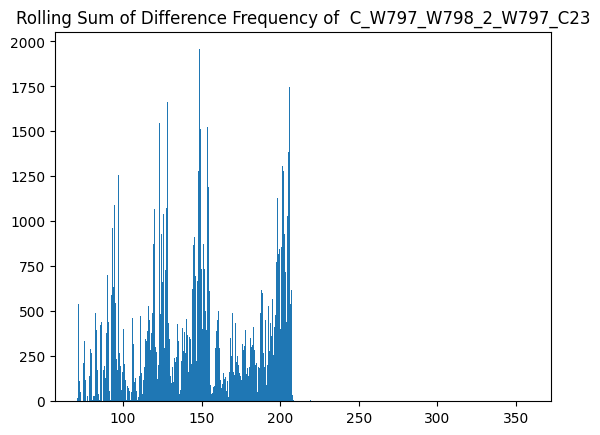

******************************************************************************


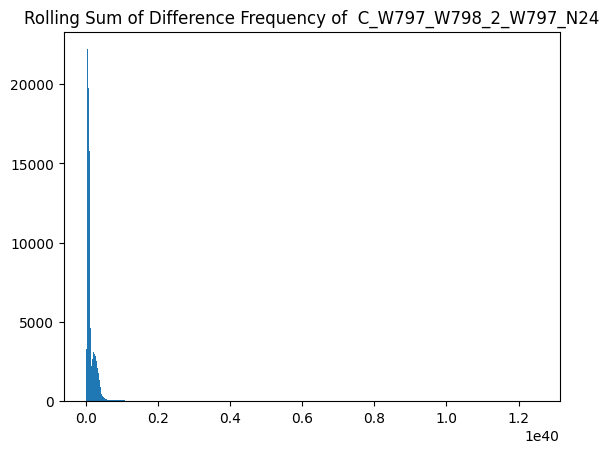

******************************************************************************


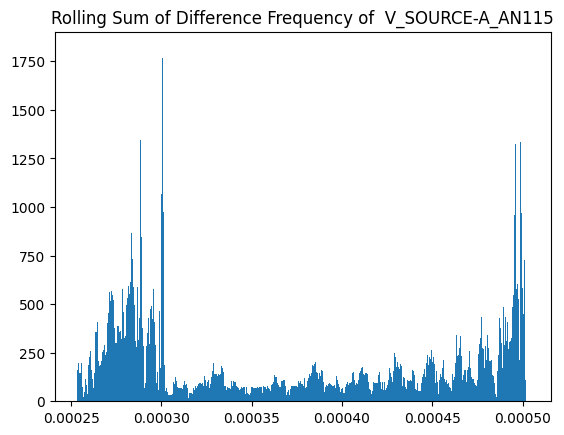

******************************************************************************


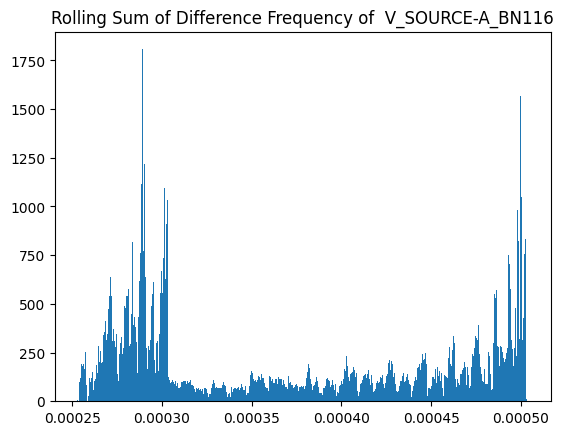

******************************************************************************


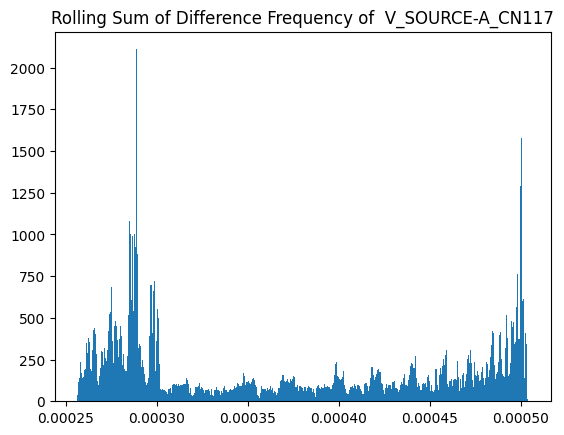

******************************************************************************


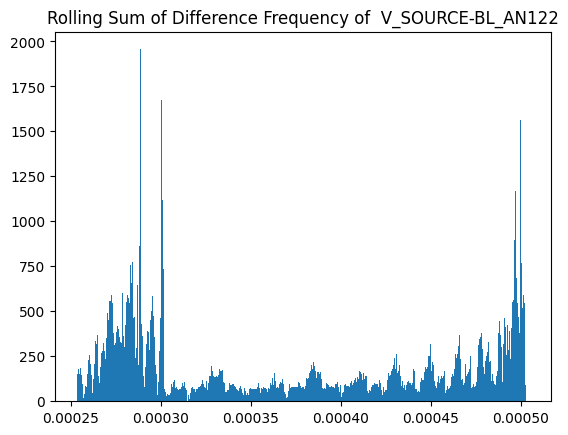

******************************************************************************


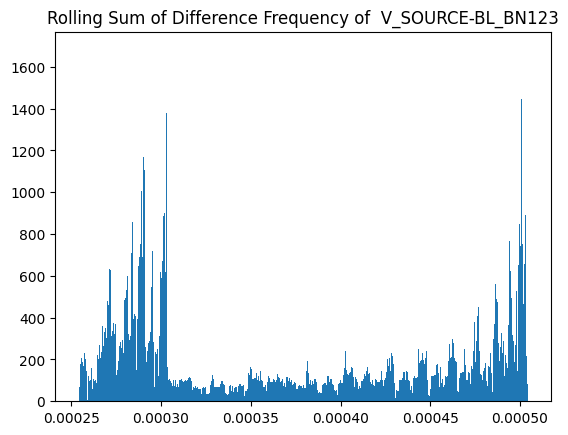

******************************************************************************


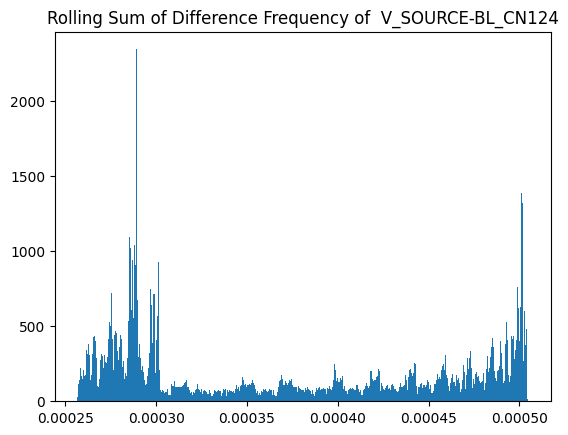

******************************************************************************


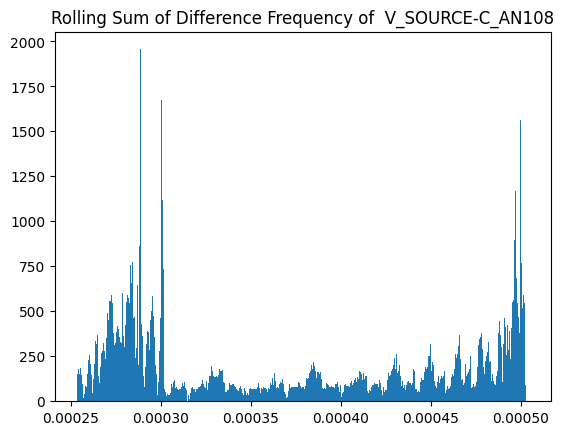

******************************************************************************


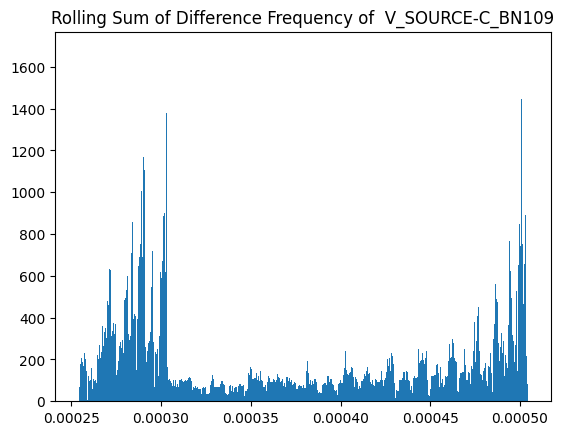

******************************************************************************


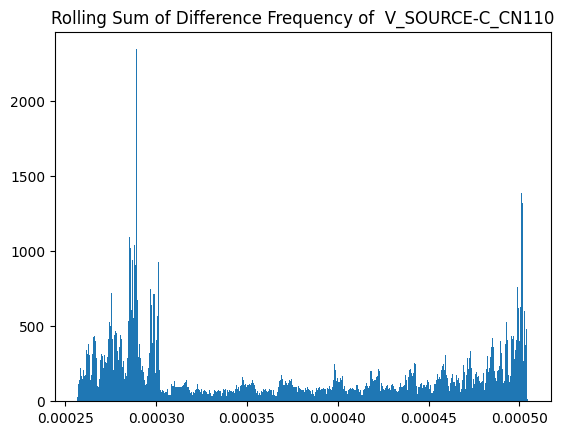

******************************************************************************


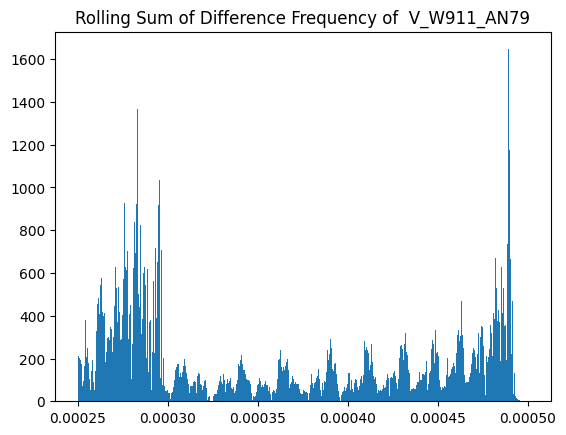

******************************************************************************


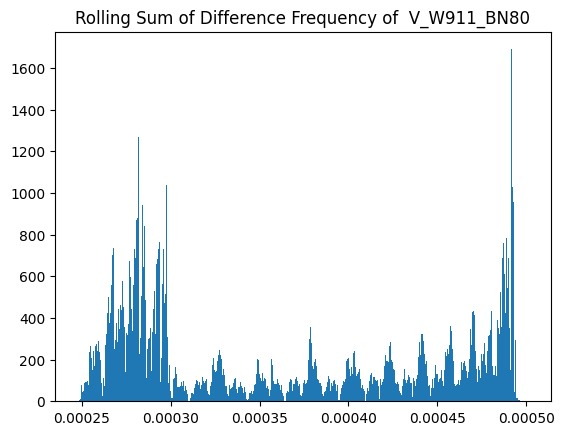

******************************************************************************


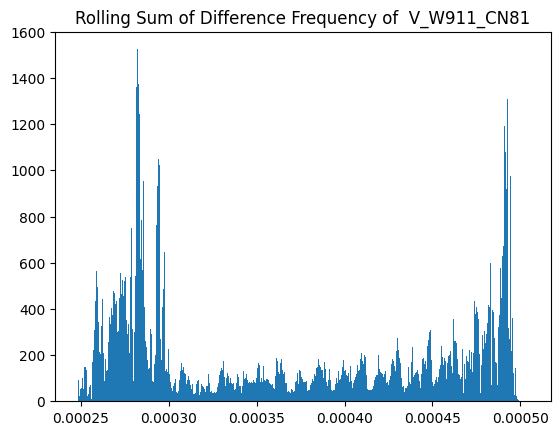

******************************************************************************


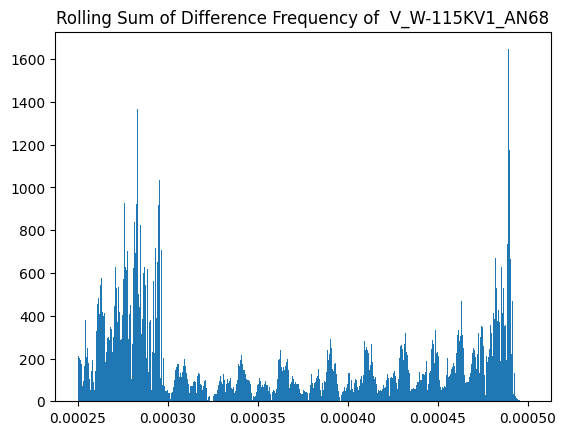

******************************************************************************


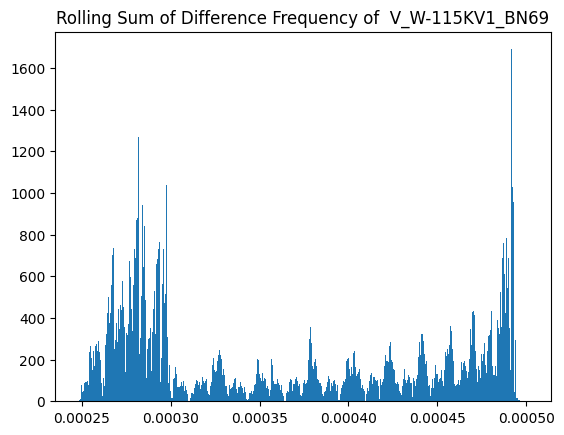

******************************************************************************


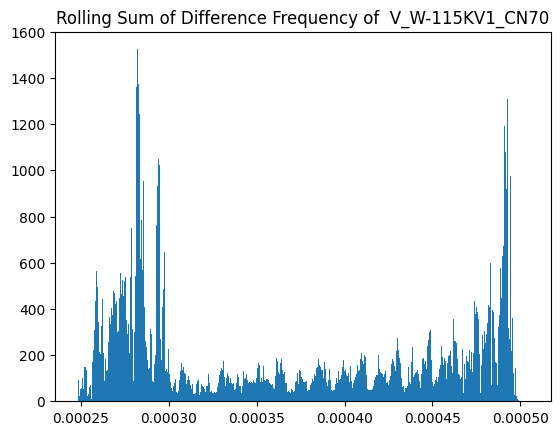

******************************************************************************


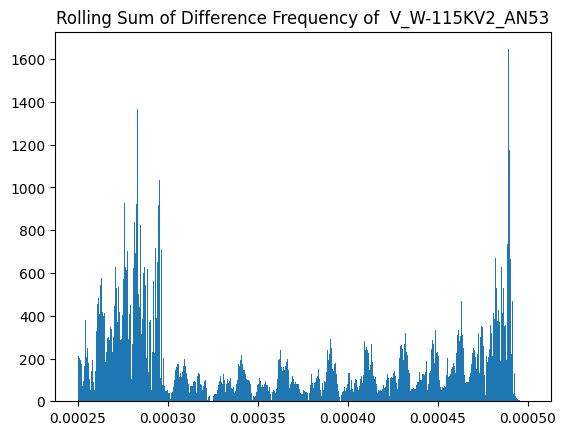

******************************************************************************


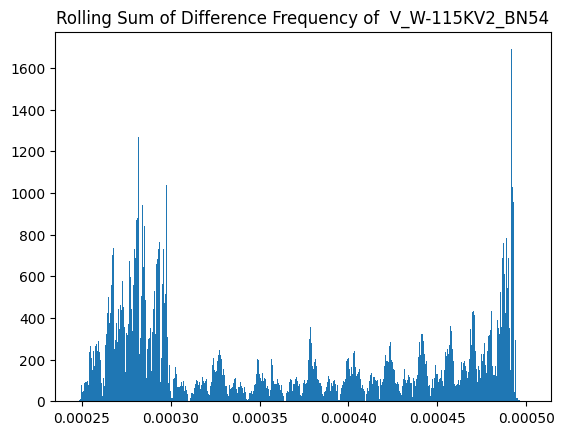

******************************************************************************


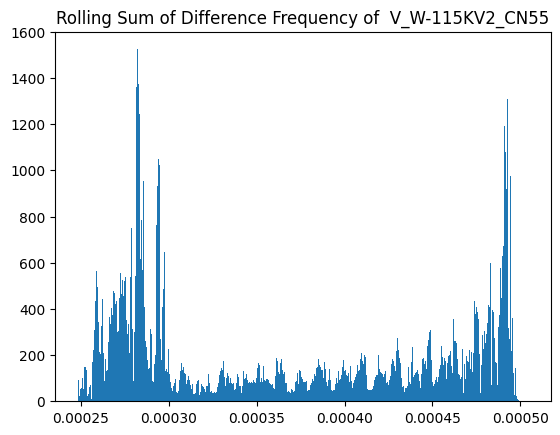

******************************************************************************


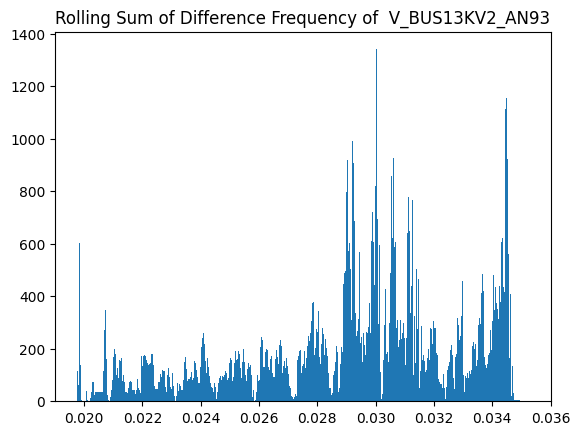

******************************************************************************


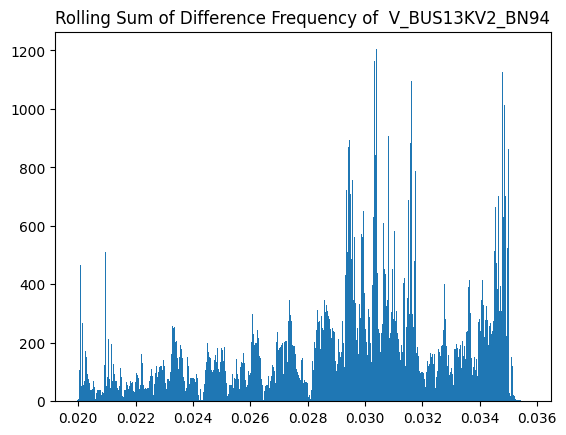

******************************************************************************


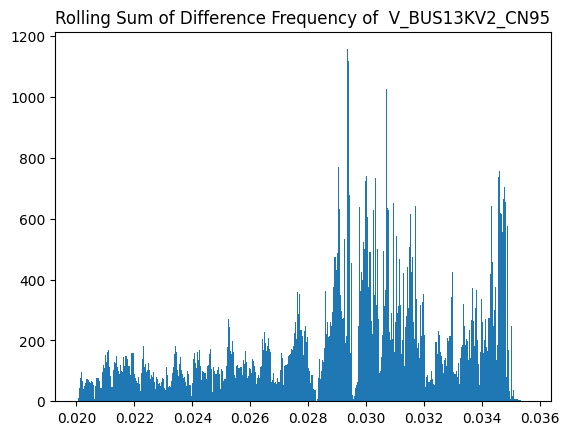

******************************************************************************


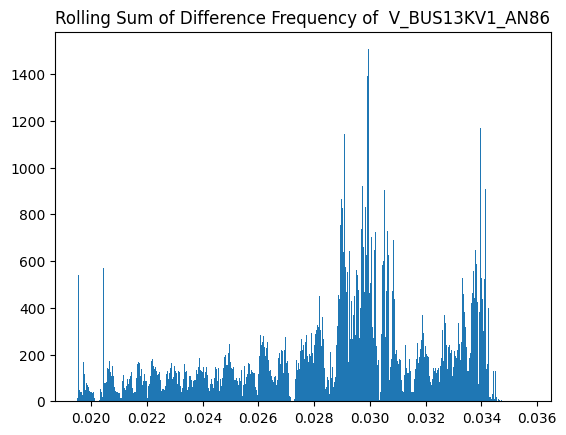

******************************************************************************


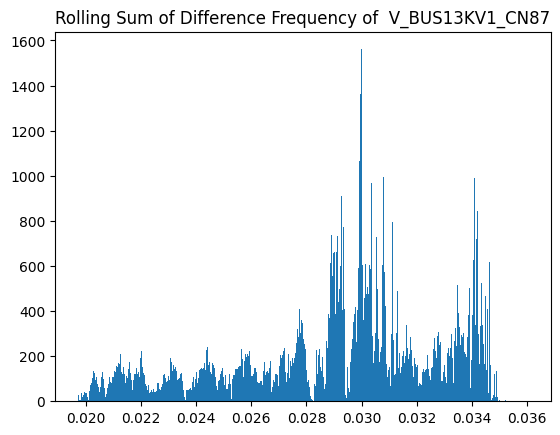

******************************************************************************


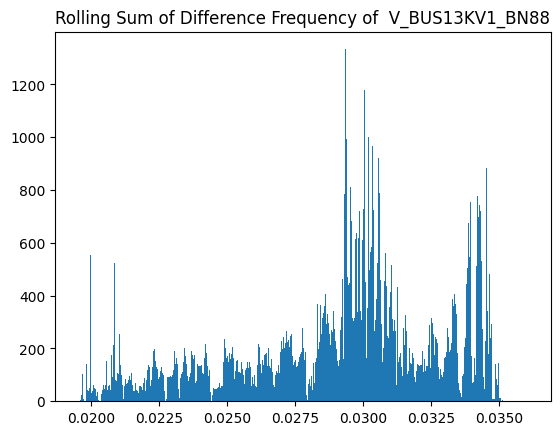

******************************************************************************


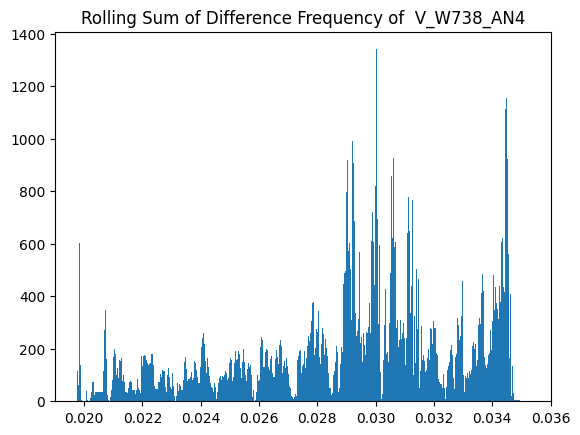

******************************************************************************


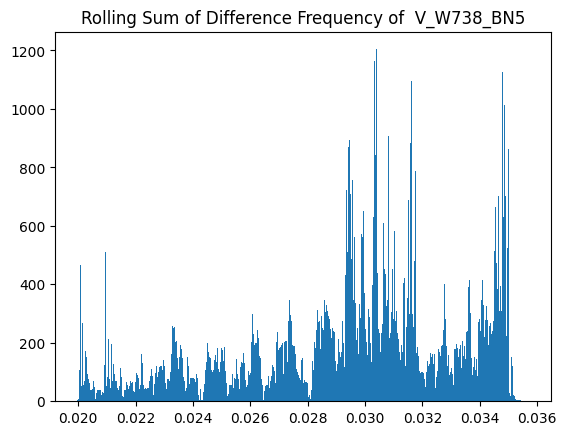

******************************************************************************


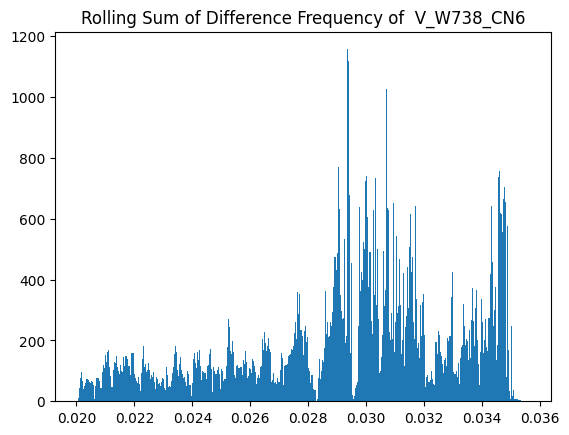

******************************************************************************


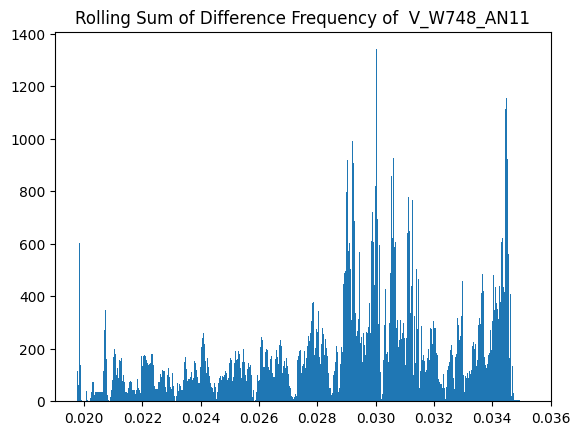

******************************************************************************


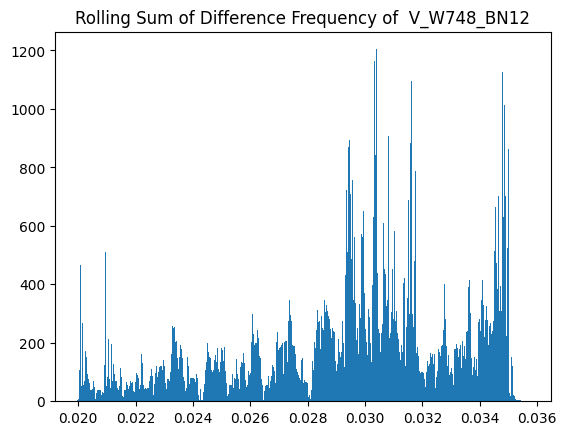

******************************************************************************


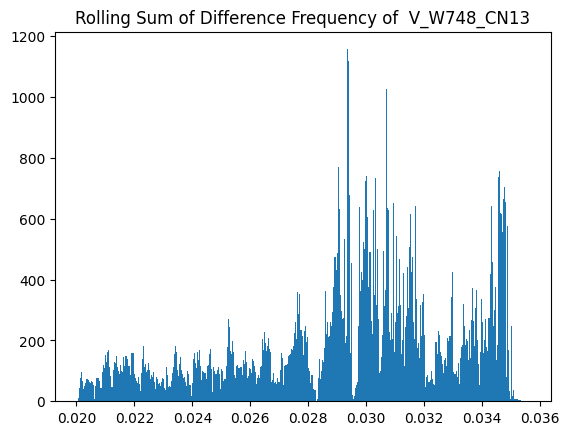

******************************************************************************


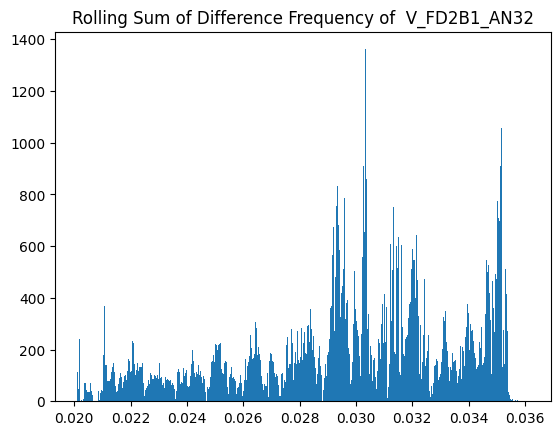

******************************************************************************


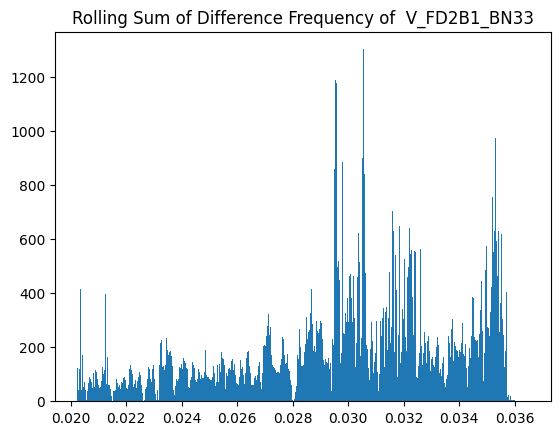

******************************************************************************


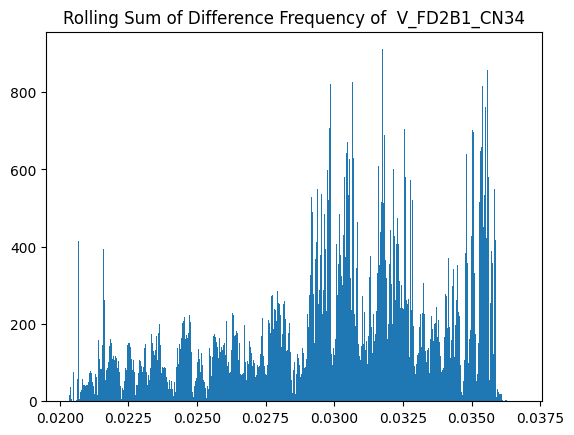

******************************************************************************


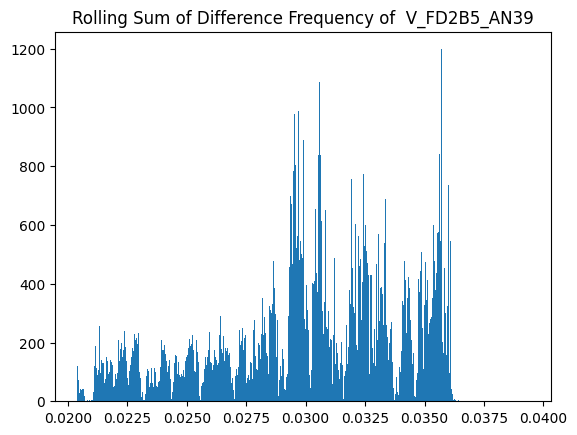

******************************************************************************


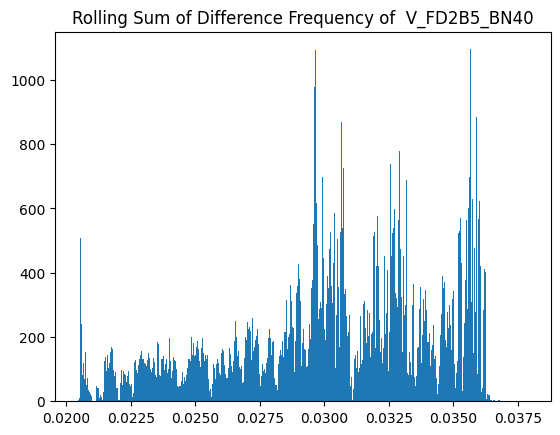

******************************************************************************


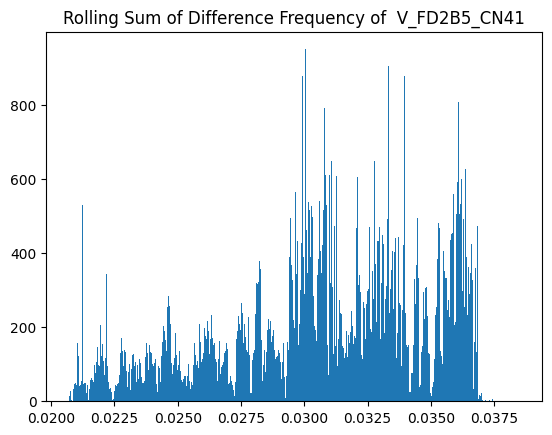

******************************************************************************


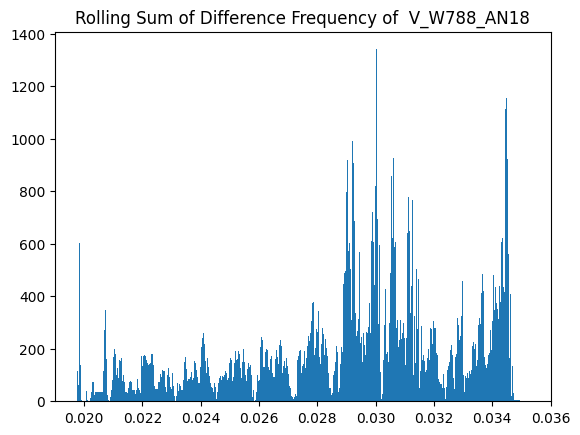

******************************************************************************


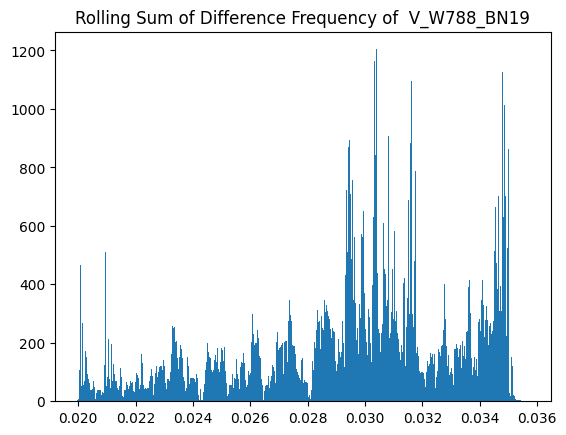

******************************************************************************


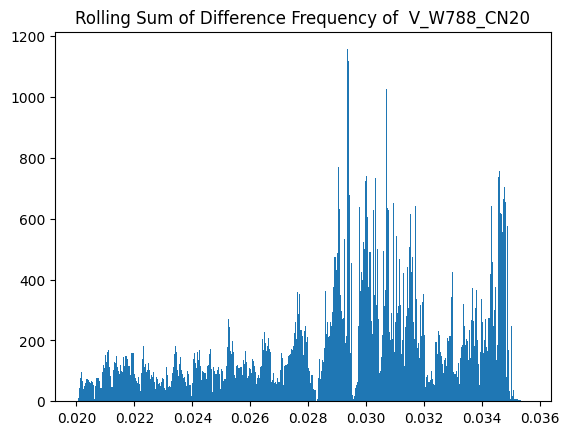

******************************************************************************


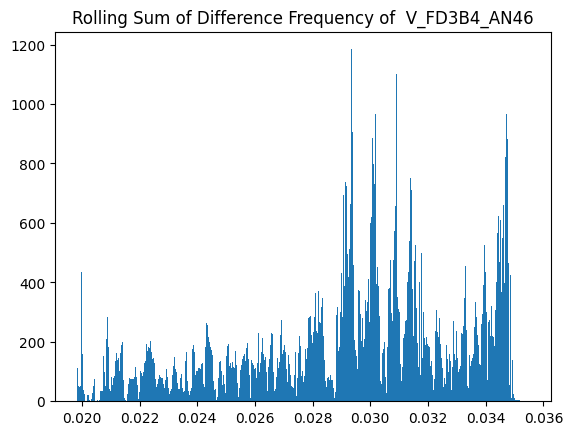

******************************************************************************


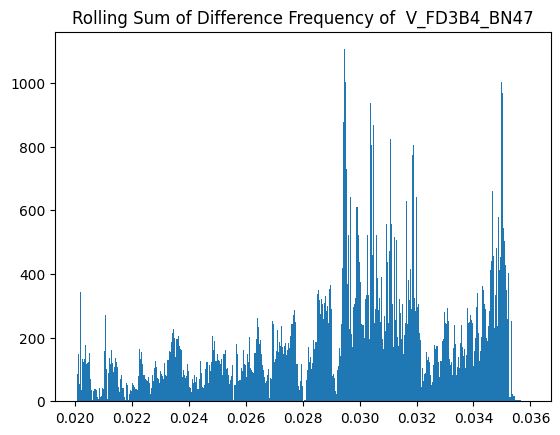

******************************************************************************


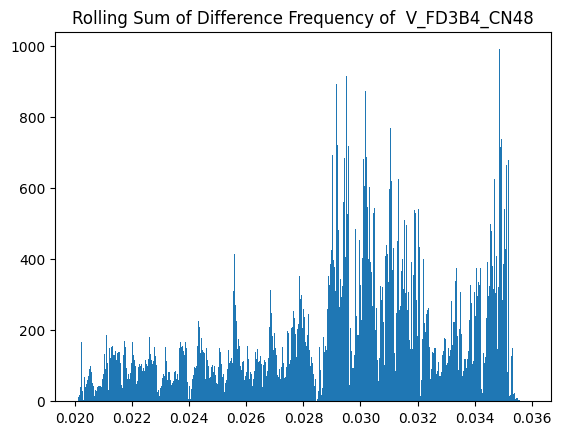

******************************************************************************


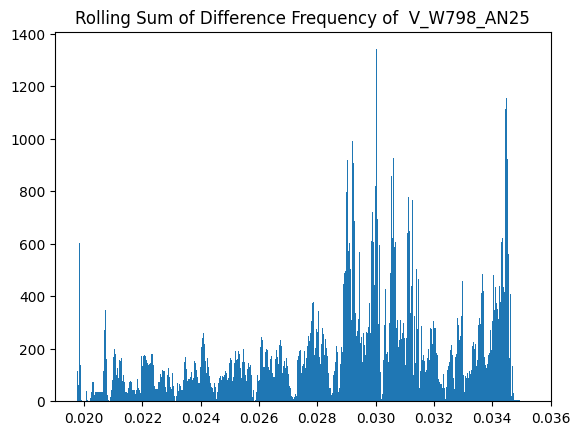

******************************************************************************


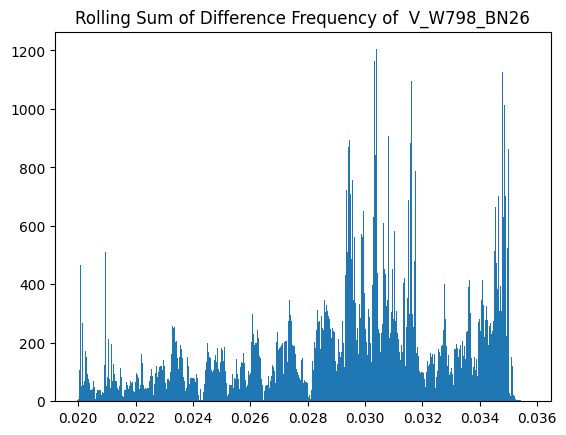

******************************************************************************


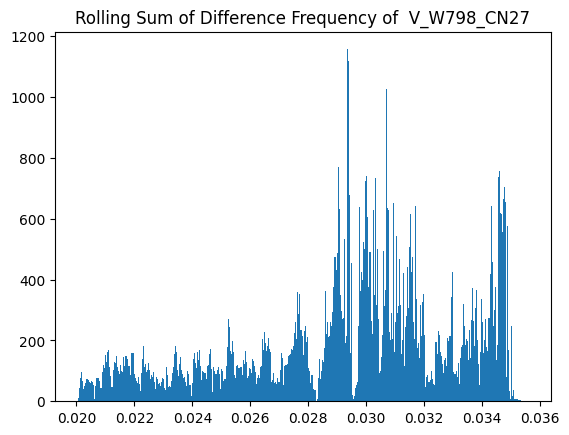

******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
******************************************************************************
****************************************************

In [15]:
window = 350
w = 1

var_fn = var_pair
thresholds_var, var_multi_list = get_threshold_stat_only(data, var_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=1, axis=1, stat_list=None, plot=True, collate_fn="sum")
thresholds_var_99, var_multi_list = get_threshold_stat_only(data, var_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.99, axis=1, stat_list=var_multi_list, collate_fn="sum")
thresholds_var_95, var_multi_list = get_threshold_stat_only(data, var_fn, cols,
              window=window, w=w, adj_list=adj_list, quantile=0.95, axis=1, stat_list=var_multi_list, collate_fn="sum")

In [16]:
len(corr_multi_list)

125

### Testing Data

In [17]:
# y_true = np.zeros(len(data_test))
# for start, end in all_attack_indices:
#     y_true[slice(start, end)] = 1

In [18]:
cov_list = []

for var1_index, var2_indices in adj_list.items():

    var1_index -= 1
    var2_indices = np.array(var2_indices) - 1

    cov_list.append(
        stat_diff(data_test, var1_index, var2_indices, window=window, stat_fn=covariance_pair, fn="sum")
    )

rsum_list_cov = np.array(cov_list)

In [19]:
corr_list = []

for var1_index, var2_indices in adj_list.items():

    var1_index -= 1
    var2_indices = np.array(var2_indices) - 1

    corr_list.append(
        stat_diff(data_test, var1_index, var2_indices, window=window, stat_fn=correlation_pair, fn="sum")
    )

rsum_list_corr = np.array(corr_list)

In [20]:
var_list = []

for var1_index, var2_indices in adj_list.items():

    var1_index -= 1
    var2_indices = np.array(var2_indices) - 1

    var_list.append(
        stat_diff(data_test, var1_index, var2_indices, window=window, stat_fn=var_pair, fn="sum")
    )

rsum_list_var = np.array(var_list)

In [21]:
total_normal = rsum_list_var.shape[1] + 1
for start, end in all_attack_indices:
    total_normal -= (end - start + 1 + 2 * (window + w - 1))
print(total_normal)

55955


In [22]:
thresholds_cov = np.array(thresholds_cov)
thresholds_cov_99 = np.array(thresholds_cov_99)
thresholds_cov_95 = np.array(thresholds_cov_95)

thresholds_corr = np.array(thresholds_corr)
thresholds_corr_99 = np.array(thresholds_corr_99)
thresholds_corr_95 = np.array(thresholds_corr_95)

thresholds_var = np.array(thresholds_var)
thresholds_var_99 = np.array(thresholds_var_99)
thresholds_var_95 = np.array(thresholds_var_95)

# Covariance

In [23]:
quantiles = [1., 0.99, 0.95]
rsum_list = rsum_list_cov

print("Covariance")


for i, threshold in enumerate([thresholds_cov, thresholds_cov_99, thresholds_cov_95]):
    print("Threshold:", quantiles[i])

    for persistency in [1, 3, 5]:
        print("Persistency:", persistency)


        # each row is sensor, each col is timestep
        violations = (rsum_list > threshold.reshape(-1, 1))
        ADD = detection_delay(violations.any(axis=0), sorted(list(all_attack_indices)), window, w, persistency)
        print("DD:", ADD)
        LD = localisation_delay(violations, sorted(list(all_attack_indices)), window, w, persistency)
        print("LD:", LD)
        fpr = FPR(violations.any(axis=0), all_attack_indices, window, w, total_normal, persistency)
        print("FPR", fpr)

        fpr_l = []
        for v in violations:
            fpr_l.append(FPR(v, all_attack_indices, window, w, total_normal, persistency=persistency))
        print("FPR Localisation (Mean):", np.mean(fpr_l))
        print("####################################################")
        print("FPR Localisation:", fpr_l)
        print("****************************************************")
    print("!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!")
    print()

Covariance
Threshold: 1.0
Persistency: 1
DD: [0, 0, 0, 0, None, 0, 0]
LD: [[None, None, None, None], [None], [None], [None, None, None, None, None, None, None], [None, None, None, None], [None], [None, None, None, None, None, None, None]]
FPR 0.20232691139150016
FPR Localisation (Mean): 0.013311934803588662
####################################################
FPR Localisation: [0.0, 0.0, 0.0, 0.00010723093970046824, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.021571290703077527, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 3.5743646566822746e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-0

# Correlation

In [24]:
rsum_list = rsum_list_corr

print("Correlation")

for i, threshold in enumerate([thresholds_corr, thresholds_corr_99, thresholds_corr_95]):
    print("Threshold:", quantiles[i])

    for persistency in [1, 3, 5]:
        print("Persistency:", persistency)


        # each row is sensor, each col is timestep
        violations = (rsum_list > threshold.reshape(-1, 1))
        ADD = detection_delay(violations.any(axis=0), sorted(list(all_attack_indices)), window, w, persistency)
        print("DD:", ADD)
        LD = localisation_delay(violations, sorted(list(all_attack_indices)), window, w, persistency)
        print("LD:", LD)
        fpr = FPR(violations.any(axis=0), all_attack_indices, window, w, total_normal, persistency)
        print("FPR", fpr)

        fpr_l = []
        for v in violations:
            fpr_l.append(FPR(v, all_attack_indices, window, w, total_normal, persistency=persistency))
        print("FPR Localisation (Mean):", np.mean(fpr_l))
        print("####################################################")
        print("FPR Localisation:", fpr_l)
        print("****************************************************")
    print("!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!")
    print()

Correlation
Threshold: 1.0
Persistency: 1
DD: [None, None, None, None, None, None, None]
LD: [[None, None, None, None], [None], [None], [None, None, None, None, None, None, None], [None, None, None, None], [None], [None, None, None, None, None, None, None]]
FPR 0.00014297458626729098
FPR Localisation (Mean): 4.2892375880187295e-06
####################################################
FPR Localisation: [0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 

# Variance

In [25]:
quantiles = [1., 0.99, 0.95]
rsum_list = rsum_list_var

print("Variance")


for i, threshold in enumerate([thresholds_var, thresholds_var_99, thresholds_var_95]):
    print("Threshold:", quantiles[i])

    for persistency in [1, 3, 5]:
        print("Persistency:", persistency)


        # each row is sensor, each col is timestep
        violations = (rsum_list > threshold.reshape(-1, 1))
        ADD = detection_delay(violations.any(axis=0), sorted(list(all_attack_indices)), window, w, persistency)
        print("DD:", ADD)
        LD = localisation_delay(violations, sorted(list(all_attack_indices)), window, w, persistency)
        print("LD:", LD)
        fpr = FPR(violations.any(axis=0), all_attack_indices, window, w, total_normal, persistency)
        print("FPR", fpr)

        fpr_l = []
        for v in violations:
            fpr_l.append(FPR(v, all_attack_indices, window, w, total_normal, persistency=persistency))
        print("FPR Localisation (Mean):", np.mean(fpr_l))
        print("####################################################")
        print("FPR Localisation:", fpr_l)
        print("****************************************************")
    print("!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!")
    print()

Variance
Threshold: 1.0
Persistency: 1
DD: [None, 3359, 4319, 0, None, None, 0]
LD: [[None, None, None, None], [None], [None], [None, None, None, None, None, None, None], [None, None, None, None], [None], [None, None, None, None, None, None, None]]
FPR 0.07525824784644529
FPR Localisation (Mean): 0.005687386067126569
####################################################
FPR Localisation: [0.0, 0.0, 1.7871823283411373e-05, 0.00012510276298387962, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.01747864317117632, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0,

# Combined (Correlation and Variance Ratio)

In [26]:
print("Combined")

t_corr = [thresholds_corr, thresholds_corr_99, thresholds_corr_95]
t_cov = [thresholds_cov, thresholds_cov_99, thresholds_cov_95]
t_var = [thresholds_var, thresholds_var_99, thresholds_var_95]

for i in range(len(t_cov)):
    print("Threshold:", quantiles[i])

    for persistency in [1, 3, 5, 10]:
        print("Persistency:", persistency)


        # each row is sensor, each col is timestep
        violations = np.logical_or((rsum_list_corr > t_corr[i].reshape(-1, 1)), (rsum_list_var > t_var[i].reshape(-1, 1)))
#         violations = np.logical_or((rsum_list_corr > t_corr[i].reshape(-1, 1)), (rsum_list_cov > t_cov[i].reshape(-1, 1)))
        ADD = detection_delay(violations.any(axis=0), sorted(list(all_attack_indices)), window, w, persistency)
        print("DD:", ADD)
        if None in ADD:
            dd_mean = None
        else:
            dd_mean = np.mean(ADD)
        print("Average DD:", dd_mean)
        LD = localisation_delay(violations, sorted(list(all_attack_indices)), window, w, persistency)
        print("LD:", LD)
        lds = [ld for sublist in LD for ld in sublist]
        if None in lds:
            ld_mean = None
        else:
            ld_mean = np.mean(lds)
        print("Average LD:", ld_mean)
        fpr = FPR(violations.any(axis=0), all_attack_indices, window, w, total_normal, persistency)
        print("FPR", fpr)

        fpr_l = []
        for v in violations:
            fpr_l.append(FPR(v, all_attack_indices, window, w, total_normal, persistency=persistency))
        print("FPR Localisation (Mean):", np.mean(fpr_l))
        print("####################################################")
        print("FPR Localisation:", fpr_l)
        print("****************************************************")
    print("!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!")
    print()

Combined
Threshold: 1.0
Persistency: 1
DD: [None, 3359, 4319, 0, None, None, 0]
Average DD: None
LD: [[None, None, None, None], [None], [None], [None, None, None, None, None, None, None], [None, None, None, None], [None], [None, None, None, None, None, None, None]]
Average LD: None
FPR 0.07536547878614576
FPR Localisation (Mean): 0.005691389355542053
####################################################
FPR Localisation: [0.0, 0.0, 3.5743646566822746e-05, 0.00012510276298387962, 0.0, 1.7871823283411373e-05, 3.5743646566822746e-05, 0.01747864317117632, 0.0, 1.7871823283411373e-05, 3.5743646566822746e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 3.5743646566822746e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 3.5743646566822746e-05, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.7871823283411373e-05, 0.0, 0.0, 1.7871823283411373e-05, 0.0, 1.7871823283411373e-05, 1.7871823283411373e-05, 1.787182328341

In [27]:
LD = [[4, 5, 12], [11], [4], [11, 9, 16, 6, 4, 19], [9, 4, 23], [33, 20], [32, 27, 5]]
np.mean([ld for sublist in LD for ld in sublist])

13.368421052631579

In [28]:
all_sensors =[]
for i in attacks.values():
    for a in i:
        all_sensors += a
all_sensors

[15,
 101,
 43,
 16,
 102,
 44,
 17,
 103,
 45,
 18,
 104,
 46,
 19,
 74,
 100,
 20,
 75,
 90,
 21,
 65,
 91,
 29,
 8,
 36,
 30,
 9,
 37,
 31,
 10,
 38,
 32,
 11,
 39,
 38,
 10,
 31,
 52,
 107,
 78,
 67,
 61,
 112,
 72,
 57,
 90,
 62,
 113,
 73,
 58,
 91,
 63,
 114,
 74,
 59,
 92,
 64,
 115,
 75,
 60,
 93,
 76,
 119,
 57,
 50,
 97,
 77,
 120,
 58,
 51,
 98,
 78,
 121,
 59,
 52,
 99,
 79,
 122,
 60,
 53,
 100,
 80,
 76,
 79,
 74,
 66,
 81,
 77,
 72,
 75,
 67,
 82,
 78,
 73,
 65,
 68,
 88,
 107,
 77,
 72]

In [29]:
attack_i = {}
for key, items in attacks_in.items():
  attack_i[key] = []
  for i in items:
    attack_i[key] += i
attack_i

{9360: [15,
  101,
  43,
  16,
  102,
  44,
  17,
  103,
  45,
  18,
  104,
  46,
  19,
  74,
  100,
  20,
  75,
  90,
  21,
  65,
  91],
 17040: [29, 8, 36, 30, 9, 37, 31, 10, 38, 32, 11, 39],
 28560: [38, 10, 31],
 39600: [52, 107, 78, 67],
 54960: [61,
  112,
  72,
  57,
  90,
  62,
  113,
  73,
  58,
  91,
  63,
  114,
  74,
  59,
  92,
  64,
  115,
  75,
  60,
  93],
 68880: [76,
  119,
  57,
  50,
  97,
  77,
  120,
  58,
  51,
  98,
  78,
  121,
  59,
  52,
  99,
  79,
  122,
  60,
  53,
  100,
  80,
  76,
  79,
  74,
  66,
  81,
  77,
  72,
  75,
  67,
  82,
  78,
  73,
  65,
  68],
 78000: [88, 107, 77, 72]}

In [31]:
things = list(adj_list.keys())
things.sort()

***********************************************************************************************
Sensor: 1  C_W738_W737_2_W737_A


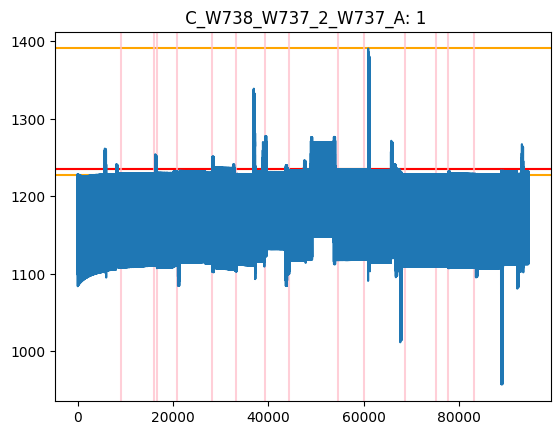

***********************************************************************************************
Sensor: 2  C_W738_W737_2_W737_B


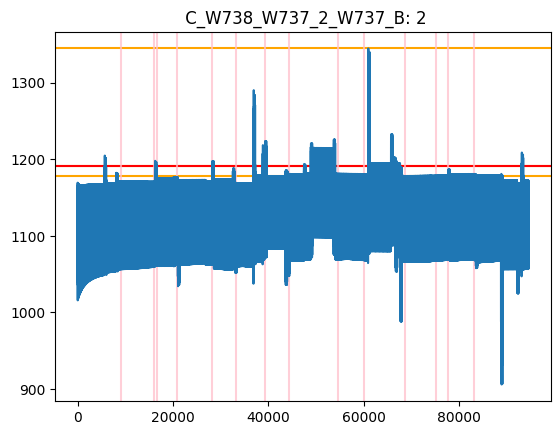

***********************************************************************************************
Sensor: 3  C_W738_W737_2_W737_C


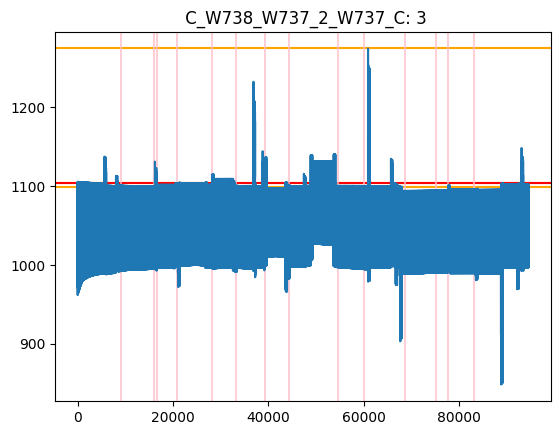

***********************************************************************************************
Sensor: 4  C_W738_W737_2_W737_N


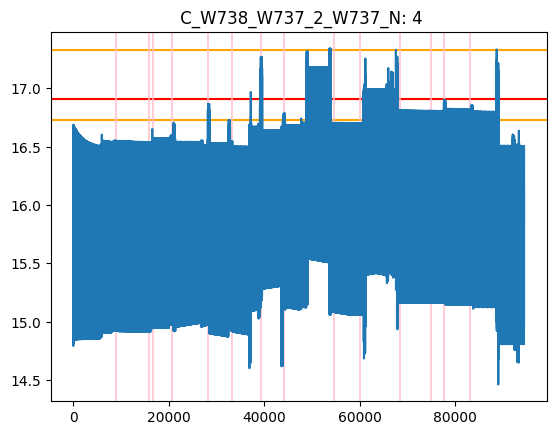

***********************************************************************************************
Sensor: 5  V_W738_AN


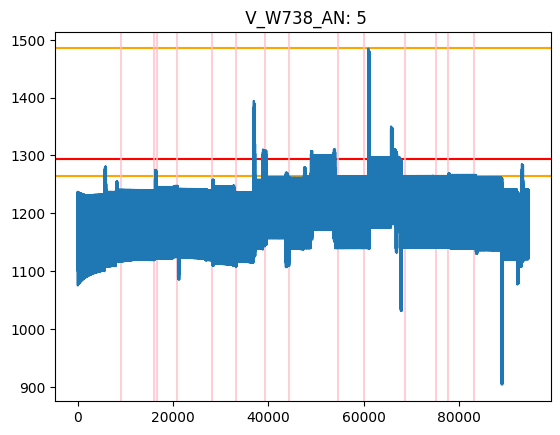

***********************************************************************************************
Sensor: 6  V_W738_BN


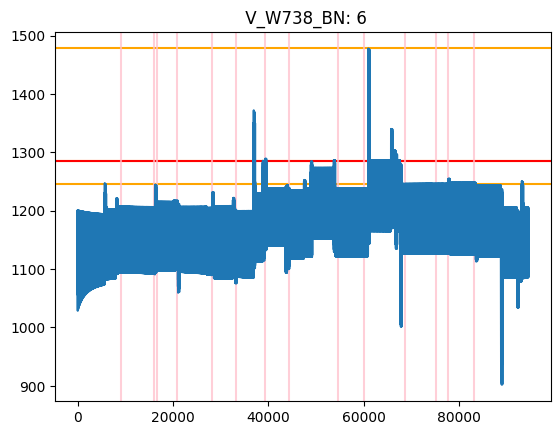

***********************************************************************************************
Sensor: 7  V_W738_CN


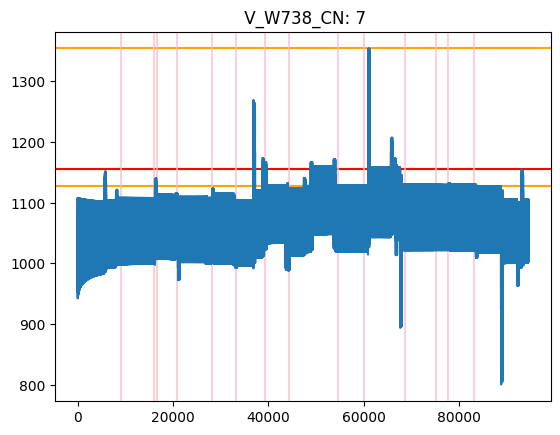

***********************************************************************************************
Sensor: 8  C_W747_W748_2_W747_A
8
DD = None


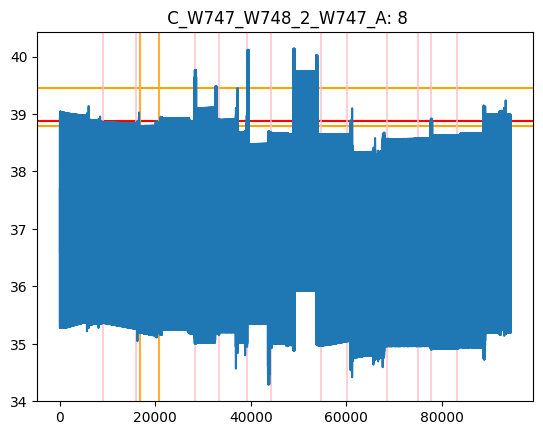

***********************************************************************************************
Sensor: 9  C_W747_W748_2_W747_B
9
DD = None


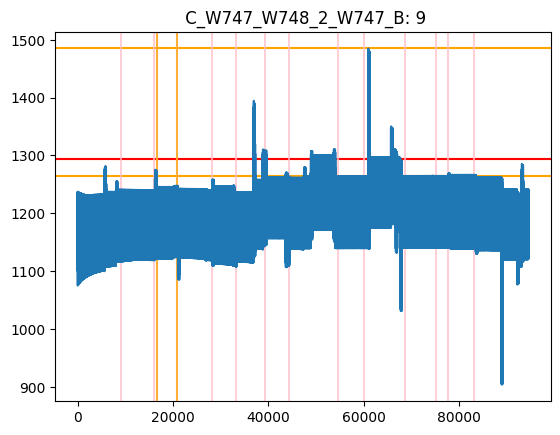

***********************************************************************************************
Sensor: 10  C_W747_W748_2_W747_C
10
DD = None
10
DD = None


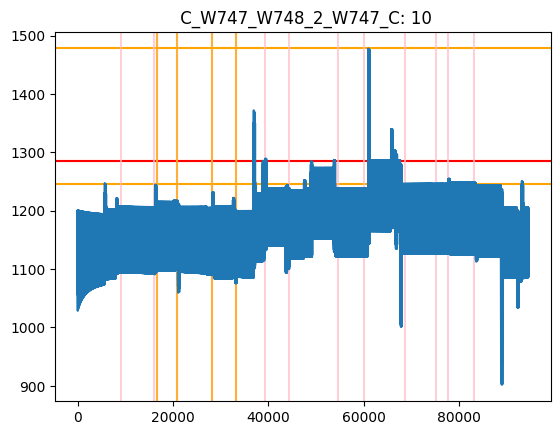

***********************************************************************************************
Sensor: 11  C_W747_W748_2_W747_N
11
DD = None


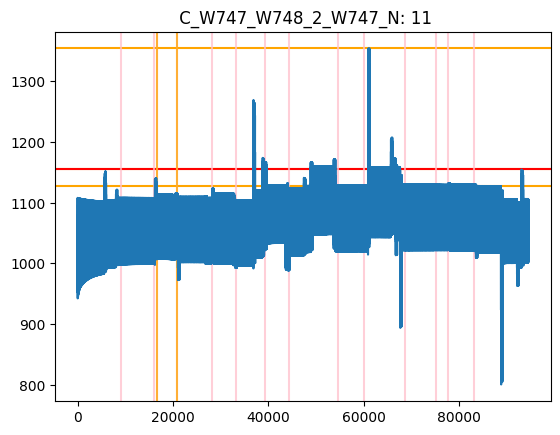

***********************************************************************************************
Sensor: 12  V_W748_AN


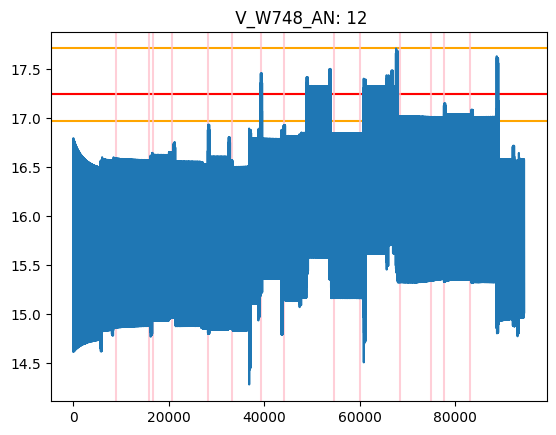

***********************************************************************************************
Sensor: 13  V_W748_BN


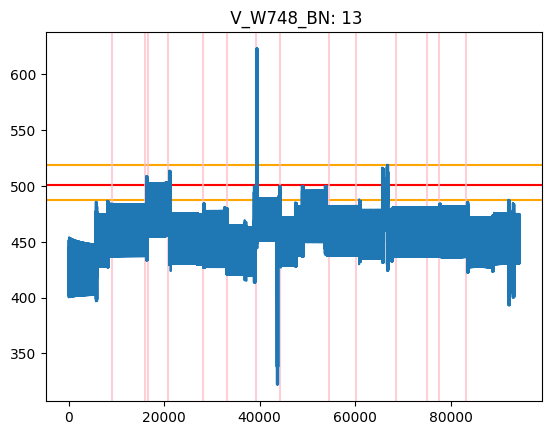

***********************************************************************************************
Sensor: 14  V_W748_CN


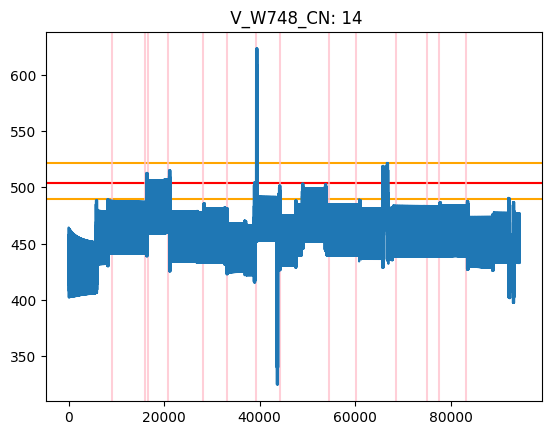

***********************************************************************************************
Sensor: 15  C_W787_W788_2_W787_A
DD = None
DD = None


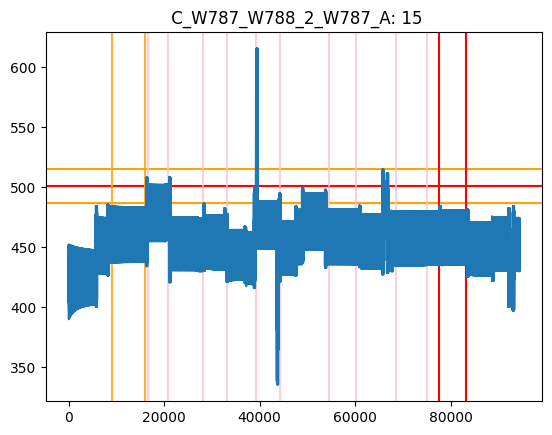

***********************************************************************************************
Sensor: 16  C_W787_W788_2_W787_B
DD = None
DD = None


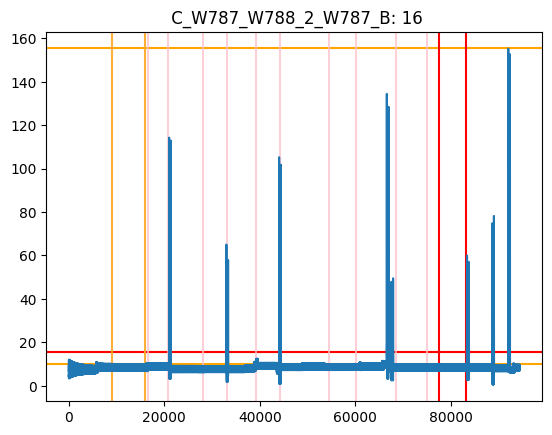

***********************************************************************************************
Sensor: 17  C_W787_W788_2_W787_C
DD = None
DD = None


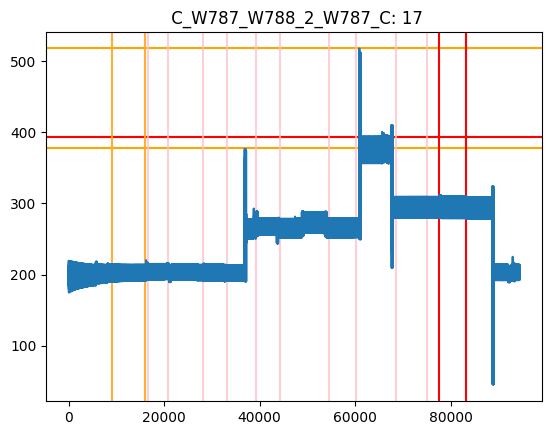

***********************************************************************************************
Sensor: 18  C_W787_W788_2_W787_N
DD = None
DD = None


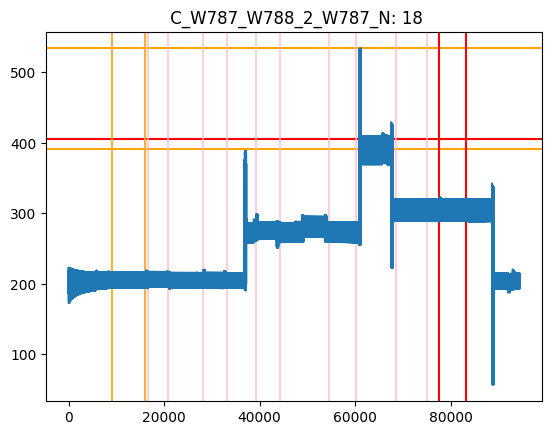

***********************************************************************************************
Sensor: 19  V_W788_AN
DD = None
DD = None


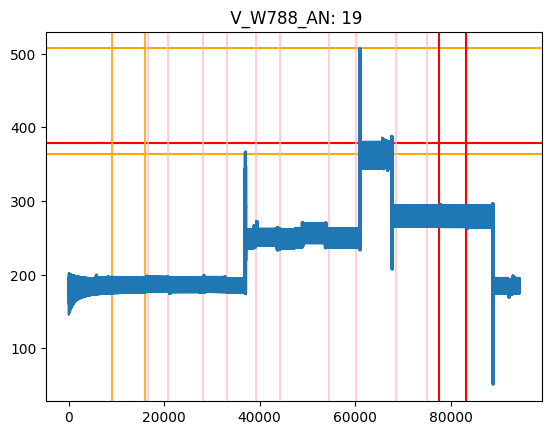

***********************************************************************************************
Sensor: 20  V_W788_BN
DD = None
DD = None


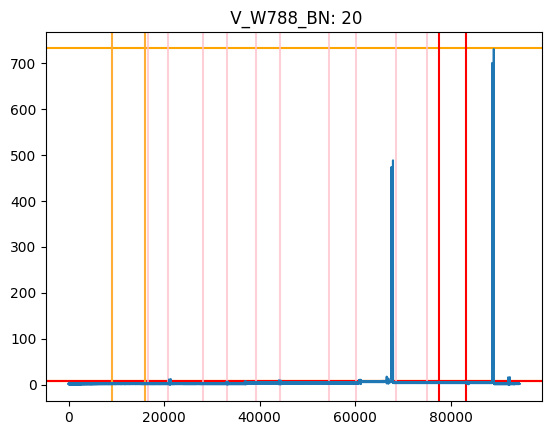

***********************************************************************************************
Sensor: 21  V_W788_CN
DD = None
DD = None


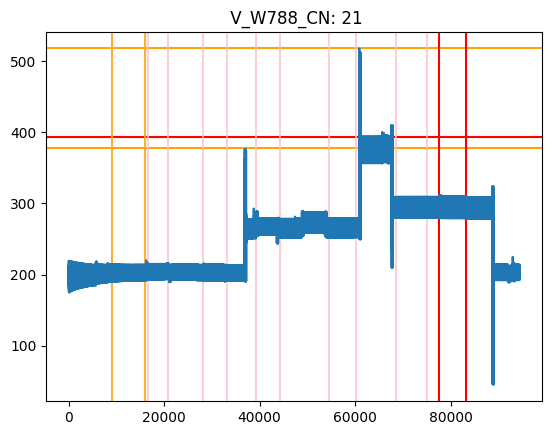

***********************************************************************************************
Sensor: 22  C_W797_W798_2_W797_A


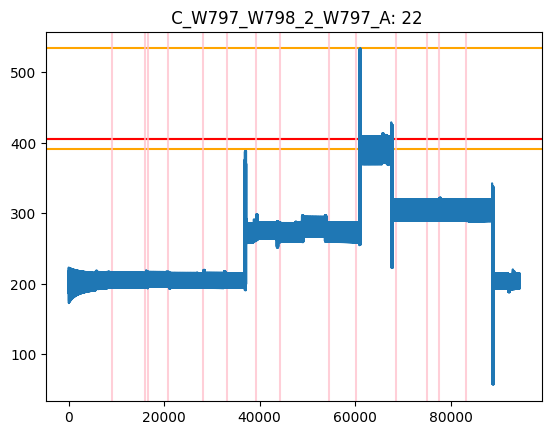

***********************************************************************************************
Sensor: 23  C_W797_W798_2_W797_B


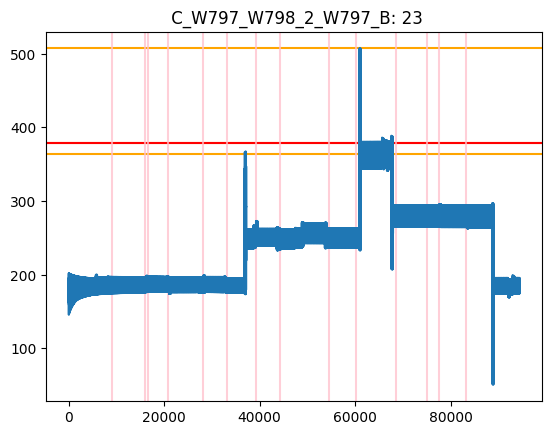

***********************************************************************************************
Sensor: 24  C_W797_W798_2_W797_C


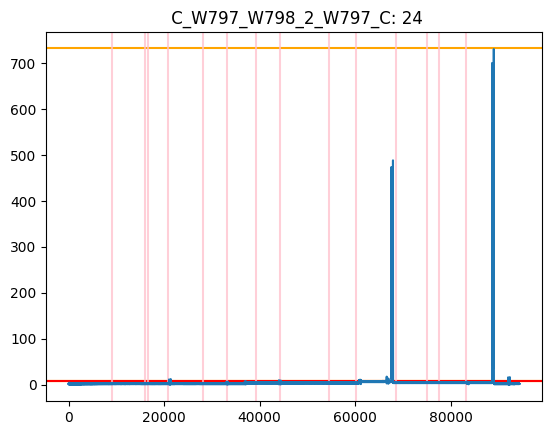

***********************************************************************************************
Sensor: 25  C_W797_W798_2_W797_N


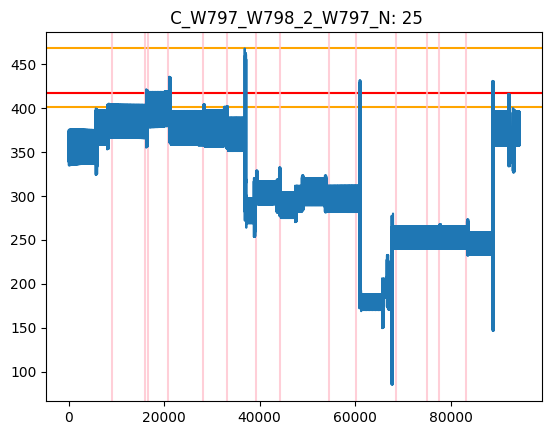

***********************************************************************************************
Sensor: 26  V_W798_AN


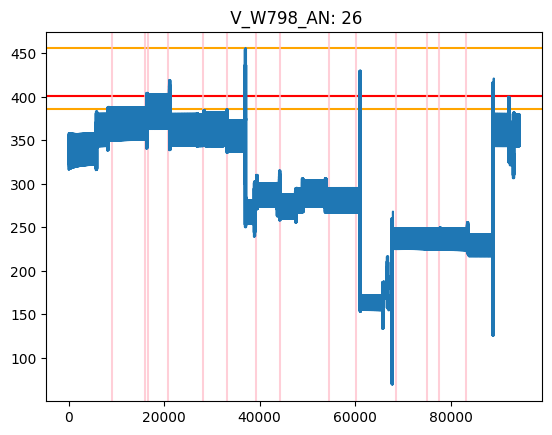

***********************************************************************************************
Sensor: 27  V_W798_BN


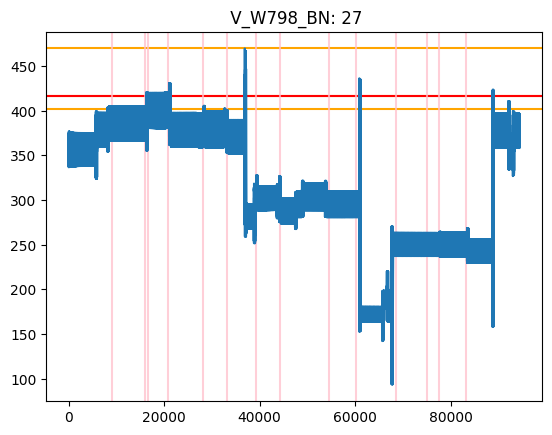

***********************************************************************************************
Sensor: 28  V_W798_CN


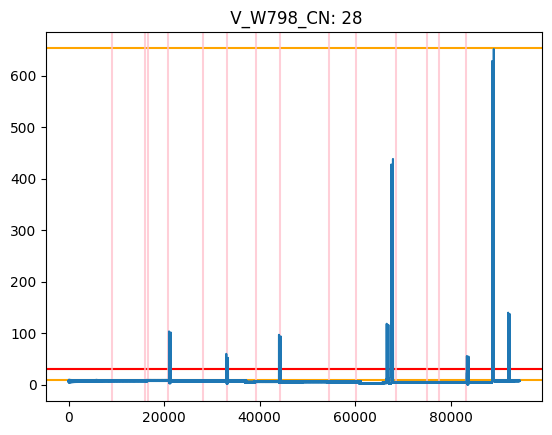

***********************************************************************************************
Sensor: 29  C_FD2B2_FD2B1_1_FD2B1_A
DD = None
DD = None


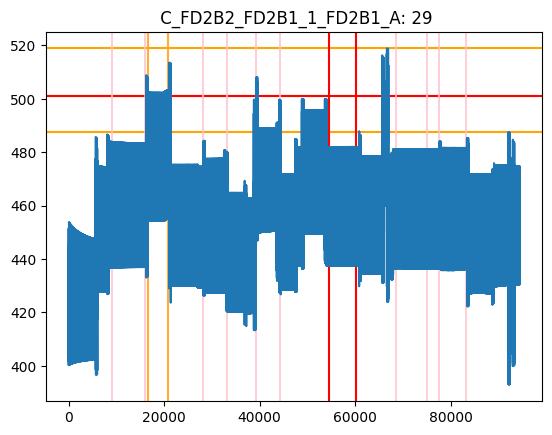

***********************************************************************************************
Sensor: 30  C_FD2B2_FD2B1_1_FD2B1_B
DD = None
DD = None


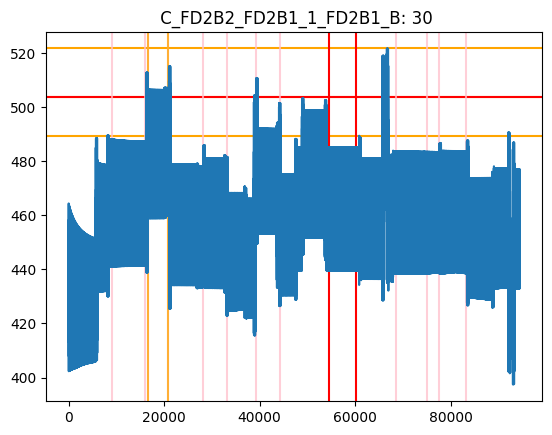

***********************************************************************************************
Sensor: 31  C_FD2B2_FD2B1_1_FD2B1_C
DD = None
DD = 4
DD = None


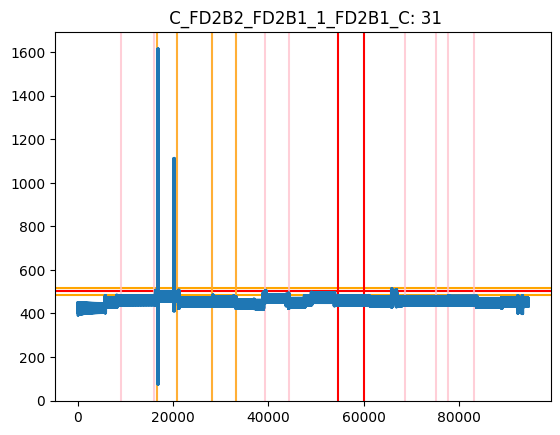

***********************************************************************************************
Sensor: 32  C_FD2B2_FD2B1_1_FD2B1_N
DD = None
DD = None


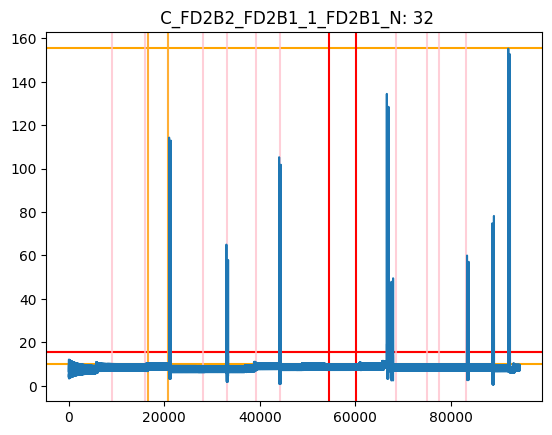

***********************************************************************************************
Sensor: 33  V_FD2B1_AN


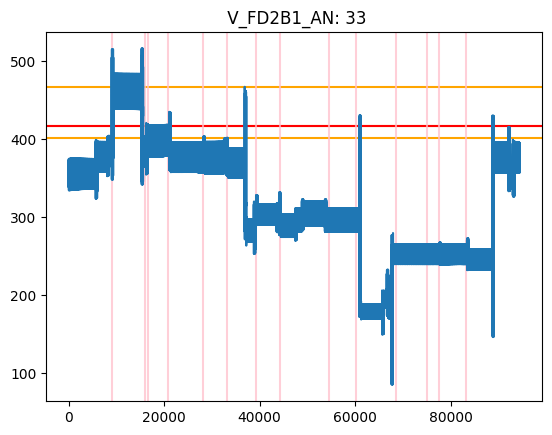

***********************************************************************************************
Sensor: 34  V_FD2B1_BN


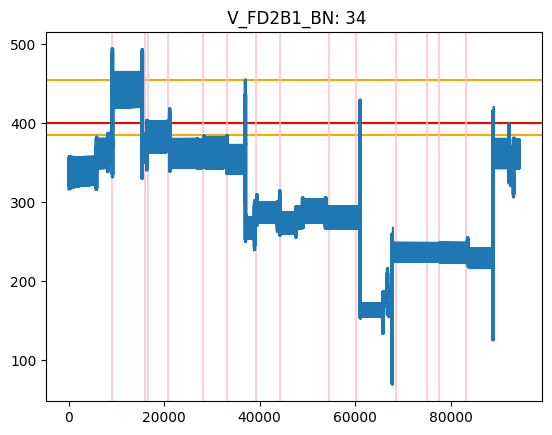

***********************************************************************************************
Sensor: 35  V_FD2B1_CN


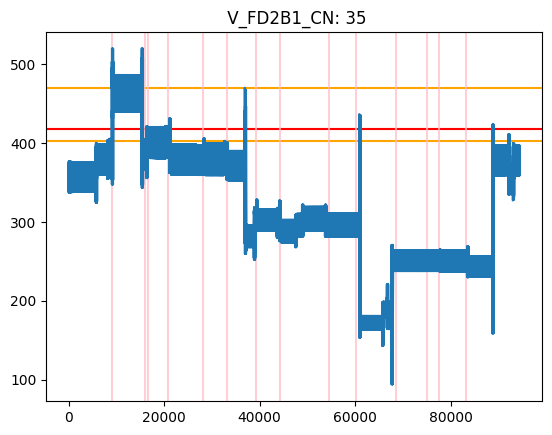

***********************************************************************************************
Sensor: 36  C_FD2B5_FD2B6_1_FD2B5_A
36
DD = None


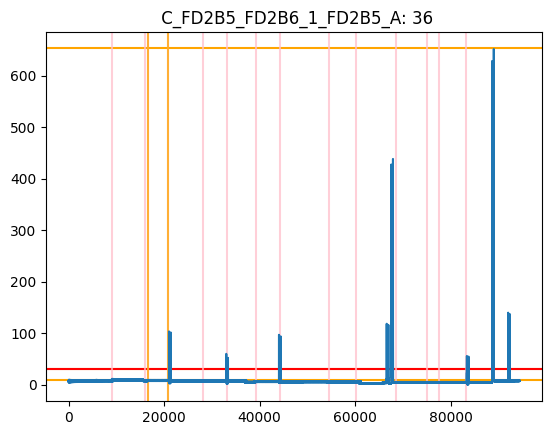

***********************************************************************************************
Sensor: 37  C_FD2B5_FD2B6_1_FD2B5_B
37
DD = None


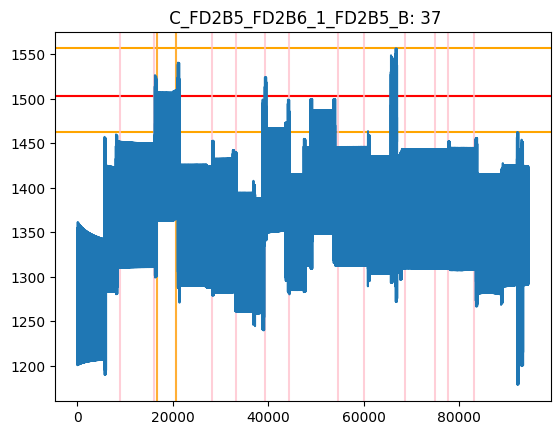

***********************************************************************************************
Sensor: 38  C_FD2B5_FD2B6_1_FD2B5_C
DD = None
DD = None
DD = None


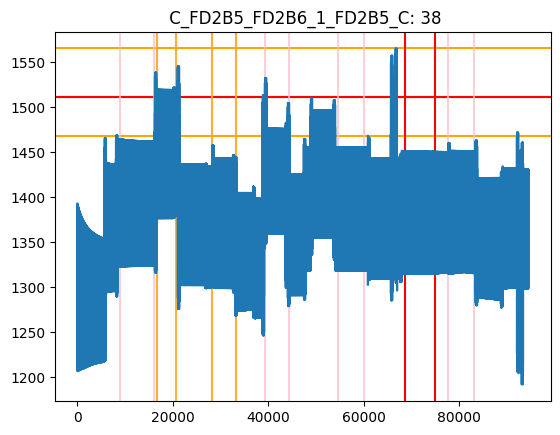

***********************************************************************************************
Sensor: 39  C_FD2B5_FD2B6_1_FD2B5_N
39
DD = None


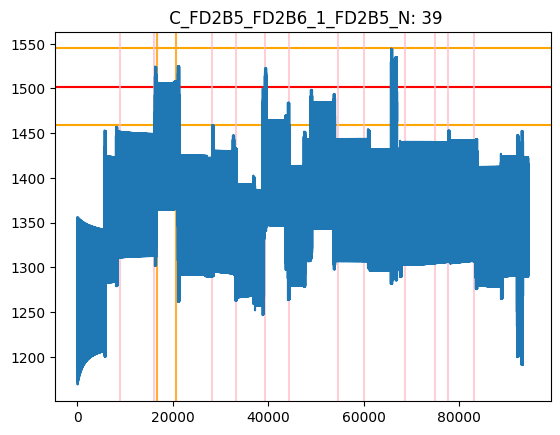

***********************************************************************************************
Sensor: 40  V_FD2B5_AN


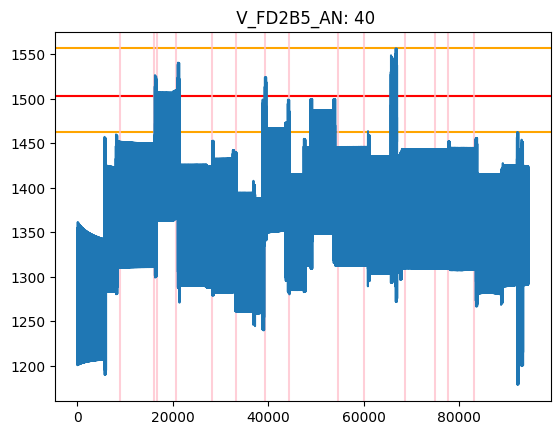

***********************************************************************************************
Sensor: 41  V_FD2B5_BN


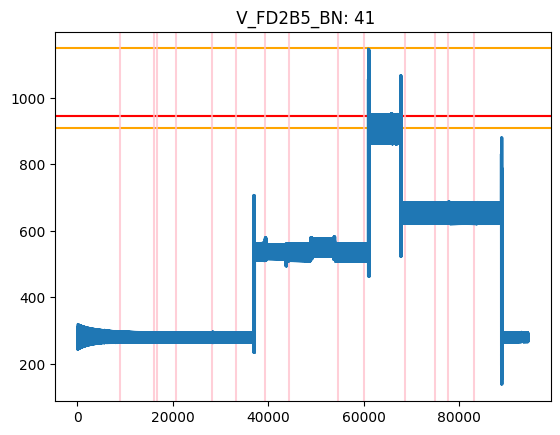

***********************************************************************************************
Sensor: 42  V_FD2B5_CN


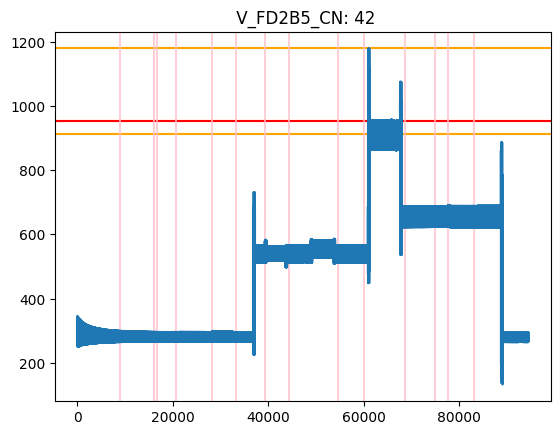

***********************************************************************************************
Sensor: 43  C_FD3B4_FD3B5_1_FD3B4_A
43
DD = None


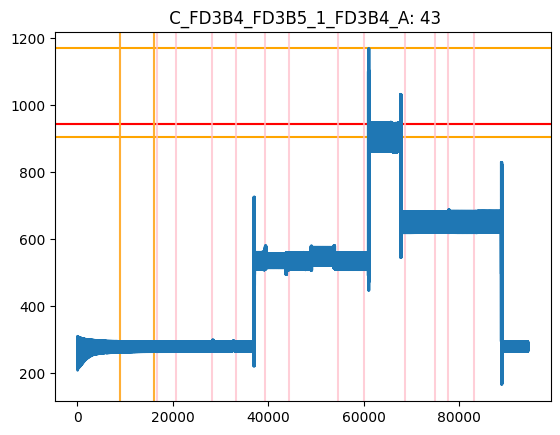

***********************************************************************************************
Sensor: 44  C_FD3B4_FD3B5_1_FD3B4_B
44
DD = None


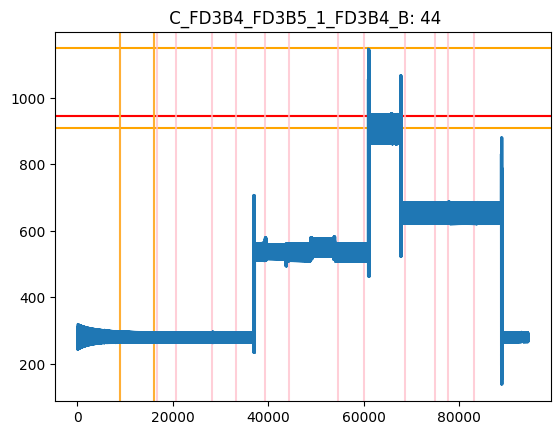

***********************************************************************************************
Sensor: 45  C_FD3B4_FD3B5_1_FD3B4_C
45
DD = None


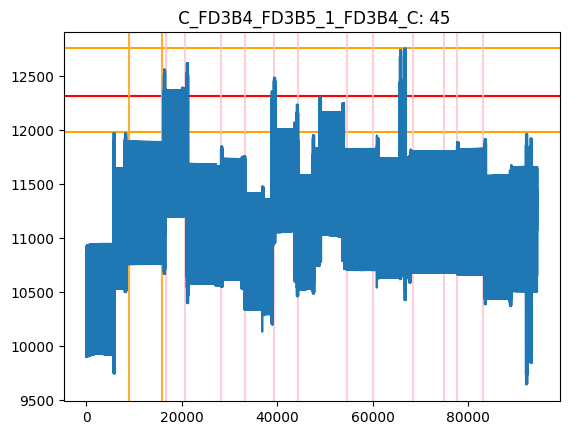

***********************************************************************************************
Sensor: 46  C_FD3B4_FD3B5_1_FD3B4_N
46
DD = None


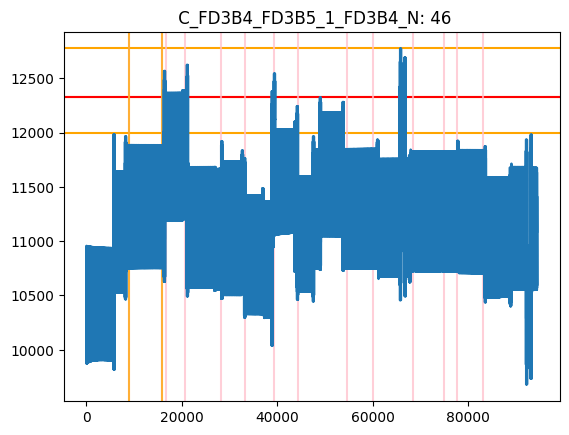

***********************************************************************************************
Sensor: 47  V_FD3B4_AN


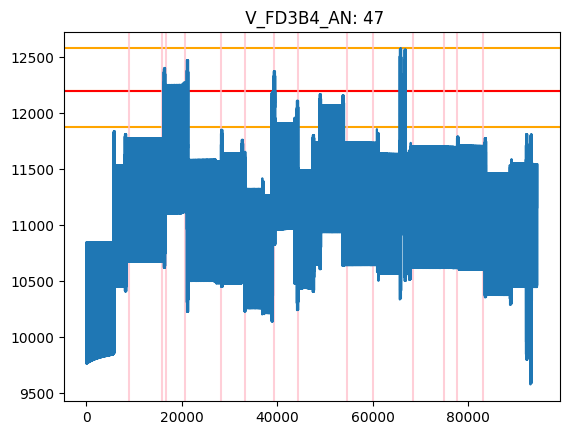

***********************************************************************************************
Sensor: 48  V_FD3B4_BN


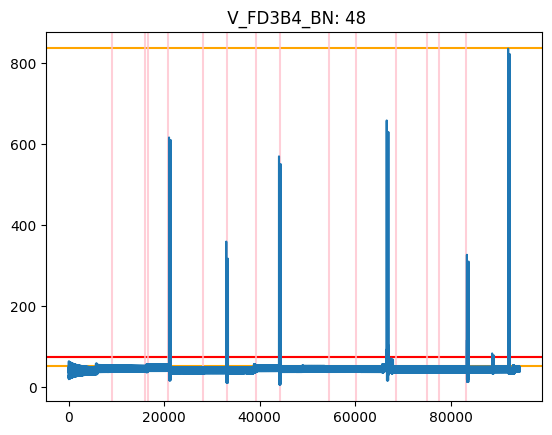

***********************************************************************************************
Sensor: 49  V_FD3B4_CN


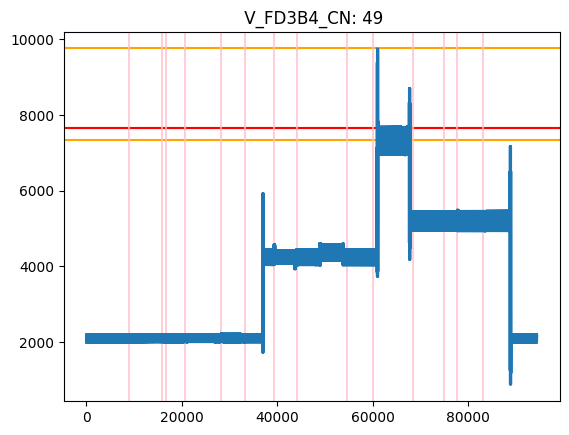

***********************************************************************************************
Sensor: 50  C_W919_W910_1_W919_A
50
DD = None


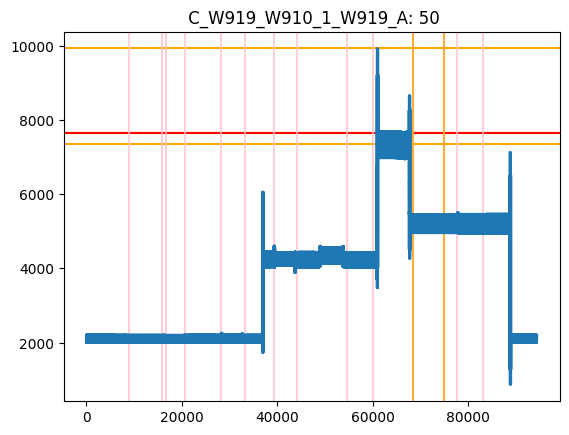

***********************************************************************************************
Sensor: 51  C_W919_W910_1_W919_B
51
DD = None


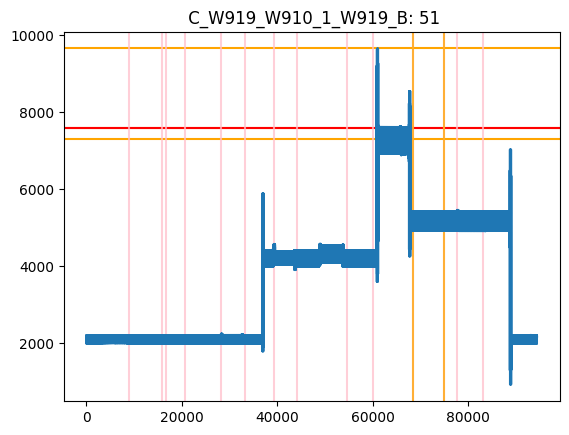

***********************************************************************************************
Sensor: 52  C_W919_W910_1_W919_C
DD = None
DD = None
DD = None


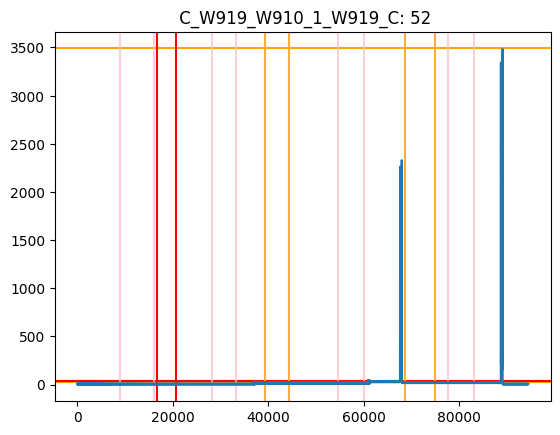

***********************************************************************************************
Sensor: 53  C_W919_W910_1_W919_N
53
DD = None


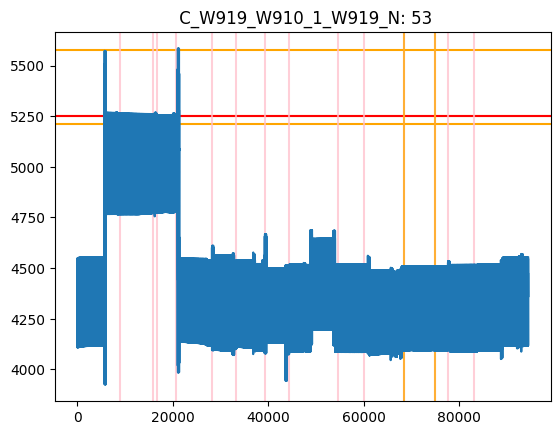

***********************************************************************************************
Sensor: 54  V_W-115KV2_AN


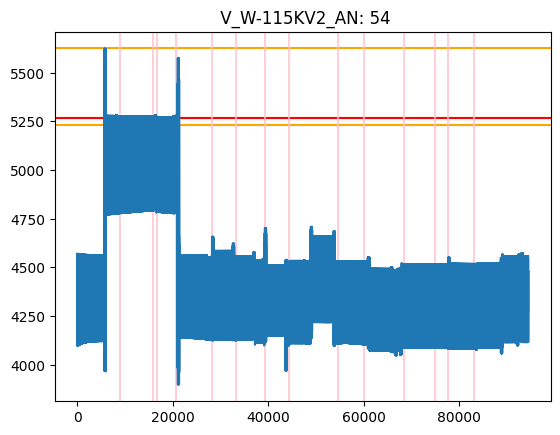

***********************************************************************************************
Sensor: 55  V_W-115KV2_BN


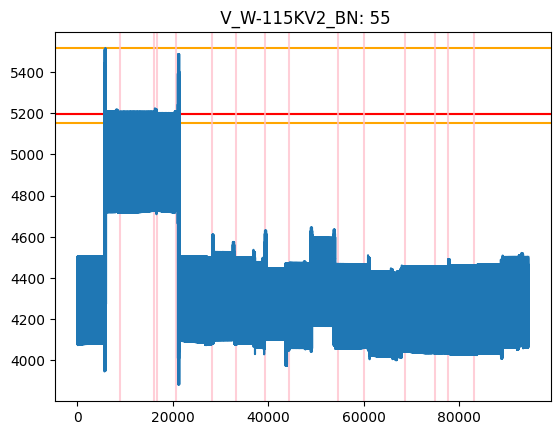

***********************************************************************************************
Sensor: 56  V_W-115KV2_CN


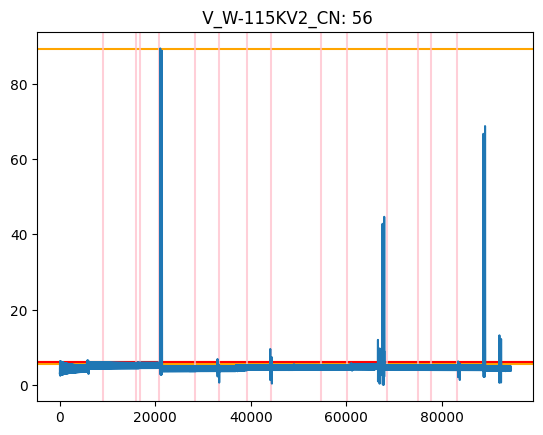

***********************************************************************************************
Sensor: 57  C_W957_W950_1_W950_A
57
DD = None
57
DD = None


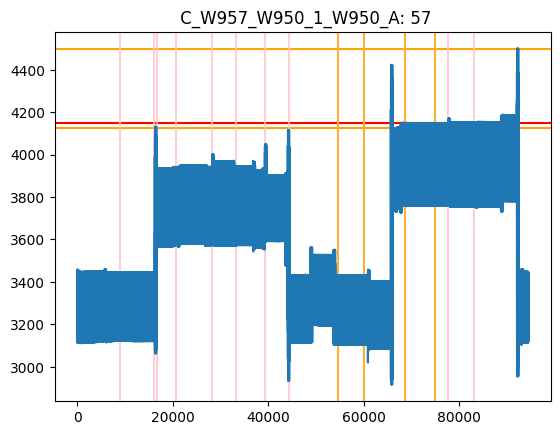

***********************************************************************************************
Sensor: 58  C_W957_W950_1_W950_B
58
DD = None
58
DD = None


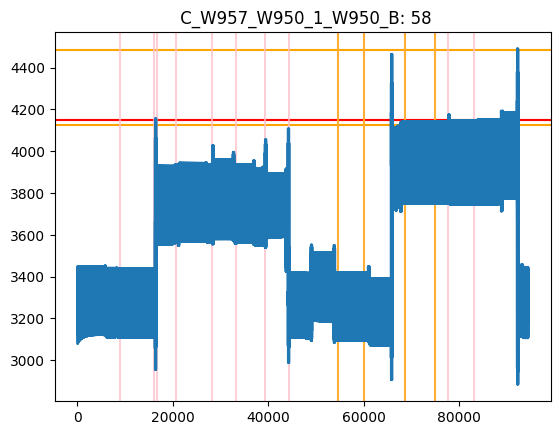

***********************************************************************************************
Sensor: 59  C_W957_W950_1_W950_C
59
DD = None
59
DD = None


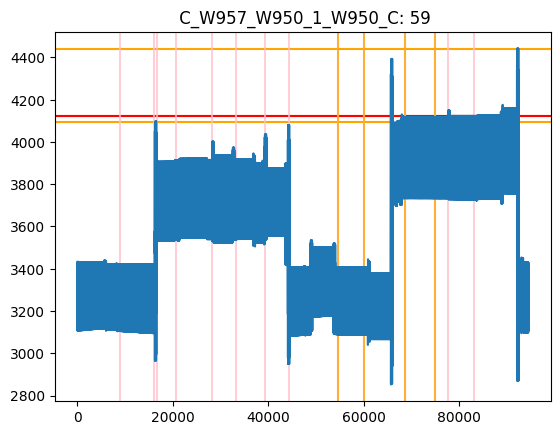

***********************************************************************************************
Sensor: 60  C_W957_W950_1_W950_N
60
DD = None
60
DD = None


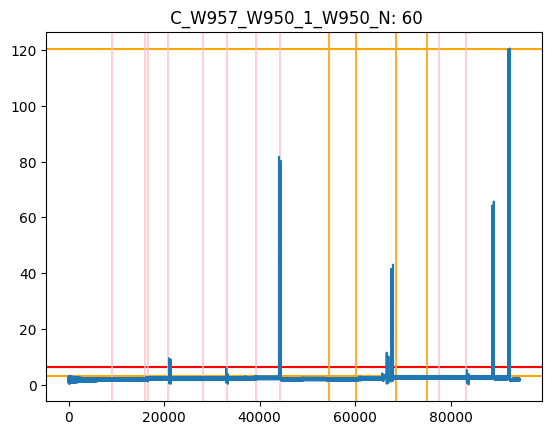

***********************************************************************************************
Sensor: 61  C_W957_W950_1_W957_A
DD = None
DD = None


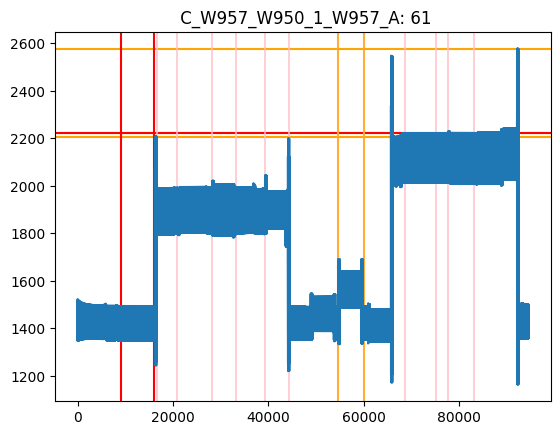

***********************************************************************************************
Sensor: 62  C_W957_W950_1_W957_B
DD = None
DD = None


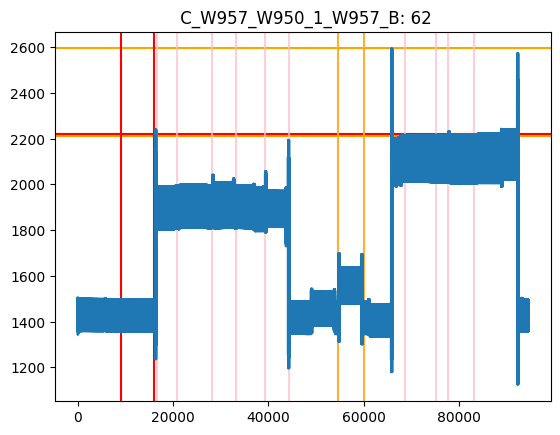

***********************************************************************************************
Sensor: 63  C_W957_W950_1_W957_C
DD = None
DD = None


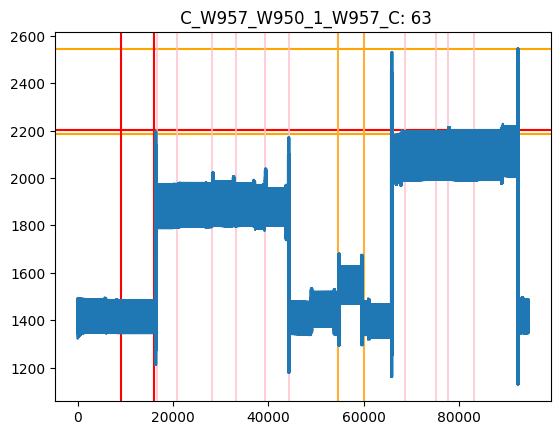

***********************************************************************************************
Sensor: 64  C_W957_W950_1_W957_N
DD = None
DD = None


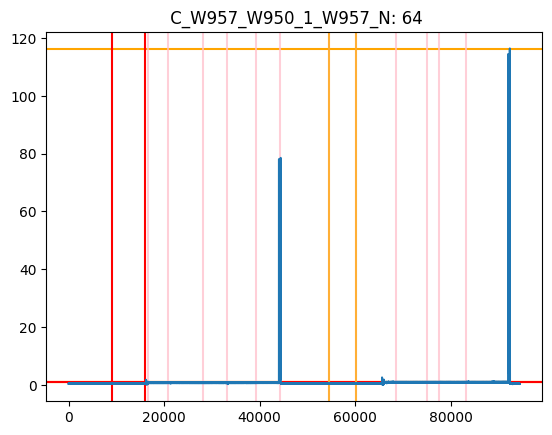

***********************************************************************************************
Sensor: 65  C_W927_W929_1_W929_A
65
DD = None
65
DD = None


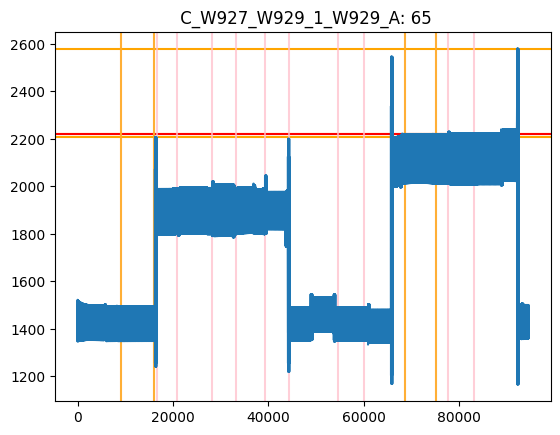

***********************************************************************************************
Sensor: 66  C_W927_W929_1_W929_B
66
DD = None


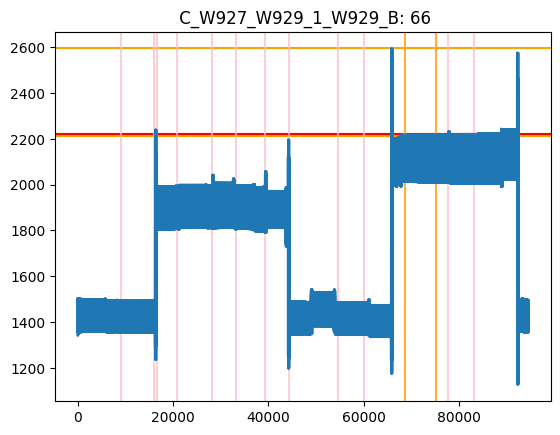

***********************************************************************************************
Sensor: 67  C_W927_W929_1_W929_C
67
DD = None
67
DD = 4


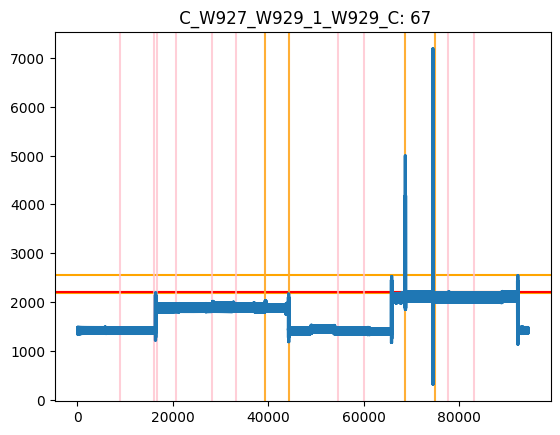

***********************************************************************************************
Sensor: 68  C_W927_W929_1_W929_N
68
DD = None


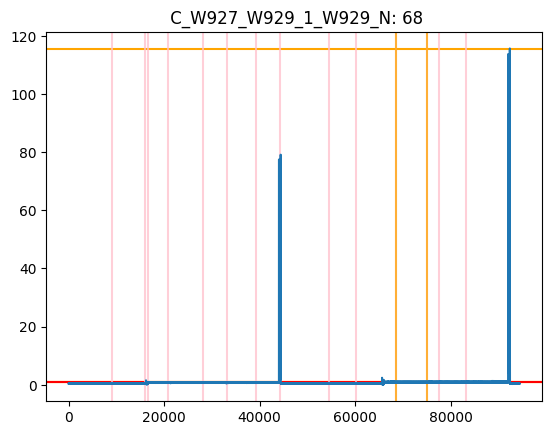

***********************************************************************************************
Sensor: 69  V_W-115KV1_AN


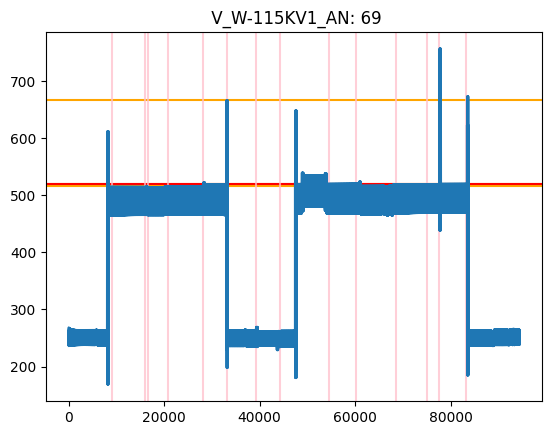

***********************************************************************************************
Sensor: 70  V_W-115KV1_BN


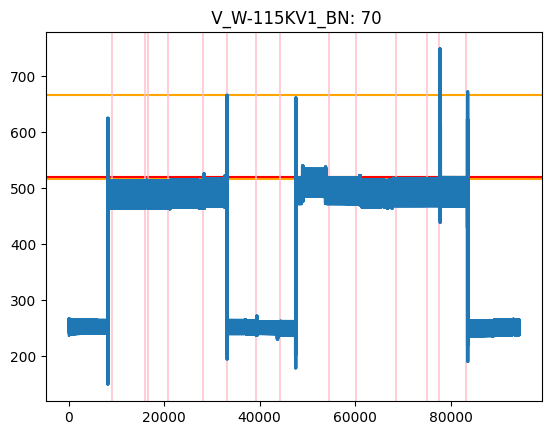

***********************************************************************************************
Sensor: 71  V_W-115KV1_CN


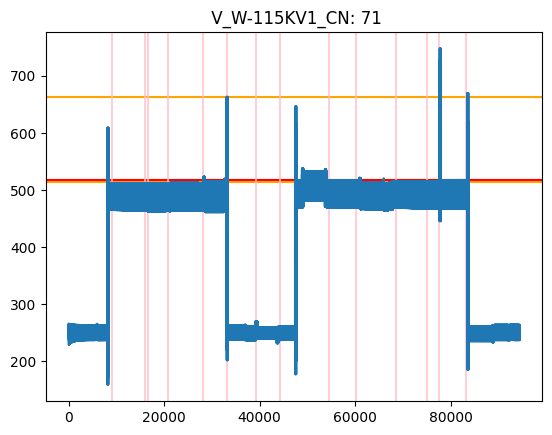

***********************************************************************************************
Sensor: 72  C_W927_W929_1_W927_A
72
DD = None
72
DD = None
72
DD = None


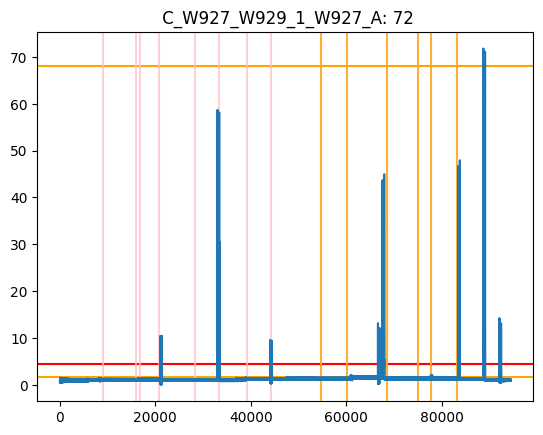

***********************************************************************************************
Sensor: 73  C_W927_W929_1_W927_B
73
DD = None
73
DD = None


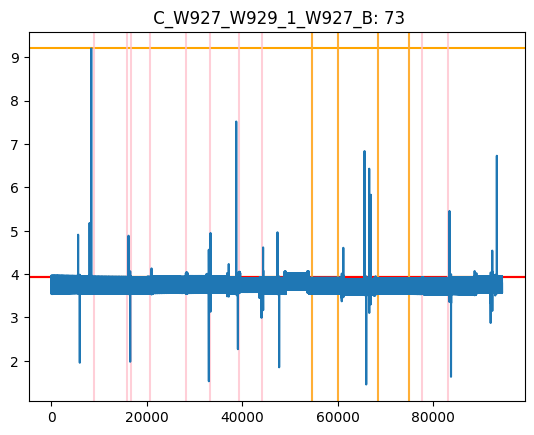

***********************************************************************************************
Sensor: 74  C_W927_W929_1_W927_C
74
DD = None
74
DD = None
74
DD = None


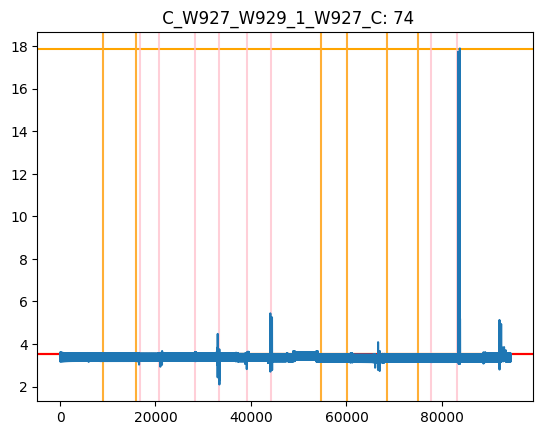

***********************************************************************************************
Sensor: 75  C_W927_W929_1_W927_N
75
DD = None
75
DD = None
75
DD = None


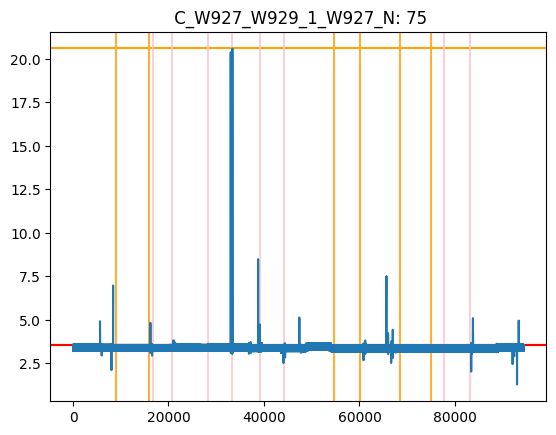

***********************************************************************************************
Sensor: 76  C_W919_W910_1_W910_A
DD = None
DD = None


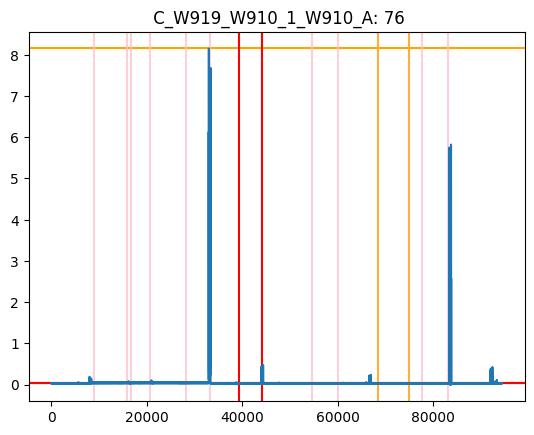

***********************************************************************************************
Sensor: 77  C_W919_W910_1_W910_B
DD = None
DD = None
DD = None


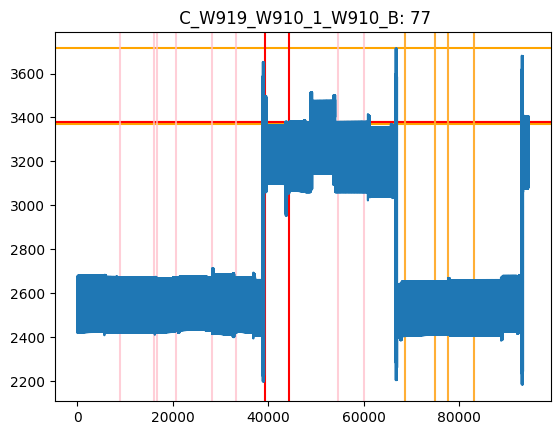

***********************************************************************************************
Sensor: 78  C_W919_W910_1_W910_C
DD = None
DD = None


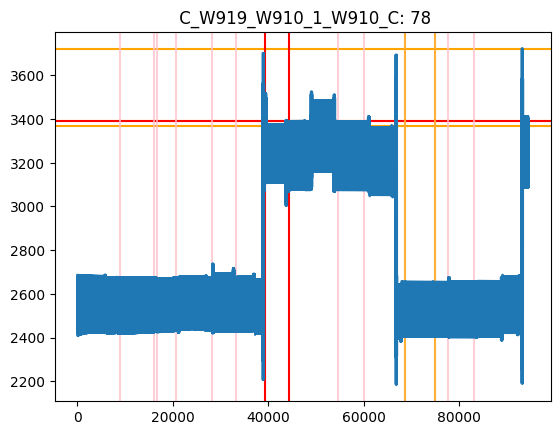

***********************************************************************************************
Sensor: 79  C_W919_W910_1_W910_N
DD = 5
DD = None


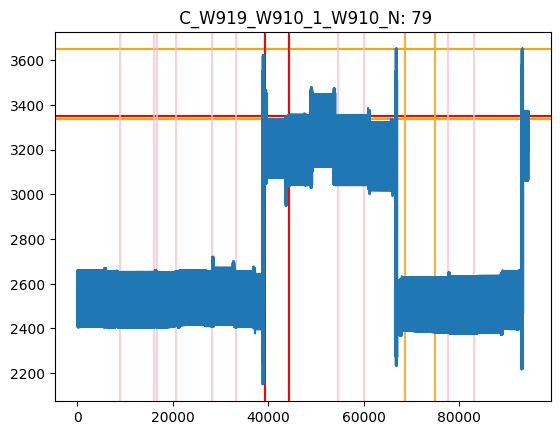

***********************************************************************************************
Sensor: 80  V_W911_AN
DD = None
DD = None


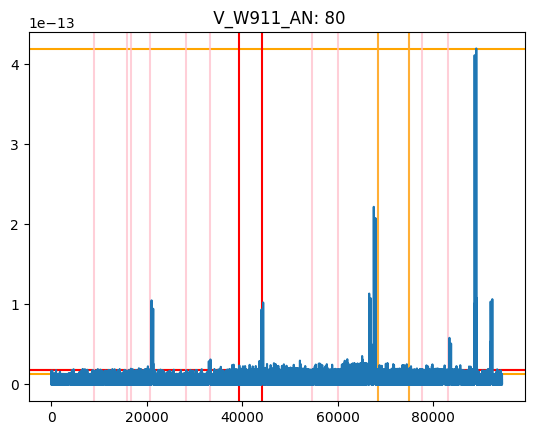

***********************************************************************************************
Sensor: 81  V_W911_BN
DD = None
DD = None


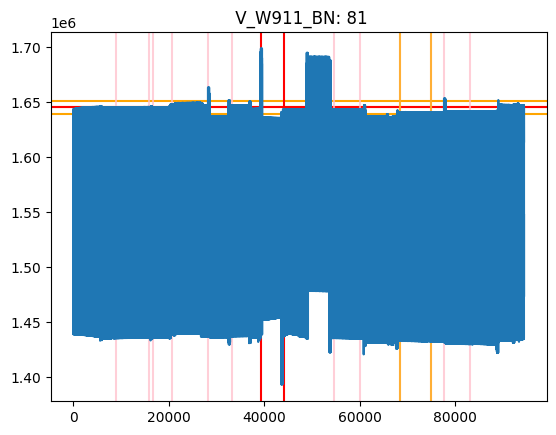

***********************************************************************************************
Sensor: 82  V_W911_CN
DD = None
DD = None


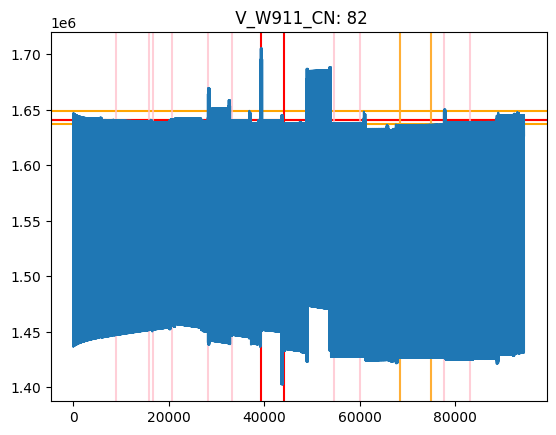

***********************************************************************************************
Sensor: 83  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_A


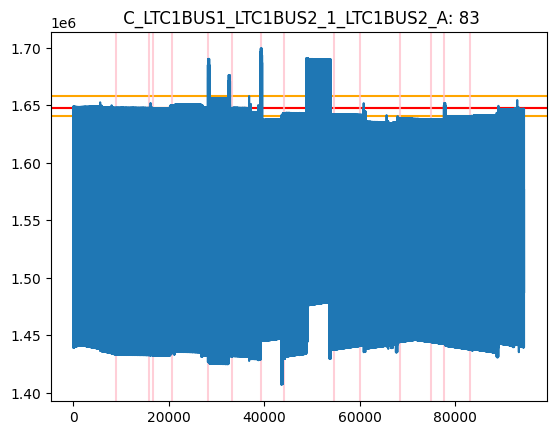

***********************************************************************************************
Sensor: 84  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_B


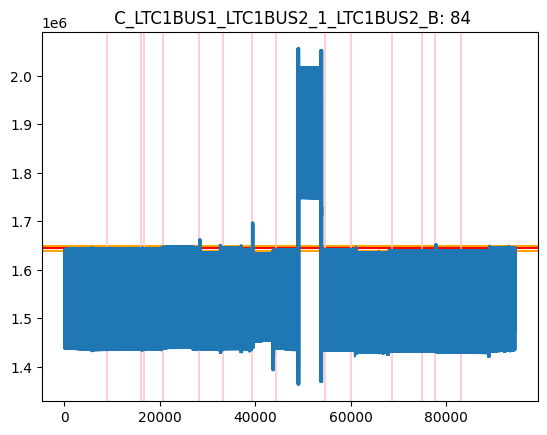

***********************************************************************************************
Sensor: 85  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_C


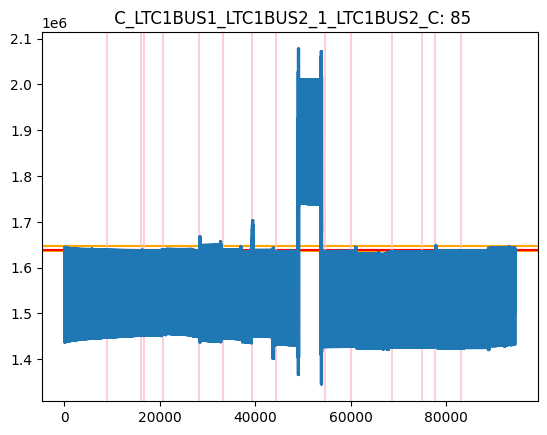

***********************************************************************************************
Sensor: 86  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_N


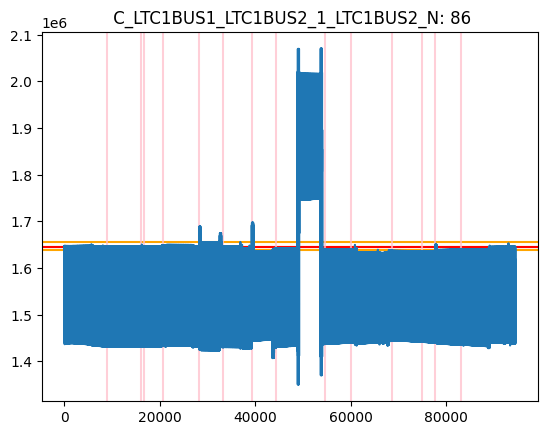

***********************************************************************************************
Sensor: 87  V_BUS13KV1_AN


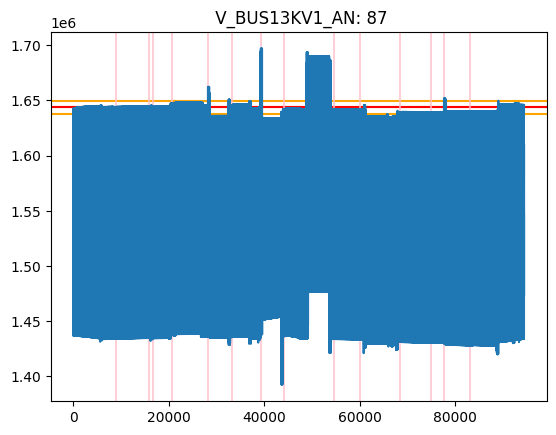

***********************************************************************************************
Sensor: 88  V_BUS13KV1_CN
DD = None
DD = None


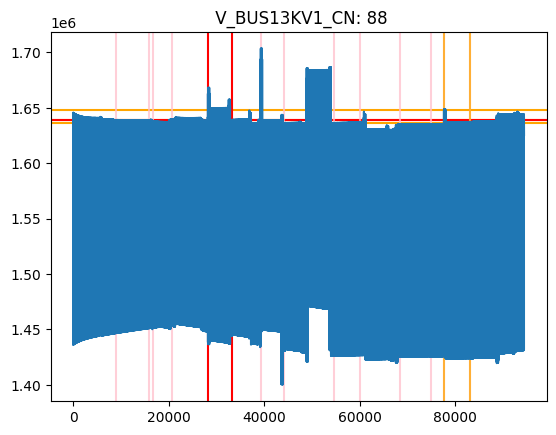

***********************************************************************************************
Sensor: 89  V_BUS13KV1_BN


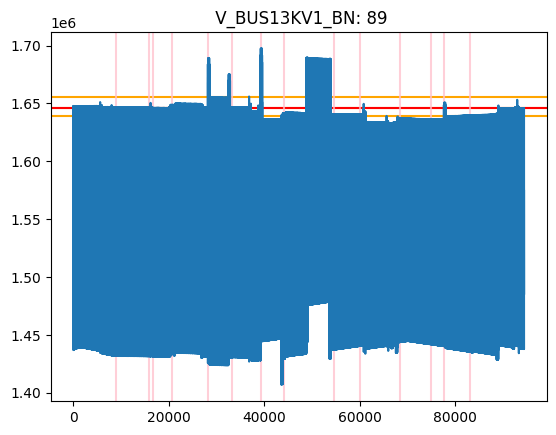

***********************************************************************************************
Sensor: 90  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_A
90
DD = None
90
DD = None


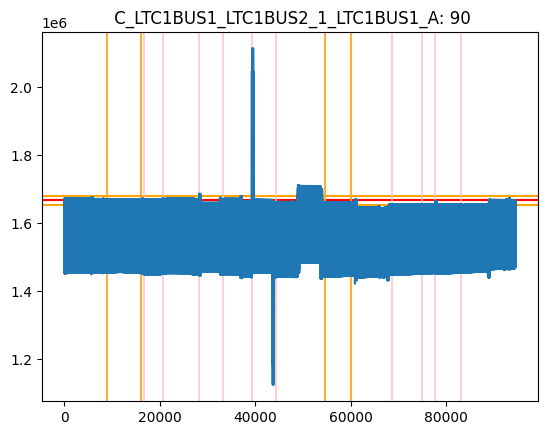

***********************************************************************************************
Sensor: 91  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_B
91
DD = None
91
DD = None


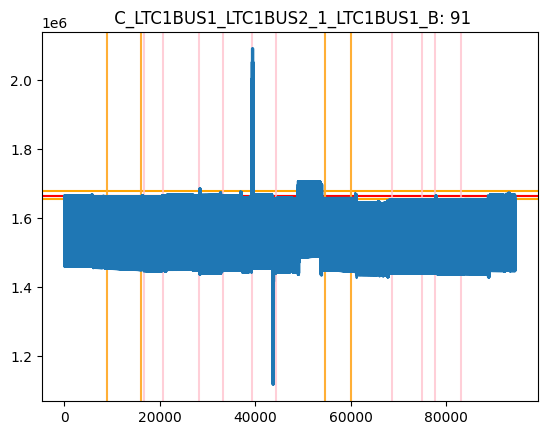

***********************************************************************************************
Sensor: 92  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_C
92
DD = None


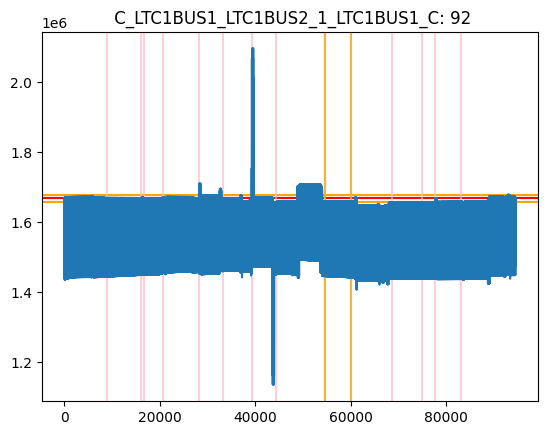

***********************************************************************************************
Sensor: 93  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_NN
93
DD = None


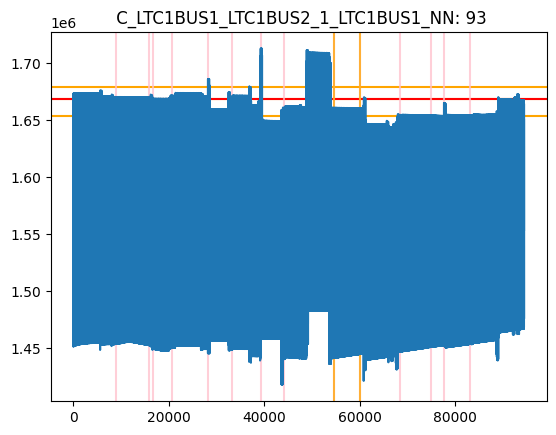

***********************************************************************************************
Sensor: 94  V_BUS13KV2_AN


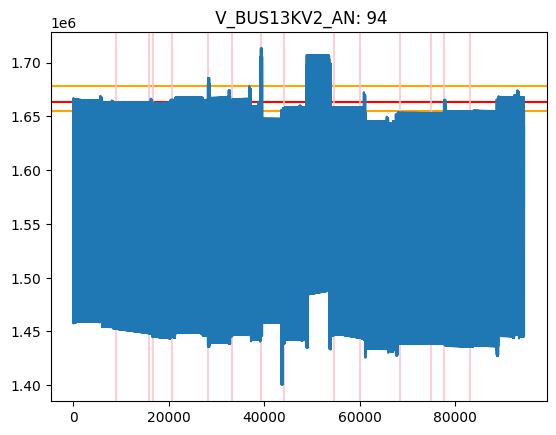

***********************************************************************************************
Sensor: 95  V_BUS13KV2_BN


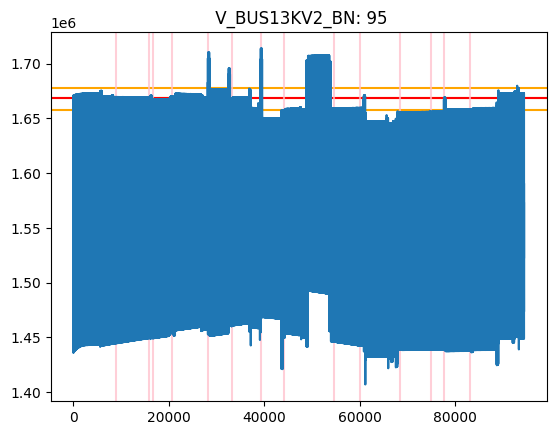

***********************************************************************************************
Sensor: 96  V_BUS13KV2_CN


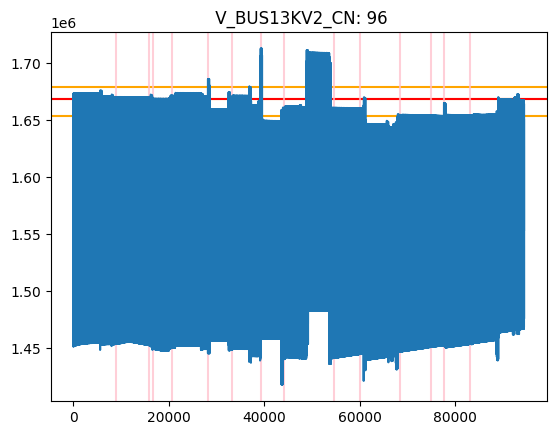

***********************************************************************************************
Sensor: 97  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_A
97
DD = None


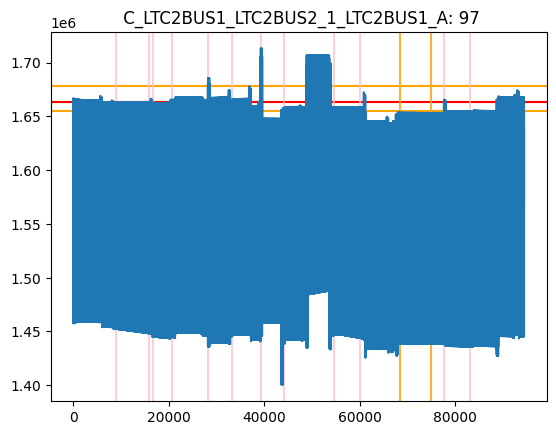

***********************************************************************************************
Sensor: 98  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_B
98
DD = None


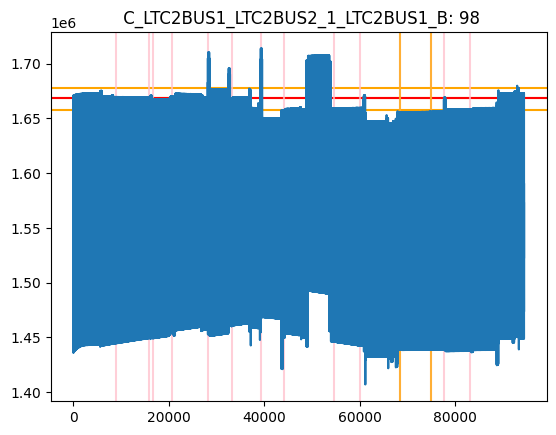

***********************************************************************************************
Sensor: 99  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_C
99
DD = None


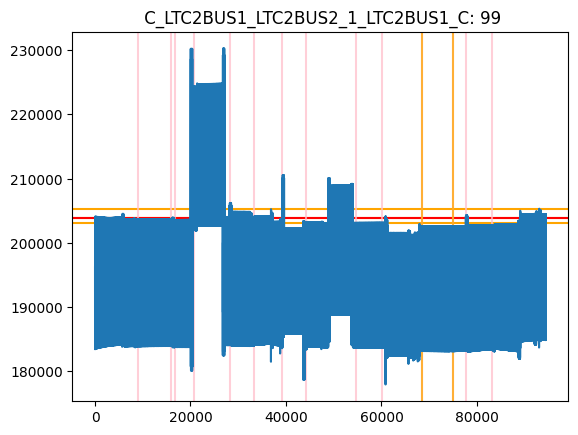

***********************************************************************************************
Sensor: 100  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_NN
100
DD = None
100
DD = None


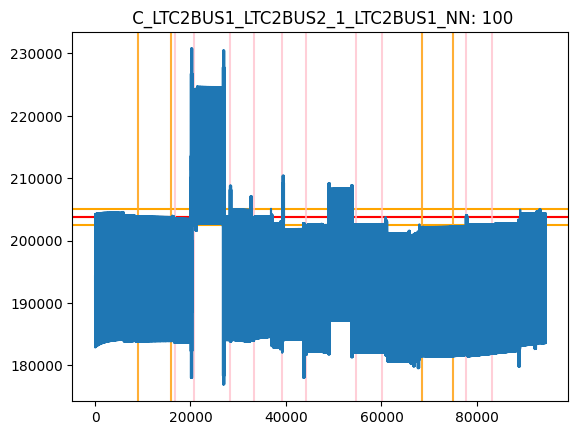

***********************************************************************************************
Sensor: 101  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_A
101
DD = None


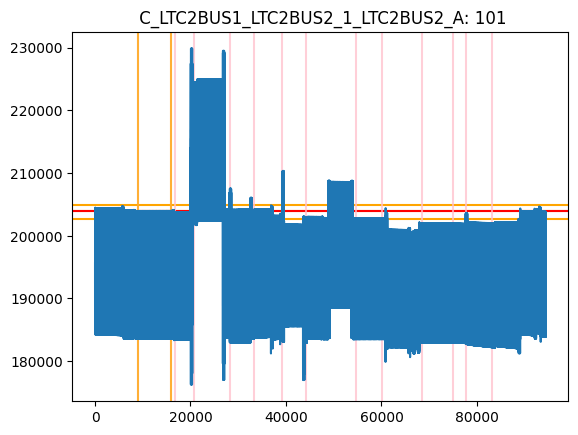

***********************************************************************************************
Sensor: 102  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_B
102
DD = None


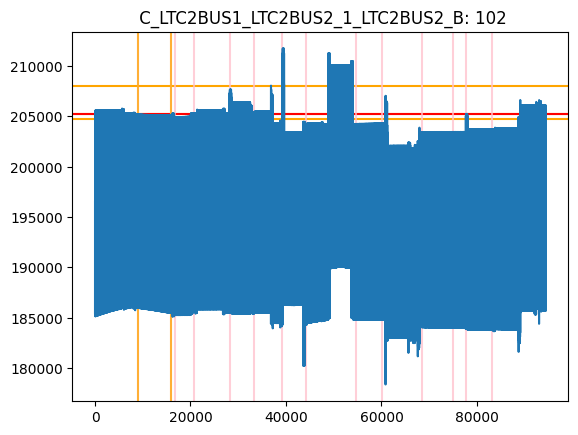

***********************************************************************************************
Sensor: 103  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_C
103
DD = None


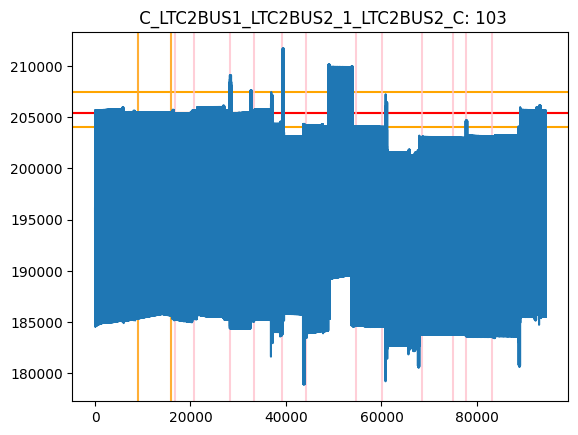

***********************************************************************************************
Sensor: 104  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_N
104
DD = None


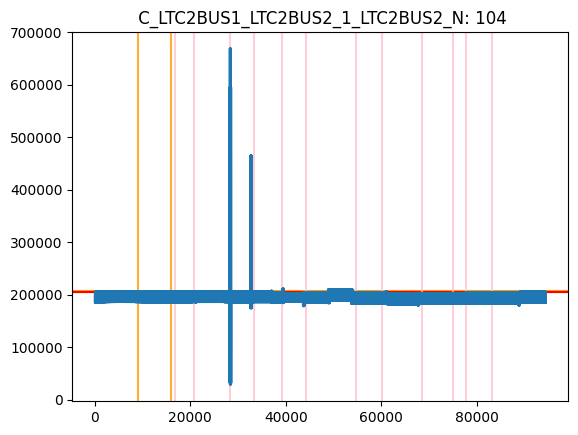

***********************************************************************************************
Sensor: 105  C_SOURCE~C_SUBC~115_1_SOURCE~C_A


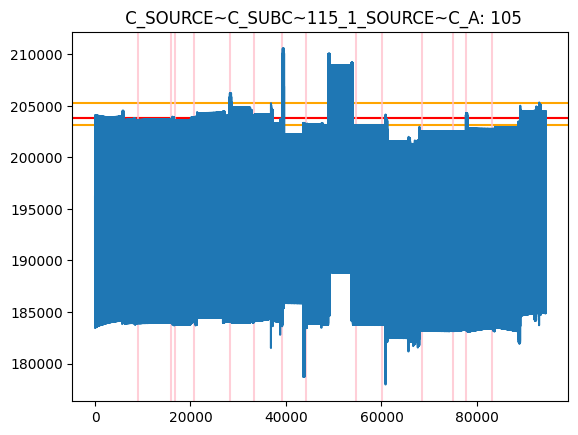

***********************************************************************************************
Sensor: 106  C_SOURCE~C_SUBC~115_1_SOURCE~C_B


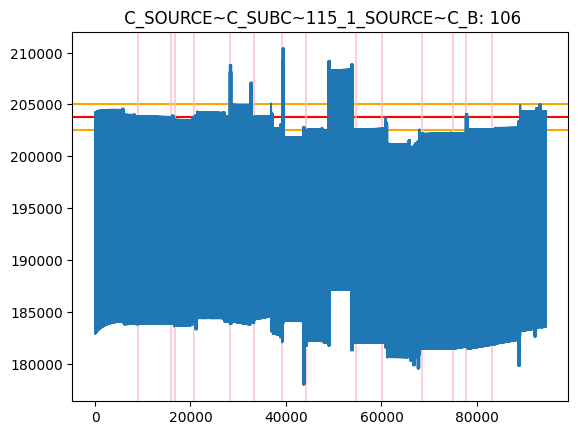

***********************************************************************************************
Sensor: 107  C_SOURCE~C_SUBC~115_1_SOURCE~C_C
107
DD = None
107
DD = None


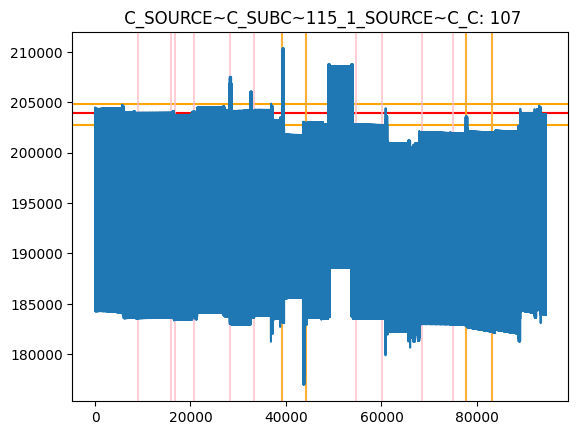

***********************************************************************************************
Sensor: 108  C_SOURCE~C_SUBC~115_1_SOURCE~C_N


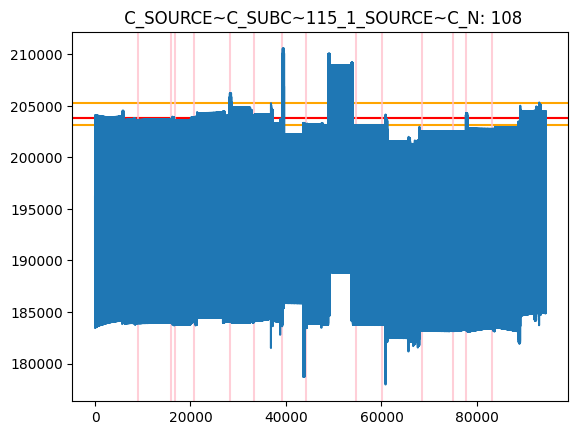

***********************************************************************************************
Sensor: 109  V_SOURCE-C_AN


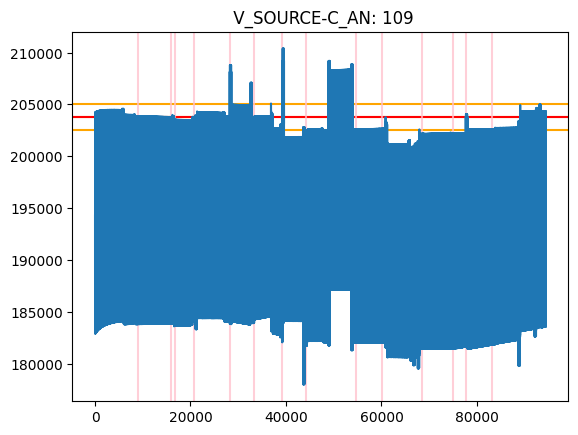

***********************************************************************************************
Sensor: 110  V_SOURCE-C_BN


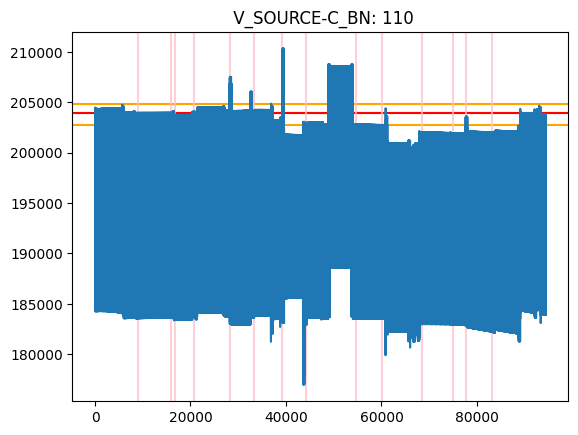

***********************************************************************************************
Sensor: 111  V_SOURCE-C_CN


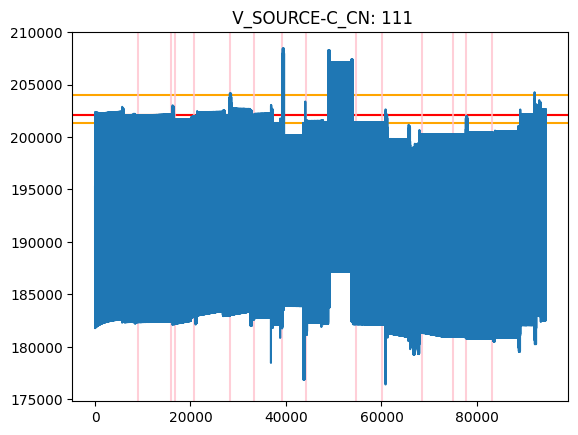

***********************************************************************************************
Sensor: 112  C_SOURCE~A_SUBA~115_1_SOURCE~A_A
112
DD = None


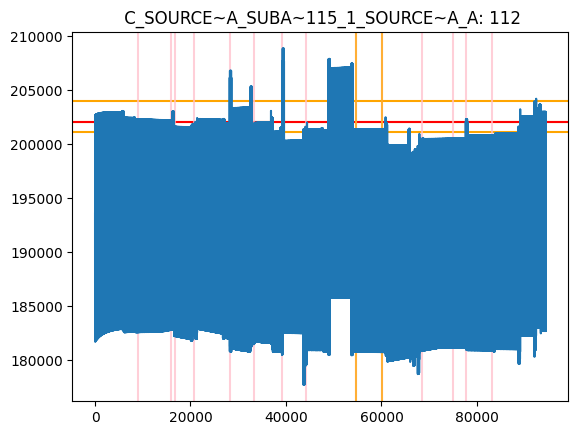

***********************************************************************************************
Sensor: 113  C_SOURCE~A_SUBA~115_1_SOURCE~A_B
113
DD = None


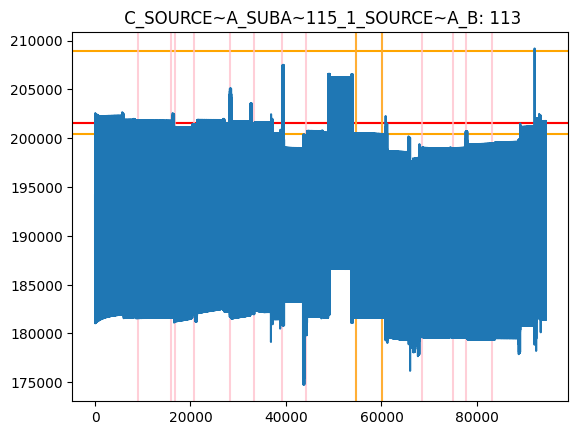

***********************************************************************************************
Sensor: 114  C_SOURCE~A_SUBA~115_1_SOURCE~A_C
114
DD = None


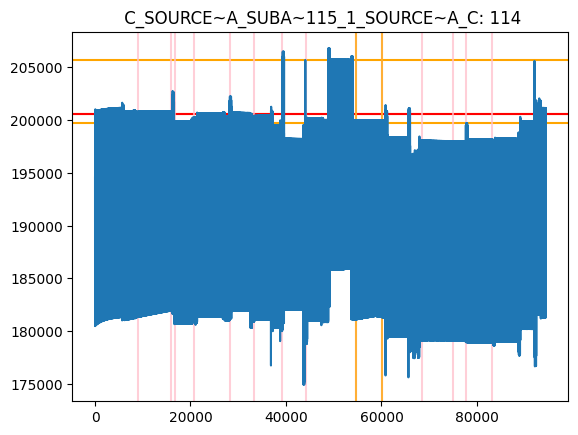

***********************************************************************************************
Sensor: 115  C_SOURCE~A_SUBA~115_1_SOURCE~A_N
115
DD = None


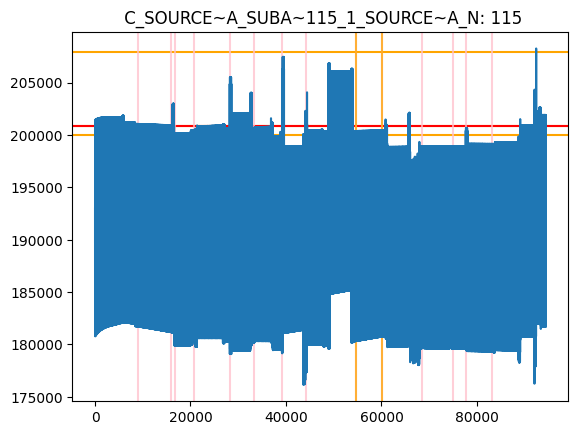

***********************************************************************************************
Sensor: 116  V_SOURCE-A_AN


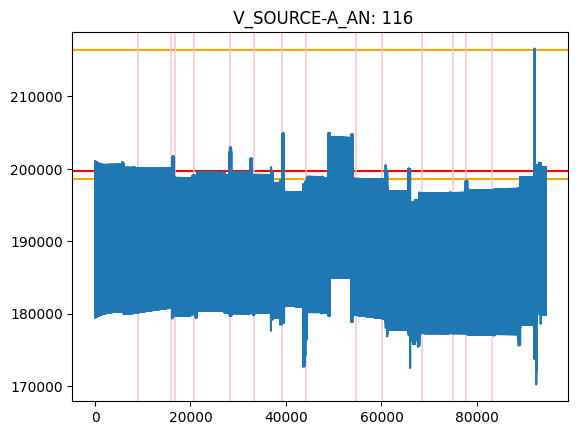

***********************************************************************************************
Sensor: 117  V_SOURCE-A_BN


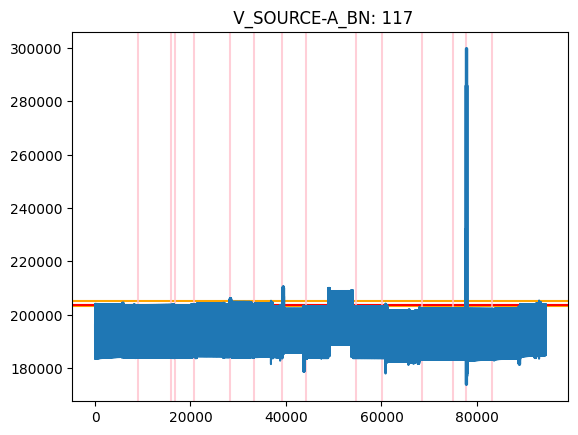

***********************************************************************************************
Sensor: 118  V_SOURCE-A_CN


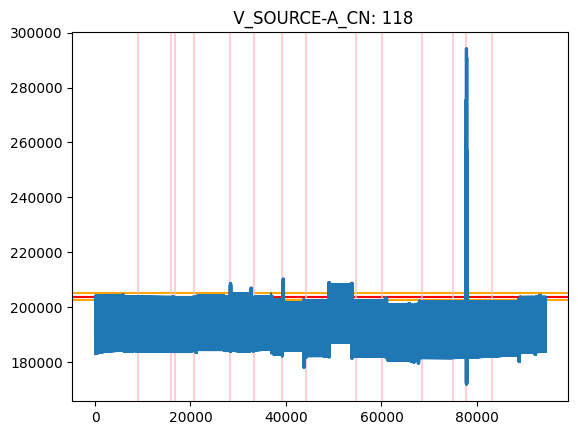

***********************************************************************************************
Sensor: 119  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A
119
DD = None


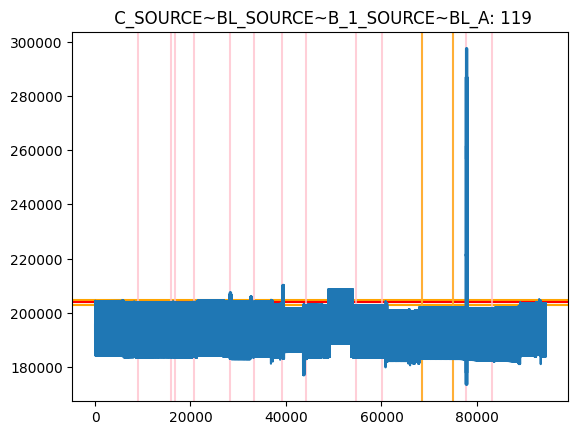

***********************************************************************************************
Sensor: 120  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B
120
DD = None


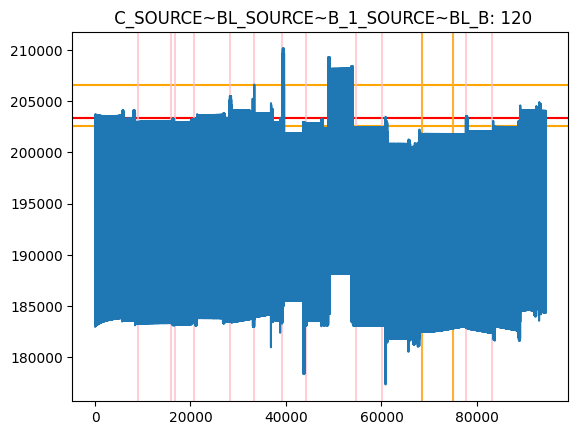

***********************************************************************************************
Sensor: 121  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C
121
DD = None


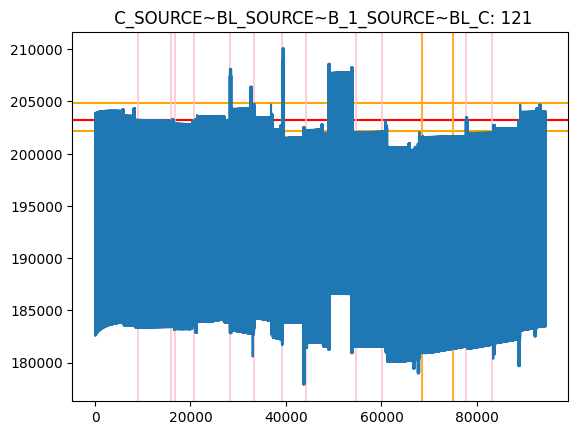

***********************************************************************************************
Sensor: 122  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N
122
DD = None


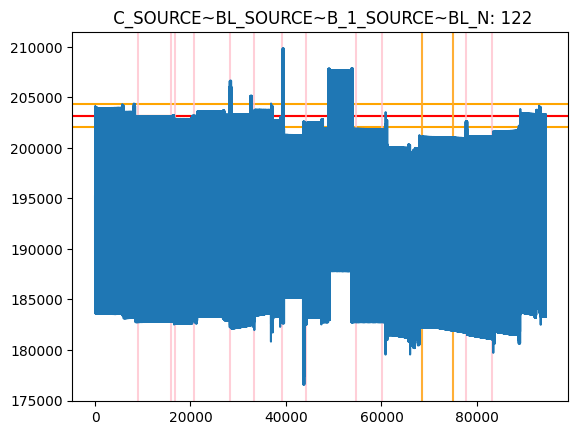

***********************************************************************************************
Sensor: 123  V_SOURCE-BL_AN


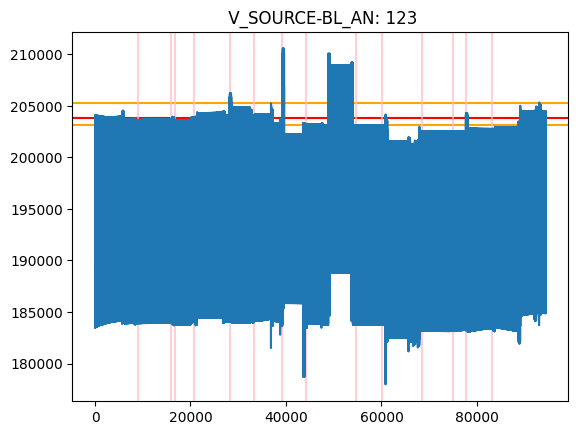

***********************************************************************************************
Sensor: 124  V_SOURCE-BL_BN


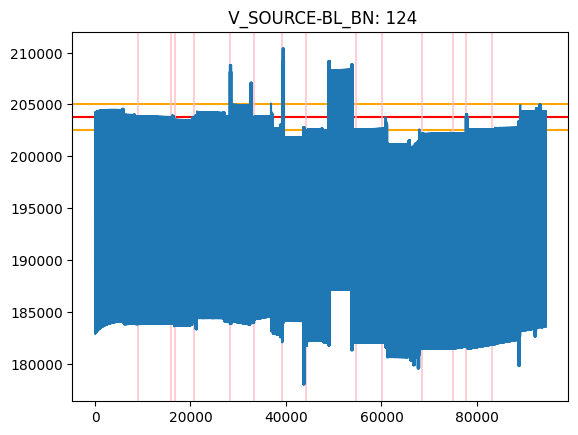

***********************************************************************************************
Sensor: 125  V_SOURCE-BL_CN


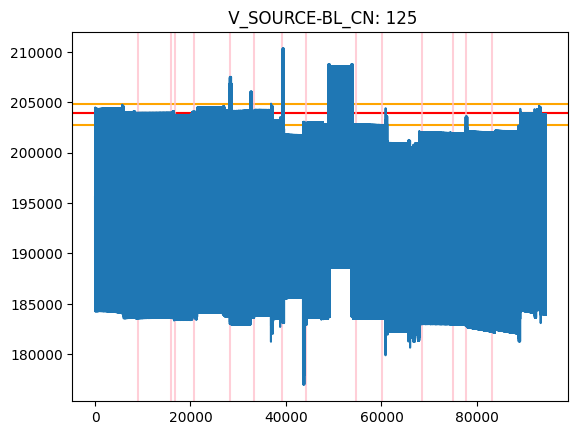

[None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 4, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 4, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 5, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None]


In [32]:
LD_cov = []
at_neighbor = {}

rsum_list = rsum_list_cov
threshold = thresholds_cov_99
t_list = t_cov
persistency = 5

for index, i in enumerate(rsum_list):
    print("***********************************************************************************************")
    attack_in = (i > threshold[index]).nonzero()

    violations = (rsum_list > threshold.reshape(-1, 1))

    print(f"Sensor: {things[index]} {cols[things[index]-1]}")
    at_neighbor[things[index]] = attack_in
    plt.title(f"{cols[things[index]-1]}: {things[index]}")

    for t in t_list:
        plt.axhline(t[index], color='orange')

    plt.axhline(threshold[index], color='red')

    if things[index] in attack_dict:
        #if sensor is being attacked

        # ground truth
        attack_indices = df_test.index[
            (df_test['Time'] >= attack_dict[things[index]][0] * 1e6) &
            (df_test['Time'] <= attack_dict[things[index]][1] * 1e6)] - 1201

        for start, end in all_attack_indices:

            # if this is the attack time of the sensor, plot solid red lines
            if attack_indices[0] == start:
                DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                LD_cov.append(DD)
                print(f"DD = {DD}")
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='red')
                plt.axvline(end_w, color='red')

            # otherwise, plot pink lines
            else:
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='pink', alpha=0.75)
                plt.axvline(end_w, color='pink', alpha=0.75)

                start_w = start-window-w
                end_w = end+window+w-1
                for starts, ate in attack_i.items():
                  if starts == start and things[index] in ate:
                    DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                    LD_cov.append(DD)
                    print(f"DD = {DD}")
                    plt.axvline(start_w, color='orange', alpha=0.75)
                    plt.axvline(end_w, color='orange', alpha=0.75)

    else:
         for start, end in all_attack_indices:
            start_w = start-window-w
            end_w = end+window+w-1
            plt.axvline(start_w, color='pink', alpha=0.75)
            plt.axvline(end_w, color='pink', alpha=0.75)
            for starts, ate in attack_i.items():
              if starts == start:
                if things[index] in ate:
                  print(things[index])
                  DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                  LD_cov.append(DD)
                  print(f"DD = {DD}")
                  plt.axvline(start_w, color='orange', alpha=0.75)
                  plt.axvline(end_w, color='orange', alpha=0.75)

    plt.plot(i)
    plt.show()

print(LD_cov)

***********************************************************************************************
Sensor: 1  C_W738_W737_2_W737_A


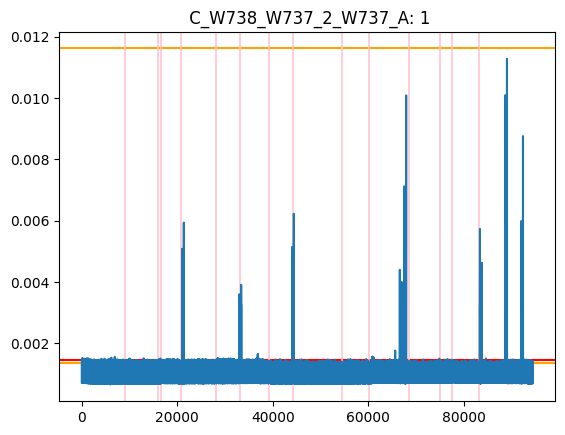

***********************************************************************************************
Sensor: 2  C_W738_W737_2_W737_B


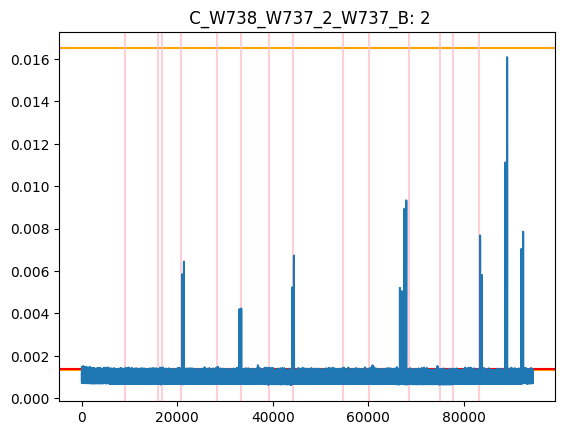

***********************************************************************************************
Sensor: 3  C_W738_W737_2_W737_C


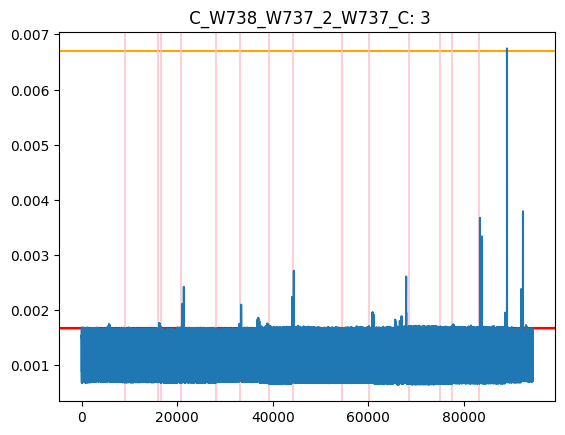

***********************************************************************************************
Sensor: 4  C_W738_W737_2_W737_N


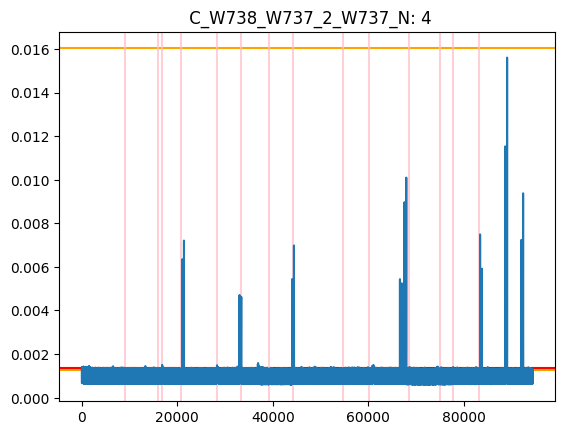

***********************************************************************************************
Sensor: 5  V_W738_AN


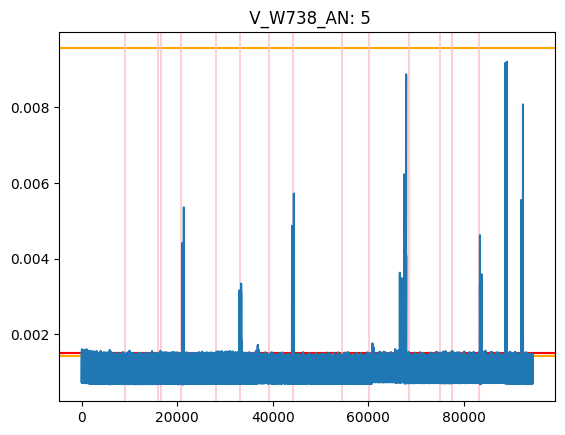

***********************************************************************************************
Sensor: 6  V_W738_BN


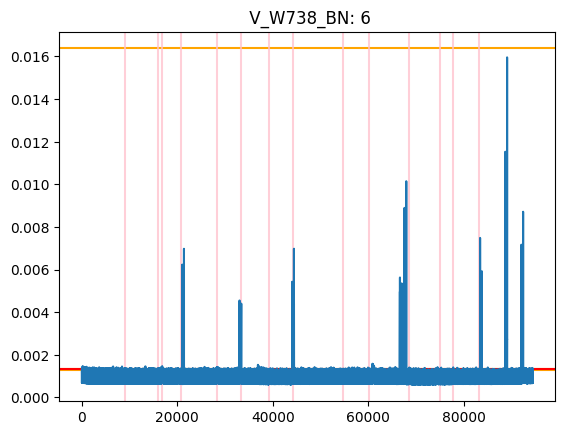

***********************************************************************************************
Sensor: 7  V_W738_CN


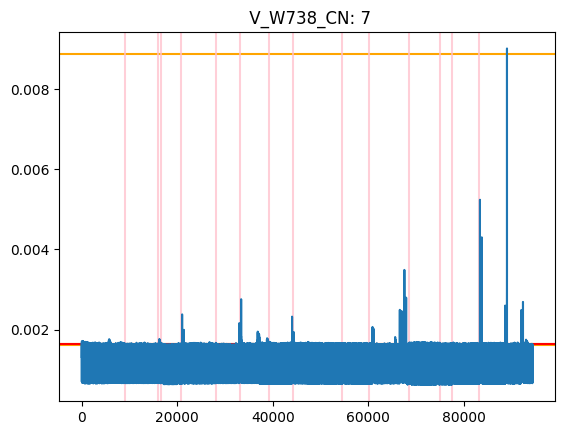

***********************************************************************************************
Sensor: 8  C_W747_W748_2_W747_A
8
DD = None


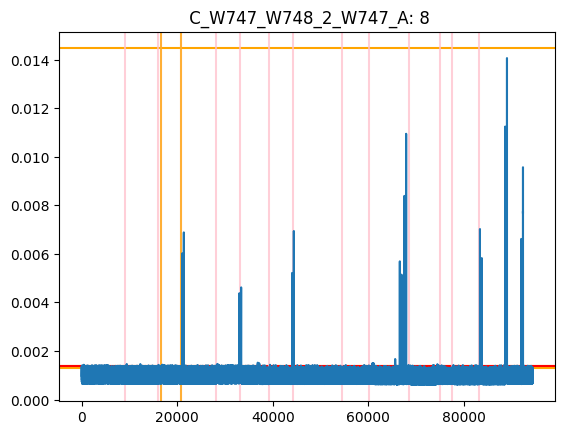

***********************************************************************************************
Sensor: 9  C_W747_W748_2_W747_B
9
DD = None


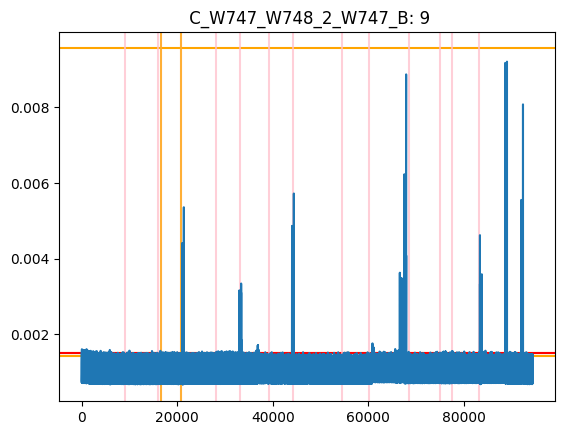

***********************************************************************************************
Sensor: 10  C_W747_W748_2_W747_C
10
DD = None
10
DD = 4804


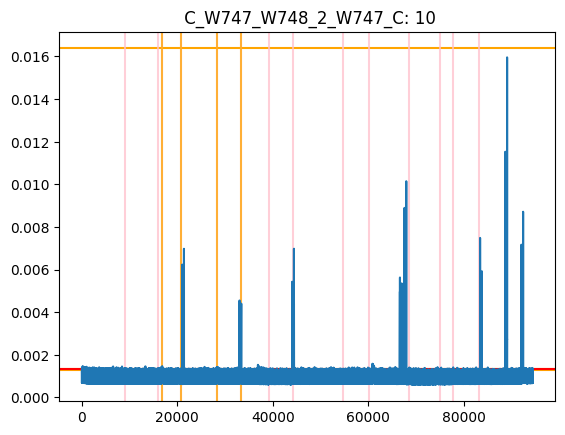

***********************************************************************************************
Sensor: 11  C_W747_W748_2_W747_N
11
DD = None


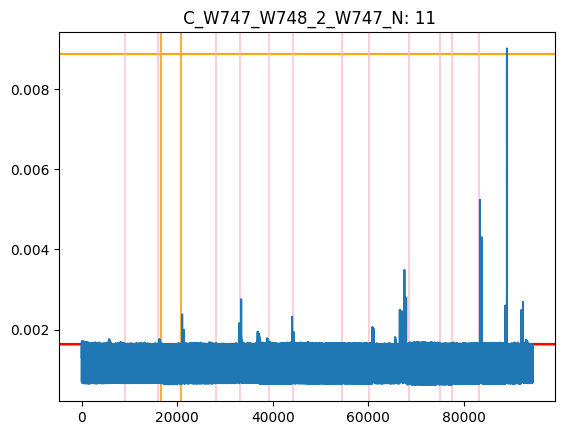

***********************************************************************************************
Sensor: 12  V_W748_AN


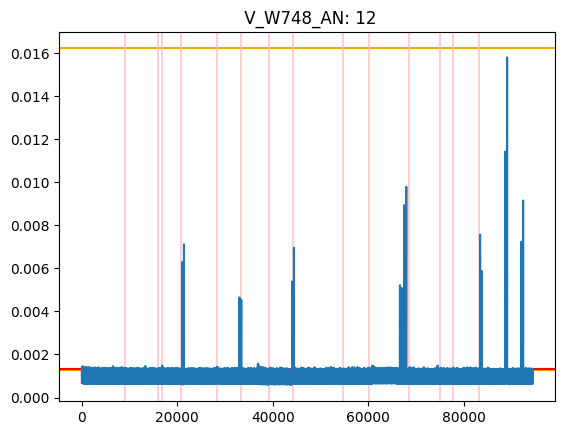

***********************************************************************************************
Sensor: 13  V_W748_BN


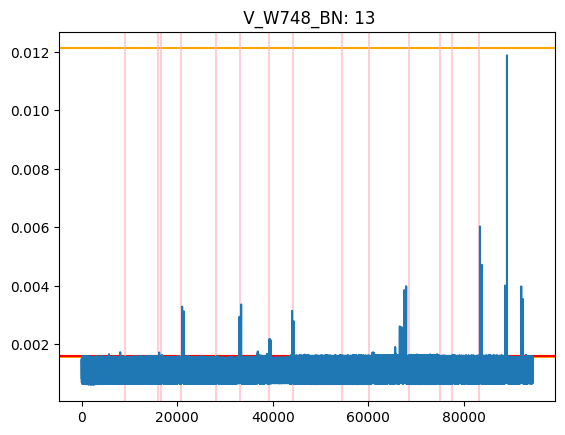

***********************************************************************************************
Sensor: 14  V_W748_CN


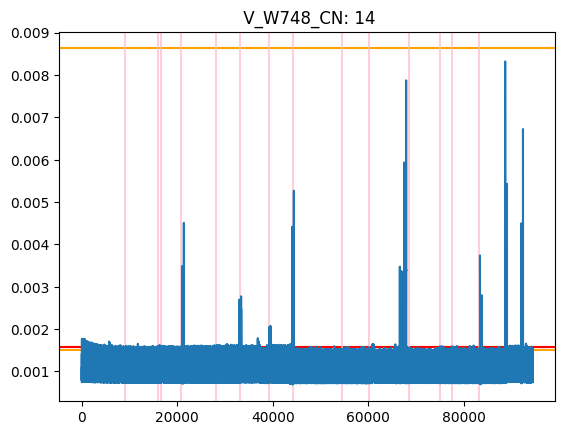

***********************************************************************************************
Sensor: 15  C_W787_W788_2_W787_A
DD = None
DD = None


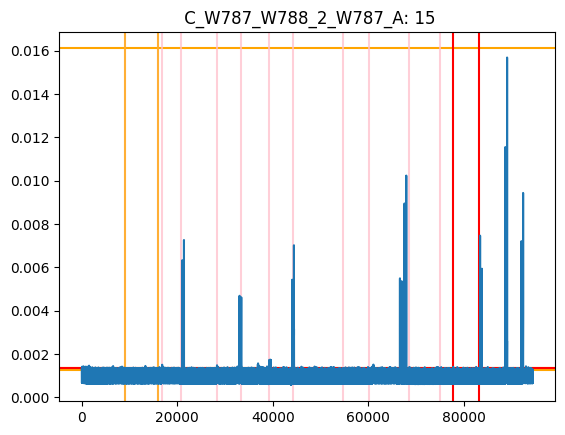

***********************************************************************************************
Sensor: 16  C_W787_W788_2_W787_B
DD = None
DD = None


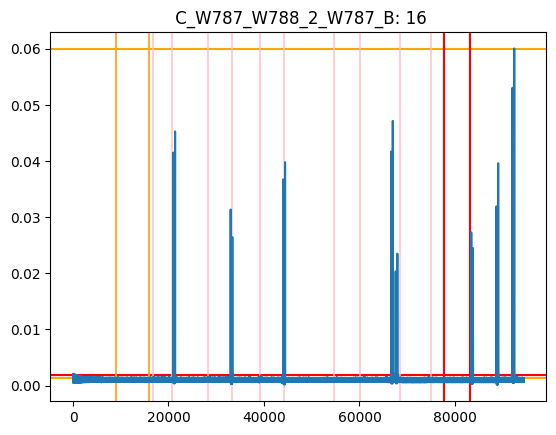

***********************************************************************************************
Sensor: 17  C_W787_W788_2_W787_C
DD = None
DD = None


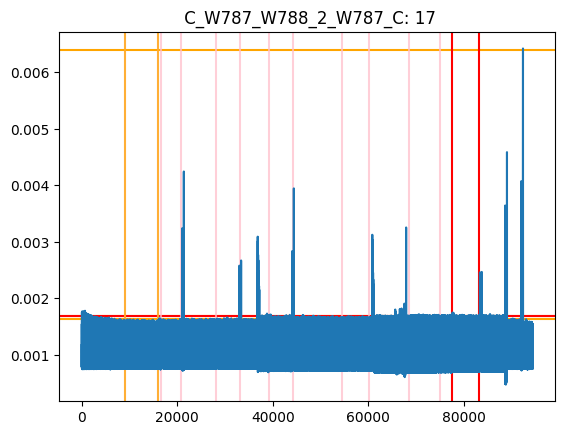

***********************************************************************************************
Sensor: 18  C_W787_W788_2_W787_N
DD = None
DD = None


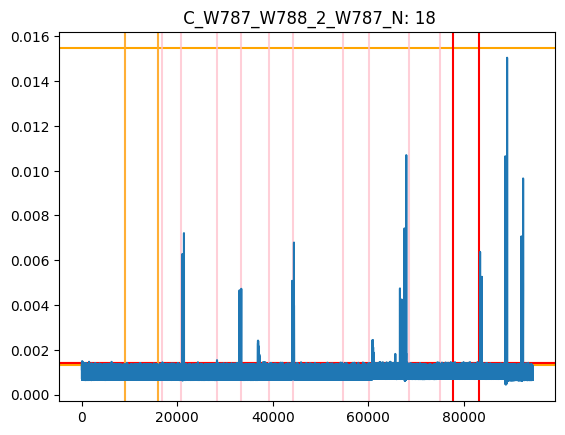

***********************************************************************************************
Sensor: 19  V_W788_AN
DD = None
DD = None


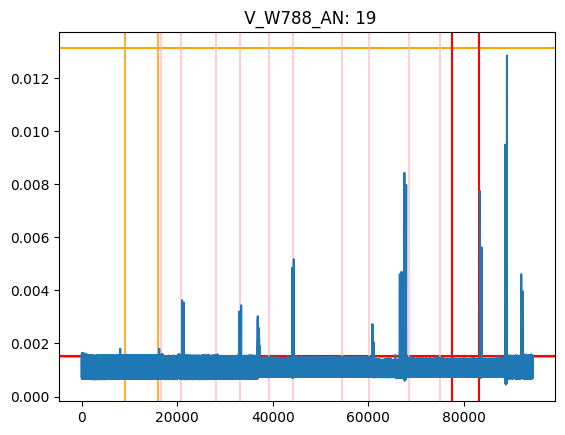

***********************************************************************************************
Sensor: 20  V_W788_BN
DD = None
DD = None


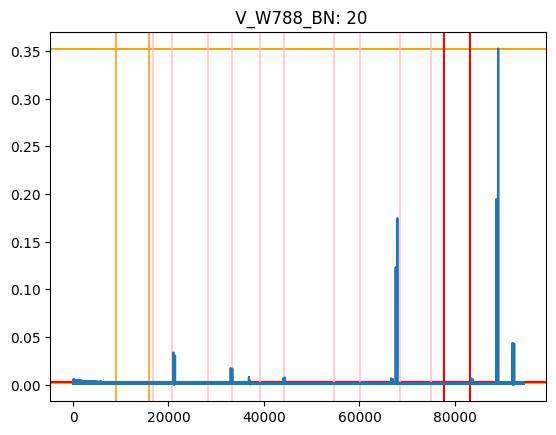

***********************************************************************************************
Sensor: 21  V_W788_CN
DD = None
DD = None


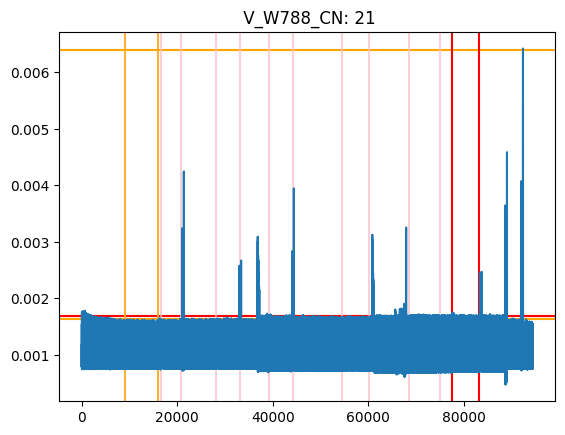

***********************************************************************************************
Sensor: 22  C_W797_W798_2_W797_A


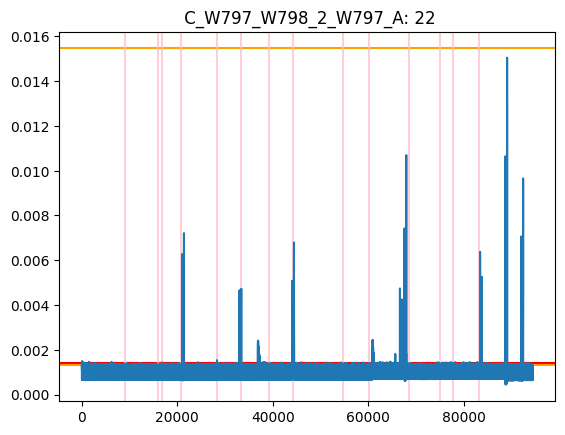

***********************************************************************************************
Sensor: 23  C_W797_W798_2_W797_B


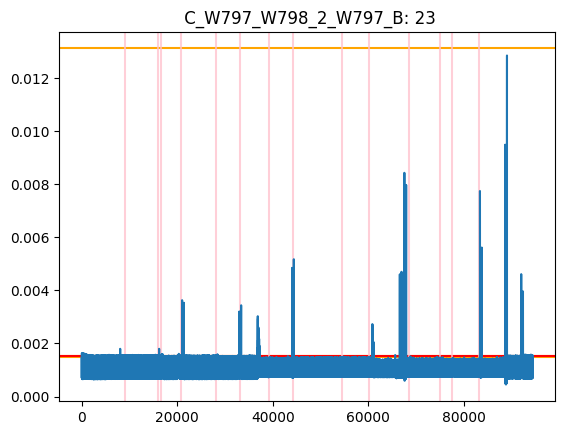

***********************************************************************************************
Sensor: 24  C_W797_W798_2_W797_C


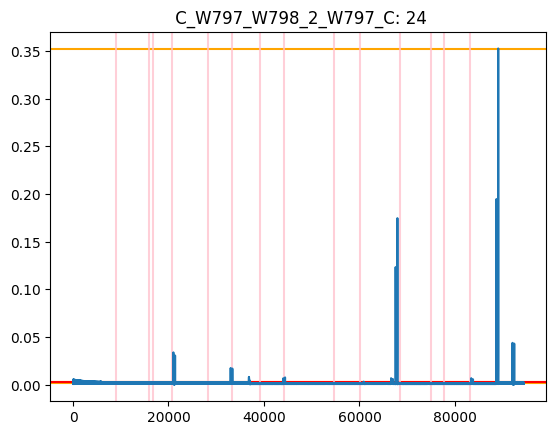

***********************************************************************************************
Sensor: 25  C_W797_W798_2_W797_N


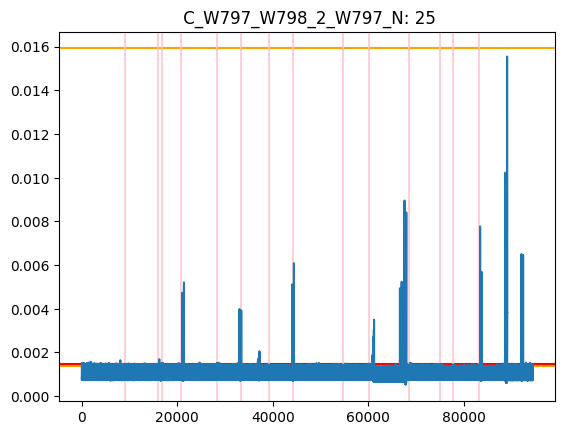

***********************************************************************************************
Sensor: 26  V_W798_AN


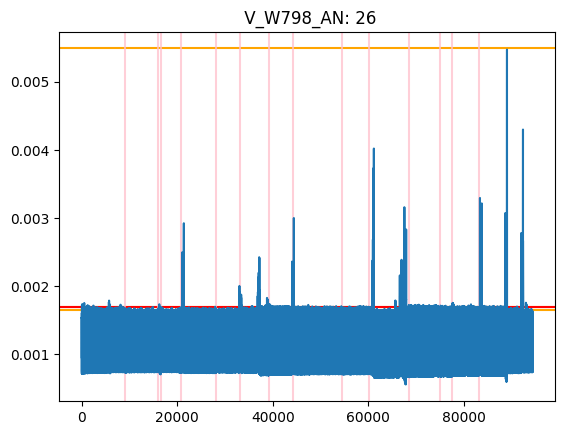

***********************************************************************************************
Sensor: 27  V_W798_BN


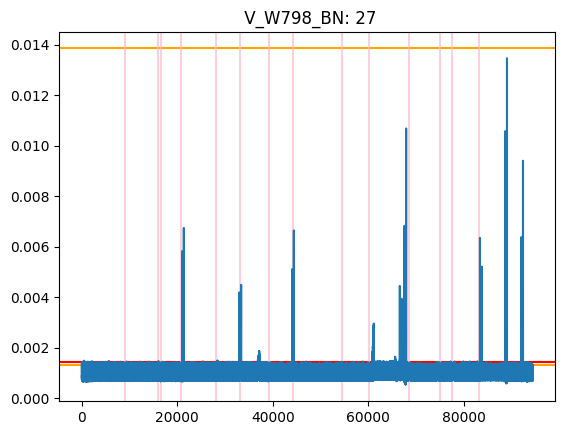

***********************************************************************************************
Sensor: 28  V_W798_CN


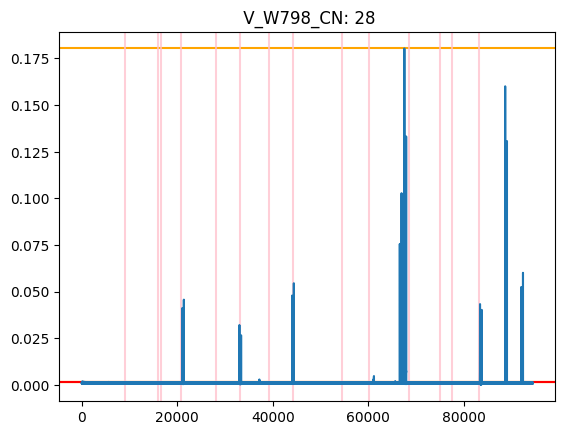

***********************************************************************************************
Sensor: 29  C_FD2B2_FD2B1_1_FD2B1_A
DD = None
DD = None


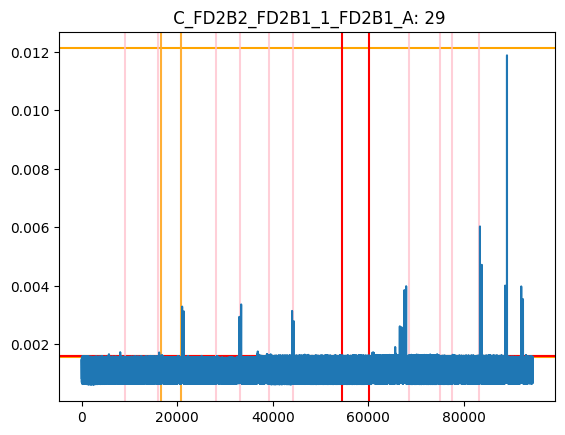

***********************************************************************************************
Sensor: 30  C_FD2B2_FD2B1_1_FD2B1_B
DD = None
DD = None


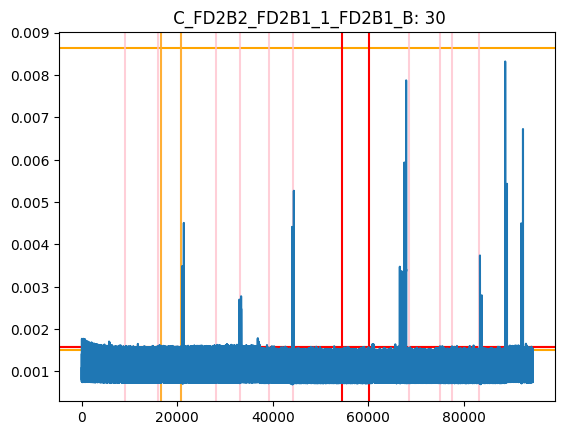

***********************************************************************************************
Sensor: 31  C_FD2B2_FD2B1_1_FD2B1_C
DD = None
DD = 4
DD = 4804


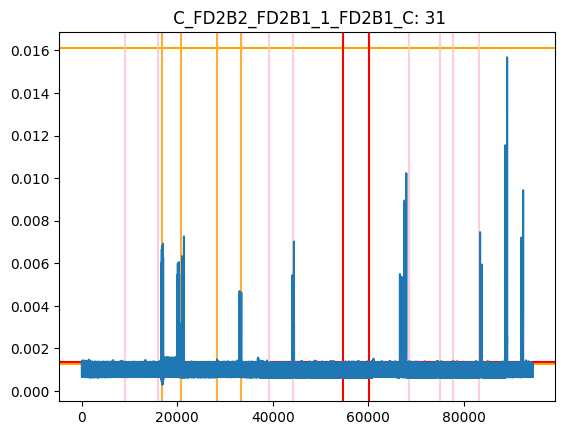

***********************************************************************************************
Sensor: 32  C_FD2B2_FD2B1_1_FD2B1_N
DD = None
DD = None


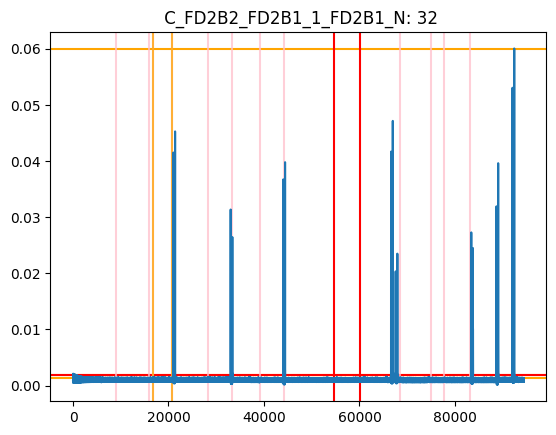

***********************************************************************************************
Sensor: 33  V_FD2B1_AN


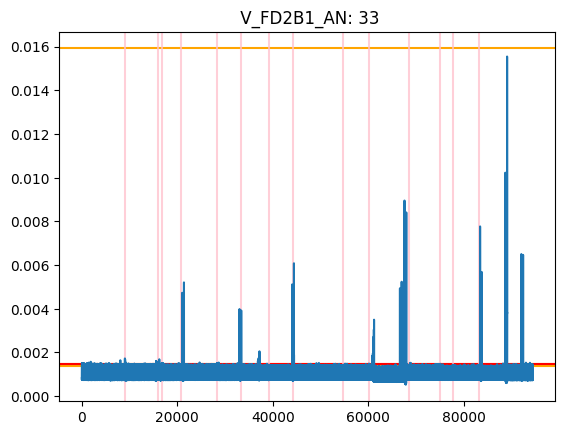

***********************************************************************************************
Sensor: 34  V_FD2B1_BN


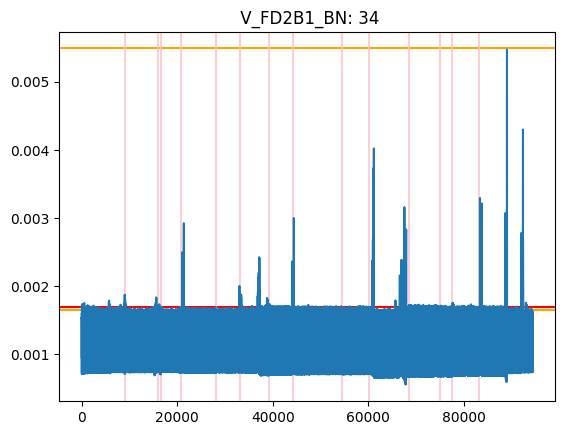

***********************************************************************************************
Sensor: 35  V_FD2B1_CN


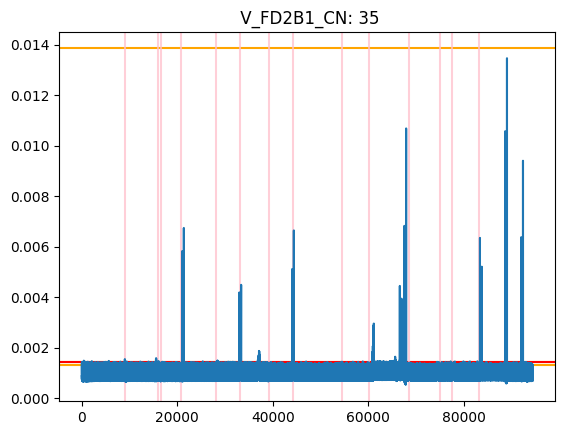

***********************************************************************************************
Sensor: 36  C_FD2B5_FD2B6_1_FD2B5_A
36
DD = None


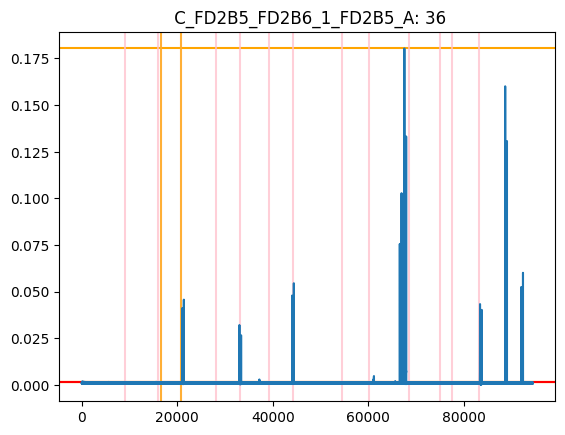

***********************************************************************************************
Sensor: 37  C_FD2B5_FD2B6_1_FD2B5_B
37
DD = None


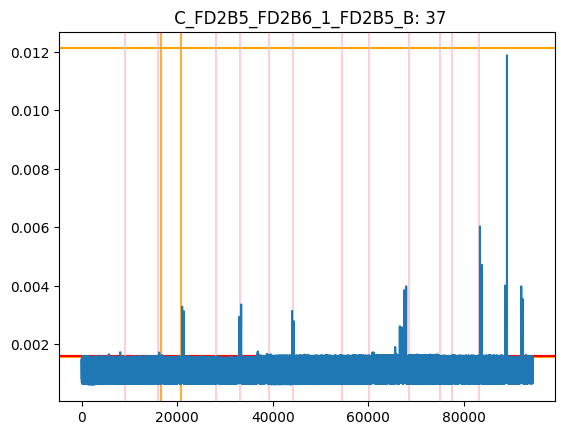

***********************************************************************************************
Sensor: 38  C_FD2B5_FD2B6_1_FD2B5_C
DD = None
DD = None
DD = 4806


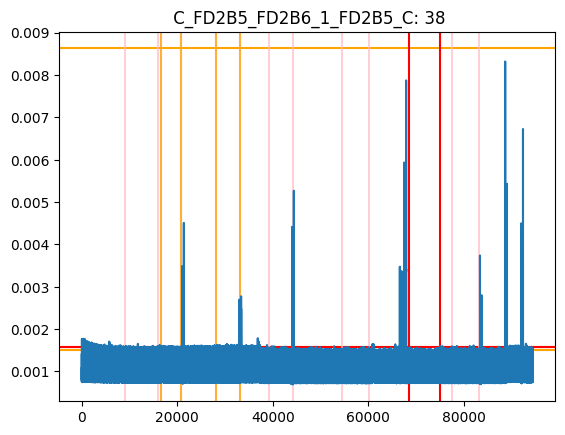

***********************************************************************************************
Sensor: 39  C_FD2B5_FD2B6_1_FD2B5_N
39
DD = None


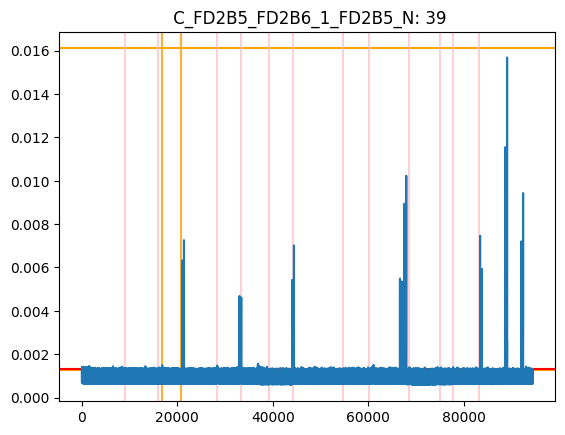

***********************************************************************************************
Sensor: 40  V_FD2B5_AN


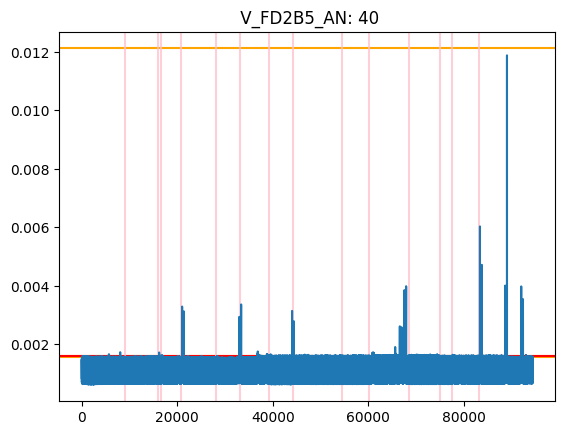

***********************************************************************************************
Sensor: 41  V_FD2B5_BN


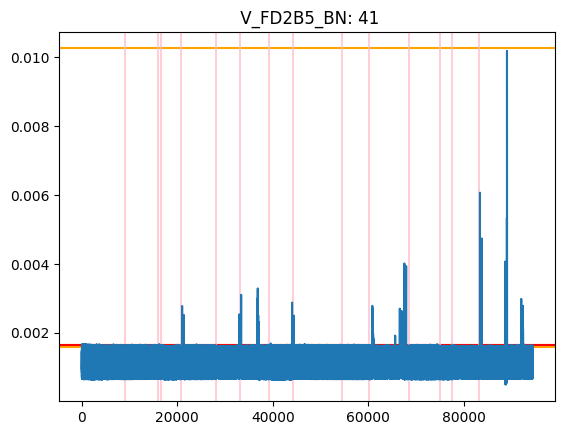

***********************************************************************************************
Sensor: 42  V_FD2B5_CN


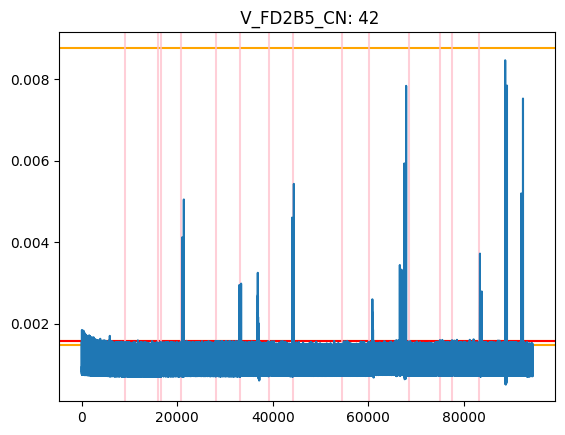

***********************************************************************************************
Sensor: 43  C_FD3B4_FD3B5_1_FD3B4_A
43
DD = None


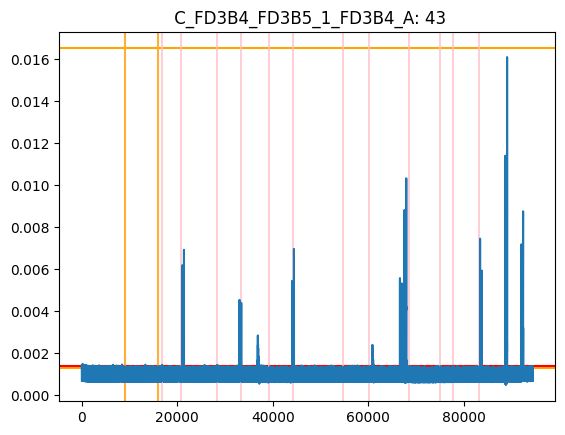

***********************************************************************************************
Sensor: 44  C_FD3B4_FD3B5_1_FD3B4_B
44
DD = None


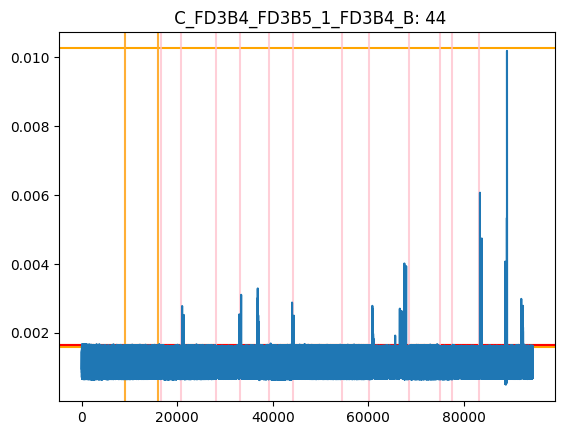

***********************************************************************************************
Sensor: 45  C_FD3B4_FD3B5_1_FD3B4_C
45
DD = None


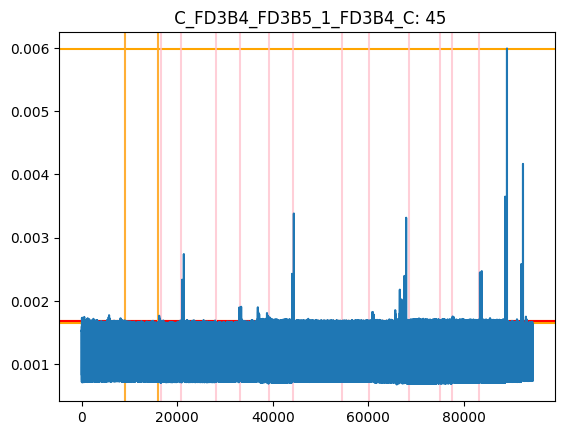

***********************************************************************************************
Sensor: 46  C_FD3B4_FD3B5_1_FD3B4_N
46
DD = None


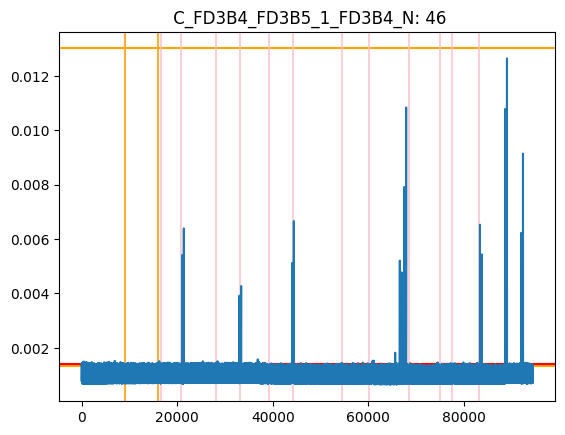

***********************************************************************************************
Sensor: 47  V_FD3B4_AN


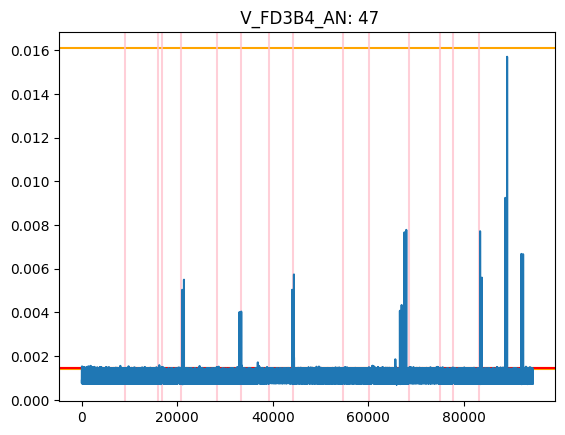

***********************************************************************************************
Sensor: 48  V_FD3B4_BN


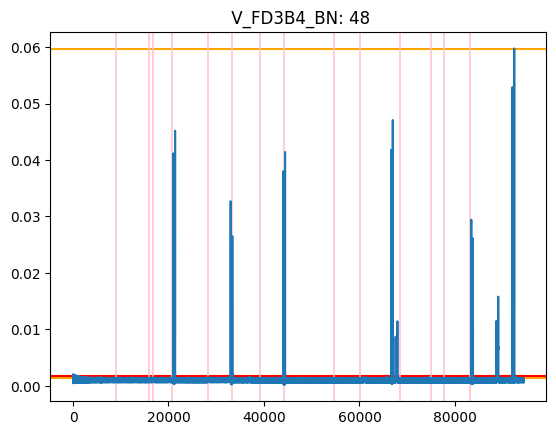

***********************************************************************************************
Sensor: 49  V_FD3B4_CN


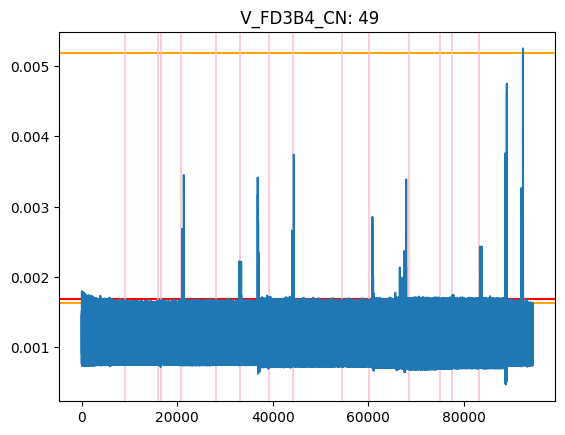

***********************************************************************************************
Sensor: 50  C_W919_W910_1_W919_A
50
DD = None


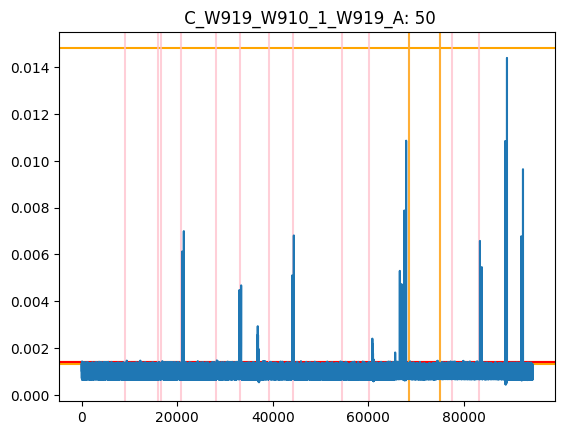

***********************************************************************************************
Sensor: 51  C_W919_W910_1_W919_B
51
DD = None


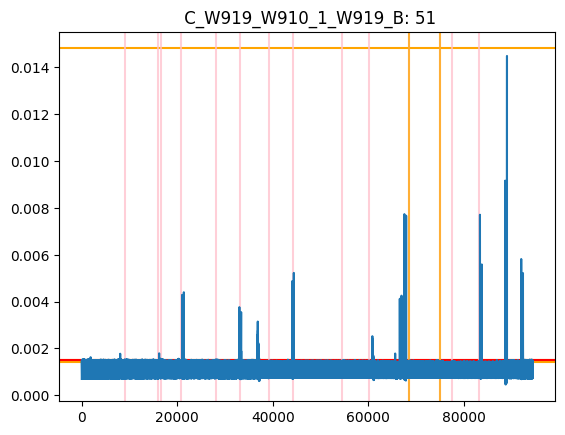

***********************************************************************************************
Sensor: 52  C_W919_W910_1_W919_C
DD = 4807
DD = None
DD = None


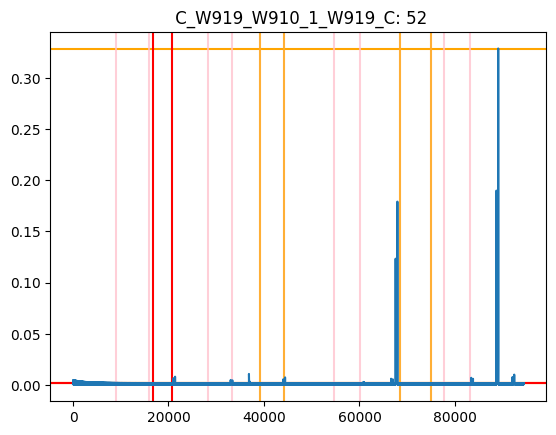

***********************************************************************************************
Sensor: 53  C_W919_W910_1_W919_N
53
DD = None


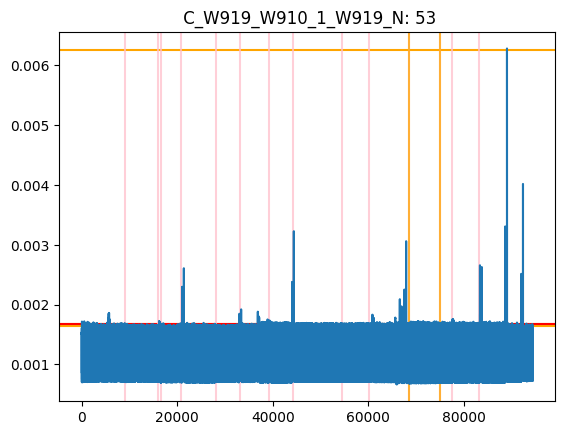

***********************************************************************************************
Sensor: 54  V_W-115KV2_AN


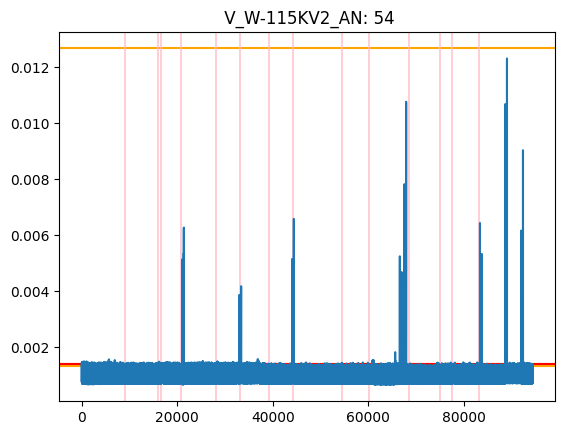

***********************************************************************************************
Sensor: 55  V_W-115KV2_BN


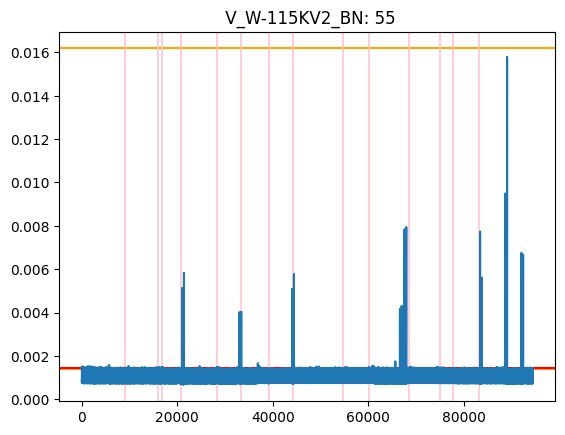

***********************************************************************************************
Sensor: 56  V_W-115KV2_CN


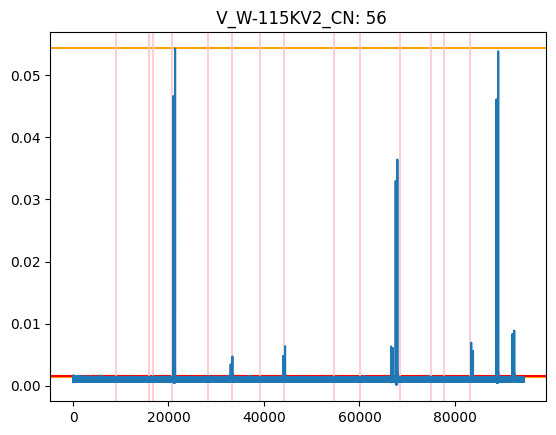

***********************************************************************************************
Sensor: 57  C_W957_W950_1_W950_A
57
DD = None
57
DD = None


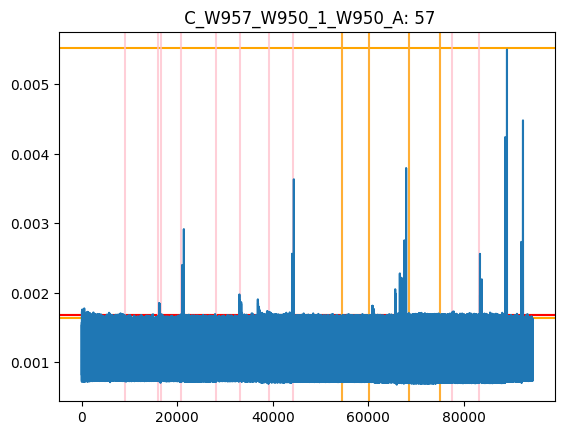

***********************************************************************************************
Sensor: 58  C_W957_W950_1_W950_B
58
DD = None
58
DD = None


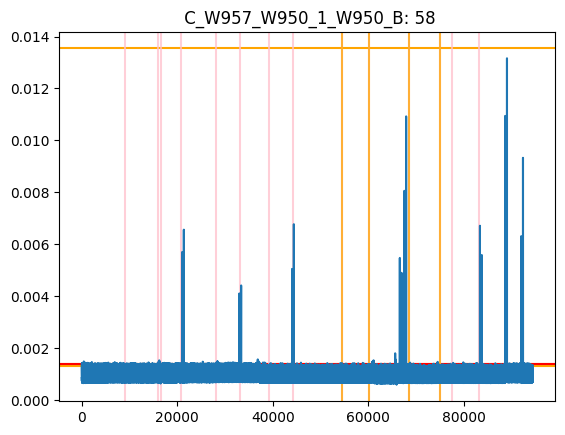

***********************************************************************************************
Sensor: 59  C_W957_W950_1_W950_C
59
DD = None
59
DD = None


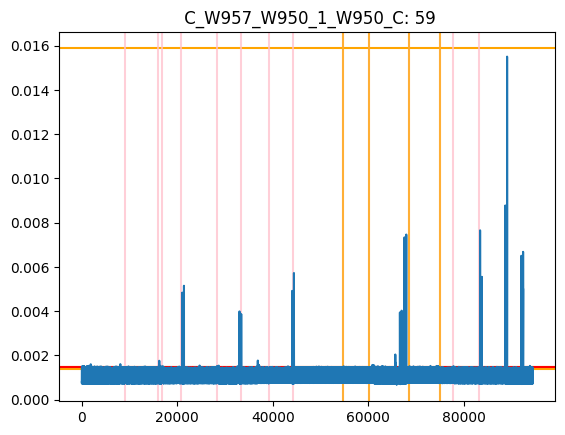

***********************************************************************************************
Sensor: 60  C_W957_W950_1_W950_N
60
DD = None
60
DD = None


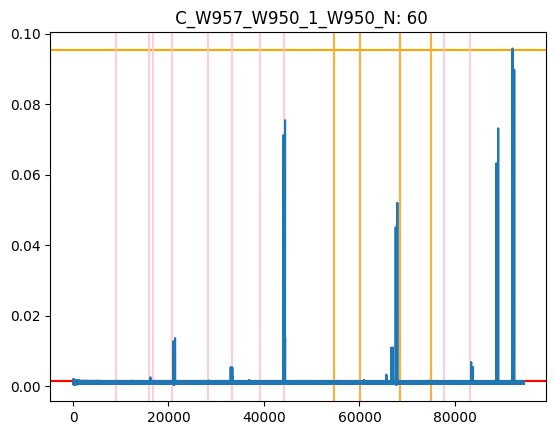

***********************************************************************************************
Sensor: 61  C_W957_W950_1_W957_A
DD = None
DD = None


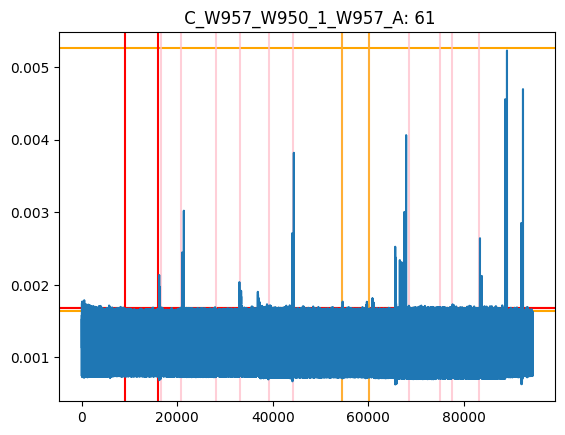

***********************************************************************************************
Sensor: 62  C_W957_W950_1_W957_B
DD = None
DD = None


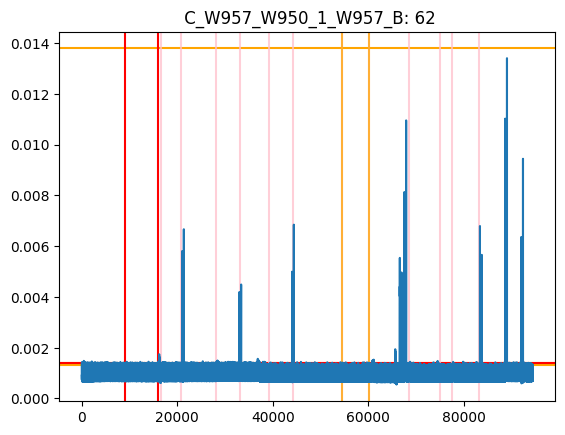

***********************************************************************************************
Sensor: 63  C_W957_W950_1_W957_C
DD = 4
DD = None


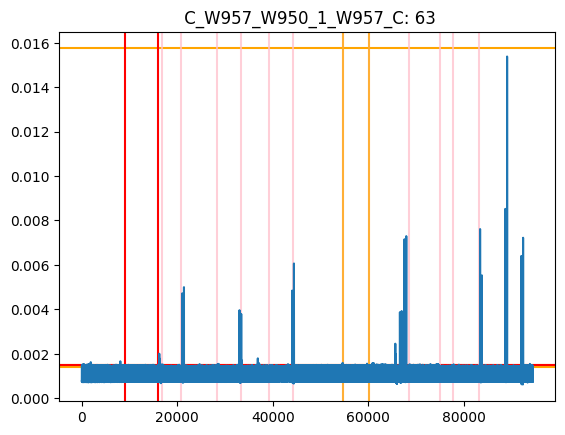

***********************************************************************************************
Sensor: 64  C_W957_W950_1_W957_N
DD = None
DD = None


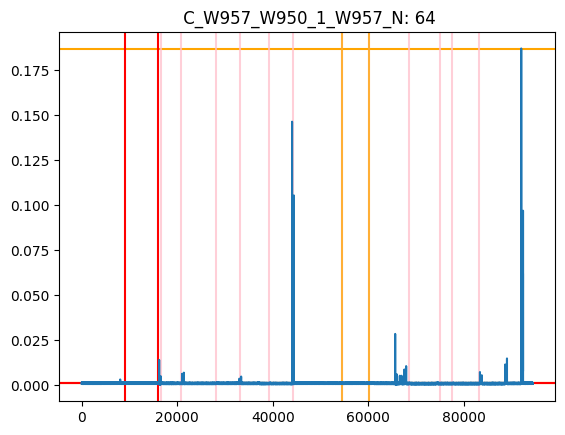

***********************************************************************************************
Sensor: 65  C_W927_W929_1_W929_A
65
DD = None
65
DD = None


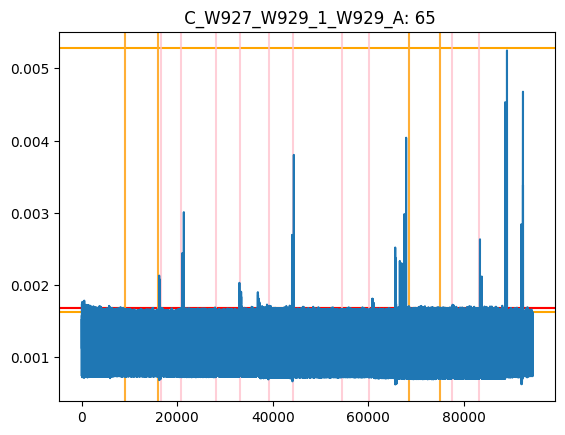

***********************************************************************************************
Sensor: 66  C_W927_W929_1_W929_B
66
DD = None


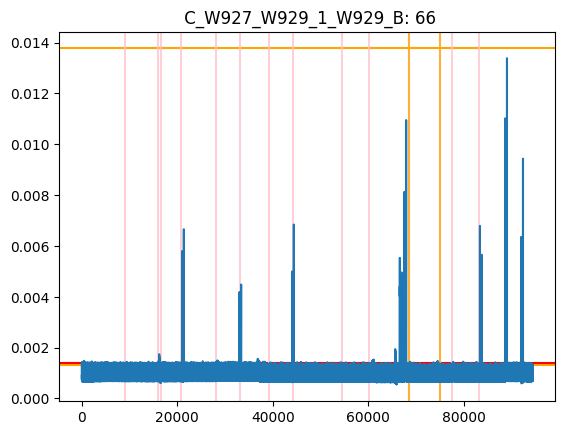

***********************************************************************************************
Sensor: 67  C_W927_W929_1_W929_C
67
DD = 4805
67
DD = 6


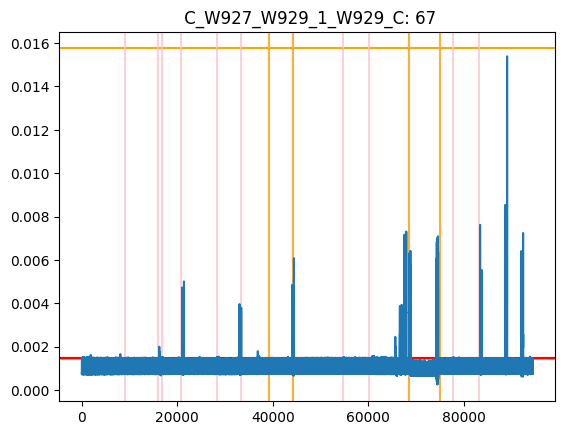

***********************************************************************************************
Sensor: 68  C_W927_W929_1_W929_N
68
DD = None


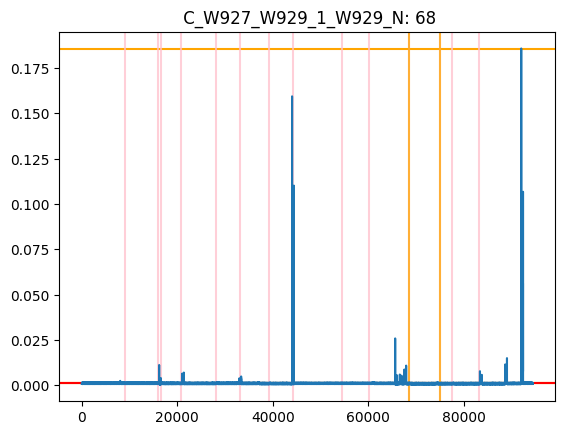

***********************************************************************************************
Sensor: 69  V_W-115KV1_AN


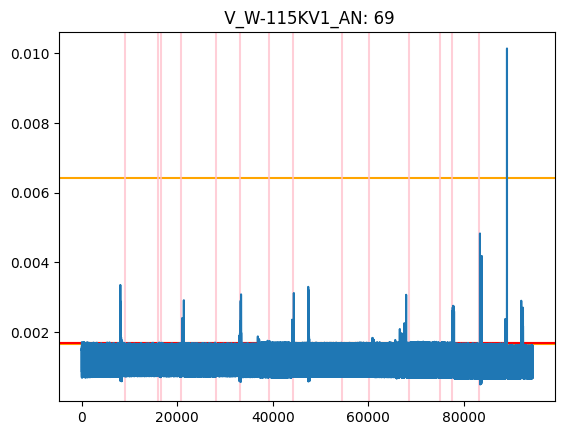

***********************************************************************************************
Sensor: 70  V_W-115KV1_BN


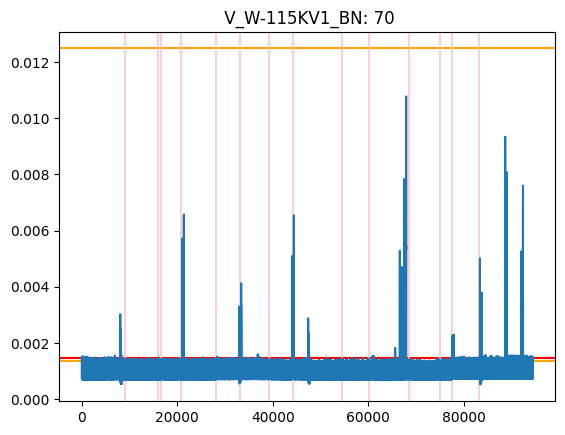

***********************************************************************************************
Sensor: 71  V_W-115KV1_CN


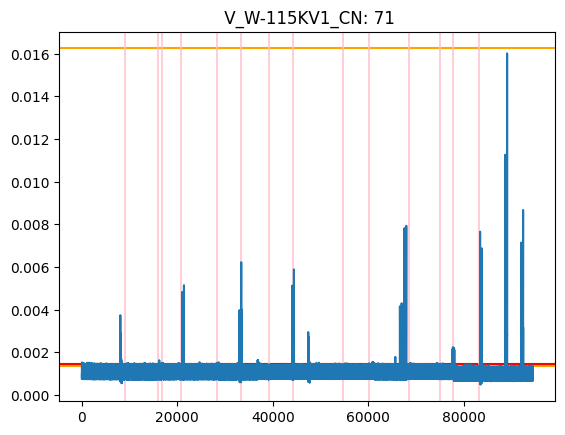

***********************************************************************************************
Sensor: 72  C_W927_W929_1_W927_A
72
DD = None
72
DD = 35
72
DD = None


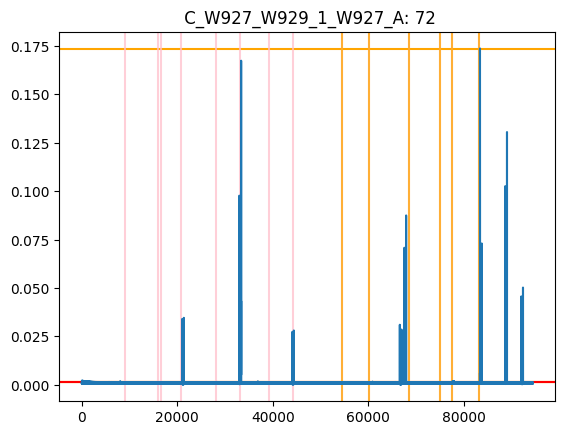

***********************************************************************************************
Sensor: 73  C_W927_W929_1_W927_B
73
DD = None
73
DD = None


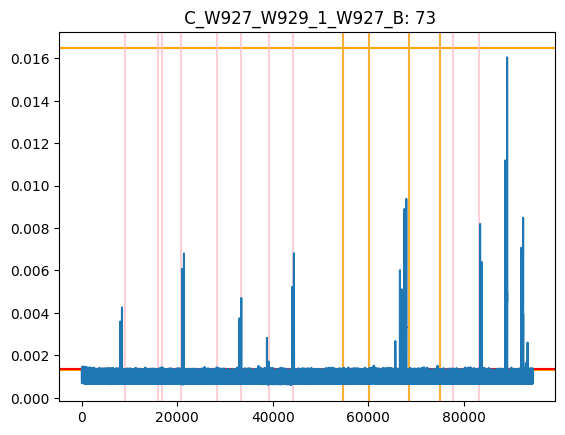

***********************************************************************************************
Sensor: 74  C_W927_W929_1_W927_C
74
DD = None
74
DD = None
74
DD = None


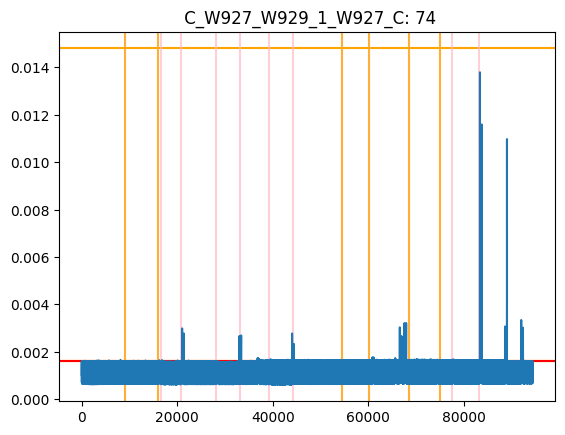

***********************************************************************************************
Sensor: 75  C_W927_W929_1_W927_N
75
DD = None
75
DD = None
75
DD = None


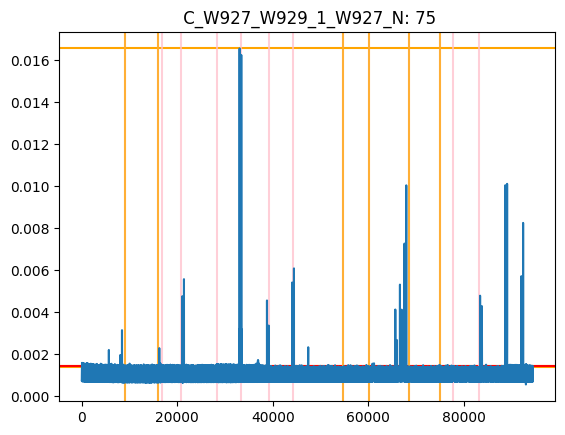

***********************************************************************************************
Sensor: 76  C_W919_W910_1_W910_A
DD = 4805
DD = None


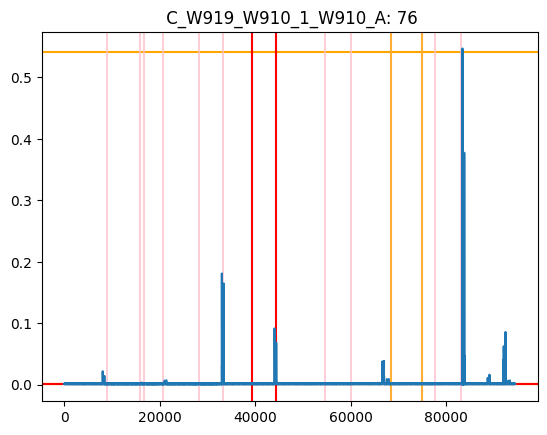

***********************************************************************************************
Sensor: 77  C_W919_W910_1_W910_B
DD = None
DD = 4814
DD = None


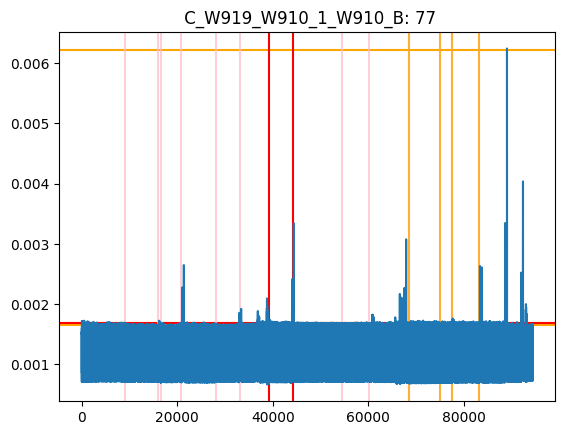

***********************************************************************************************
Sensor: 78  C_W919_W910_1_W910_C
DD = 4805
DD = None


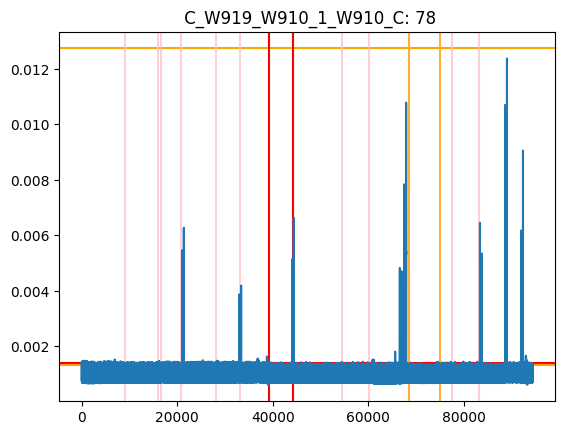

***********************************************************************************************
Sensor: 79  C_W919_W910_1_W910_N
DD = 4805
DD = None


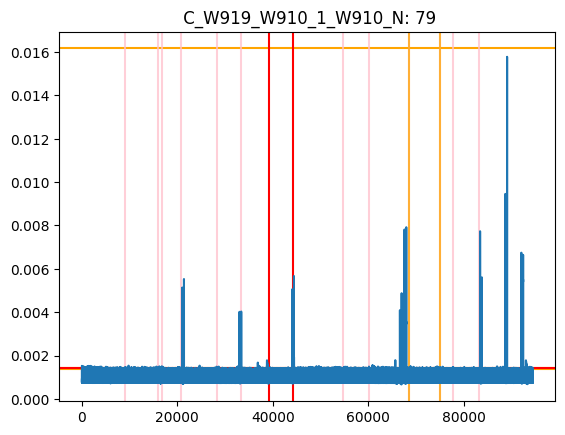

***********************************************************************************************
Sensor: 80  V_W911_AN
DD = None
DD = None


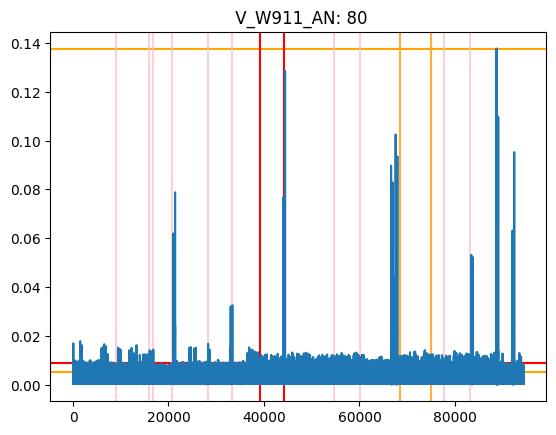

***********************************************************************************************
Sensor: 81  V_W911_BN
DD = None
DD = None


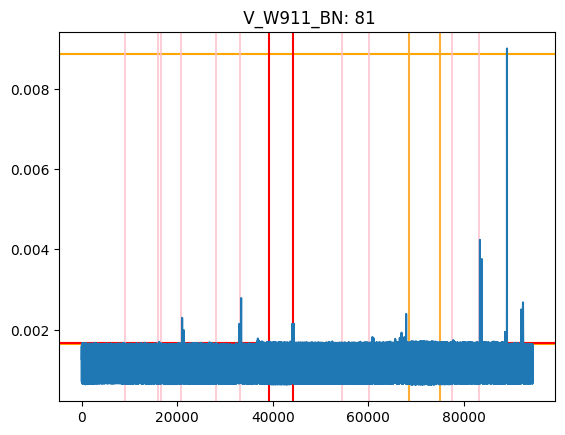

***********************************************************************************************
Sensor: 82  V_W911_CN
DD = 4805
DD = None


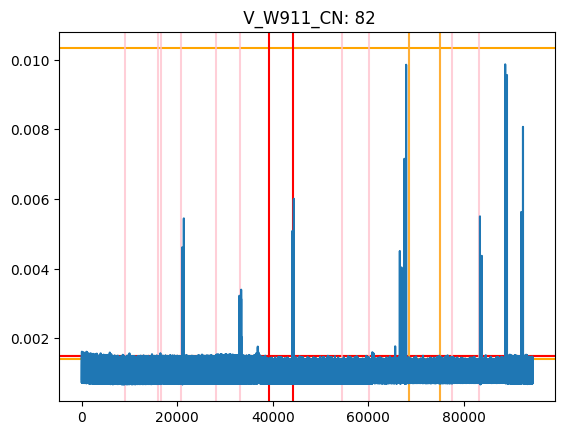

***********************************************************************************************
Sensor: 83  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_A


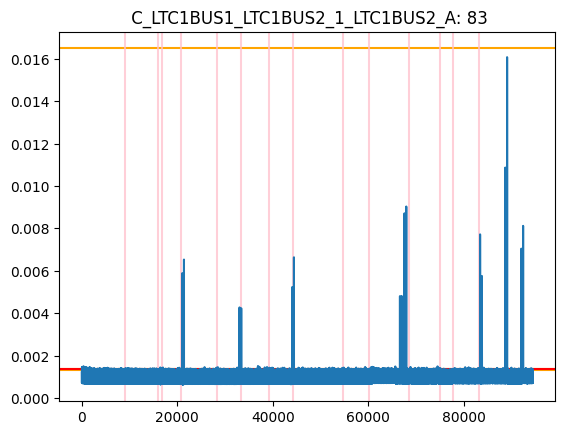

***********************************************************************************************
Sensor: 84  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_B


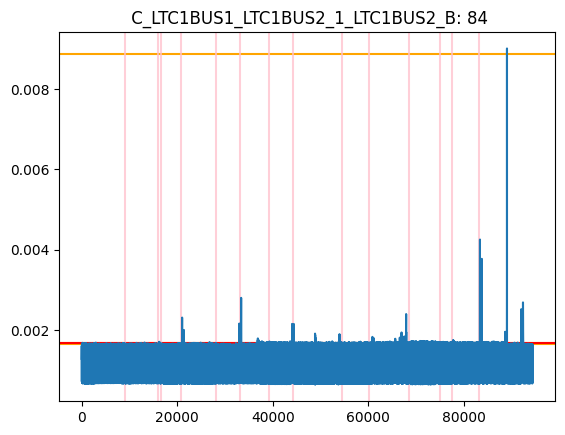

***********************************************************************************************
Sensor: 85  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_C


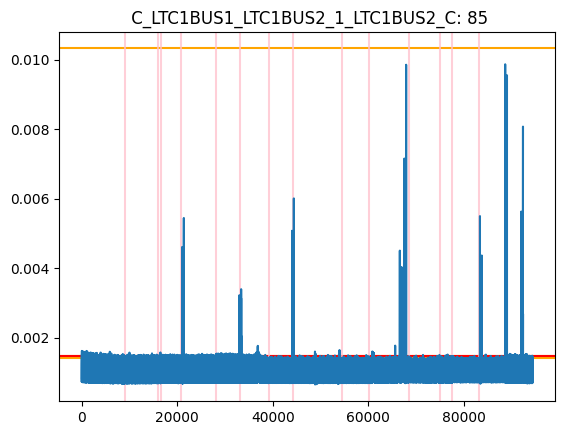

***********************************************************************************************
Sensor: 86  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_N


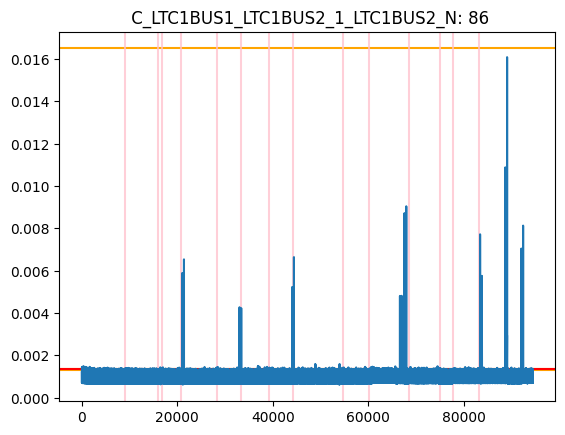

***********************************************************************************************
Sensor: 87  V_BUS13KV1_AN


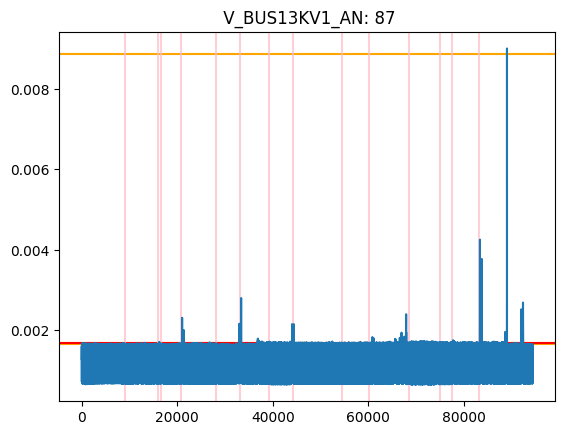

***********************************************************************************************
Sensor: 88  V_BUS13KV1_CN
DD = None
DD = 4804


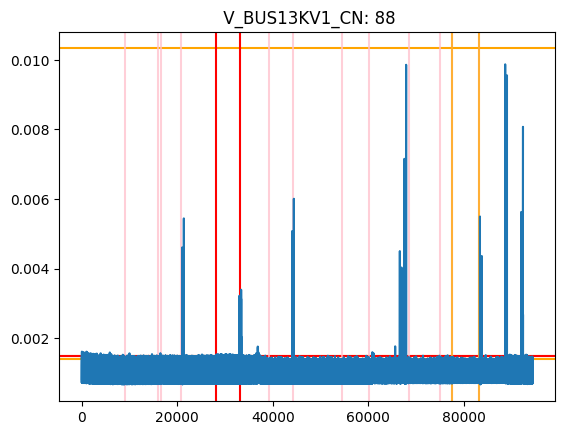

***********************************************************************************************
Sensor: 89  V_BUS13KV1_BN


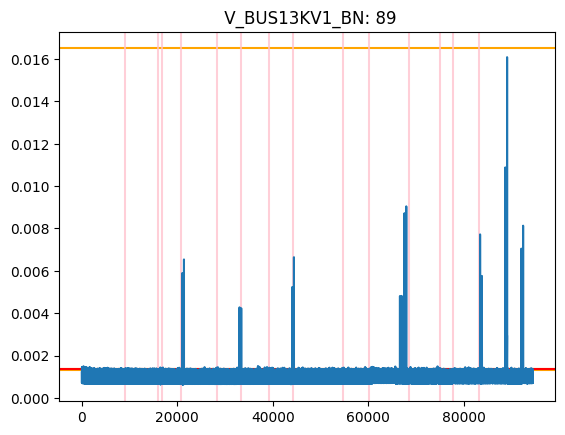

***********************************************************************************************
Sensor: 90  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_A
90
DD = None
90
DD = None


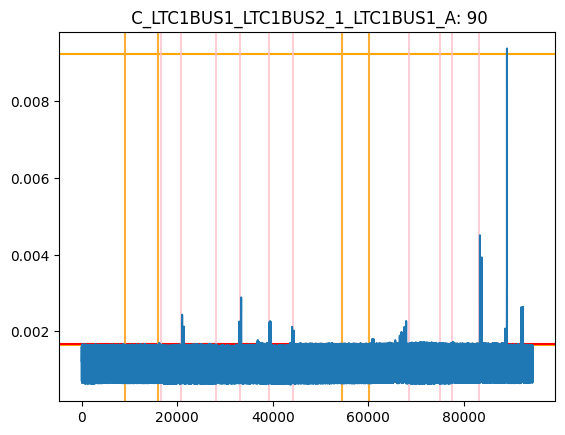

***********************************************************************************************
Sensor: 91  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_B
91
DD = None
91
DD = None


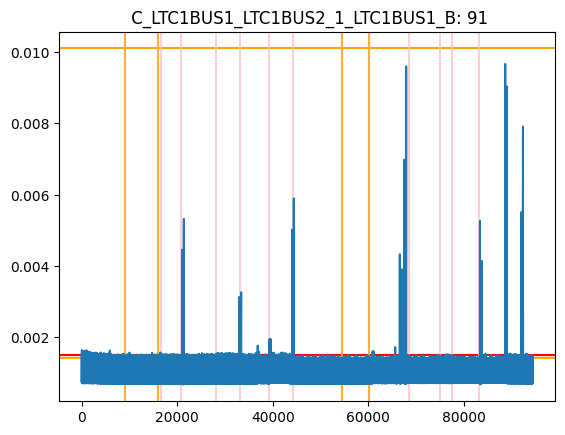

***********************************************************************************************
Sensor: 92  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_C
92
DD = None


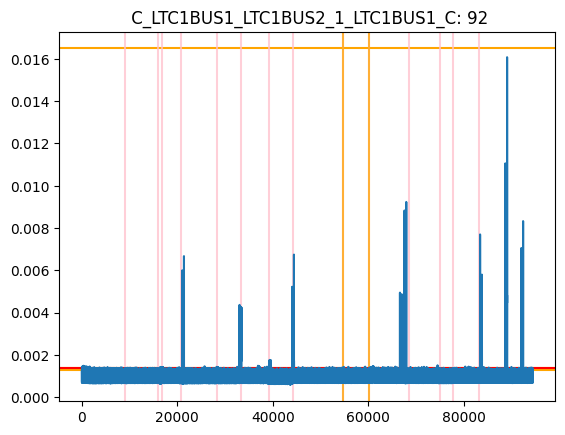

***********************************************************************************************
Sensor: 93  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_NN
93
DD = None


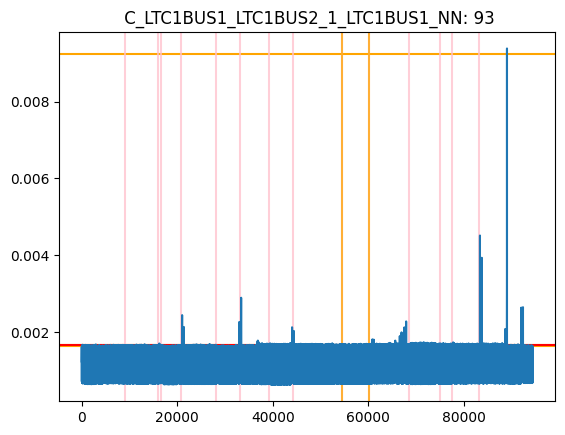

***********************************************************************************************
Sensor: 94  V_BUS13KV2_AN


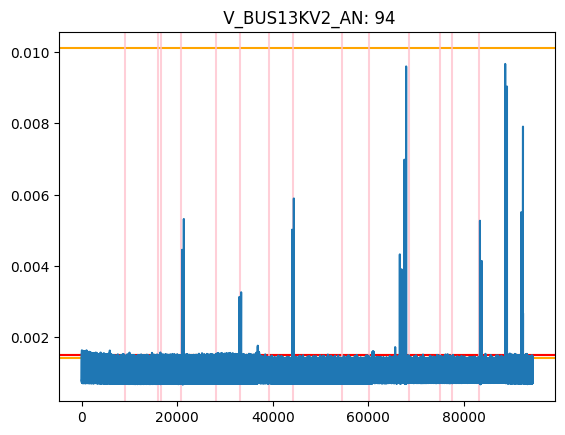

***********************************************************************************************
Sensor: 95  V_BUS13KV2_BN


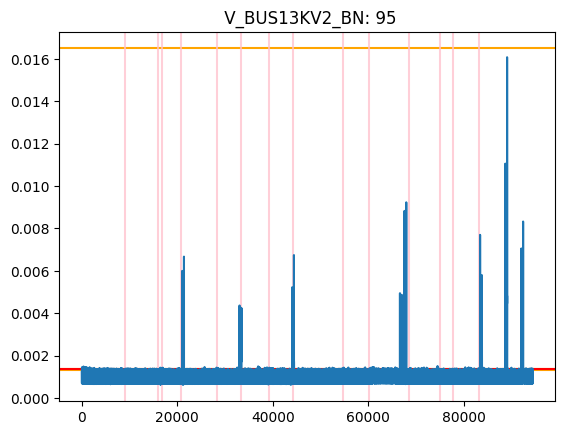

***********************************************************************************************
Sensor: 96  V_BUS13KV2_CN


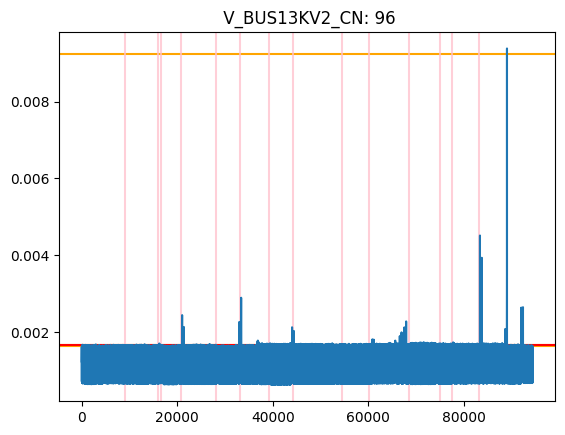

***********************************************************************************************
Sensor: 97  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_A
97
DD = None


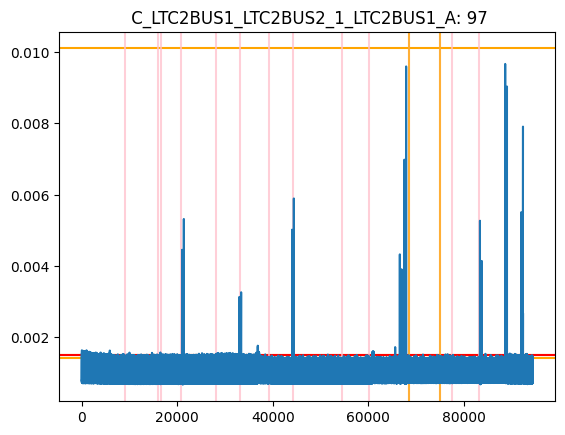

***********************************************************************************************
Sensor: 98  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_B
98
DD = None


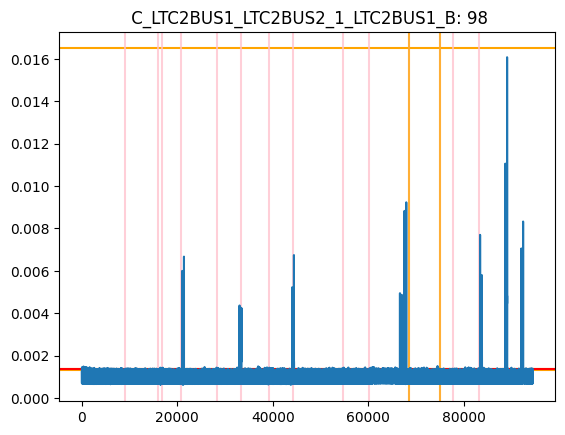

***********************************************************************************************
Sensor: 99  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_C
99
DD = None


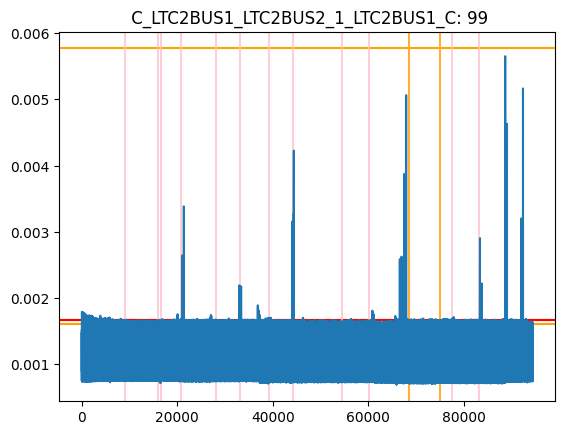

***********************************************************************************************
Sensor: 100  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_NN
100
DD = None
100
DD = None


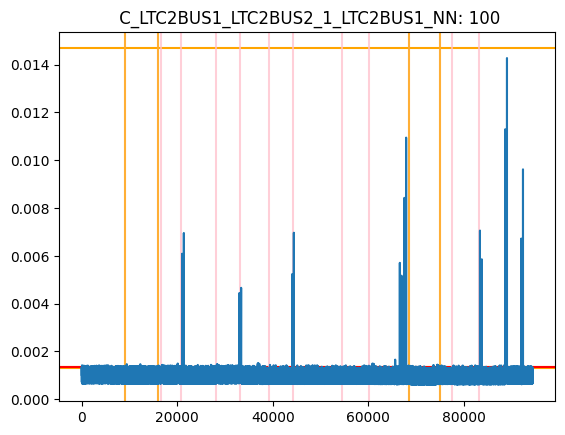

***********************************************************************************************
Sensor: 101  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_A
101
DD = None


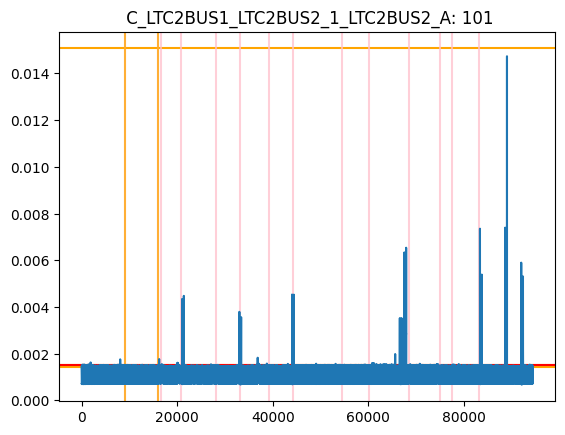

***********************************************************************************************
Sensor: 102  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_B
102
DD = None


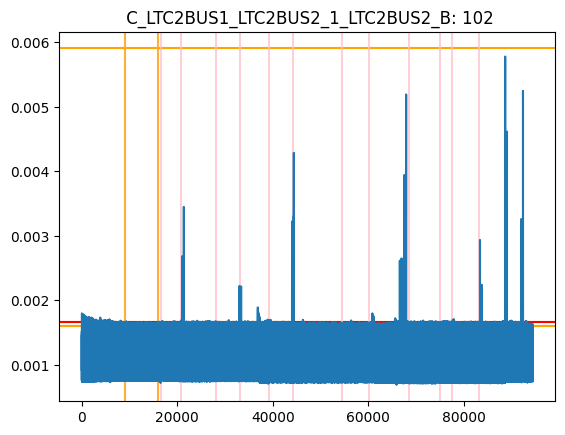

***********************************************************************************************
Sensor: 103  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_C
103
DD = None


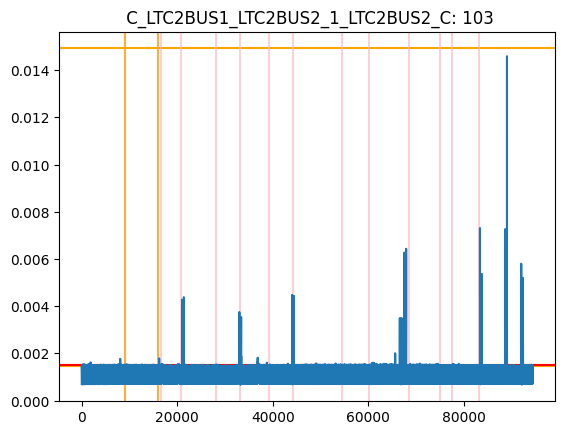

***********************************************************************************************
Sensor: 104  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_N
104
DD = None


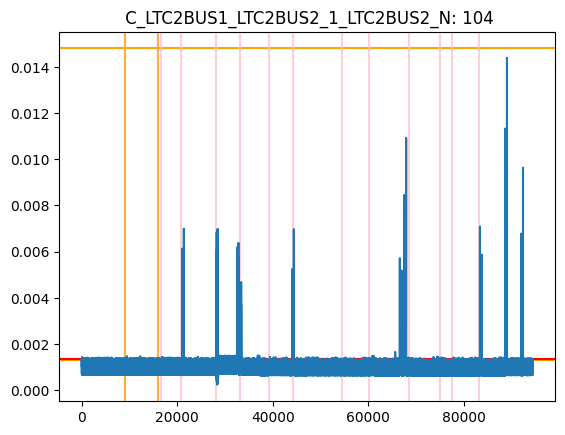

***********************************************************************************************
Sensor: 105  C_SOURCE~C_SUBC~115_1_SOURCE~C_A


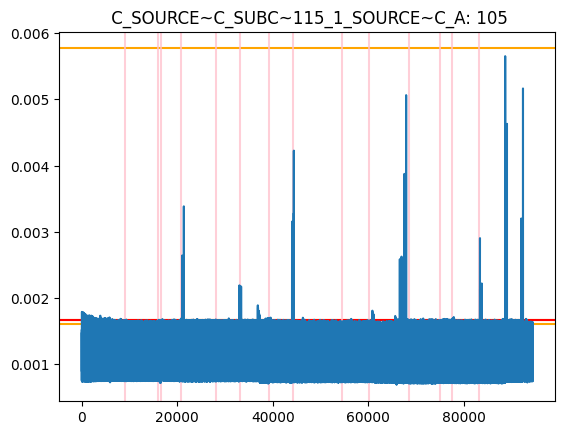

***********************************************************************************************
Sensor: 106  C_SOURCE~C_SUBC~115_1_SOURCE~C_B


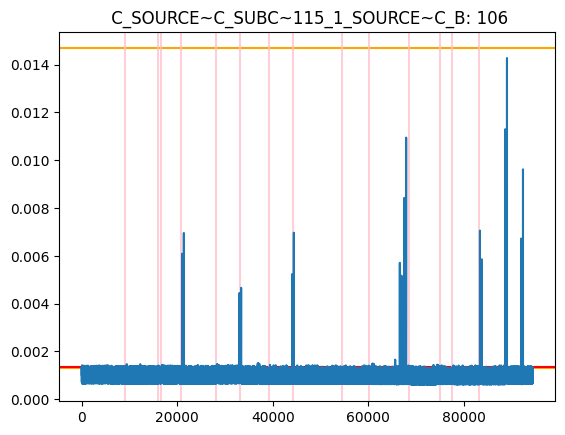

***********************************************************************************************
Sensor: 107  C_SOURCE~C_SUBC~115_1_SOURCE~C_C
107
DD = None
107
DD = 4805


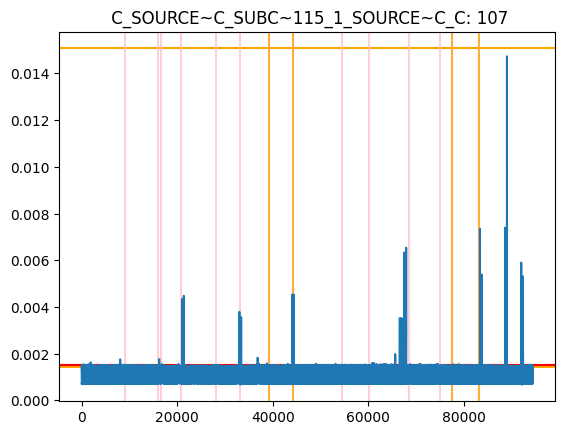

***********************************************************************************************
Sensor: 108  C_SOURCE~C_SUBC~115_1_SOURCE~C_N


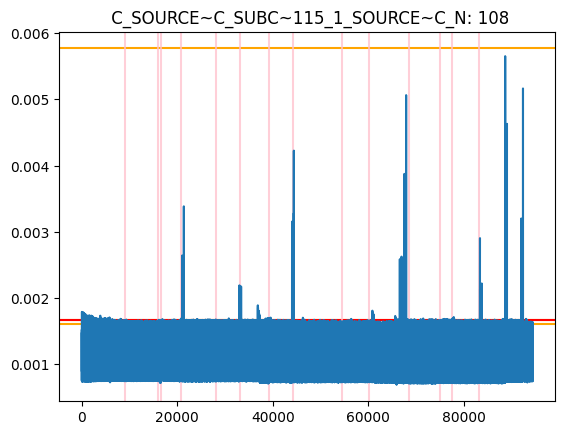

***********************************************************************************************
Sensor: 109  V_SOURCE-C_AN


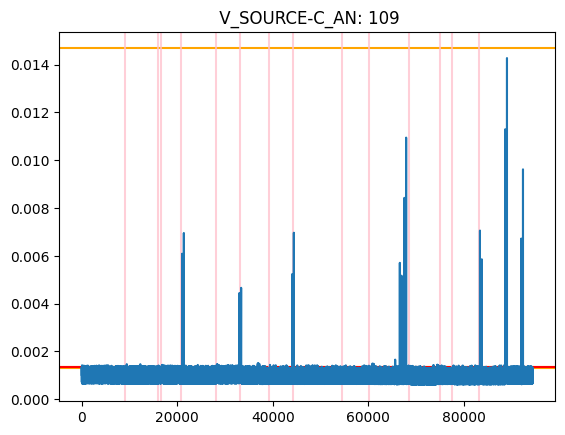

***********************************************************************************************
Sensor: 110  V_SOURCE-C_BN


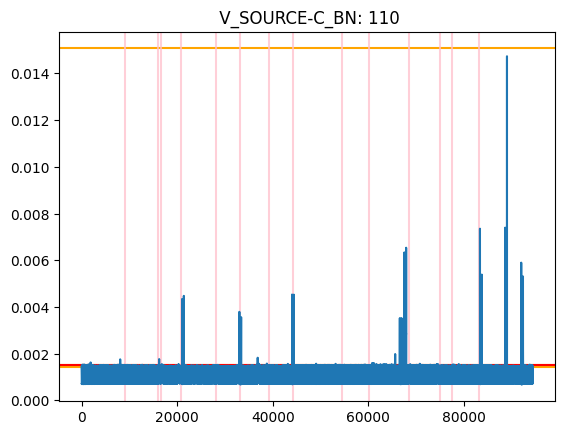

***********************************************************************************************
Sensor: 111  V_SOURCE-C_CN


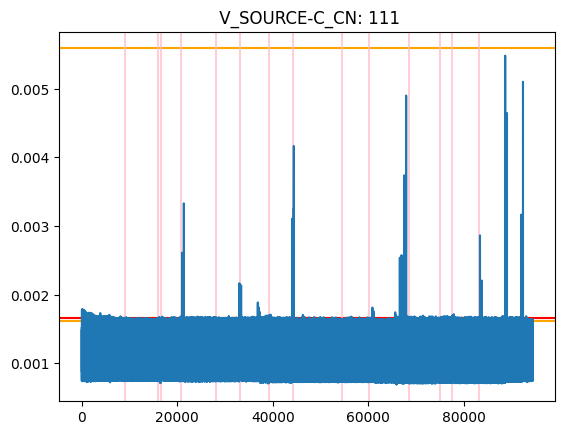

***********************************************************************************************
Sensor: 112  C_SOURCE~A_SUBA~115_1_SOURCE~A_A
112
DD = None


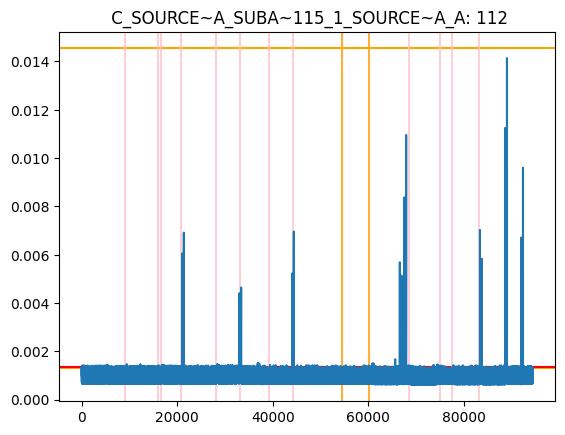

***********************************************************************************************
Sensor: 113  C_SOURCE~A_SUBA~115_1_SOURCE~A_B
113
DD = None


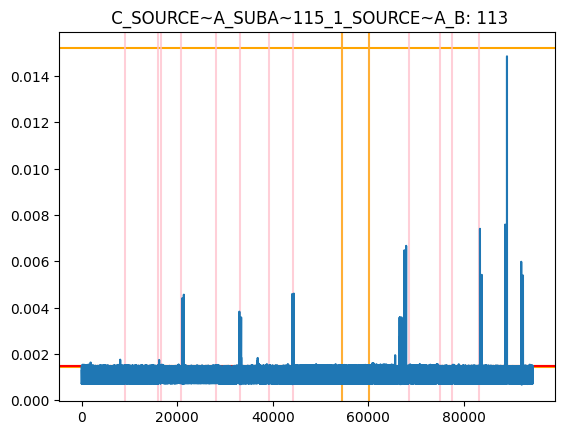

***********************************************************************************************
Sensor: 114  C_SOURCE~A_SUBA~115_1_SOURCE~A_C
114
DD = None


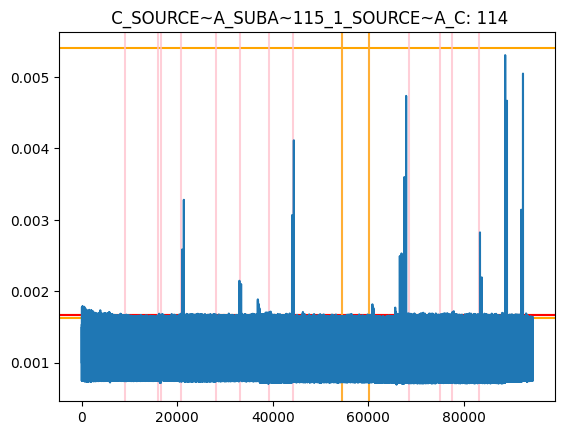

***********************************************************************************************
Sensor: 115  C_SOURCE~A_SUBA~115_1_SOURCE~A_N
115
DD = None


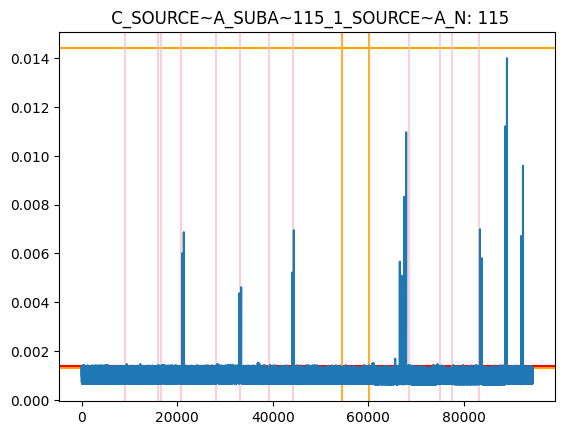

***********************************************************************************************
Sensor: 116  V_SOURCE-A_AN


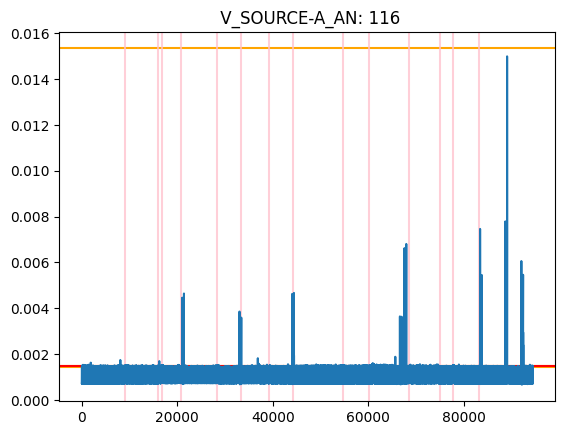

***********************************************************************************************
Sensor: 117  V_SOURCE-A_BN


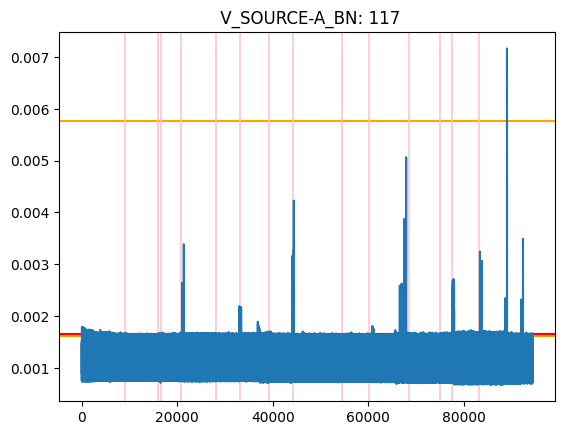

***********************************************************************************************
Sensor: 118  V_SOURCE-A_CN


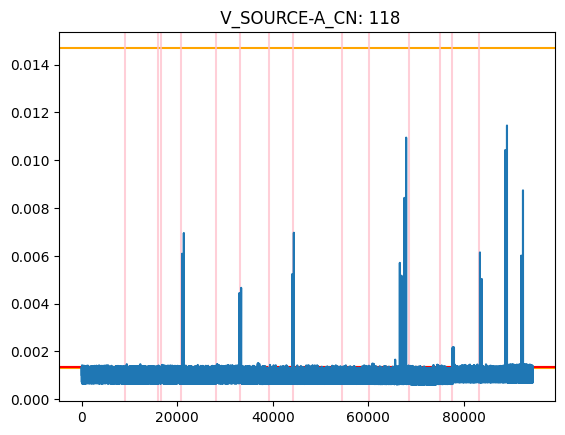

***********************************************************************************************
Sensor: 119  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A
119
DD = None


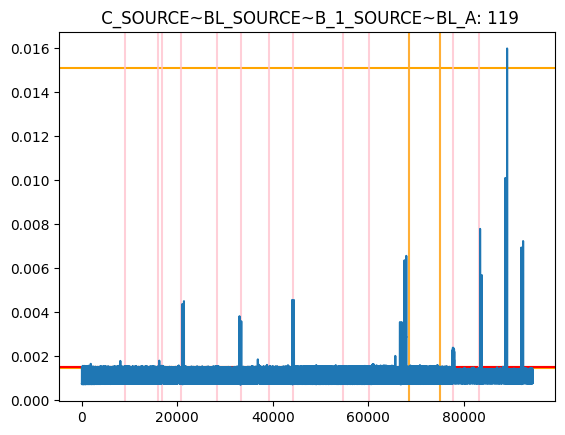

***********************************************************************************************
Sensor: 120  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B
120
DD = None


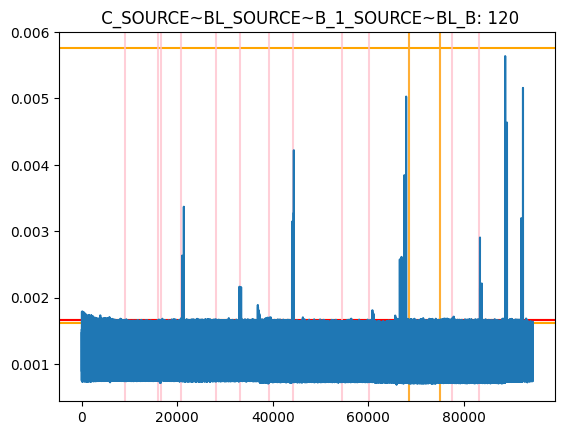

***********************************************************************************************
Sensor: 121  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C
121
DD = None


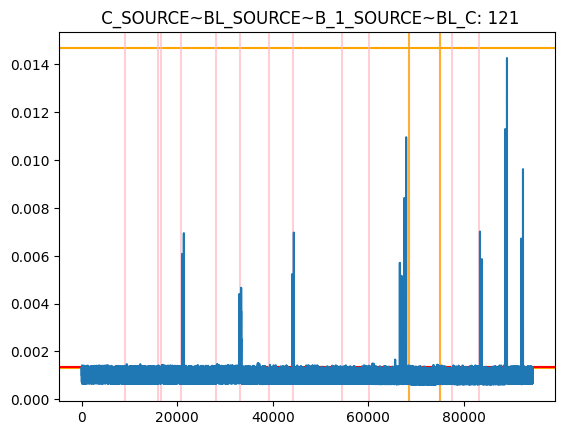

***********************************************************************************************
Sensor: 122  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N
122
DD = None


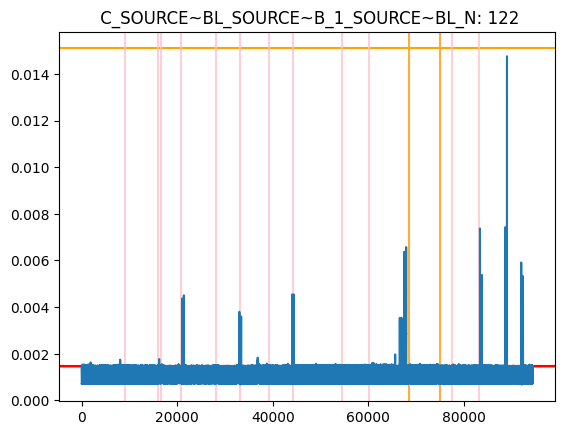

***********************************************************************************************
Sensor: 123  V_SOURCE-BL_AN


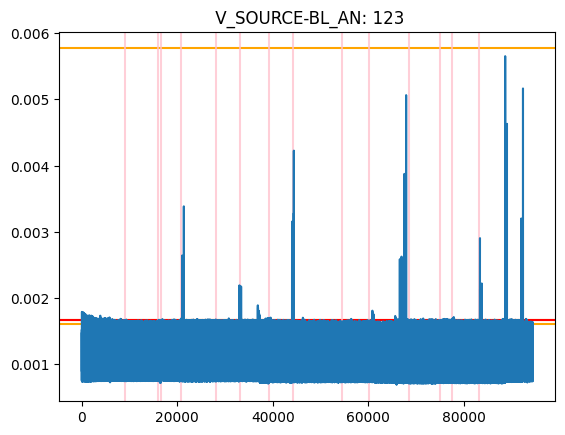

***********************************************************************************************
Sensor: 124  V_SOURCE-BL_BN


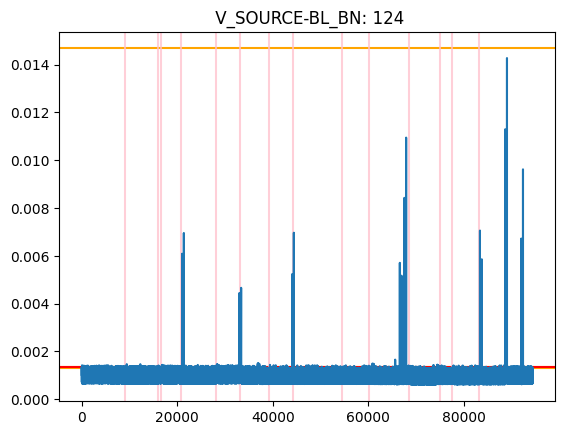

***********************************************************************************************
Sensor: 125  V_SOURCE-BL_CN


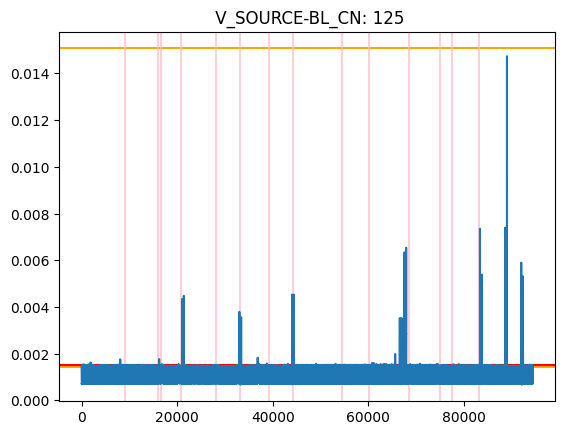

[None, None, None, 4804, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 4, 4804, None, None, None, None, None, None, 4806, None, None, None, None, None, None, None, 4807, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 4, None, None, None, None, None, None, 4805, 6, None, None, 35, None, None, None, None, None, None, None, None, None, 4805, None, None, 4814, None, 4805, None, 4805, None, None, None, None, None, 4805, None, None, 4804, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 4805, None, None, None, None, None, None, None, None]


In [33]:
LD_corr = []
at_neighbor = {}

rsum_list = rsum_list_corr
threshold = thresholds_corr_99
t_list = t_corr
persistency = 5

for index, i in enumerate(rsum_list):
    print("***********************************************************************************************")
    attack_in = (i > threshold[index]).nonzero()

    violations = (rsum_list > threshold.reshape(-1, 1))

    print(f"Sensor: {things[index]} {cols[things[index]-1]}")
    at_neighbor[things[index]] = attack_in
    plt.title(f"{cols[things[index]-1]}: {things[index]}")

    for t in t_list:
        plt.axhline(t[index], color='orange')

    plt.axhline(threshold[index], color='red')

    if things[index] in attack_dict:
        #if sensor is being attacked

        # ground truth
        attack_indices = df_test.index[
            (df_test['Time'] >= attack_dict[things[index]][0] * 1e6) &
            (df_test['Time'] <= attack_dict[things[index]][1] * 1e6)] - 1201

        for start, end in all_attack_indices:

            # if this is the attack time of the sensor, plot solid red lines
            if attack_indices[0] == start:
                DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                LD_corr.append(DD)
                print(f"DD = {DD}")
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='red')
                plt.axvline(end_w, color='red')

            # otherwise, plot pink lines
            else:
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='pink', alpha=0.75)
                plt.axvline(end_w, color='pink', alpha=0.75)

                start_w = start-window-w
                end_w = end+window+w-1
                for starts, ate in attack_i.items():
                  if starts == start and things[index] in ate:
                    DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                    LD_corr.append(DD)
                    print(f"DD = {DD}")
                    plt.axvline(start_w, color='orange', alpha=0.75)
                    plt.axvline(end_w, color='orange', alpha=0.75)

    else:
         for start, end in all_attack_indices:
            start_w = start-window-w
            end_w = end+window+w-1
            plt.axvline(start_w, color='pink', alpha=0.75)
            plt.axvline(end_w, color='pink', alpha=0.75)
            for starts, ate in attack_i.items():
              if starts == start:
                if things[index] in ate:
                  print(things[index])
                  DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                  LD_corr.append(DD)
                  print(f"DD = {DD}")
                  plt.axvline(start_w, color='orange', alpha=0.75)
                  plt.axvline(end_w, color='orange', alpha=0.75)

    plt.plot(i)
    plt.show()

print(LD_corr)

***********************************************************************************************
Sensor: 1  C_W738_W737_2_W737_A


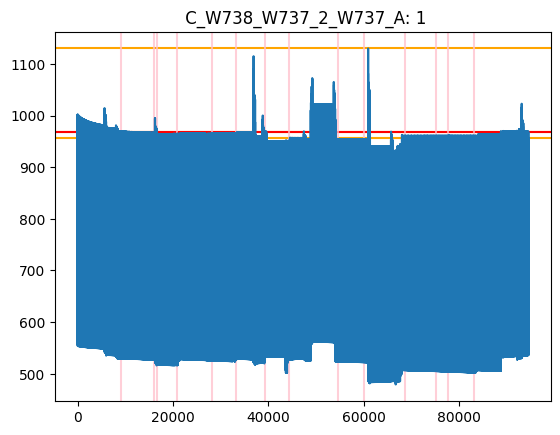

***********************************************************************************************
Sensor: 2  C_W738_W737_2_W737_B


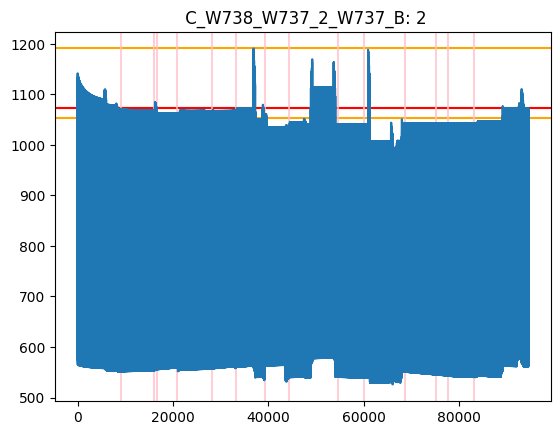

***********************************************************************************************
Sensor: 3  C_W738_W737_2_W737_C


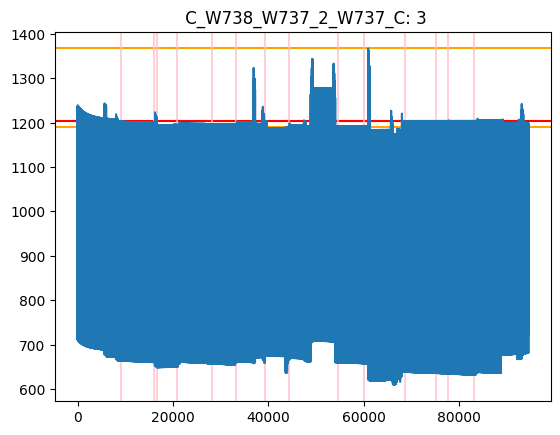

***********************************************************************************************
Sensor: 4  C_W738_W737_2_W737_N


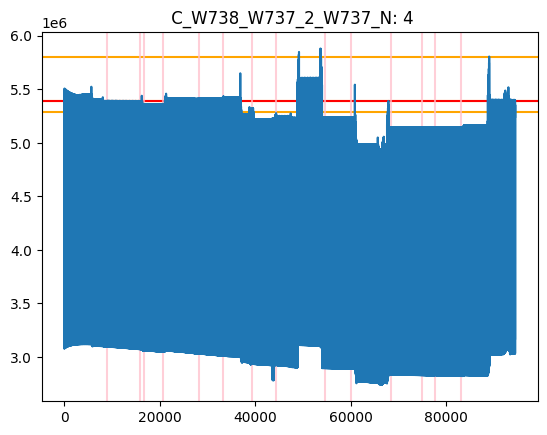

***********************************************************************************************
Sensor: 5  V_W738_AN


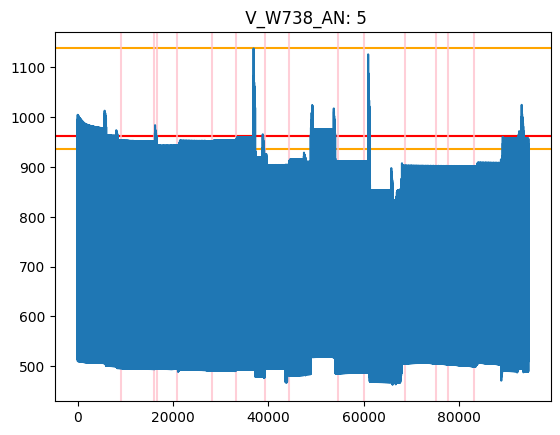

***********************************************************************************************
Sensor: 6  V_W738_BN


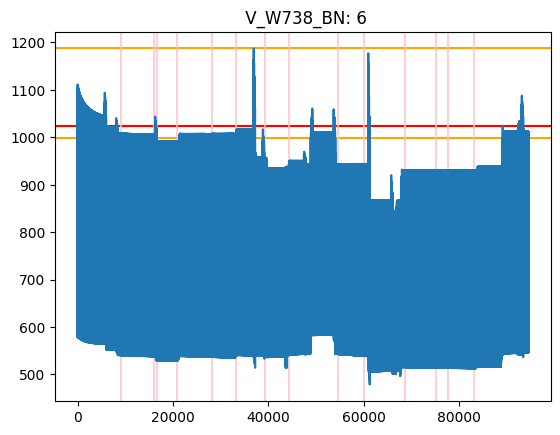

***********************************************************************************************
Sensor: 7  V_W738_CN


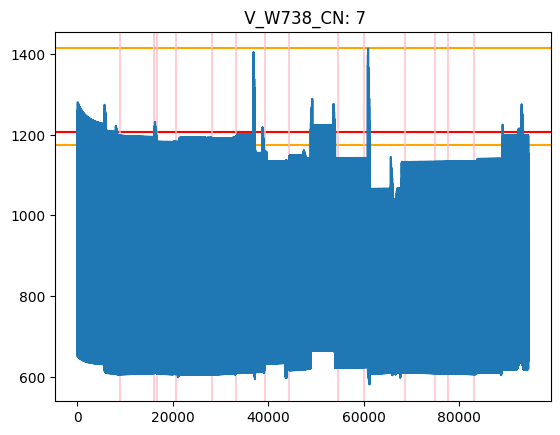

***********************************************************************************************
Sensor: 8  C_W747_W748_2_W747_A
8
DD = None


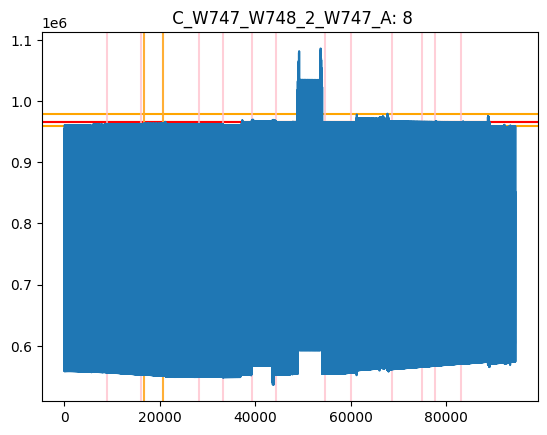

***********************************************************************************************
Sensor: 9  C_W747_W748_2_W747_B
9
DD = None


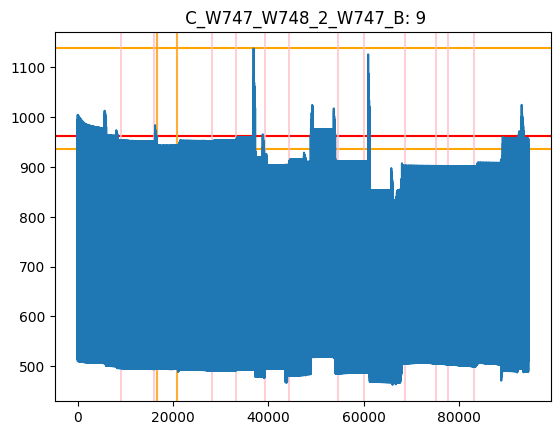

***********************************************************************************************
Sensor: 10  C_W747_W748_2_W747_C
10
DD = None
10
DD = None


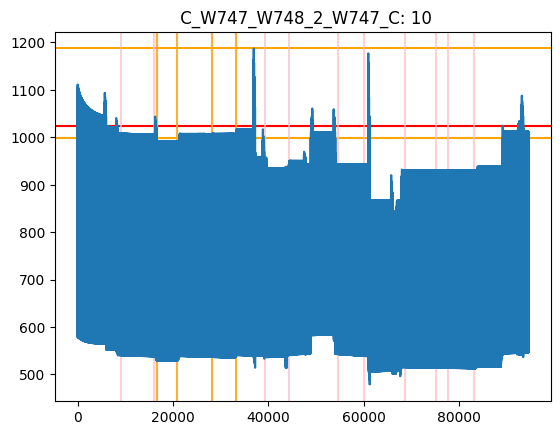

***********************************************************************************************
Sensor: 11  C_W747_W748_2_W747_N
11
DD = None


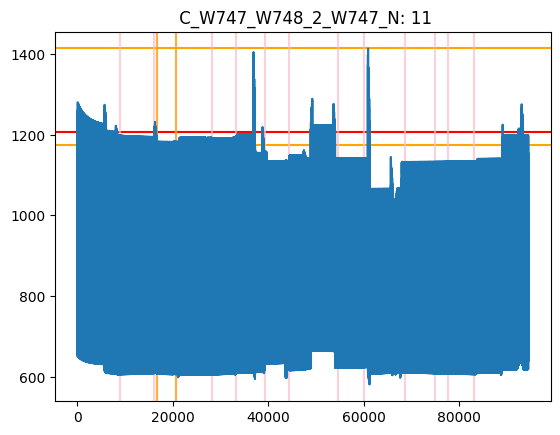

***********************************************************************************************
Sensor: 12  V_W748_AN


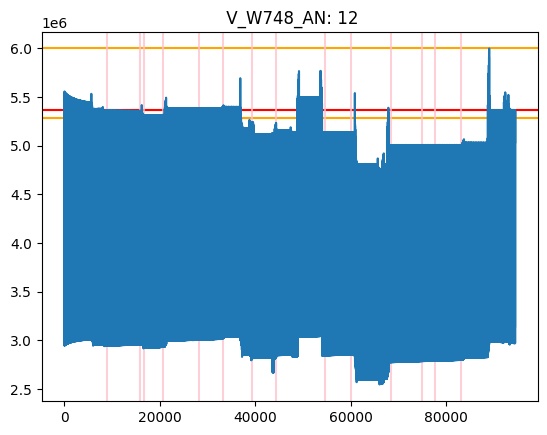

***********************************************************************************************
Sensor: 13  V_W748_BN


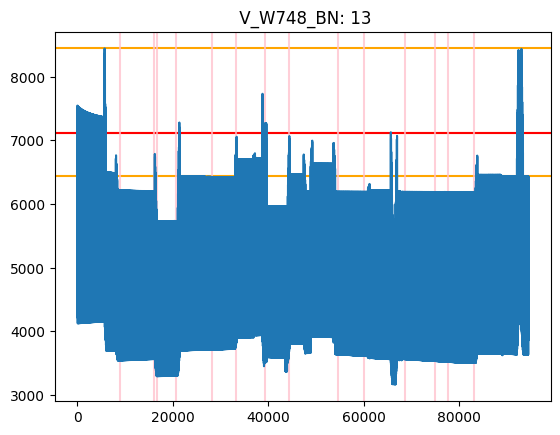

***********************************************************************************************
Sensor: 14  V_W748_CN


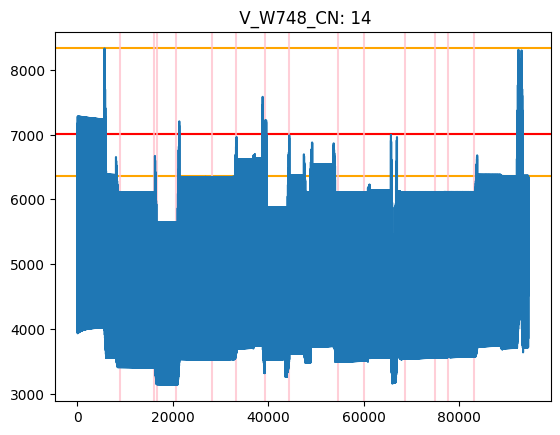

***********************************************************************************************
Sensor: 15  C_W787_W788_2_W787_A
DD = None
DD = None


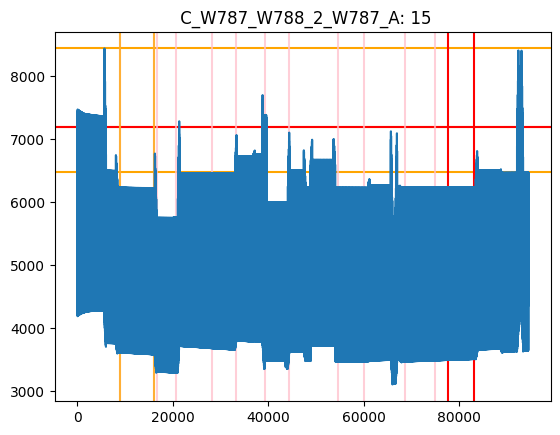

***********************************************************************************************
Sensor: 16  C_W787_W788_2_W787_B
DD = None
DD = None


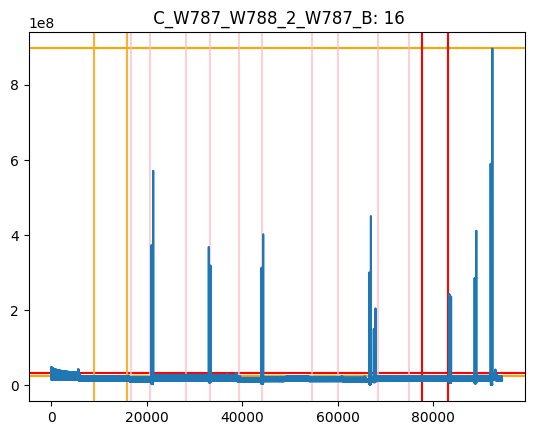

***********************************************************************************************
Sensor: 17  C_W787_W788_2_W787_C
DD = None
DD = None


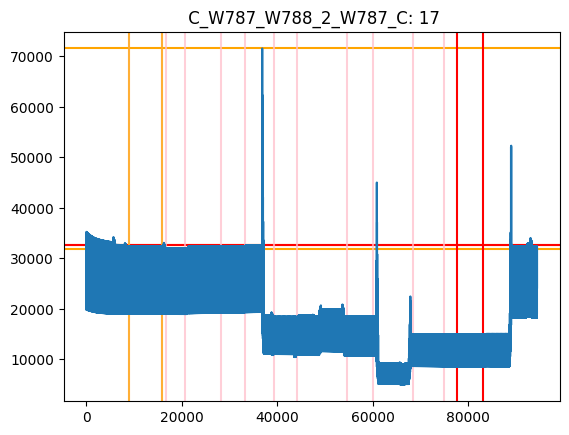

***********************************************************************************************
Sensor: 18  C_W787_W788_2_W787_N
DD = None
DD = None


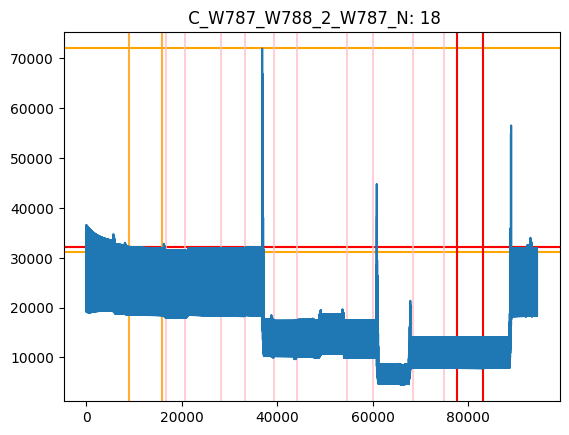

***********************************************************************************************
Sensor: 19  V_W788_AN
DD = None
DD = None


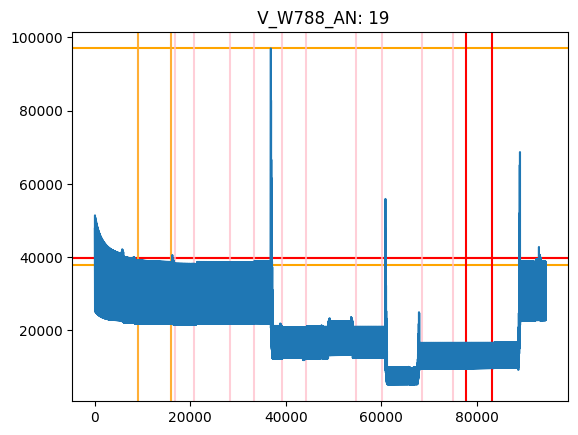

***********************************************************************************************
Sensor: 20  V_W788_BN
DD = None
DD = None


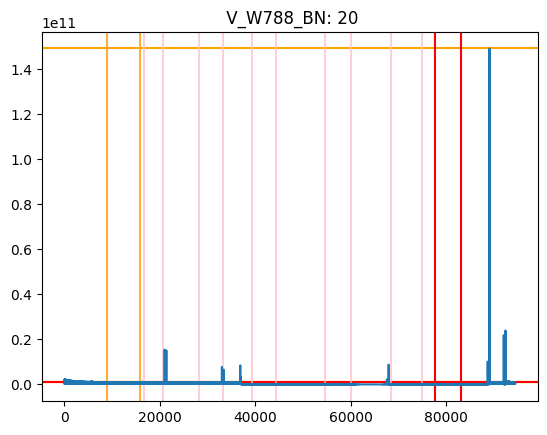

***********************************************************************************************
Sensor: 21  V_W788_CN
DD = None
DD = None


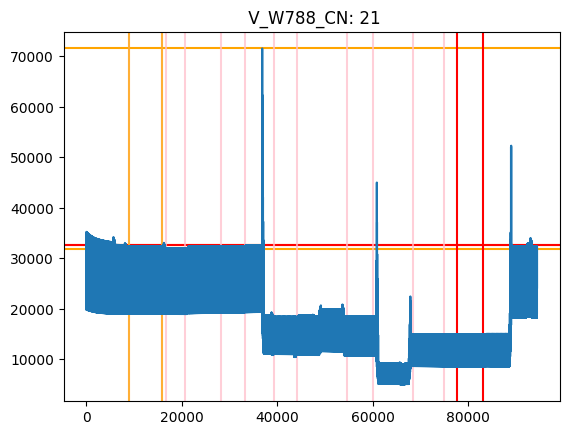

***********************************************************************************************
Sensor: 22  C_W797_W798_2_W797_A


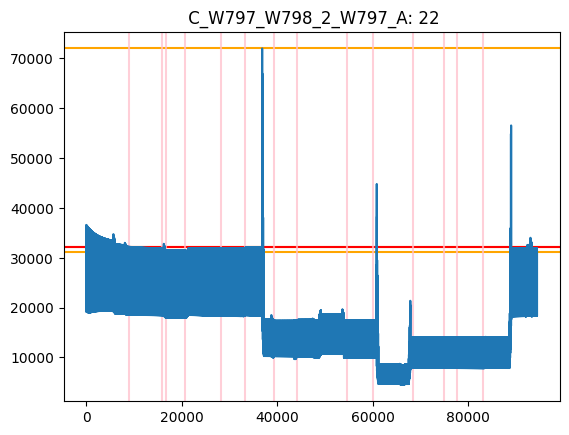

***********************************************************************************************
Sensor: 23  C_W797_W798_2_W797_B


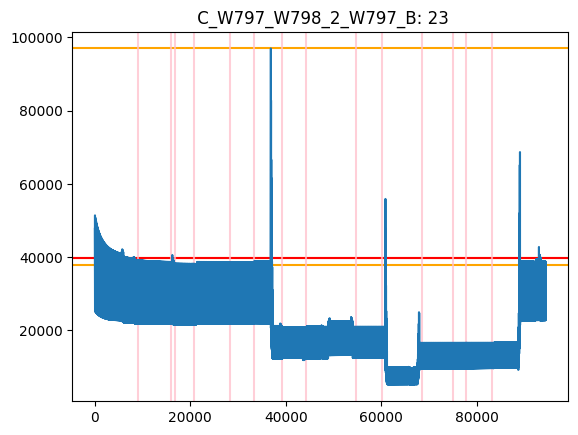

***********************************************************************************************
Sensor: 24  C_W797_W798_2_W797_C


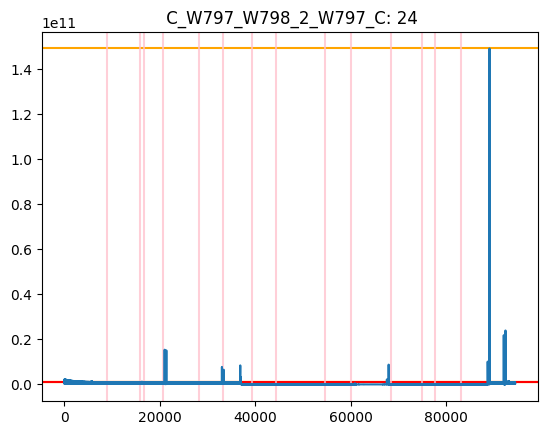

***********************************************************************************************
Sensor: 25  C_W797_W798_2_W797_N


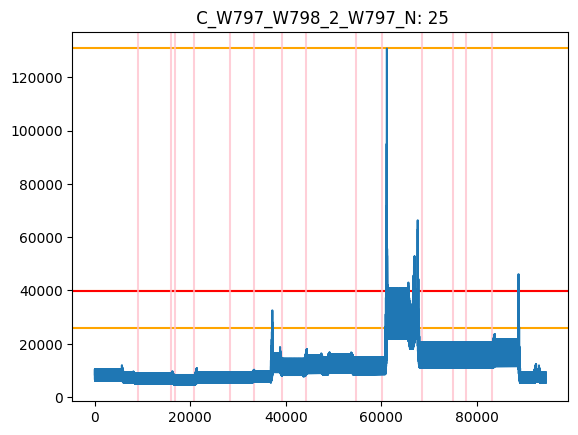

***********************************************************************************************
Sensor: 26  V_W798_AN


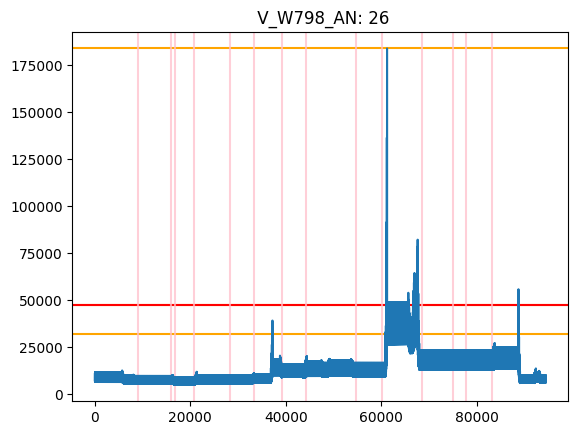

***********************************************************************************************
Sensor: 27  V_W798_BN


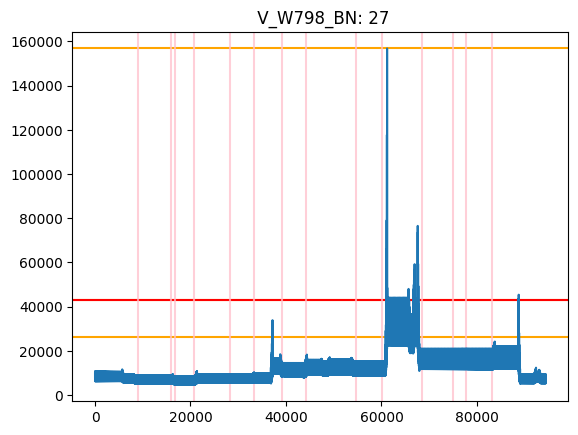

***********************************************************************************************
Sensor: 28  V_W798_CN


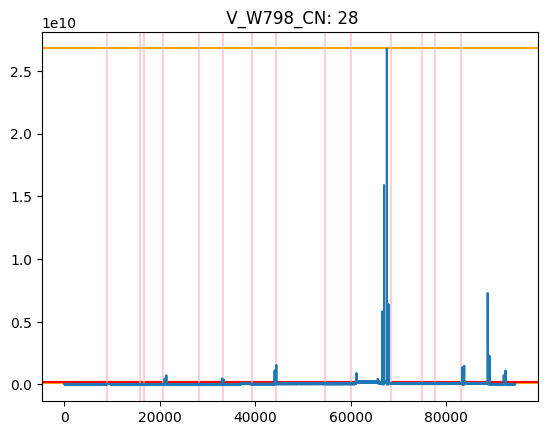

***********************************************************************************************
Sensor: 29  C_FD2B2_FD2B1_1_FD2B1_A
DD = None
DD = None


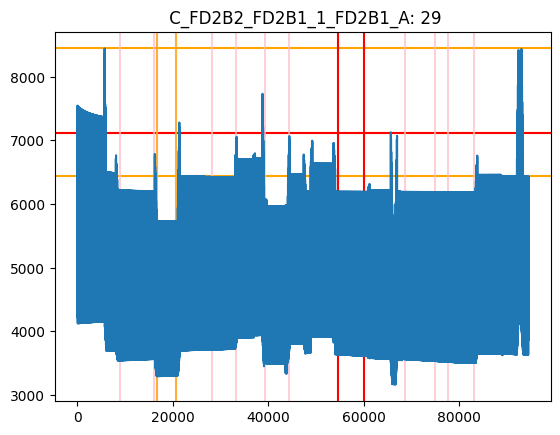

***********************************************************************************************
Sensor: 30  C_FD2B2_FD2B1_1_FD2B1_B
DD = None
DD = None


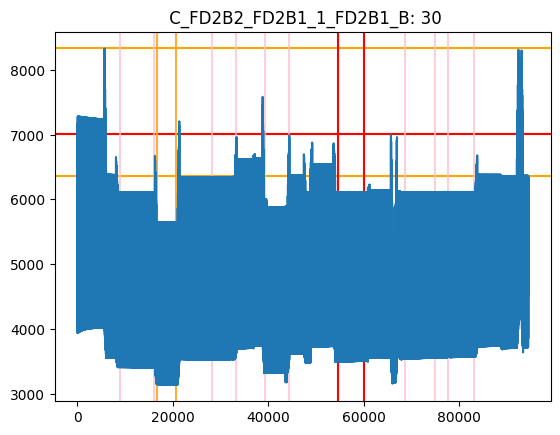

***********************************************************************************************
Sensor: 31  C_FD2B2_FD2B1_1_FD2B1_C
DD = None
DD = 3374
DD = None


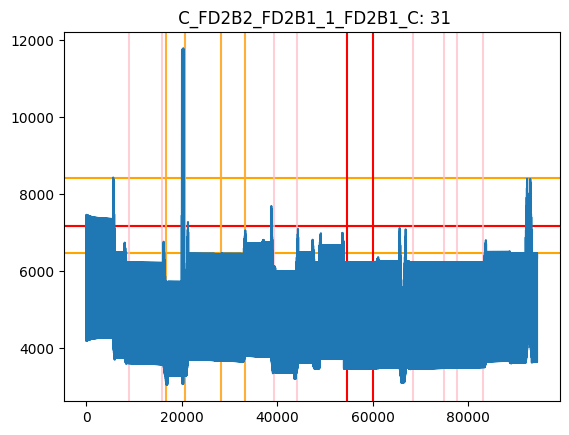

***********************************************************************************************
Sensor: 32  C_FD2B2_FD2B1_1_FD2B1_N
DD = None
DD = None


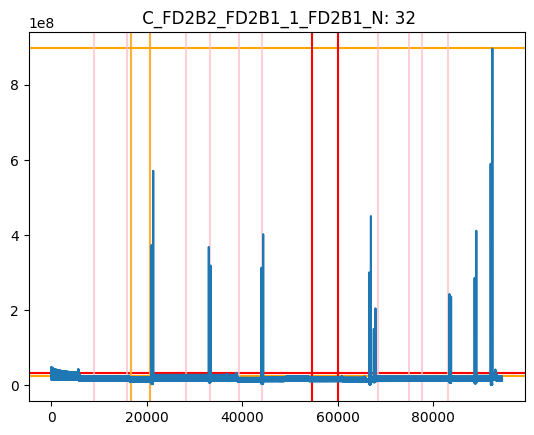

***********************************************************************************************
Sensor: 33  V_FD2B1_AN


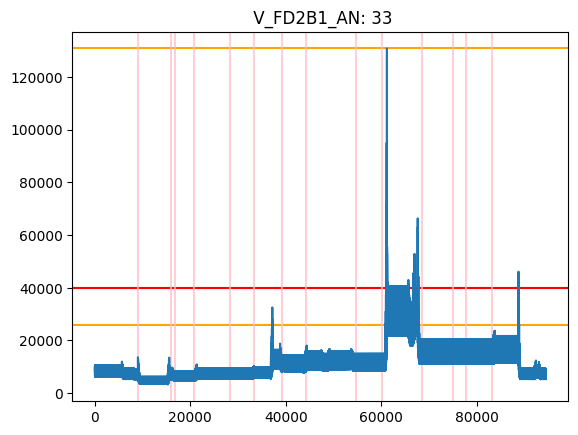

***********************************************************************************************
Sensor: 34  V_FD2B1_BN


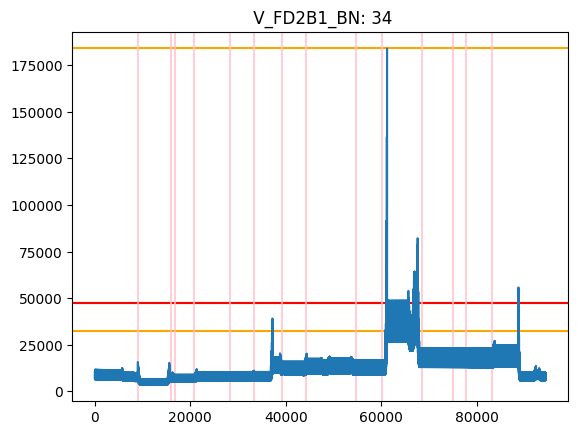

***********************************************************************************************
Sensor: 35  V_FD2B1_CN


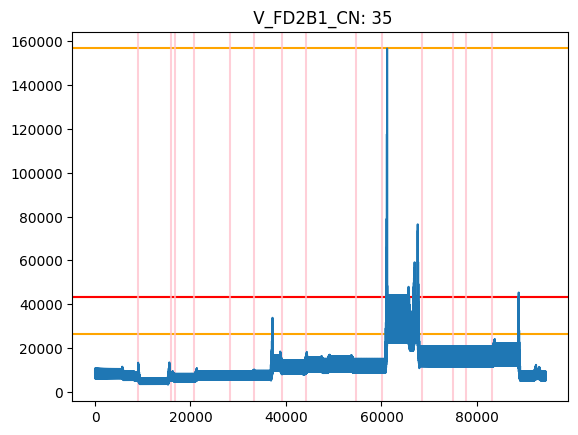

***********************************************************************************************
Sensor: 36  C_FD2B5_FD2B6_1_FD2B5_A
36
DD = None


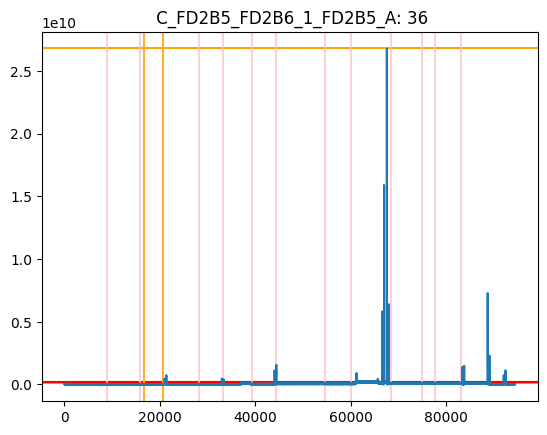

***********************************************************************************************
Sensor: 37  C_FD2B5_FD2B6_1_FD2B5_B
37
DD = None


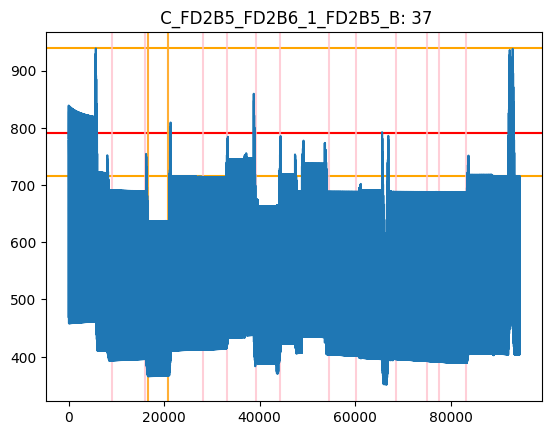

***********************************************************************************************
Sensor: 38  C_FD2B5_FD2B6_1_FD2B5_C
DD = None
DD = None
DD = None


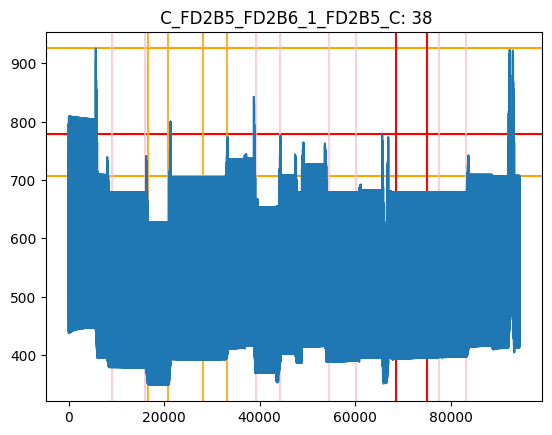

***********************************************************************************************
Sensor: 39  C_FD2B5_FD2B6_1_FD2B5_N
39
DD = None


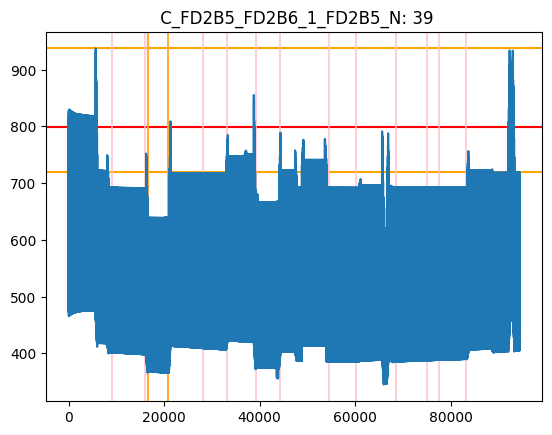

***********************************************************************************************
Sensor: 40  V_FD2B5_AN


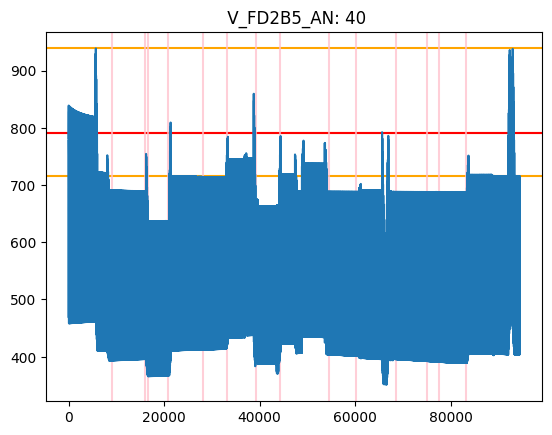

***********************************************************************************************
Sensor: 41  V_FD2B5_BN


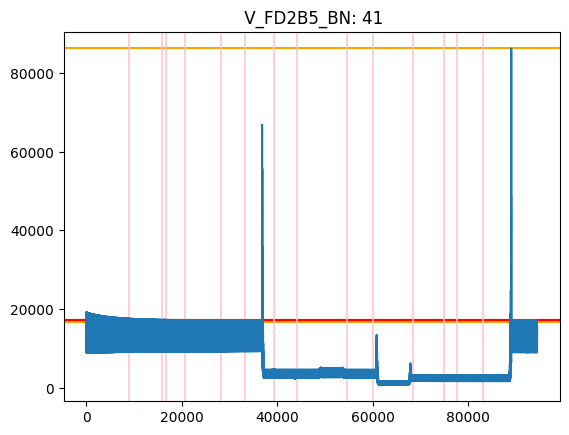

***********************************************************************************************
Sensor: 42  V_FD2B5_CN


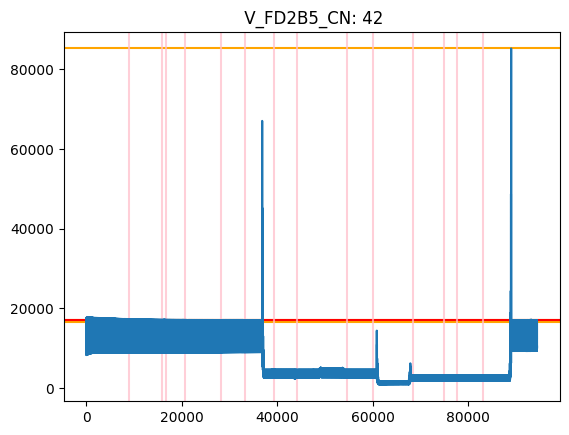

***********************************************************************************************
Sensor: 43  C_FD3B4_FD3B5_1_FD3B4_A
43
DD = None


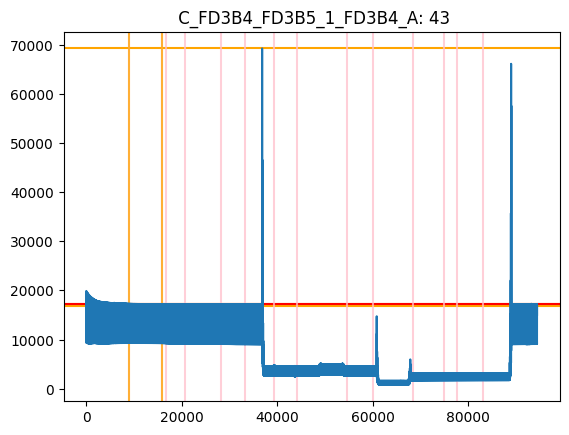

***********************************************************************************************
Sensor: 44  C_FD3B4_FD3B5_1_FD3B4_B
44
DD = None


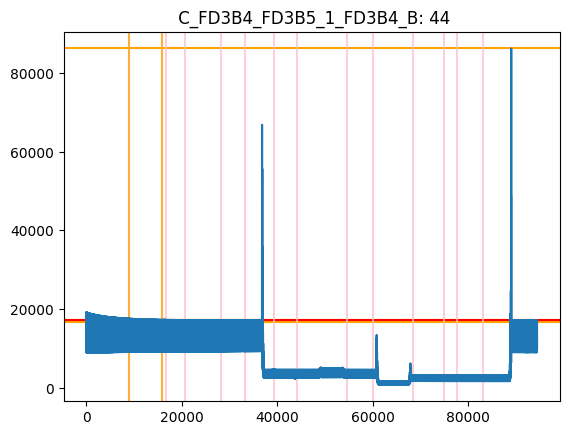

***********************************************************************************************
Sensor: 45  C_FD3B4_FD3B5_1_FD3B4_C
45
DD = None


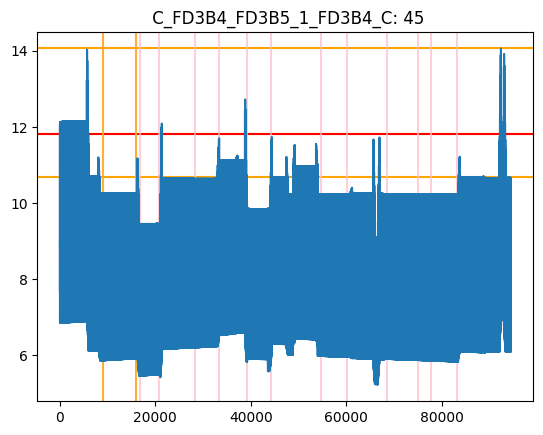

***********************************************************************************************
Sensor: 46  C_FD3B4_FD3B5_1_FD3B4_N
46
DD = None


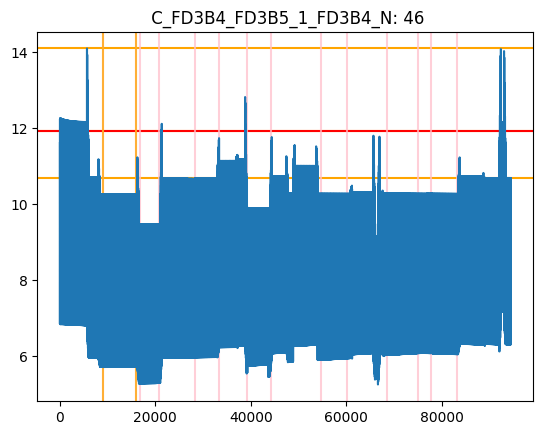

***********************************************************************************************
Sensor: 47  V_FD3B4_AN


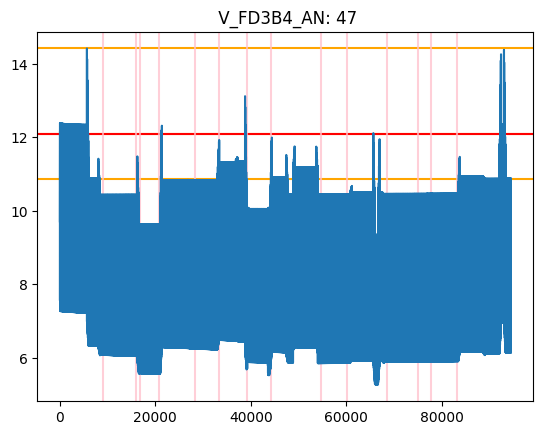

***********************************************************************************************
Sensor: 48  V_FD3B4_BN


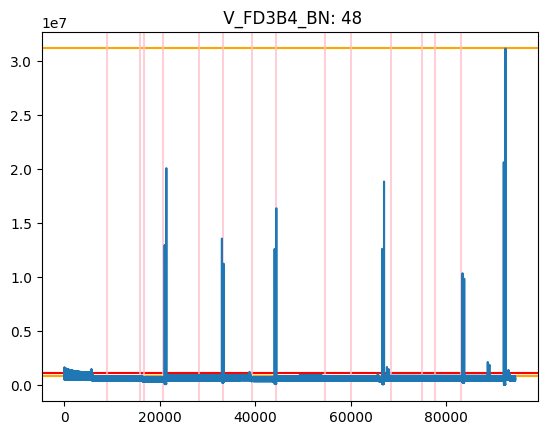

***********************************************************************************************
Sensor: 49  V_FD3B4_CN


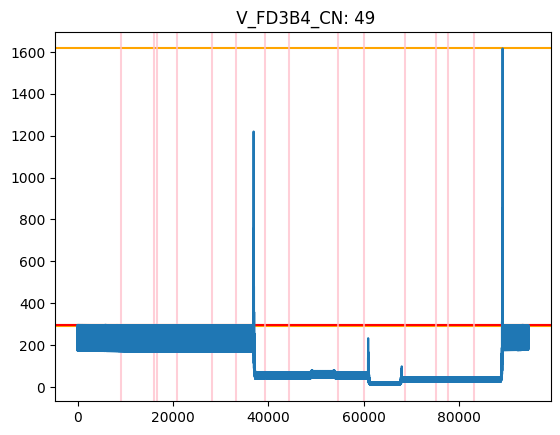

***********************************************************************************************
Sensor: 50  C_W919_W910_1_W919_A
50
DD = None


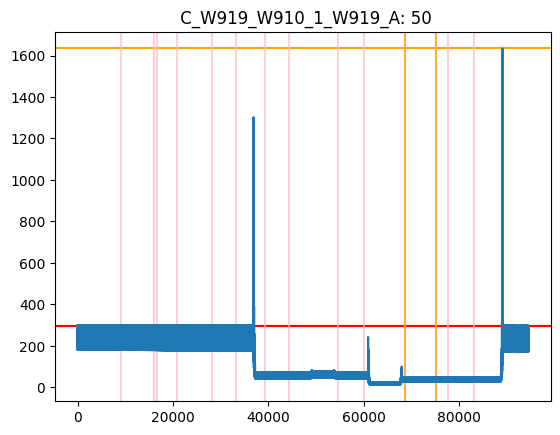

***********************************************************************************************
Sensor: 51  C_W919_W910_1_W919_B
51
DD = None


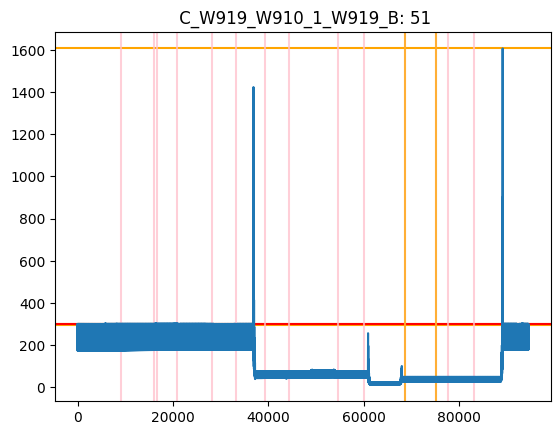

***********************************************************************************************
Sensor: 52  C_W919_W910_1_W919_C
DD = None
DD = None
DD = None


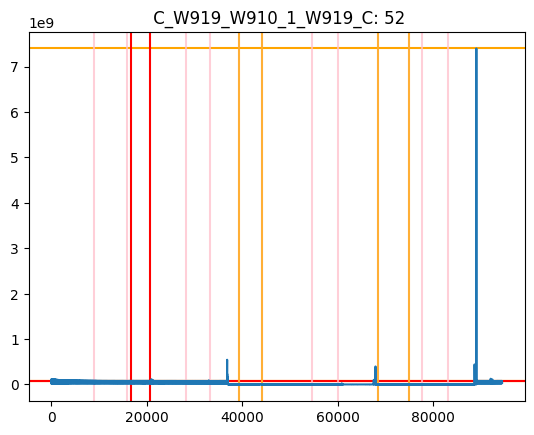

***********************************************************************************************
Sensor: 53  C_W919_W910_1_W919_N
53
DD = None


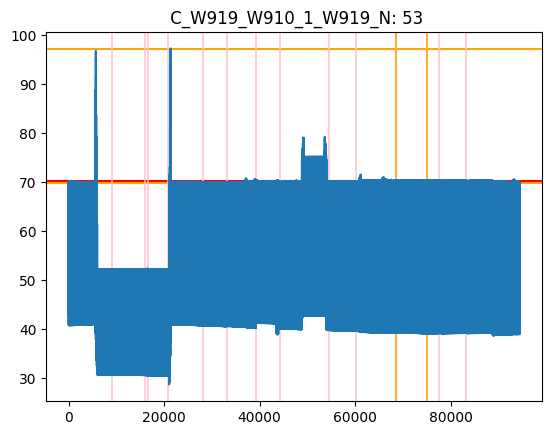

***********************************************************************************************
Sensor: 54  V_W-115KV2_AN


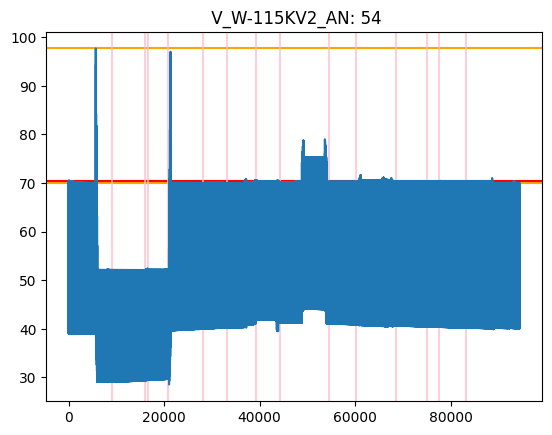

***********************************************************************************************
Sensor: 55  V_W-115KV2_BN


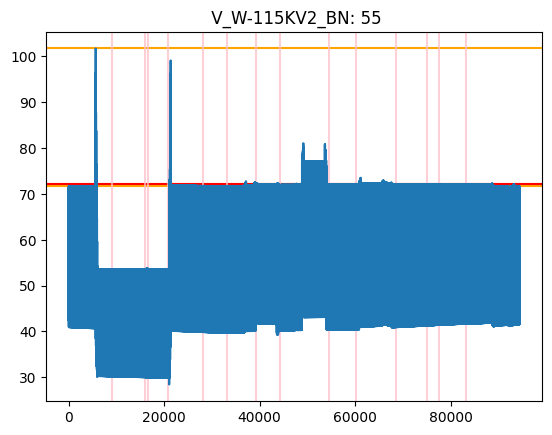

***********************************************************************************************
Sensor: 56  V_W-115KV2_CN


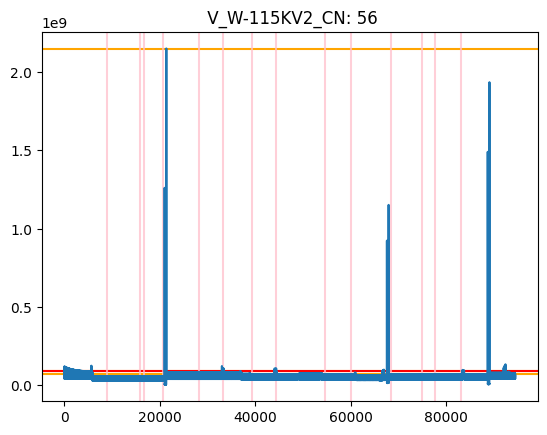

***********************************************************************************************
Sensor: 57  C_W957_W950_1_W950_A
57
DD = None
57
DD = None


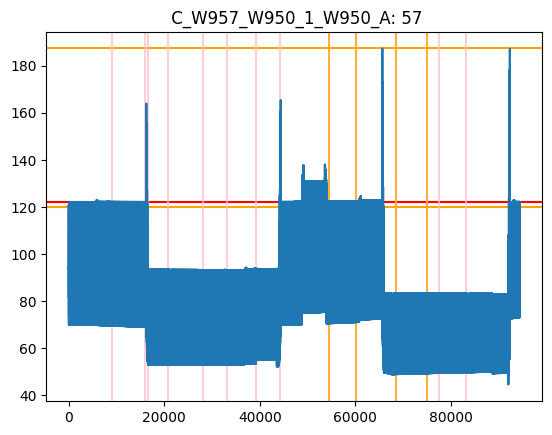

***********************************************************************************************
Sensor: 58  C_W957_W950_1_W950_B
58
DD = None
58
DD = None


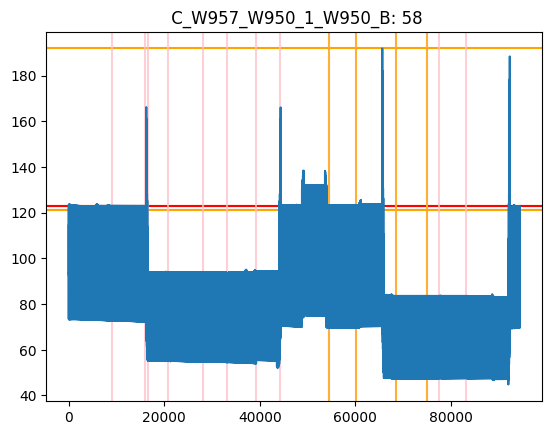

***********************************************************************************************
Sensor: 59  C_W957_W950_1_W950_C
59
DD = None
59
DD = None


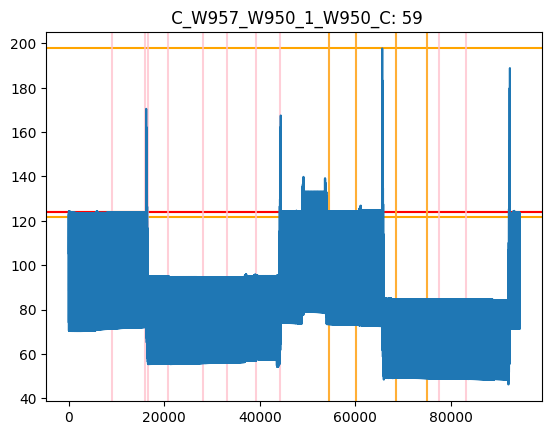

***********************************************************************************************
Sensor: 60  C_W957_W950_1_W950_N
60
DD = None
60
DD = None


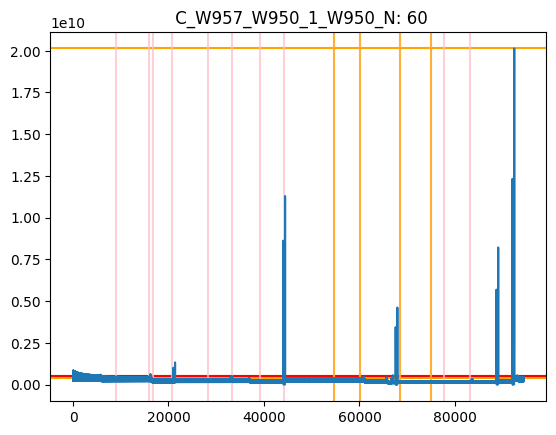

***********************************************************************************************
Sensor: 61  C_W957_W950_1_W957_A
DD = 39
DD = None


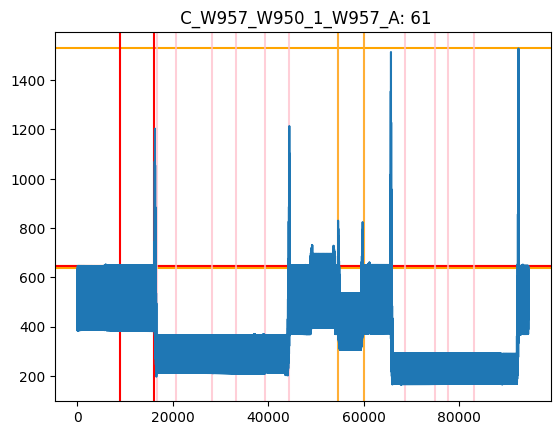

***********************************************************************************************
Sensor: 62  C_W957_W950_1_W957_B
DD = 26
DD = None


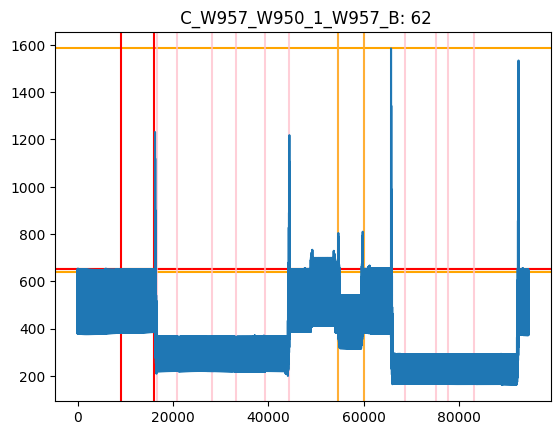

***********************************************************************************************
Sensor: 63  C_W957_W950_1_W957_C
DD = 12
DD = None


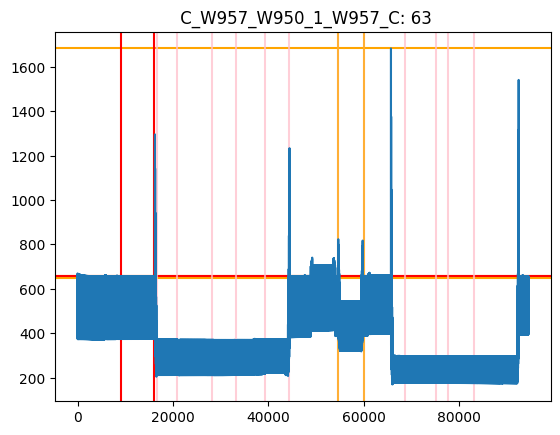

***********************************************************************************************
Sensor: 64  C_W957_W950_1_W957_N
DD = 27
DD = None


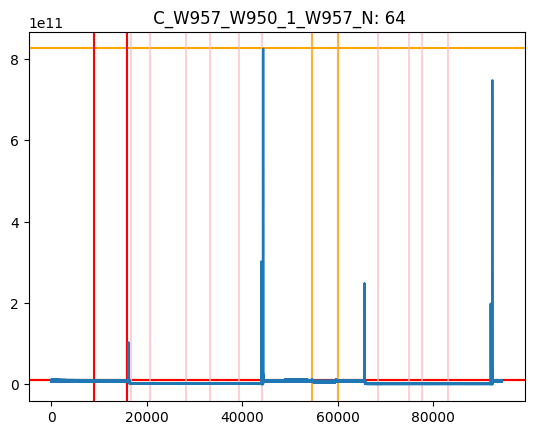

***********************************************************************************************
Sensor: 65  C_W927_W929_1_W929_A
65
DD = None
65
DD = None


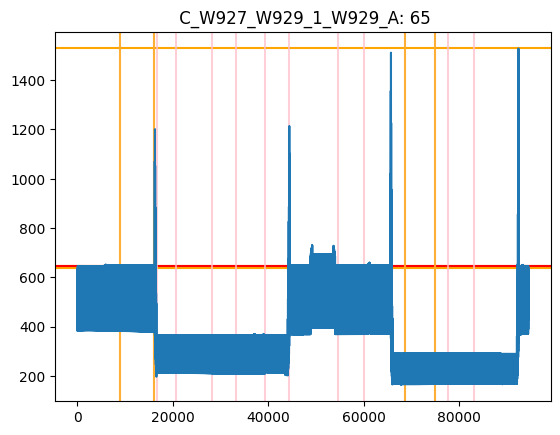

***********************************************************************************************
Sensor: 66  C_W927_W929_1_W929_B
66
DD = None


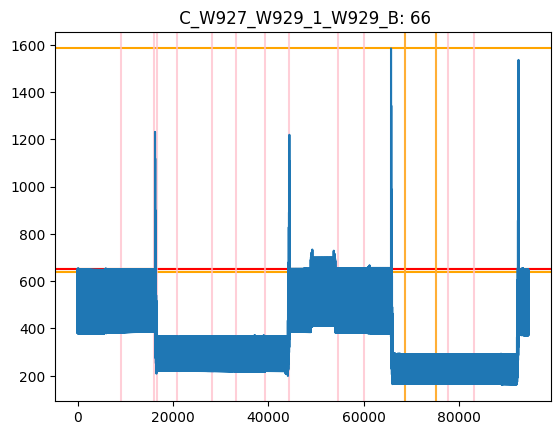

***********************************************************************************************
Sensor: 67  C_W927_W929_1_W929_C
67
DD = 4998
67
DD = None


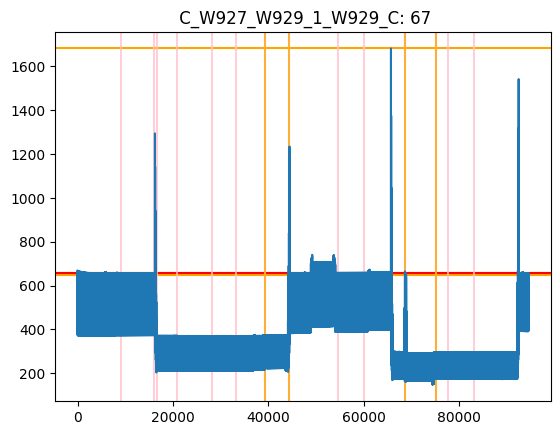

***********************************************************************************************
Sensor: 68  C_W927_W929_1_W929_N
68
DD = None


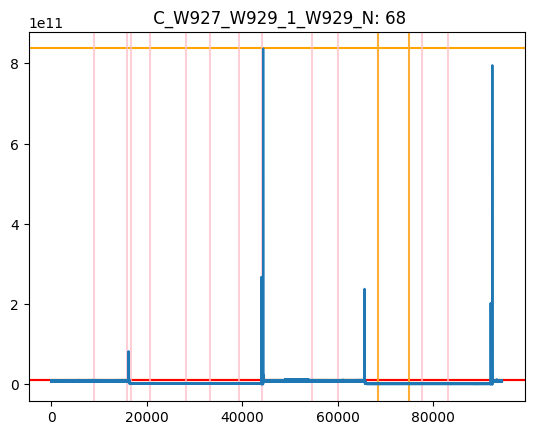

***********************************************************************************************
Sensor: 69  V_W-115KV1_AN


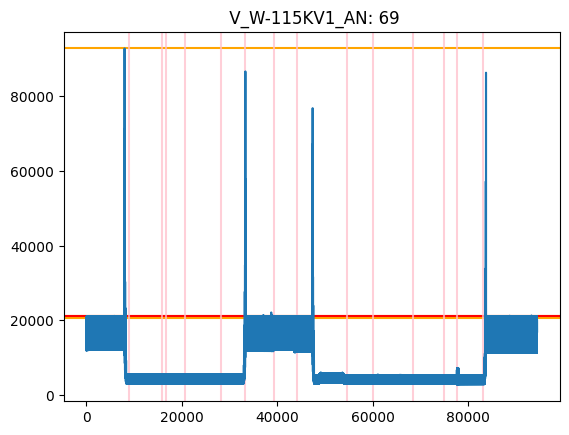

***********************************************************************************************
Sensor: 70  V_W-115KV1_BN


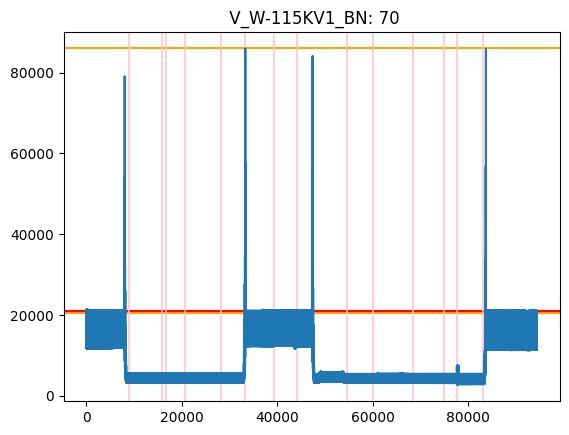

***********************************************************************************************
Sensor: 71  V_W-115KV1_CN


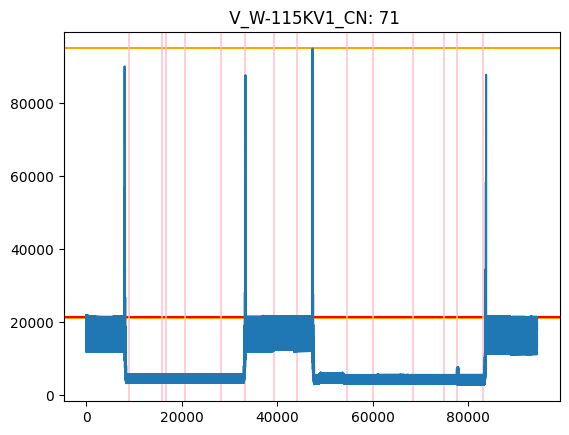

***********************************************************************************************
Sensor: 72  C_W927_W929_1_W927_A
72
DD = None
72
DD = None
72
DD = None


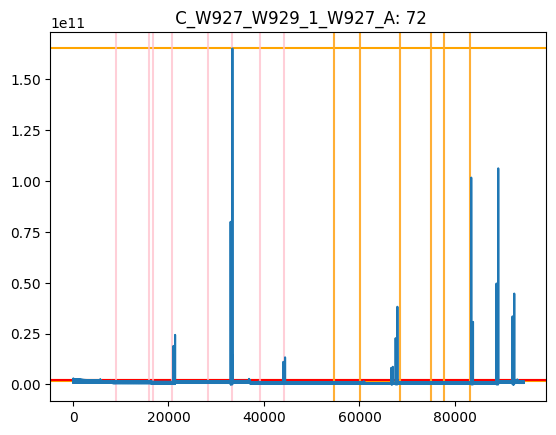

***********************************************************************************************
Sensor: 73  C_W927_W929_1_W927_B
73
DD = None
73
DD = None


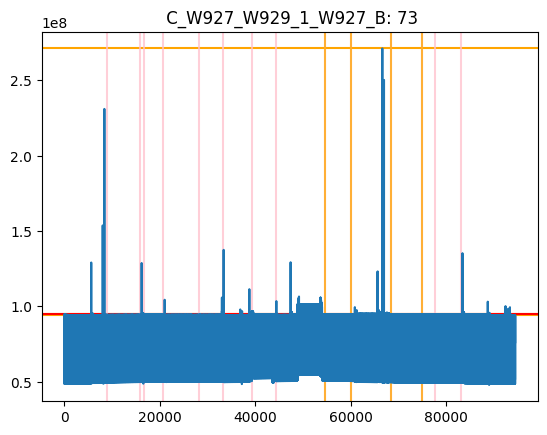

***********************************************************************************************
Sensor: 74  C_W927_W929_1_W927_C
74
DD = None
74
DD = None
74
DD = None


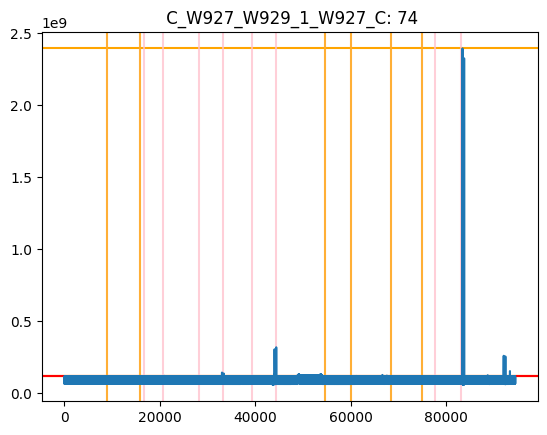

***********************************************************************************************
Sensor: 75  C_W927_W929_1_W927_N
75
DD = None
75
DD = None
75
DD = None


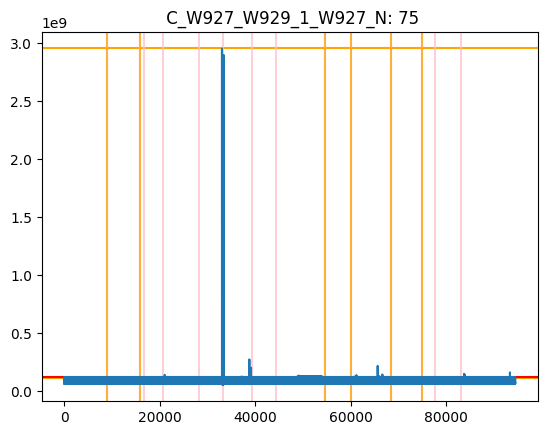

***********************************************************************************************
Sensor: 76  C_W919_W910_1_W910_A
DD = None
DD = None


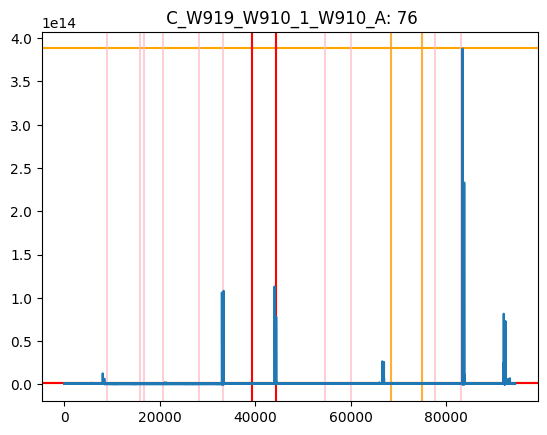

***********************************************************************************************
Sensor: 77  C_W919_W910_1_W910_B
DD = None
DD = None
DD = None


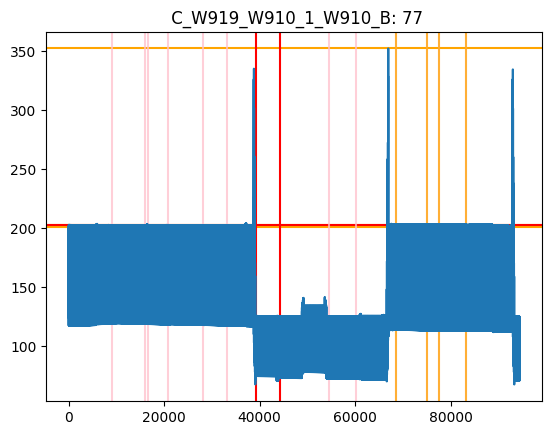

***********************************************************************************************
Sensor: 78  C_W919_W910_1_W910_C
DD = None
DD = None


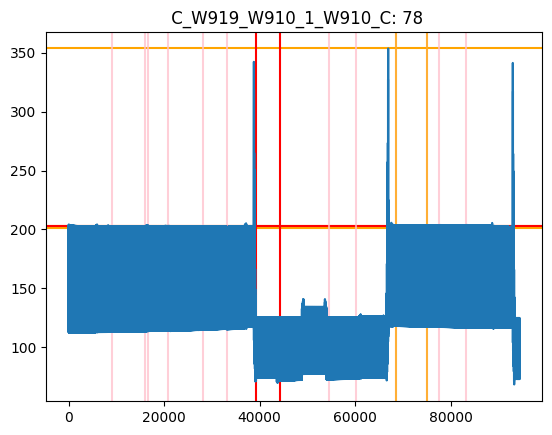

***********************************************************************************************
Sensor: 79  C_W919_W910_1_W910_N
DD = None
DD = None


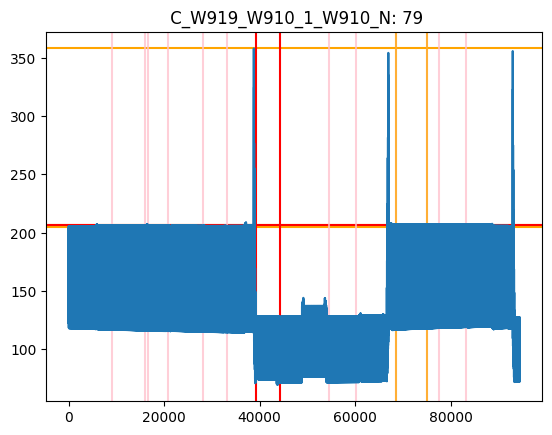

***********************************************************************************************
Sensor: 80  V_W911_AN
DD = None
DD = None


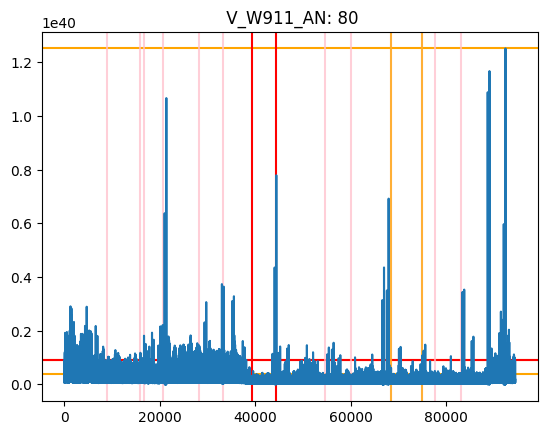

***********************************************************************************************
Sensor: 81  V_W911_BN
DD = None
DD = None


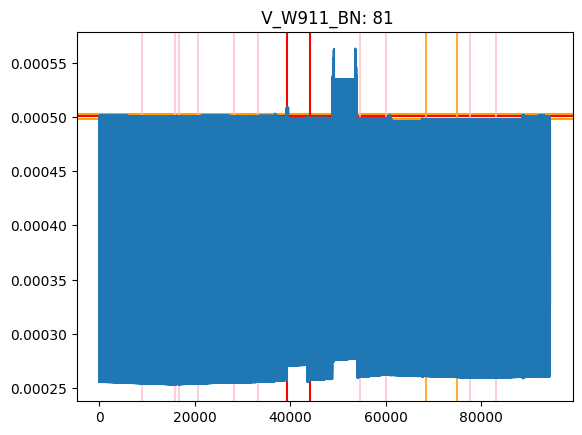

***********************************************************************************************
Sensor: 82  V_W911_CN
DD = None
DD = None


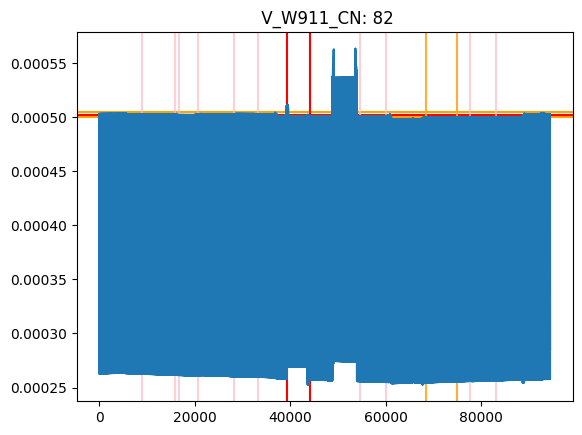

***********************************************************************************************
Sensor: 83  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_A


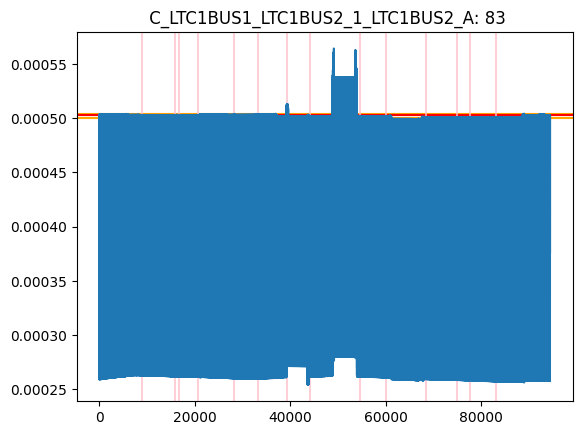

***********************************************************************************************
Sensor: 84  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_B


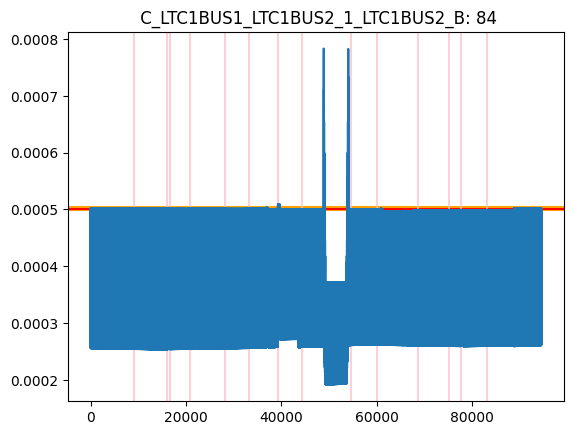

***********************************************************************************************
Sensor: 85  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_C


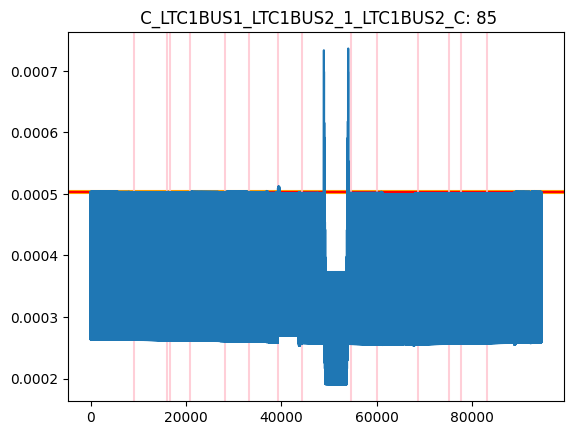

***********************************************************************************************
Sensor: 86  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS2_N


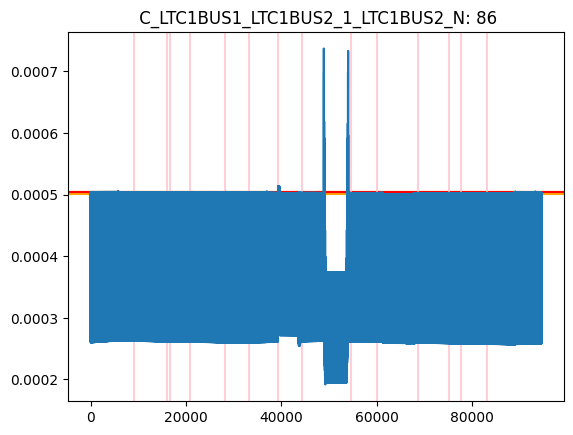

***********************************************************************************************
Sensor: 87  V_BUS13KV1_AN


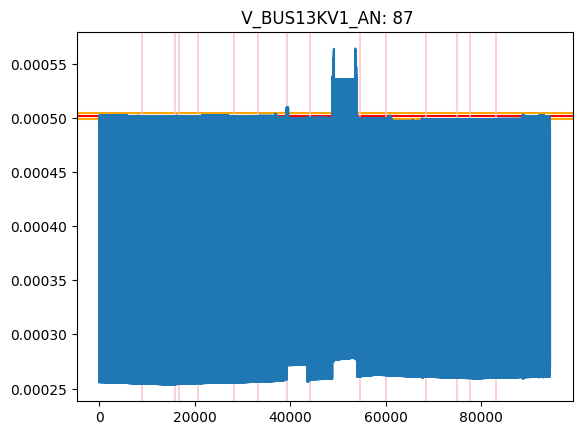

***********************************************************************************************
Sensor: 88  V_BUS13KV1_CN
DD = None
DD = None


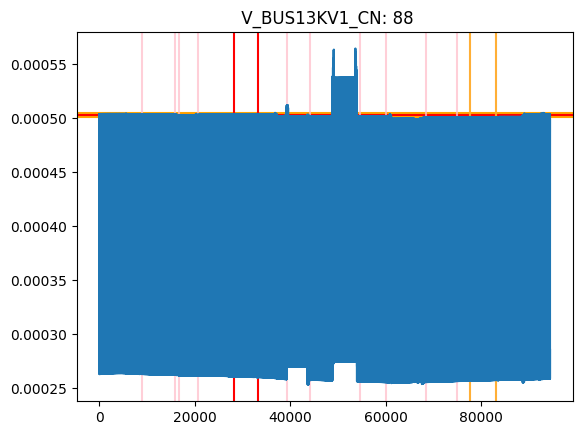

***********************************************************************************************
Sensor: 89  V_BUS13KV1_BN


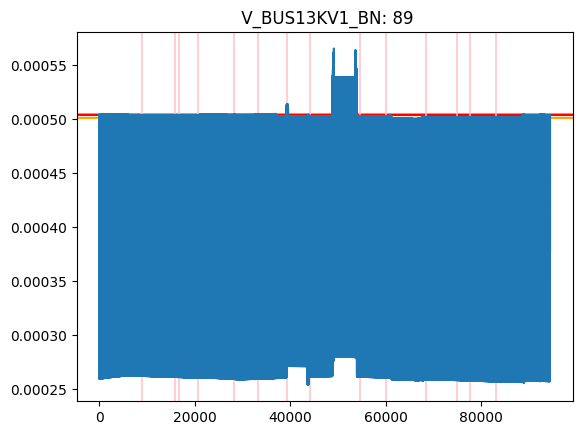

***********************************************************************************************
Sensor: 90  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_A
90
DD = None
90
DD = None


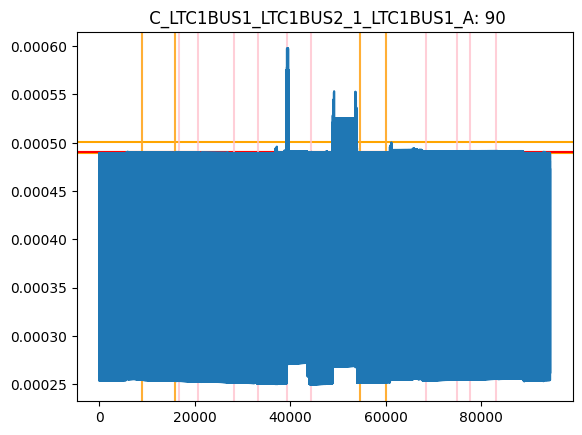

***********************************************************************************************
Sensor: 91  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_B
91
DD = None
91
DD = None


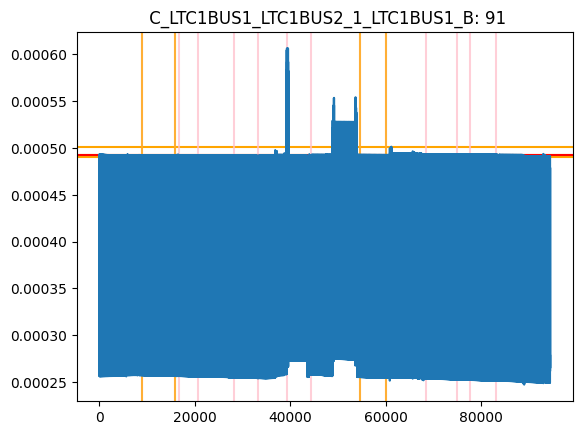

***********************************************************************************************
Sensor: 92  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_C
92
DD = None


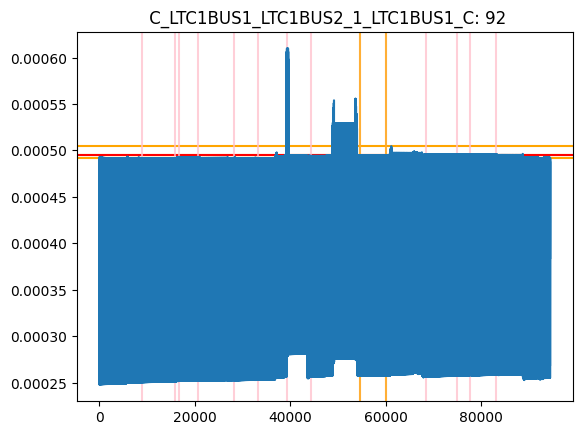

***********************************************************************************************
Sensor: 93  C_LTC1BUS1_LTC1BUS2_1_LTC1BUS1_NN
93
DD = None


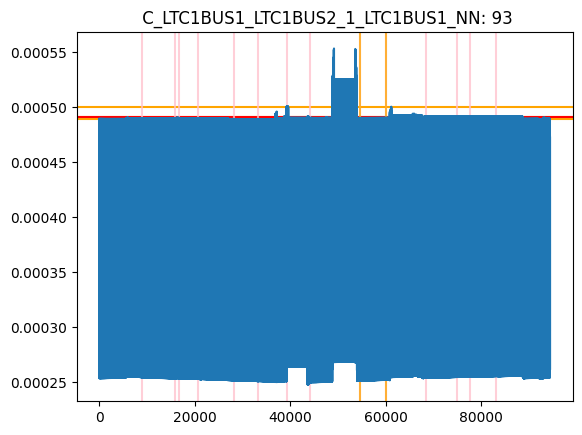

***********************************************************************************************
Sensor: 94  V_BUS13KV2_AN


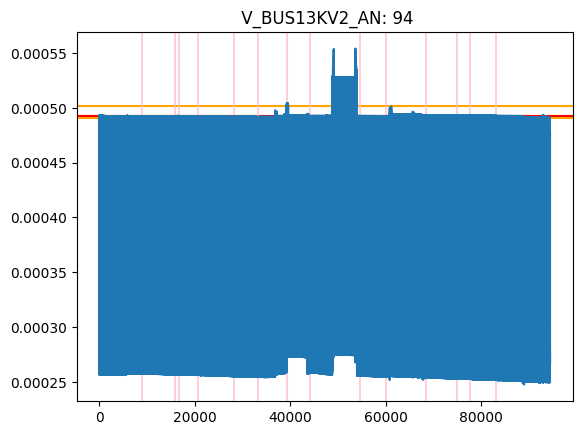

***********************************************************************************************
Sensor: 95  V_BUS13KV2_BN


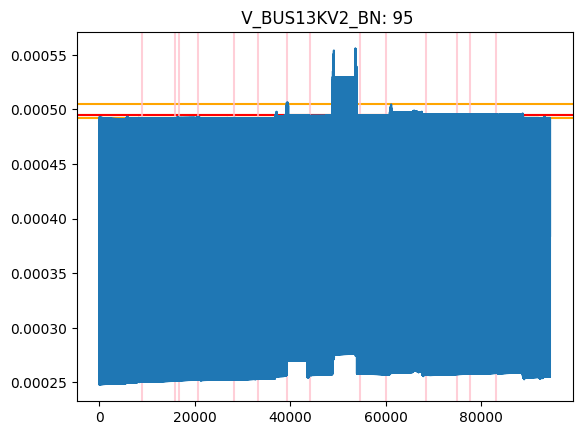

***********************************************************************************************
Sensor: 96  V_BUS13KV2_CN


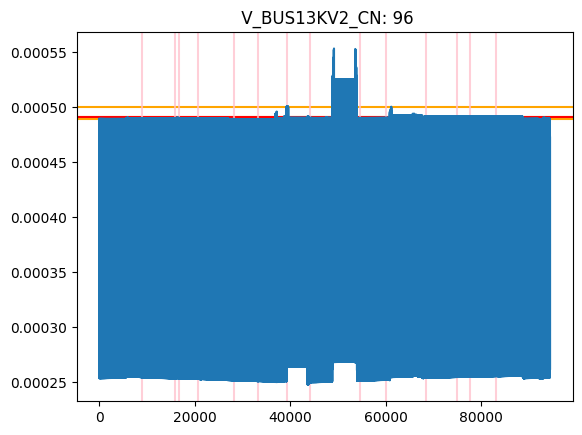

***********************************************************************************************
Sensor: 97  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_A
97
DD = None


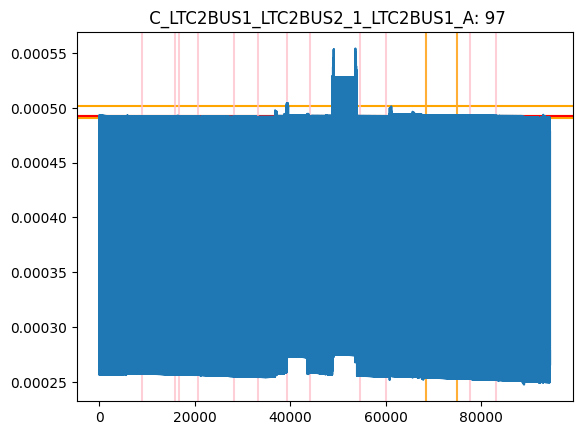

***********************************************************************************************
Sensor: 98  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_B
98
DD = None


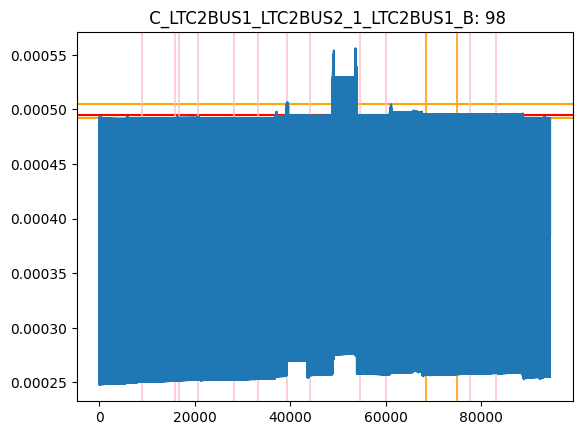

***********************************************************************************************
Sensor: 99  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_C
99
DD = None


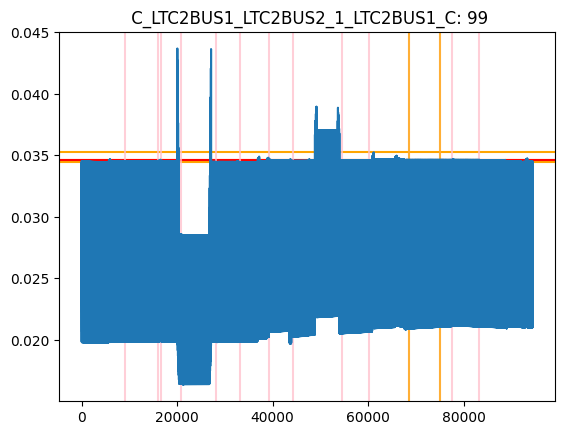

***********************************************************************************************
Sensor: 100  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS1_NN
100
DD = None
100
DD = None


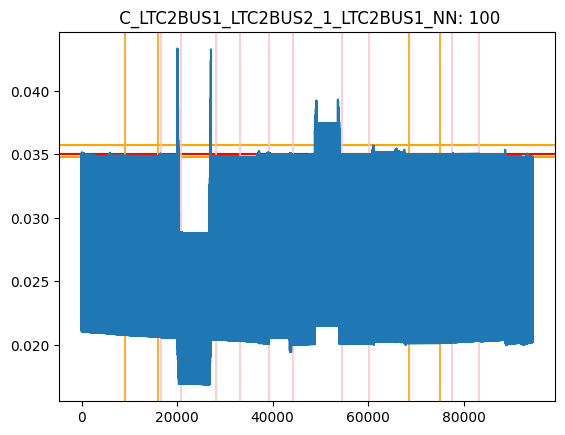

***********************************************************************************************
Sensor: 101  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_A
101
DD = None


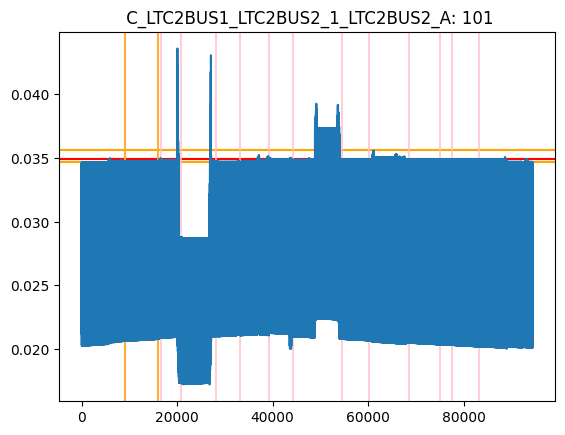

***********************************************************************************************
Sensor: 102  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_B
102
DD = None


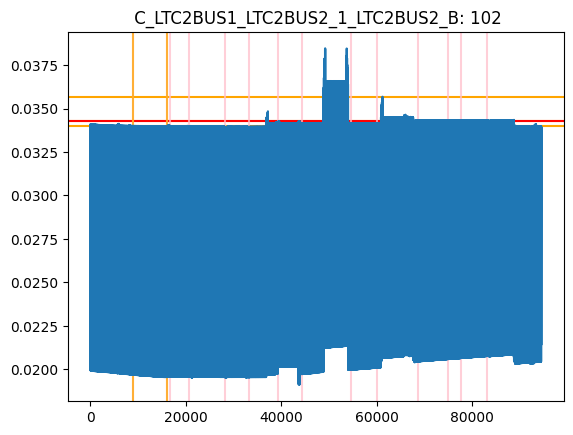

***********************************************************************************************
Sensor: 103  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_C
103
DD = None


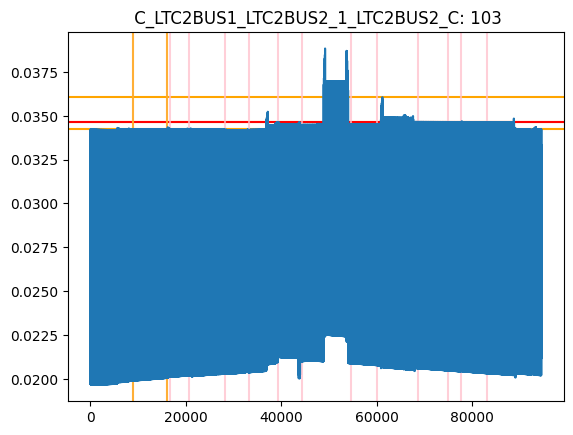

***********************************************************************************************
Sensor: 104  C_LTC2BUS1_LTC2BUS2_1_LTC2BUS2_N
104
DD = None


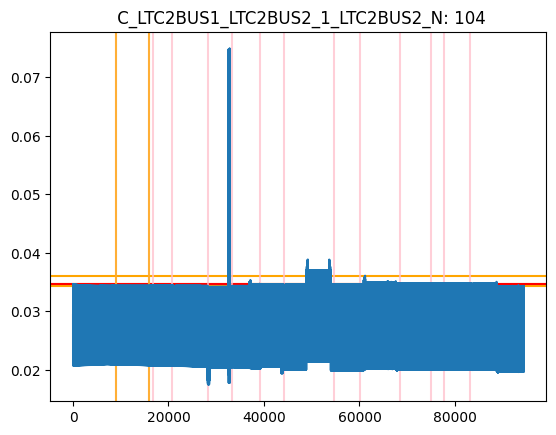

***********************************************************************************************
Sensor: 105  C_SOURCE~C_SUBC~115_1_SOURCE~C_A


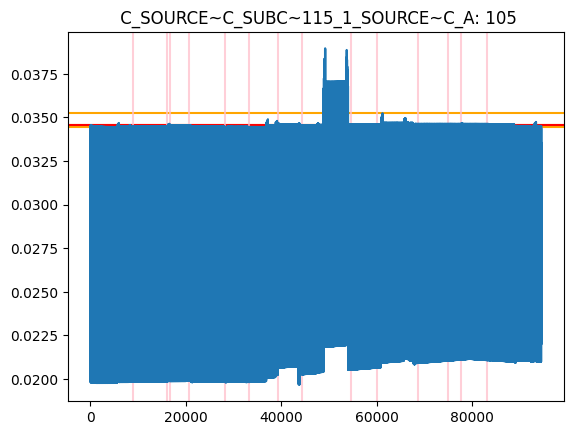

***********************************************************************************************
Sensor: 106  C_SOURCE~C_SUBC~115_1_SOURCE~C_B


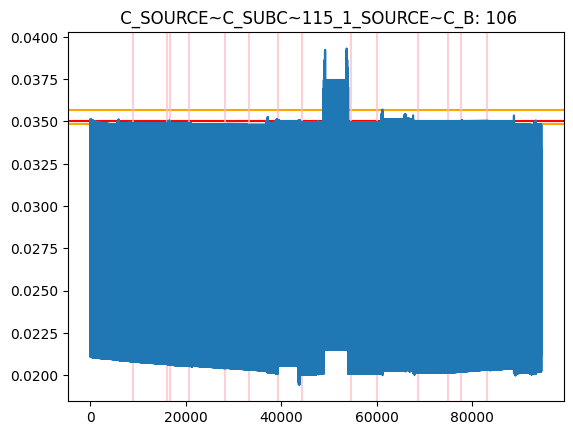

***********************************************************************************************
Sensor: 107  C_SOURCE~C_SUBC~115_1_SOURCE~C_C
107
DD = None
107
DD = None


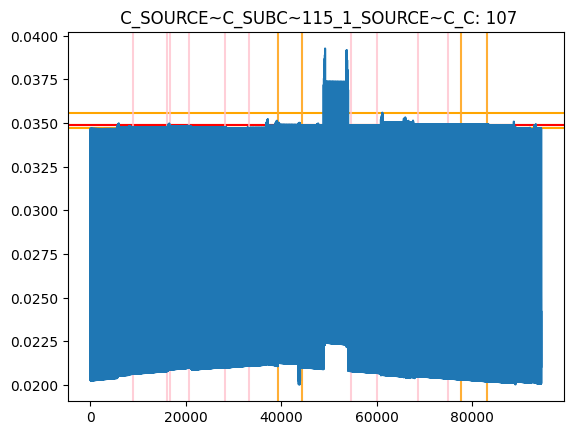

***********************************************************************************************
Sensor: 108  C_SOURCE~C_SUBC~115_1_SOURCE~C_N


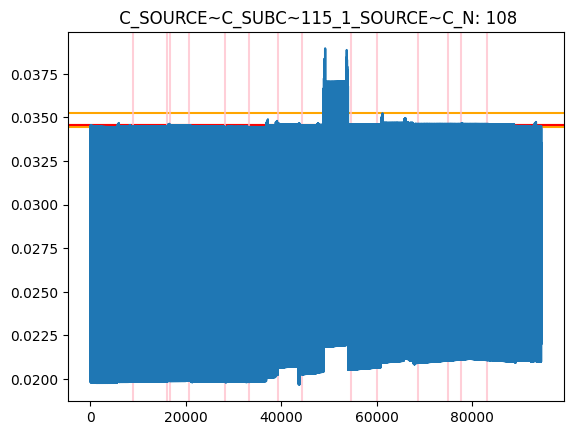

***********************************************************************************************
Sensor: 109  V_SOURCE-C_AN


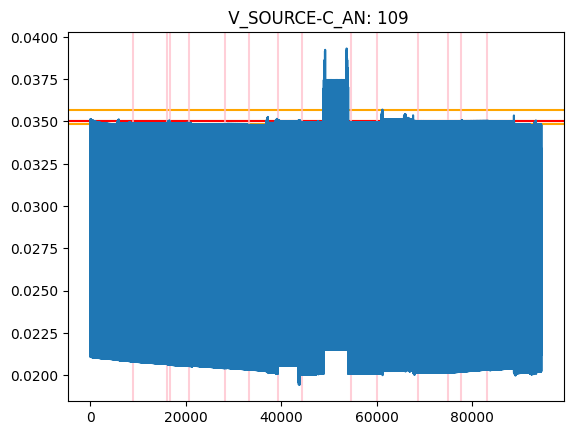

***********************************************************************************************
Sensor: 110  V_SOURCE-C_BN


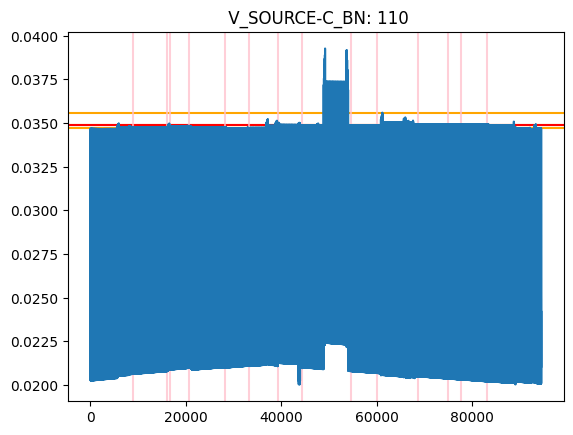

***********************************************************************************************
Sensor: 111  V_SOURCE-C_CN


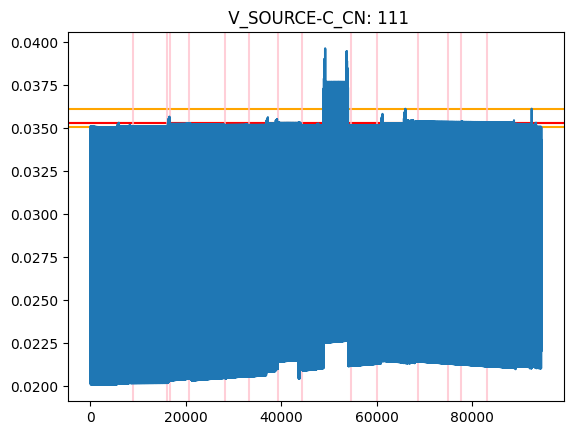

***********************************************************************************************
Sensor: 112  C_SOURCE~A_SUBA~115_1_SOURCE~A_A
112
DD = None


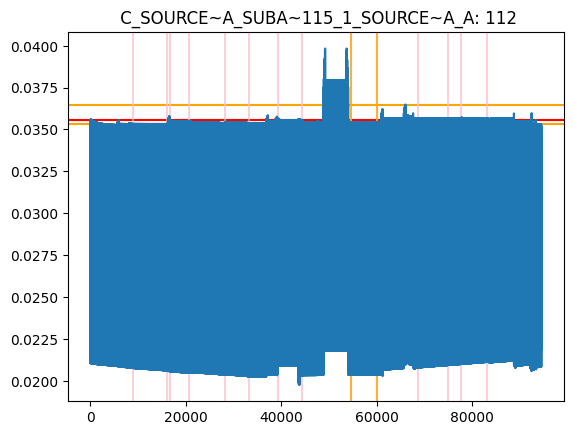

***********************************************************************************************
Sensor: 113  C_SOURCE~A_SUBA~115_1_SOURCE~A_B
113
DD = None


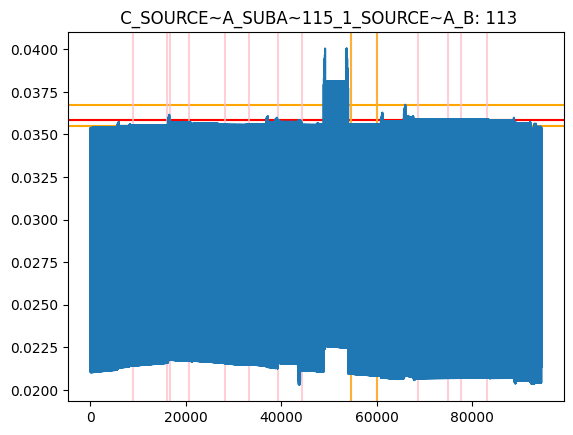

***********************************************************************************************
Sensor: 114  C_SOURCE~A_SUBA~115_1_SOURCE~A_C
114
DD = None


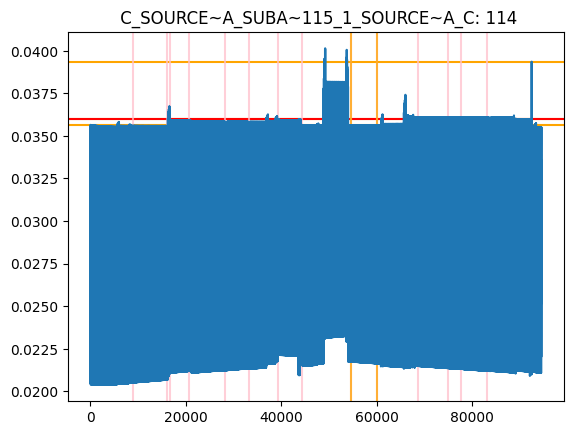

***********************************************************************************************
Sensor: 115  C_SOURCE~A_SUBA~115_1_SOURCE~A_N
115
DD = None


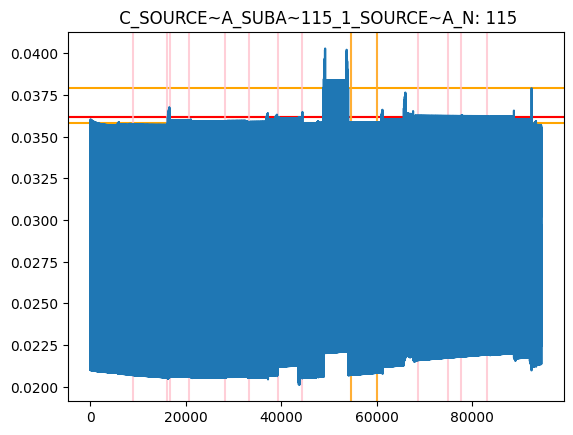

***********************************************************************************************
Sensor: 116  V_SOURCE-A_AN


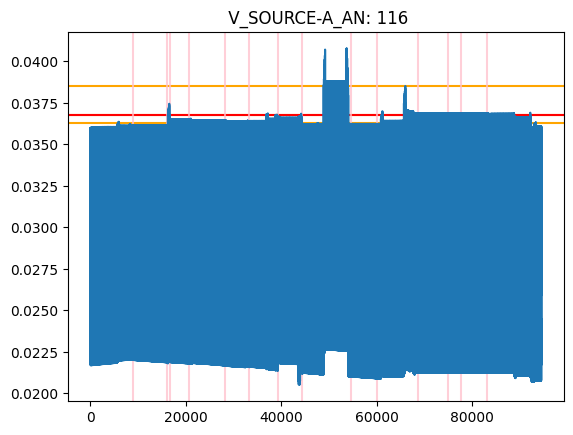

***********************************************************************************************
Sensor: 117  V_SOURCE-A_BN


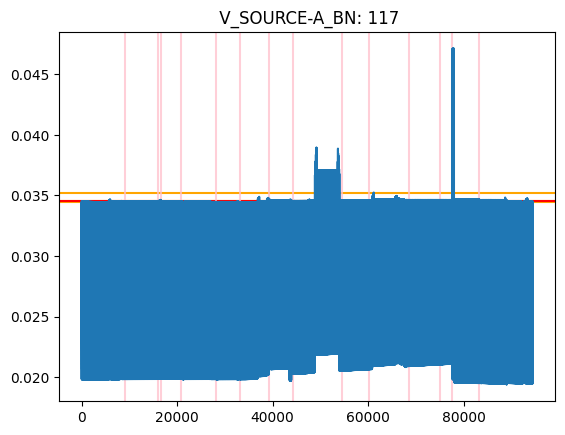

***********************************************************************************************
Sensor: 118  V_SOURCE-A_CN


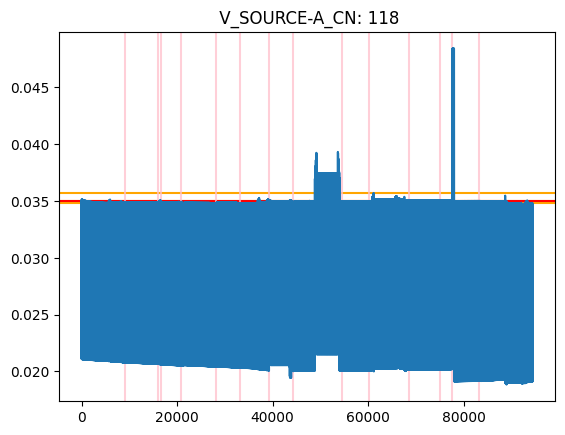

***********************************************************************************************
Sensor: 119  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_A
119
DD = None


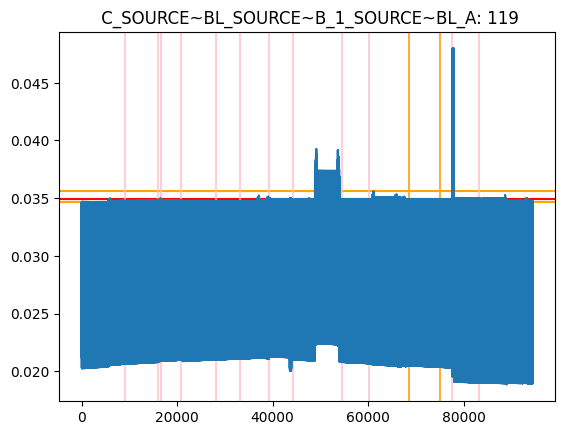

***********************************************************************************************
Sensor: 120  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_B
120
DD = None


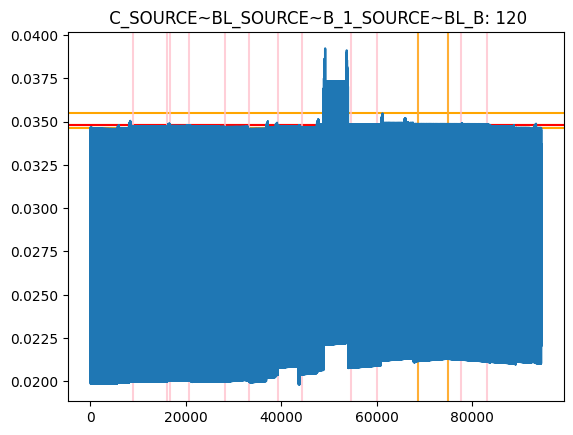

***********************************************************************************************
Sensor: 121  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_C
121
DD = None


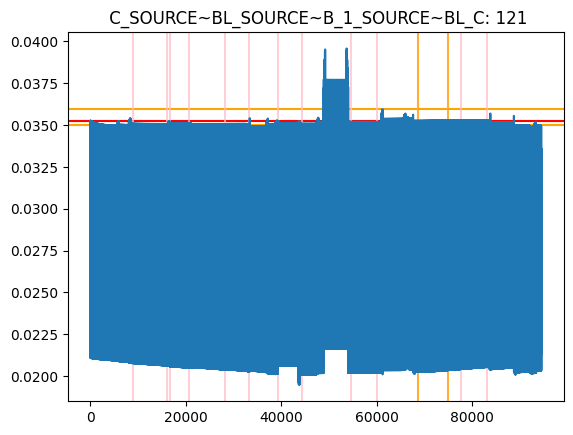

***********************************************************************************************
Sensor: 122  C_SOURCE~BL_SOURCE~B_1_SOURCE~BL_N
122
DD = None


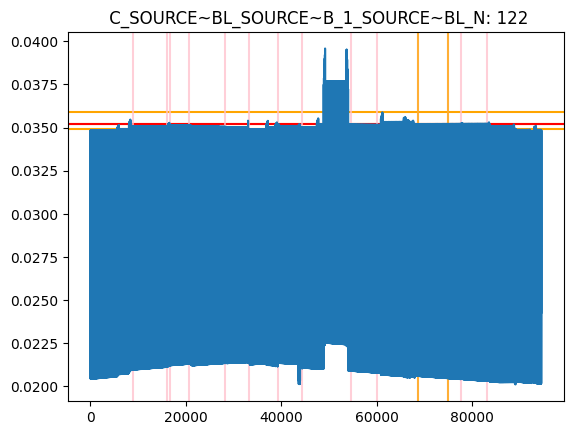

***********************************************************************************************
Sensor: 123  V_SOURCE-BL_AN


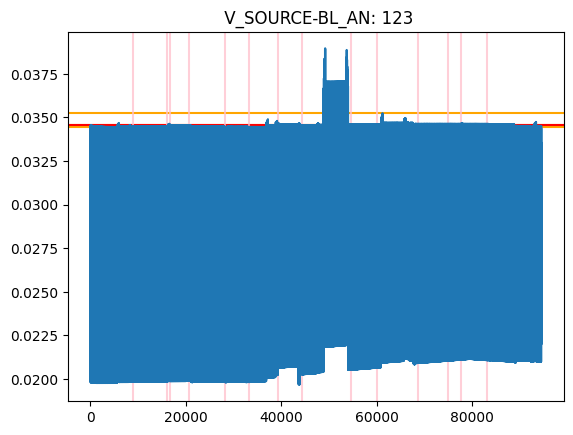

***********************************************************************************************
Sensor: 124  V_SOURCE-BL_BN


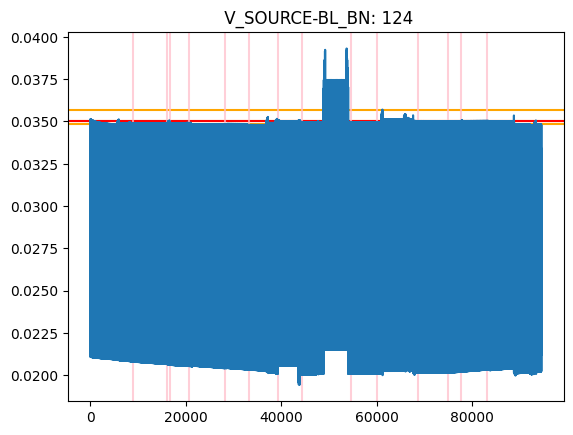

***********************************************************************************************
Sensor: 125  V_SOURCE-BL_CN


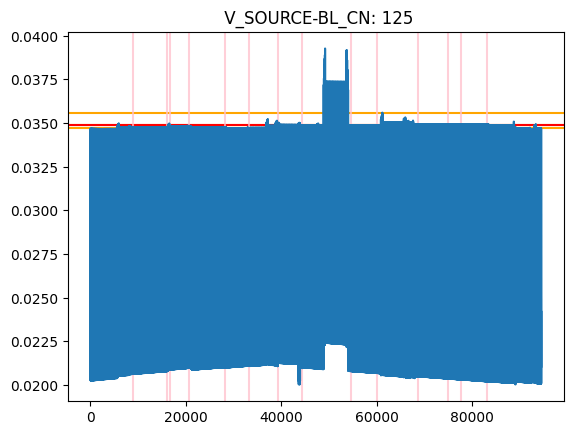

[None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 3374, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, 39, None, 26, None, 12, None, 27, None, None, None, None, 4998, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None, None]


In [34]:
LD_var = []
at_neighbor = {}

rsum_list = rsum_list_var
threshold = thresholds_var_99
t_list = [thresholds_var, thresholds_var_99, thresholds_var_95]
persistency = 5

for index, i in enumerate(rsum_list):
    print("***********************************************************************************************")
    attack_in = (i > threshold[index]).nonzero()

    violations = (rsum_list > threshold.reshape(-1, 1))

    print(f"Sensor: {things[index]} {cols[things[index]-1]}")
    at_neighbor[things[index]] = attack_in
    plt.title(f"{cols[things[index]-1]}: {things[index]}")

    for t in t_list:
        plt.axhline(t[index], color='orange')

    plt.axhline(threshold[index], color='red')

    if things[index] in attack_dict:
        #if sensor is being attacked

        # ground truth
        attack_indices = df_test.index[
            (df_test['Time'] >= attack_dict[things[index]][0] * 1e6) &
            (df_test['Time'] <= attack_dict[things[index]][1] * 1e6)] - 1201

        for start, end in all_attack_indices:

            # if this is the attack time of the sensor, plot solid red lines
            if attack_indices[0] == start:
                DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                LD_var.append(DD)
                print(f"DD = {DD}")
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='red')
                plt.axvline(end_w, color='red')

            # otherwise, plot pink lines
            else:
                start_w = start-window-w
                end_w = end+window+w-1
                plt.axvline(start_w, color='pink', alpha=0.75)
                plt.axvline(end_w, color='pink', alpha=0.75)

                start_w = start-window-w
                end_w = end+window+w-1
                for starts, ate in attack_i.items():
                  if starts == start and things[index] in ate:
                    DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                    LD_var.append(DD)
                    print(f"DD = {DD}")
                    plt.axvline(start_w, color='orange', alpha=0.75)
                    plt.axvline(end_w, color='orange', alpha=0.75)

    else:
         for start, end in all_attack_indices:
            start_w = start-window-w
            end_w = end+window+w-1
            plt.axvline(start_w, color='pink', alpha=0.75)
            plt.axvline(end_w, color='pink', alpha=0.75)
            for starts, ate in attack_i.items():
              if starts == start:
                if things[index] in ate:
                  print(things[index])
                  DD = detection_delay(violations[index], [(start, end)], window, w, persistency)[0]
                  LD_var.append(DD)
                  print(f"DD = {DD}")
                  plt.axvline(start_w, color='orange', alpha=0.75)
                  plt.axvline(end_w, color='orange', alpha=0.75)

    plt.plot(i)
    plt.show()

print(LD_var)

Summary:

In [36]:
order_attack = ['CT', 'Cphase', 'PT', 'Vphase', 'PT', 'CT', 'Cphase', 'GPS',]

In [38]:
np.mean(df_test['Time'][df_test['Time'] > 0.25e6].diff())

208.3319937132791